In [146]:
try:
    from google.colab import drive
    drive.mount('/content/drive')
    py_file_location = "/content/drive/MyDrive/Tesis/Git/RedVolcanica"
    %cd "{py_file_location}" 
    IN_COLAB = True
except:
    IN_COLAB = False
print(IN_COLAB)  

False


In [147]:
import importlib

import RedFunciones.visualizacion as visualizacion
import RedFunciones.Generador as Generador
import RedFunciones.Discriminador as Discriminador
import RedFunciones.auxiliares as auxiliares
import RedFunciones.DataloaderVol as DataloaderVol
import RedFunciones.Checkpoint as Checkpoint

importlib.reload(auxiliares)
importlib.reload(visualizacion)
importlib.reload(Generador)
importlib.reload(Discriminador)
importlib.reload(DataloaderVol)
importlib.reload(Checkpoint)

import Auxiliares.BinaryAccuracy as bin_acc

In [148]:
import torch
from torch import nn
from tqdm.auto import tqdm # Progress bar

from torchvision import transforms
from torchvision.utils import make_grid
from torchvision.datasets import MNIST #noned

from torch.utils.data import DataLoader
import matplotlib.pyplot as plt

torch.manual_seed(0) # Set for our testing purposes, please do not change!

import os
cwd = os.getcwd()
print(cwd)

cuda0 = torch.device('cuda:0')
cpu = 'cpu'
device = torch.device(cuda0 if torch.cuda.is_available() else cpu)
print(torch.cuda.is_available())
print(torch.cuda.device_count())

/home/fgrijalva/Red
True
2


criterion: the loss function

n_epochs: the number of times you iterate through the entire 
dataset when training

z_dim: the dimension of the noise vector

display_step: how often to display/visualize the images

batch_size: the number of images per forward/backward pass

lr: the learning rate

device: the device type

In [158]:
h5_filename = cwd + '/baseh5/baseSR10.h5'
nombre = 'master'
nombre_carga = 'master-2022-04-04.pt'

criterion = nn.BCEWithLogitsLoss()

mnist_shape = (1, 129, 33) #tamaño imagen
n_classes = 2 # numkero etiquetas
z_dim = 64

n_epochs = 25
display_step = 50
batch_size = 12

lrg = 0.0001
beta_1_g = 0.5
beta_2_g = 0.999
repeats_g = 3

lrd = 0.0001
beta_1_d = 0.5
beta_2_d = 0.999
d_repeats = 1

mean = 0
std = 1

guardar = False
cargar = False
save_steep = 1

epoch_temp = -1
gen_loss_temp = torch.empty([])
disc_loss_temp = torch.empty([])

In [159]:
mean_p = False

regularizaM = True
reg_lambda = 0.001

In [160]:
if mean_p:
    myDataA = DataloaderVol.VolcanoDatasetH5(h5_filename)
    dataloaderA = DataLoader(
        myDataA,
        batch_size=batch_size,
        shuffle=True)

    def get_mean_and_std(dataloader):
        channels_sum, channels_squared_sum, num_batches = 0, 0, 0
        for data, _ in dataloader:
            # Mean over batch, height and width, but not over the channels
            channels_sum += torch.mean(data, dim=[0,2,3])
            channels_squared_sum += torch.mean(data**2, dim=[0,2,3])
            num_batches += 1    
        mean = channels_sum / num_batches
        # std = sqrt(E[X^2] - (E[X])^2)
        std = (channels_squared_sum / num_batches - mean ** 2) ** 0.5
        return mean.item(), std.item()

    mean, std = get_mean_and_std(dataloaderA)
    print(mean)
    print(std)

In [161]:
#cargar datos
if mean_p:
    transform = transforms.Compose([
        #transforms.ToTensor(),
        transforms.Normalize((mean,), (std,)),
        #torchaudio.transforms.MelScale(sample_rate=50, n_stft=129)
    ])    
else:
    transform = transforms.Compose([
        #transforms.ToTensor(),
        #transforms.Normalize((mean,), (std,)),
        #torchaudio.transforms.MelScale(sample_rate=50, n_stft=129)
    ])    
myData = DataloaderVol.VolcanoDatasetH5(h5_filename, transform)

dataloader = DataLoader(
    myData,
    batch_size=batch_size,
    shuffle=True)

#a, b = next(iter(dataloader))
#print(a)

In [162]:
#a, b = next(iter(dataloader))
#print(real)

In [163]:
generator_input_dim, discriminator_im_chan = auxiliares.get_input_dimensions(z_dim, mnist_shape, n_classes)

gen = Generador.Generator(input_dim=generator_input_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lrg)
disc = Discriminador.Discriminator(im_chan=discriminator_im_chan).to(device)
disc_opt = torch.optim.Adam(disc.parameters(), lr=lrd)
gen = gen.apply(auxiliares.weights_init)
disc = disc.apply(auxiliares.weights_init)

        
metric = bin_acc.BinaryAccuracy()

In [164]:
if cargar:
    compelto = Checkpoint.DIRECTORY + nombre_carga
    checkpoint = torch.load(compelto)
    gen.load_state_dict(checkpoint['gen'])
    disc.load_state_dict(checkpoint['disc'])
    gen_opt.load_state_dict(checkpoint['gen_opt'])
    disc_opt.load_state_dict(checkpoint['disc_opt'])
    epoch_temp = checkpoint['epoch']
    gen_loss_temp = checkpoint['gen_loss']
    disc_loss_temp = checkpoint['dis_loss']
    print('Modelo cargado')
    print('epoch: ' + str(epoch_temp))

Epoch: 0


  0%|          | 0/513 [00:00<?, ?it/s]

Red Funcionando
Step 50: Generator loss: 0.7074834462006886, discriminator loss: 0.8052784645557404
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


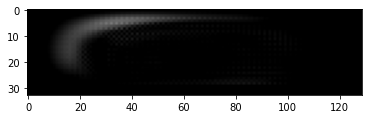

Espectrogramas Reales


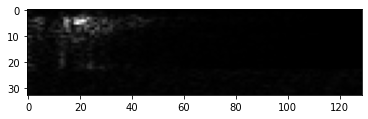

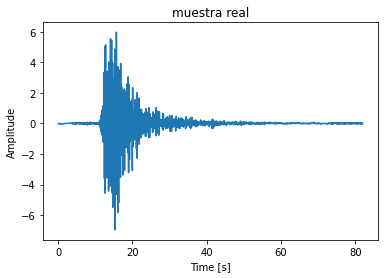

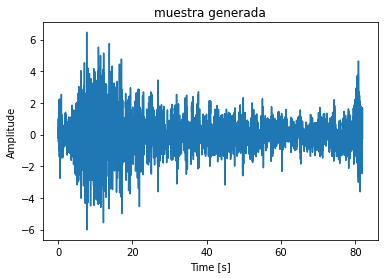

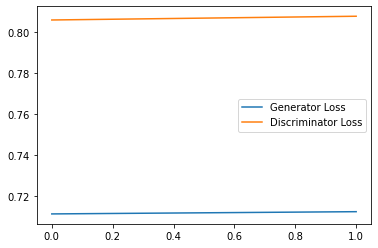

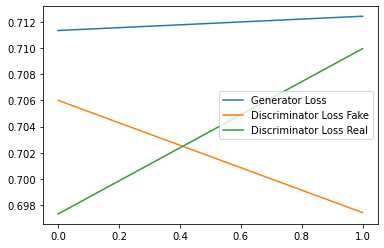

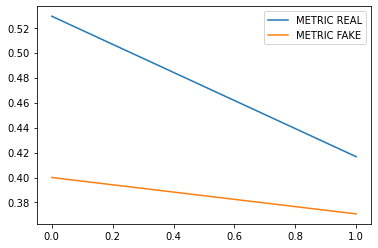

Step 100: Generator loss: 0.6950077792008719, discriminator loss: 0.7975510597229004
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


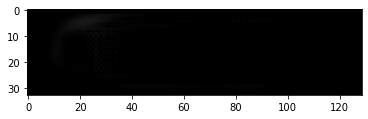

Espectrogramas Reales


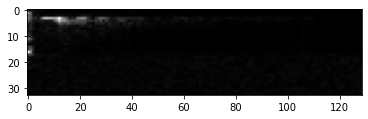

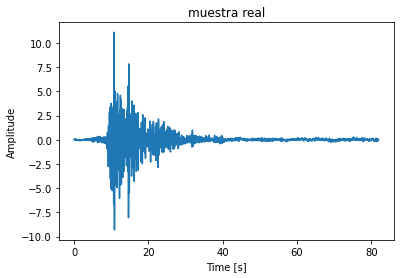

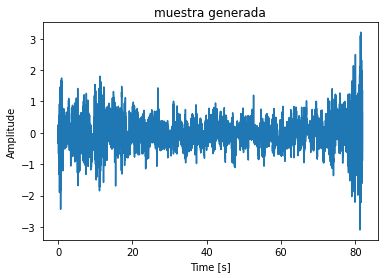

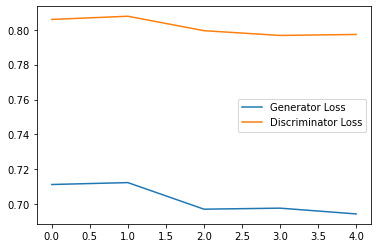

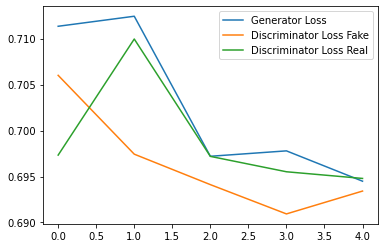

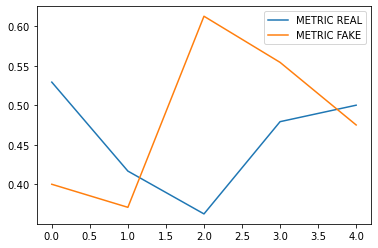

Step 150: Generator loss: 0.6916517118612927, discriminator loss: 0.7976766228675842
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


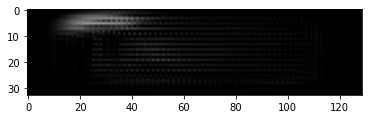

Espectrogramas Reales


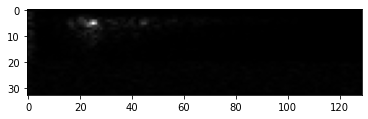

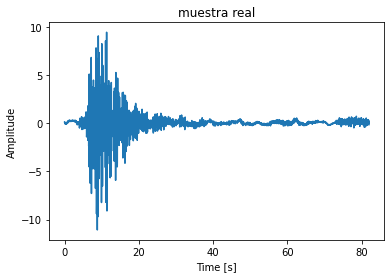

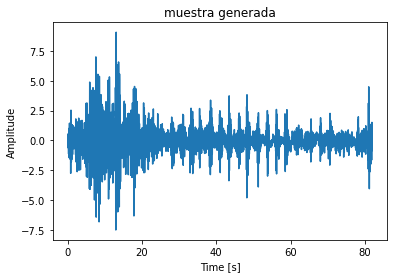

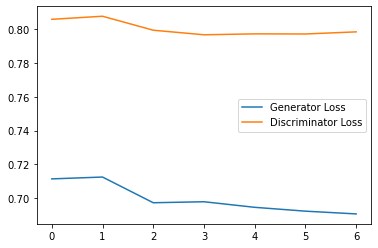

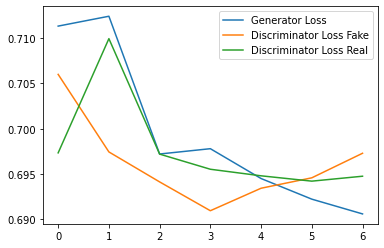

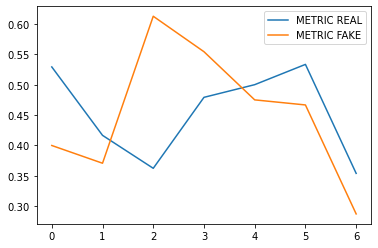

Step 200: Generator loss: 0.6919573338826497, discriminator loss: 0.797231160402298
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


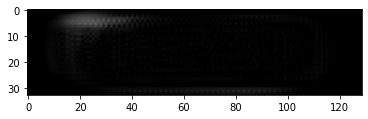

Espectrogramas Reales


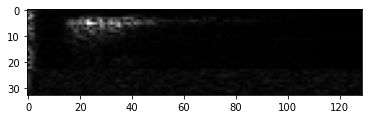

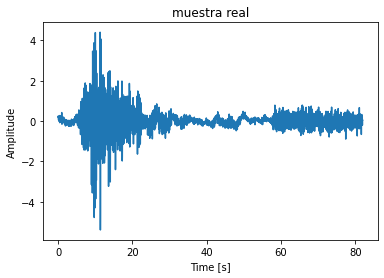

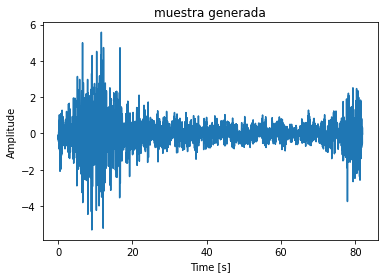

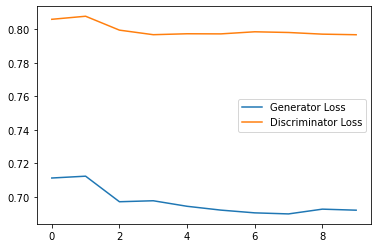

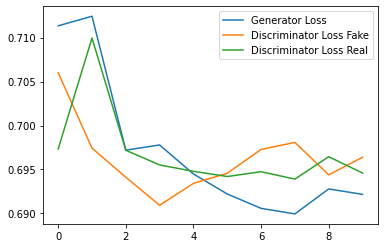

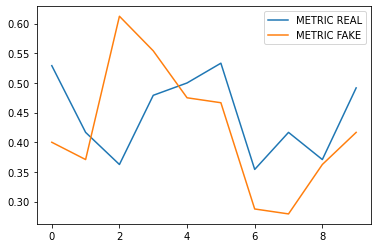

Step 250: Generator loss: 0.6920308887958526, discriminator loss: 0.7947989463806152
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


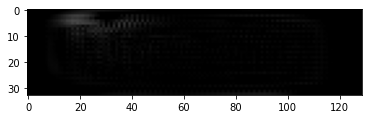

Espectrogramas Reales


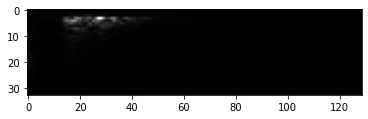

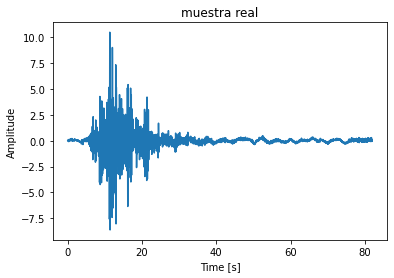

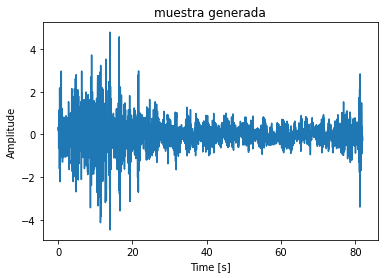

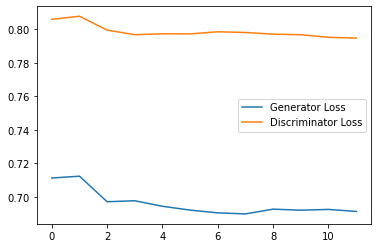

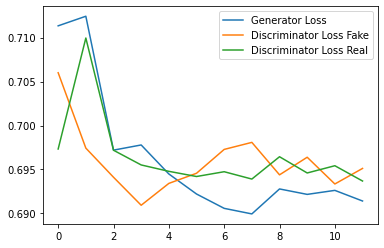

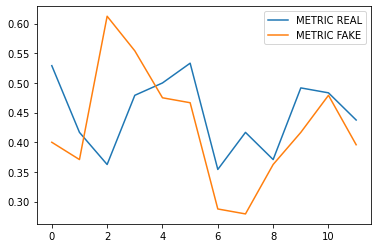

Step 300: Generator loss: 0.691601181825002, discriminator loss: 0.7944484555721283
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


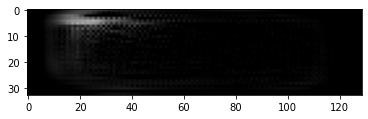

Espectrogramas Reales


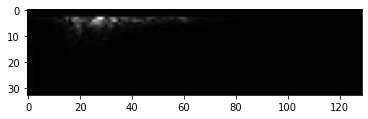

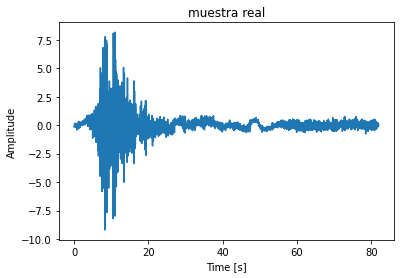

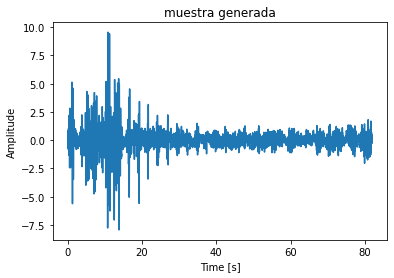

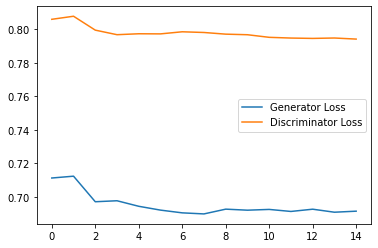

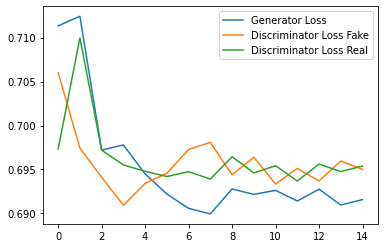

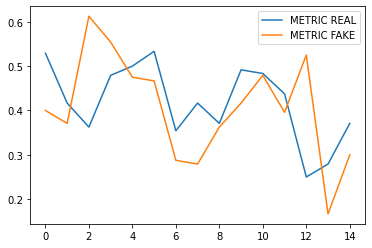

Step 350: Generator loss: 0.6918073173364006, discriminator loss: 0.7925877594947814
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


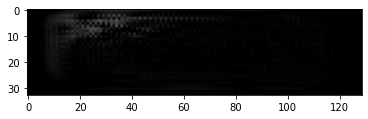

Espectrogramas Reales


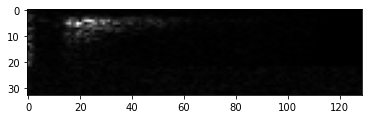

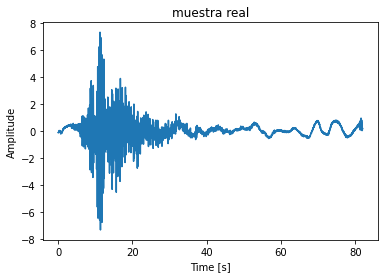

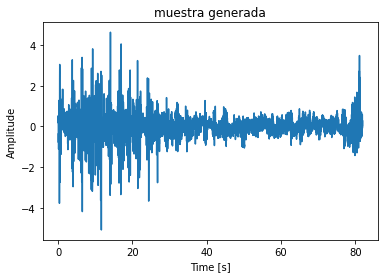

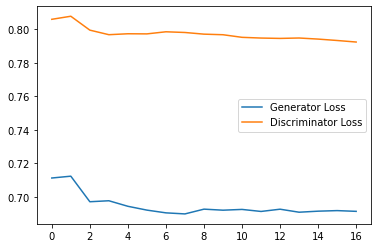

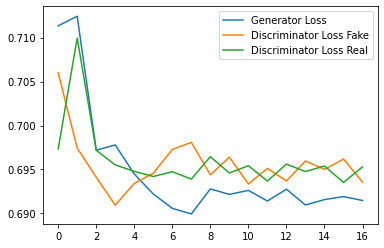

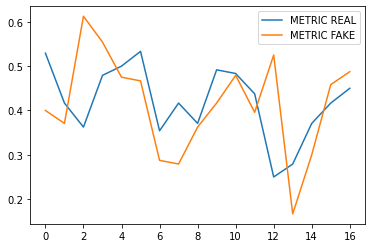

Step 400: Generator loss: 0.6924972709019979, discriminator loss: 0.7911426162719727
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


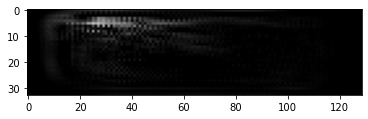

Espectrogramas Reales


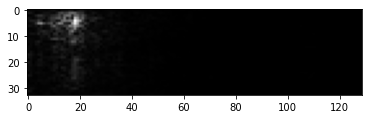

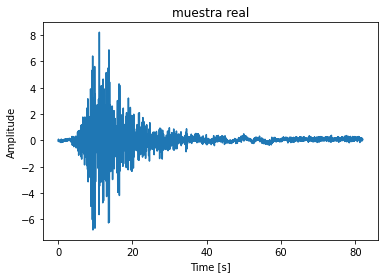

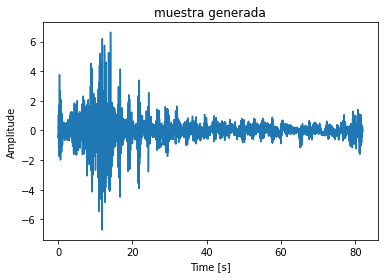

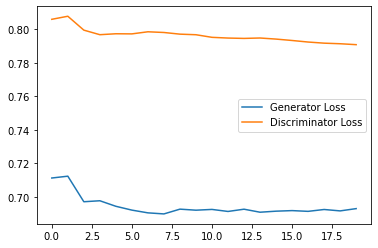

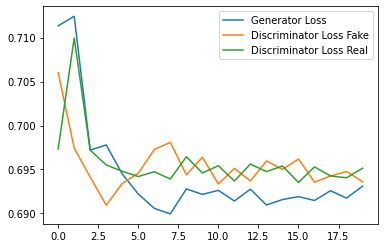

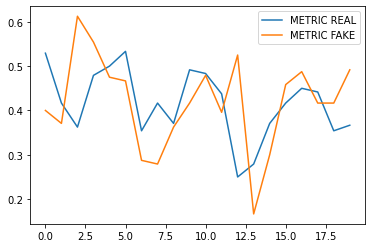

Step 450: Generator loss: 0.6921020030975343, discriminator loss: 0.7897041964530945
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


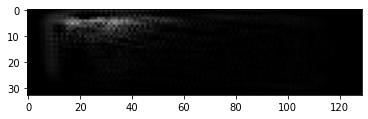

Espectrogramas Reales


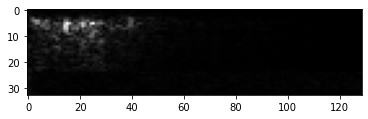

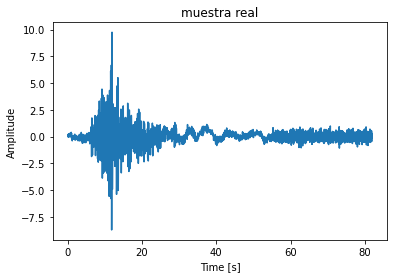

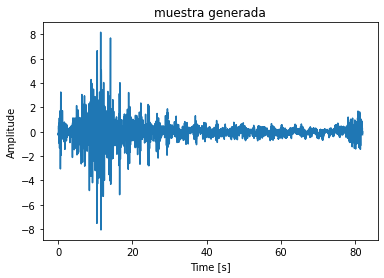

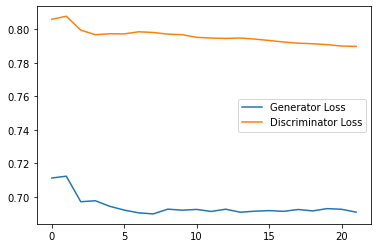

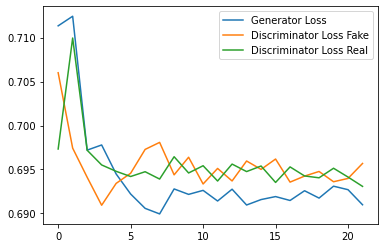

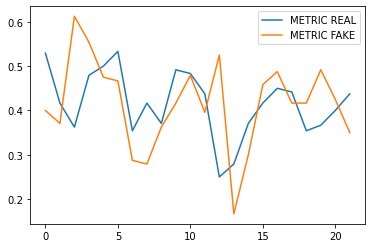

Step 500: Generator loss: 0.6919113790988923, discriminator loss: 0.7883789122104645
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


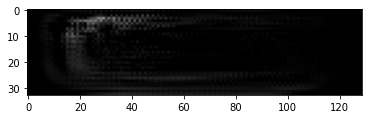

Espectrogramas Reales


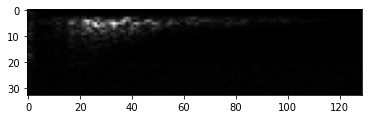

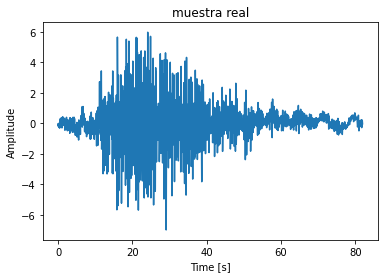

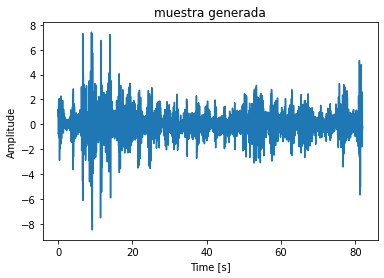

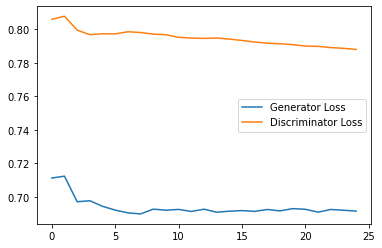

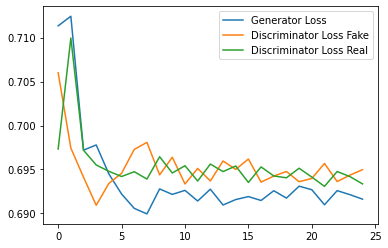

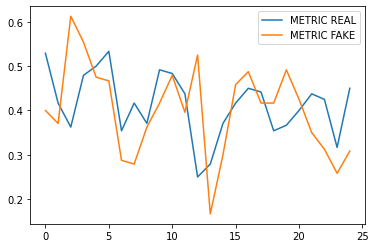

Epoch: 1


  0%|          | 0/513 [00:00<?, ?it/s]

Step 550: Generator loss: 0.6922707132498422, discriminator loss: 0.7866510546207428
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


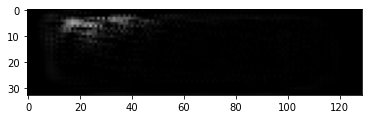

Espectrogramas Reales


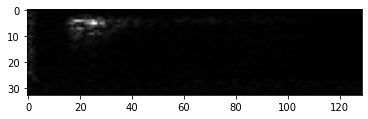

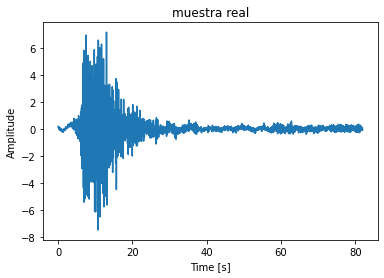

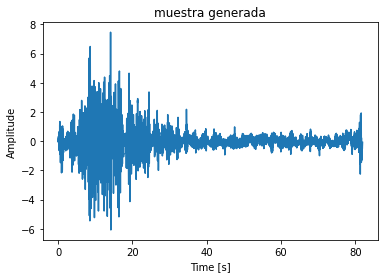

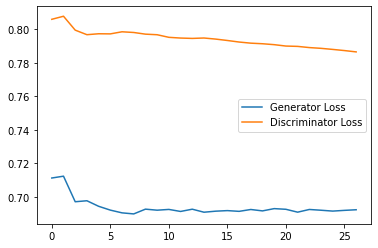

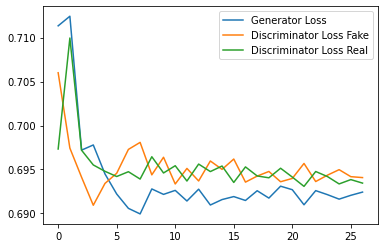

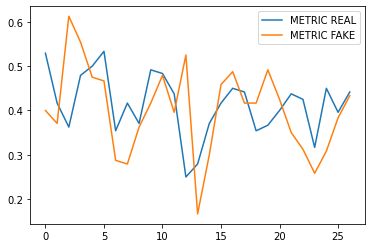

Step 600: Generator loss: 0.6925674982865649, discriminator loss: 0.7851507771015167
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


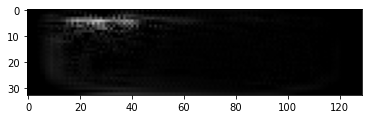

Espectrogramas Reales


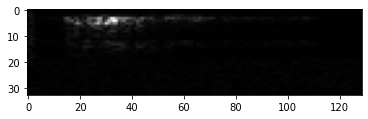

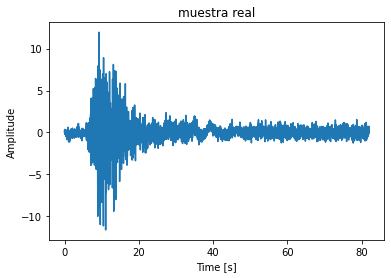

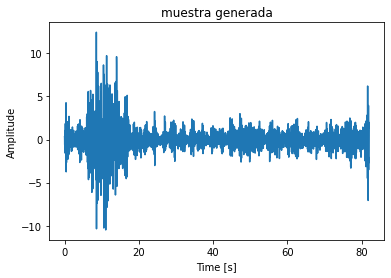

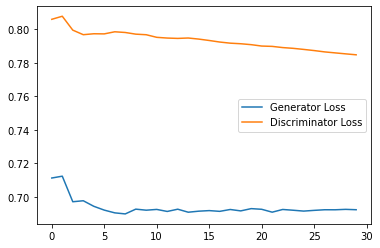

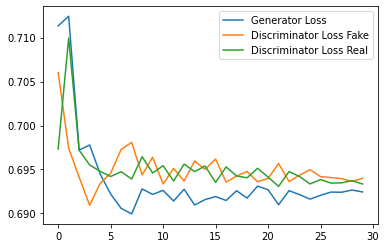

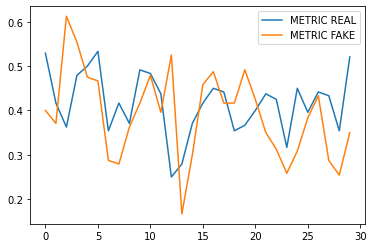

Step 650: Generator loss: 0.6926100420951845, discriminator loss: 0.7837772297859192
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


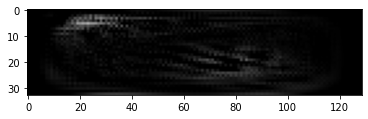

Espectrogramas Reales


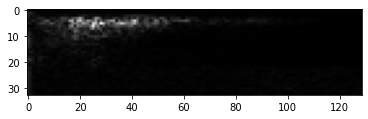

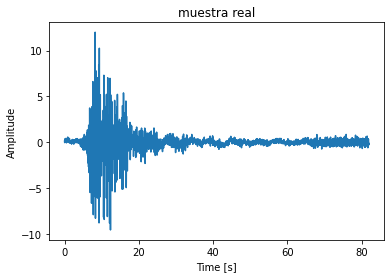

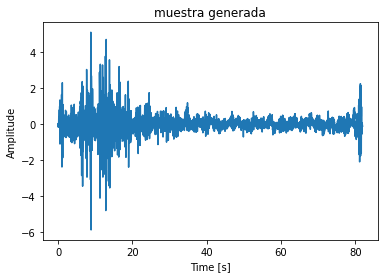

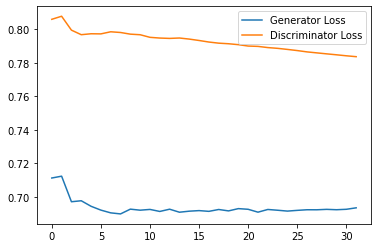

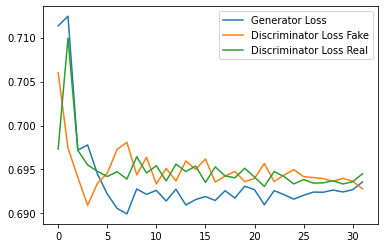

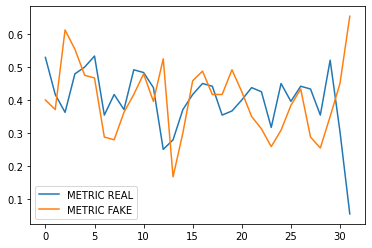

Step 700: Generator loss: 0.6927120244503021, discriminator loss: 0.7824283170700074
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


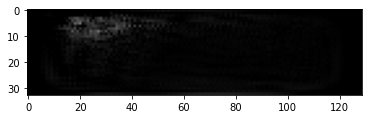

Espectrogramas Reales


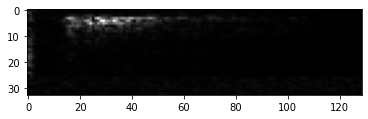

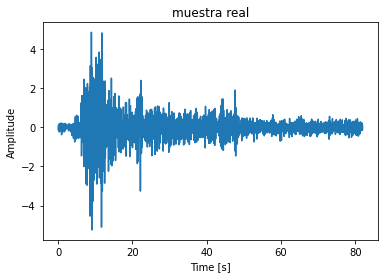

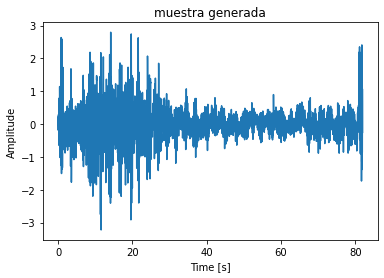

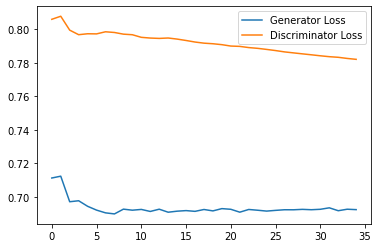

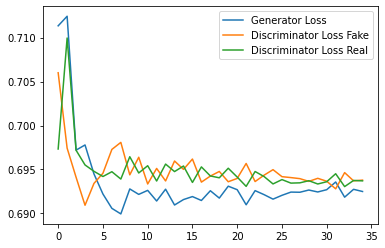

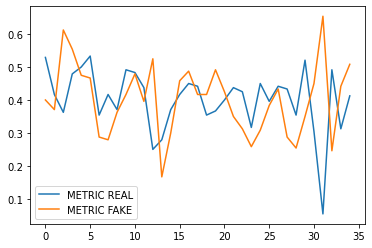

Step 750: Generator loss: 0.6926154637336731, discriminator loss: 0.7809018266201019
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


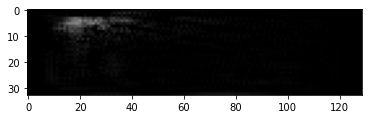

Espectrogramas Reales


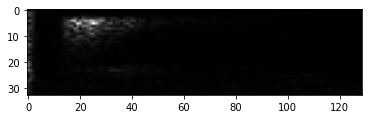

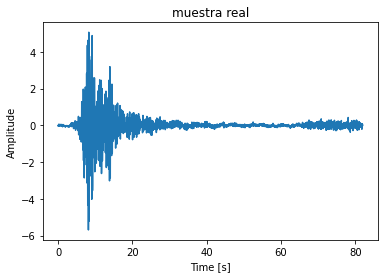

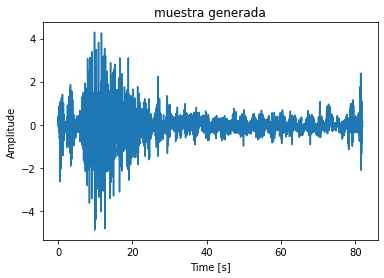

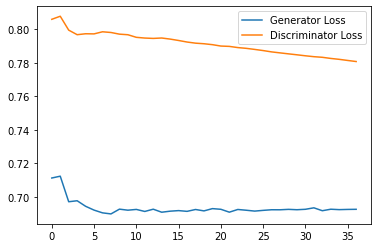

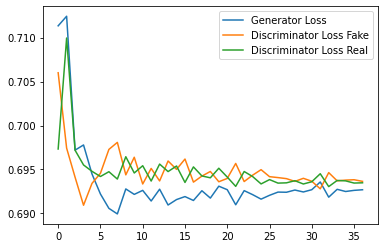

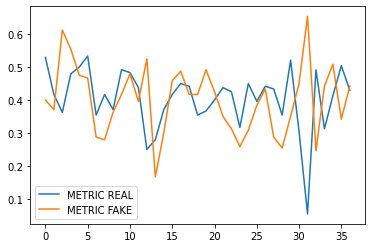

Step 800: Generator loss: 0.693002201318741, discriminator loss: 0.7793989622592926
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


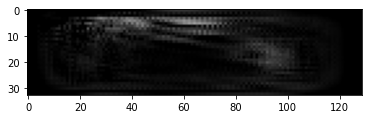

Espectrogramas Reales


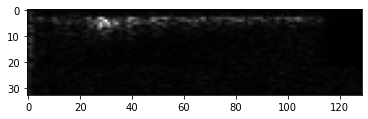

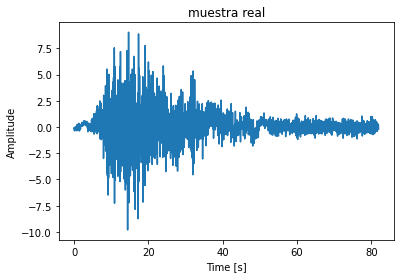

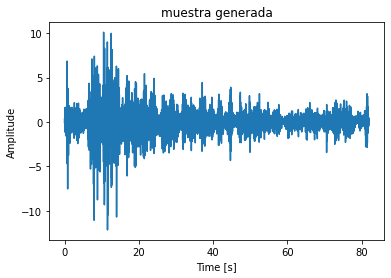

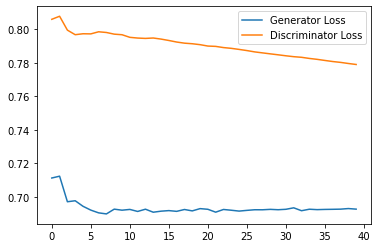

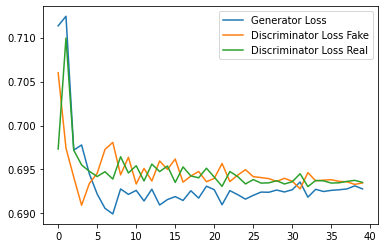

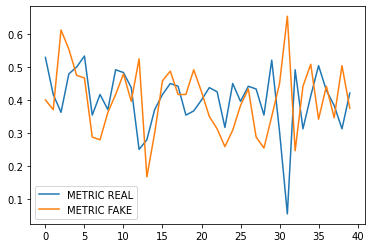

Step 850: Generator loss: 0.6927313923835754, discriminator loss: 0.7779056262969971
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


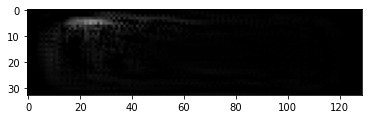

Espectrogramas Reales


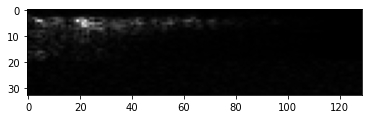

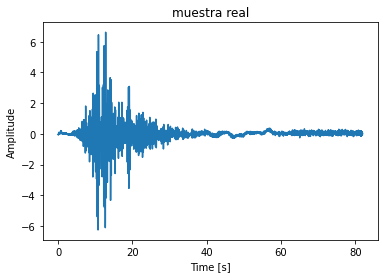

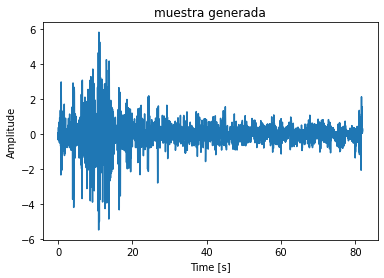

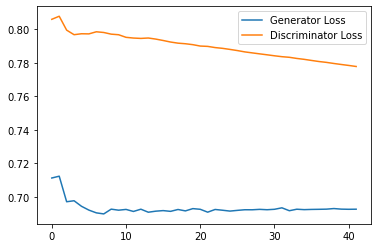

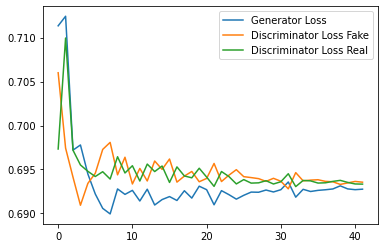

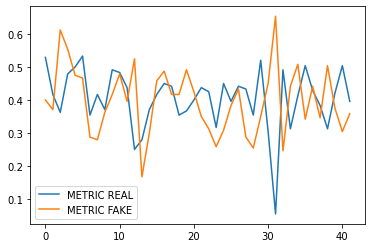

Step 900: Generator loss: 0.6929236614704131, discriminator loss: 0.7764507389068603
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


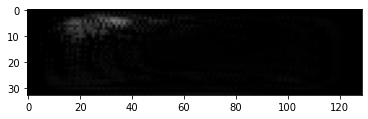

Espectrogramas Reales


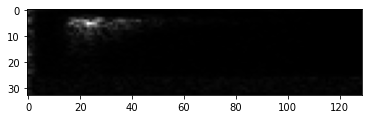

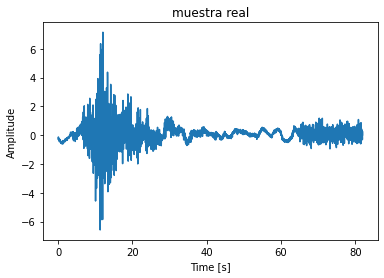

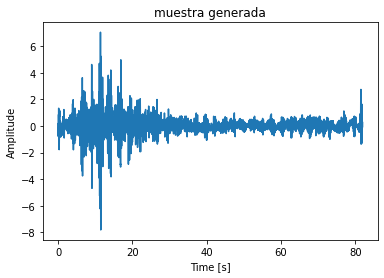

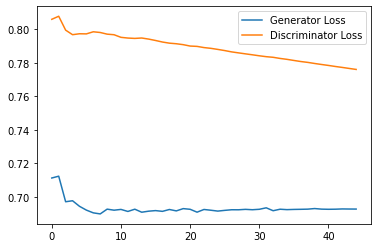

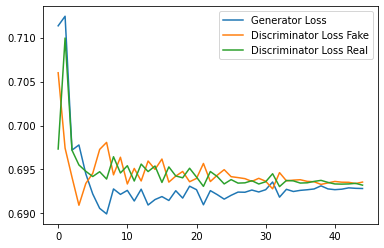

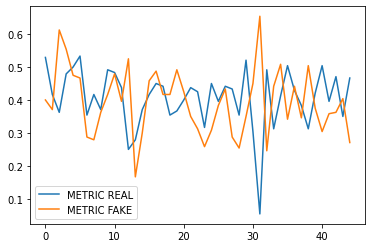

Step 950: Generator loss: 0.6930292693773904, discriminator loss: 0.7749393594264984
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


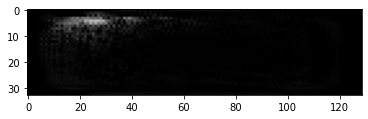

Espectrogramas Reales


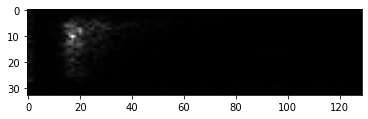

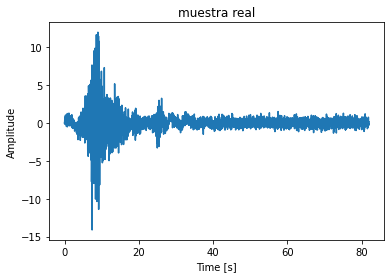

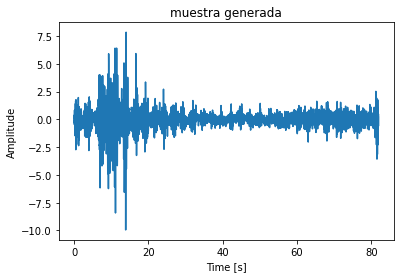

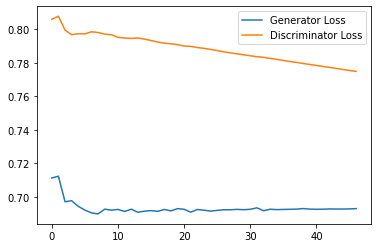

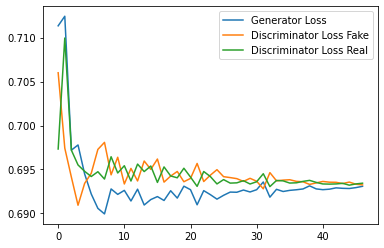

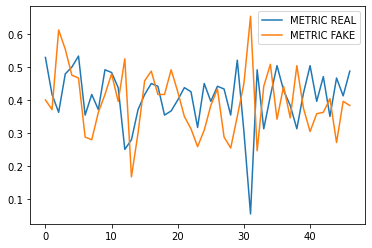

Step 1000: Generator loss: 0.6928565553824106, discriminator loss: 0.7735139727592468
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


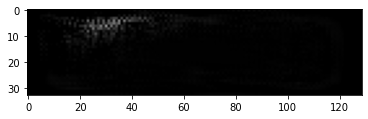

Espectrogramas Reales


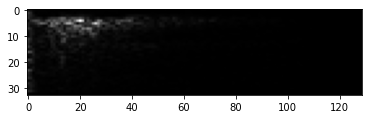

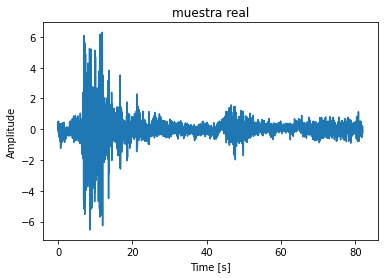

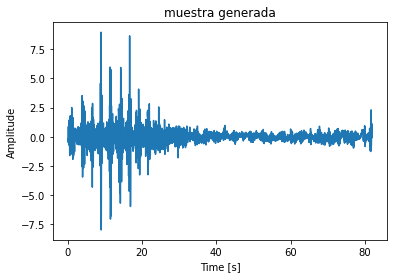

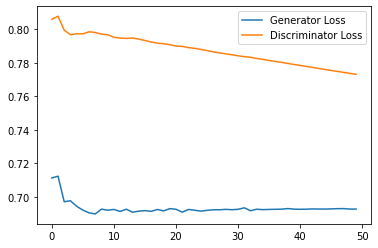

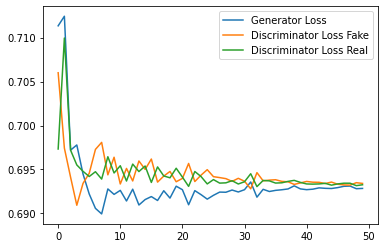

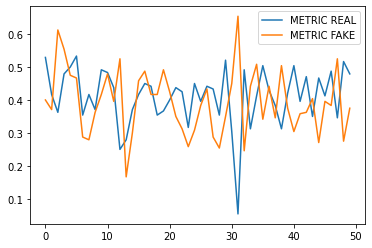

Epoch: 2


  0%|          | 0/513 [00:00<?, ?it/s]

Step 1050: Generator loss: 0.69328373948733, discriminator loss: 0.7720691299438477
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


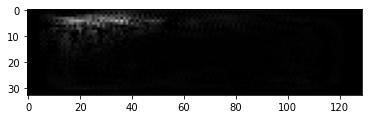

Espectrogramas Reales


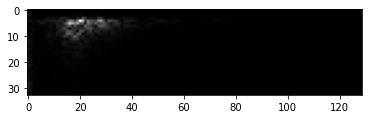

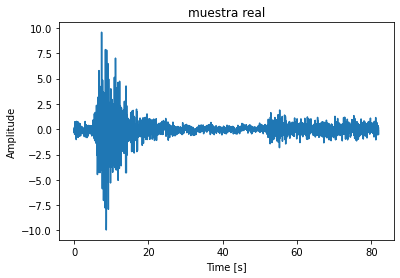

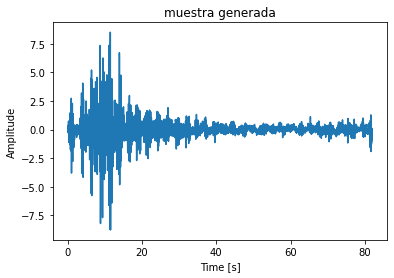

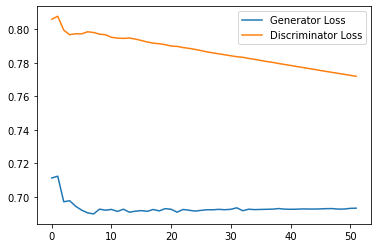

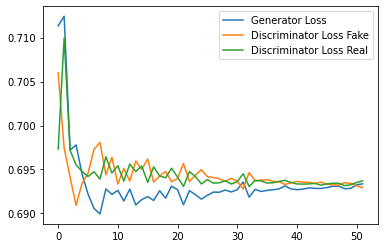

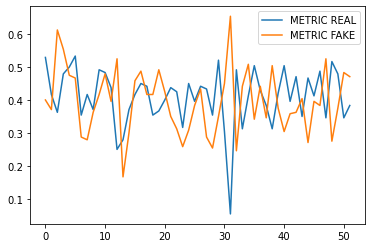

Step 1100: Generator loss: 0.6929757825533548, discriminator loss: 0.7706254875659942
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


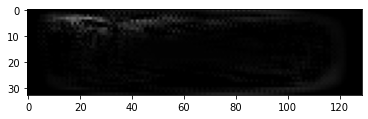

Espectrogramas Reales


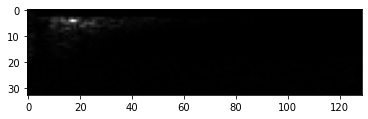

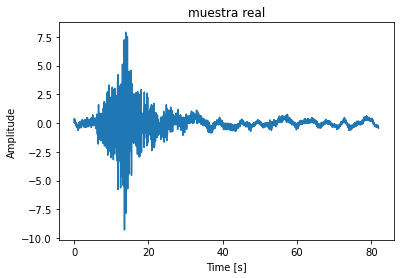

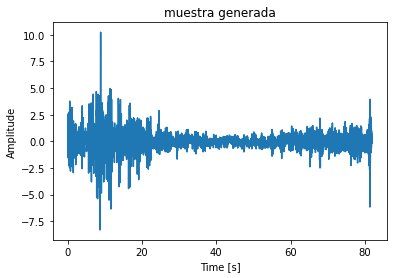

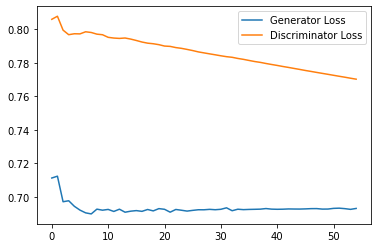

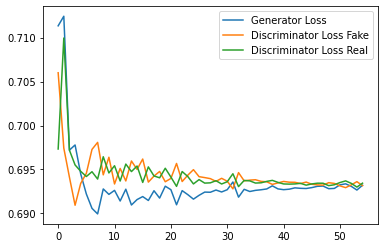

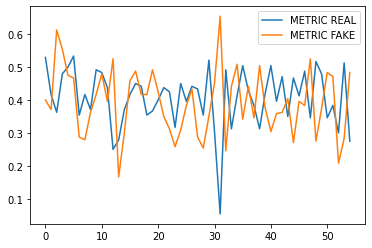

Step 1150: Generator loss: 0.6930129802227022, discriminator loss: 0.7691782605648041
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


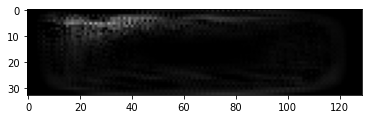

Espectrogramas Reales


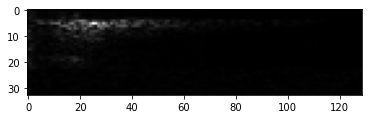

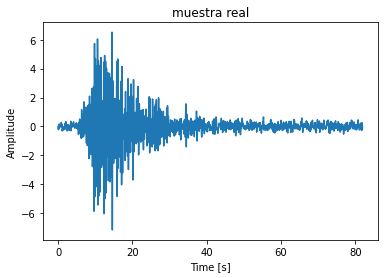

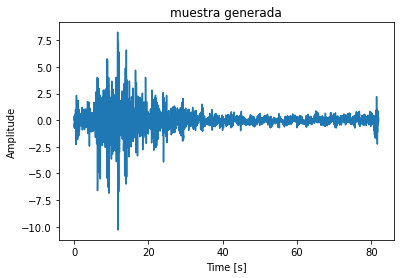

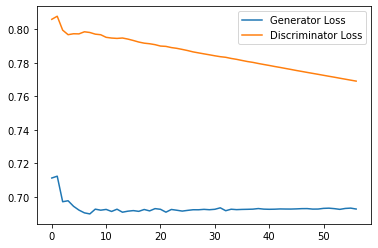

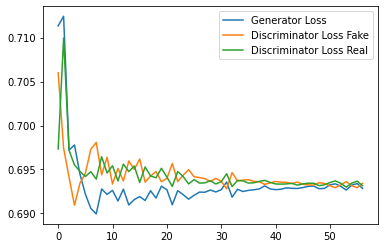

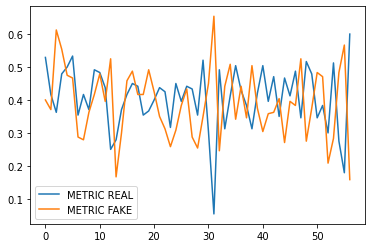

Step 1200: Generator loss: 0.6933051176865896, discriminator loss: 0.7678048801422119
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


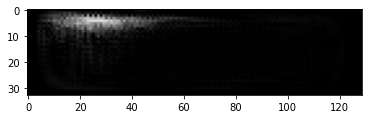

Espectrogramas Reales


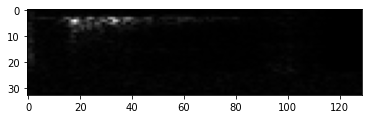

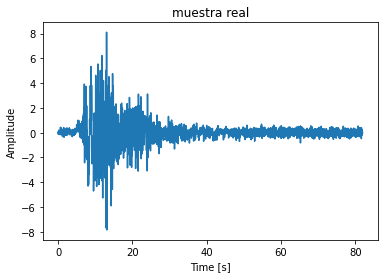

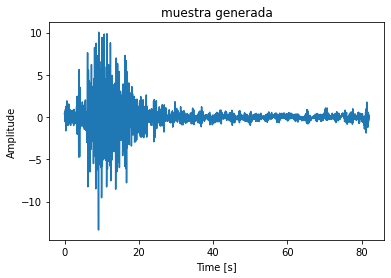

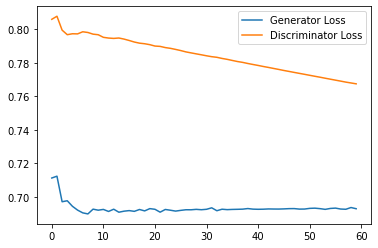

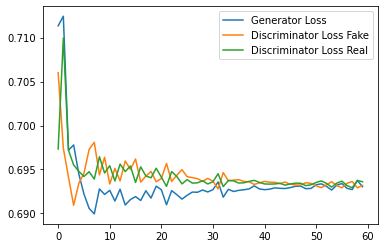

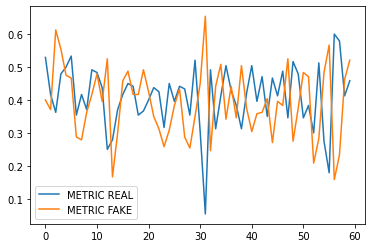

Step 1250: Generator loss: 0.6930130855242411, discriminator loss: 0.7663823449611664
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


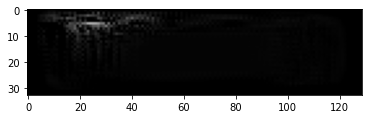

Espectrogramas Reales


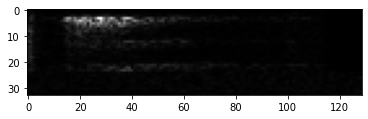

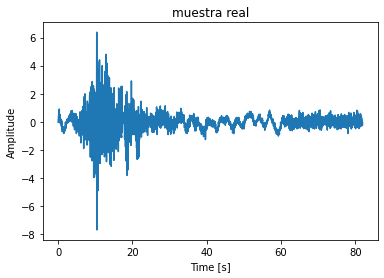

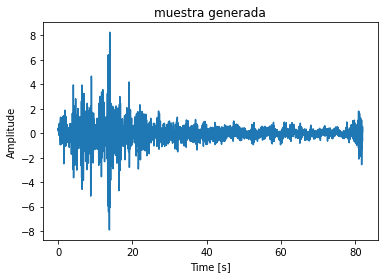

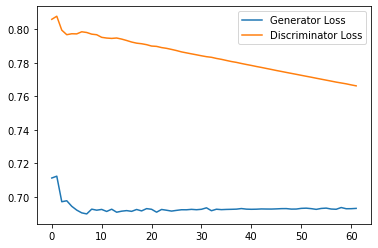

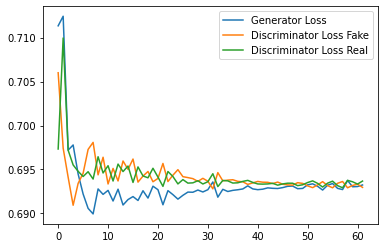

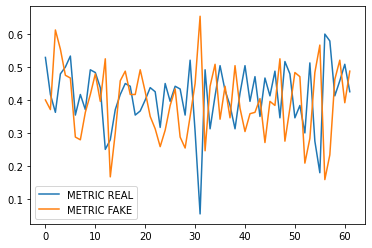

Step 1300: Generator loss: 0.6922204736868539, discriminator loss: 0.7650272142887116
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


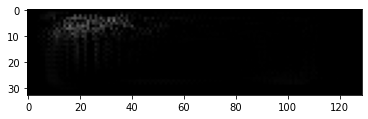

Espectrogramas Reales


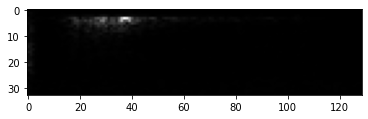

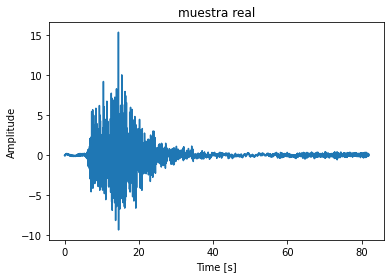

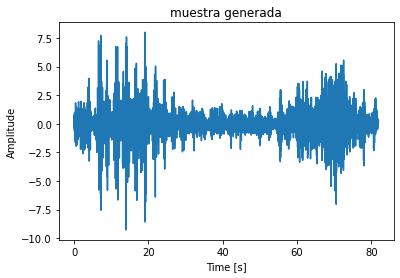

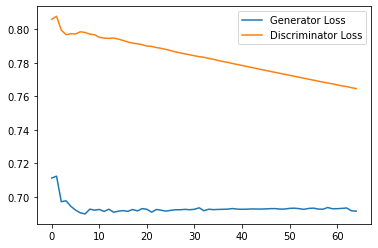

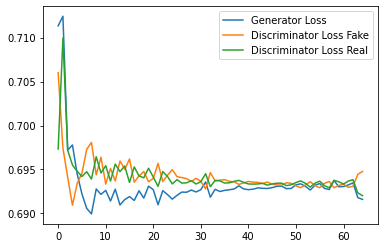

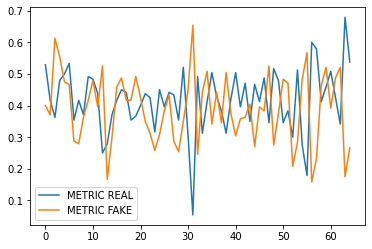

Step 1350: Generator loss: 0.69312136054039, discriminator loss: 0.763528220653534
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


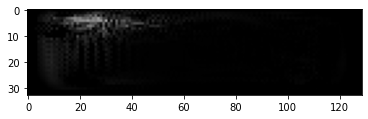

Espectrogramas Reales


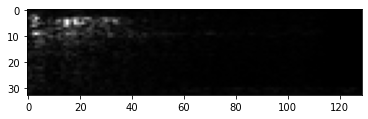

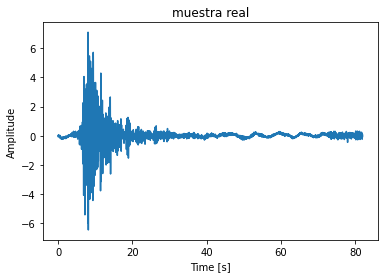

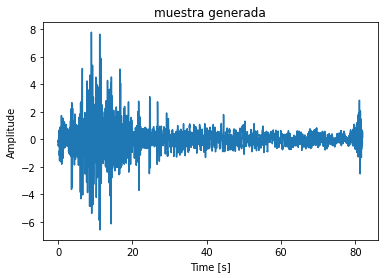

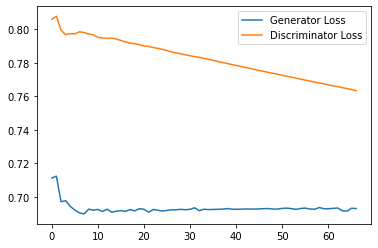

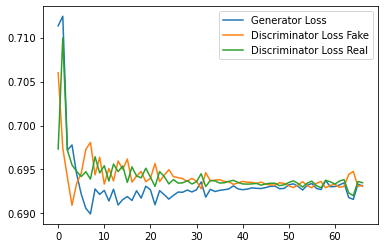

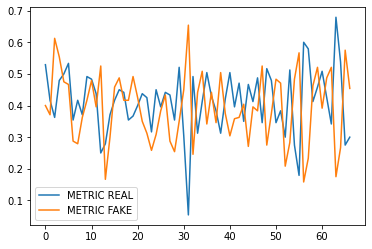

Step 1400: Generator loss: 0.6927752784887948, discriminator loss: 0.7620755124092102
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


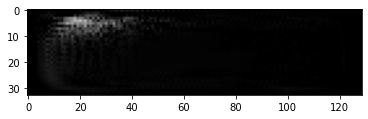

Espectrogramas Reales


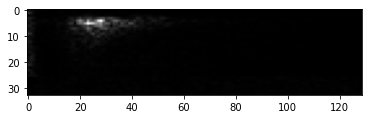

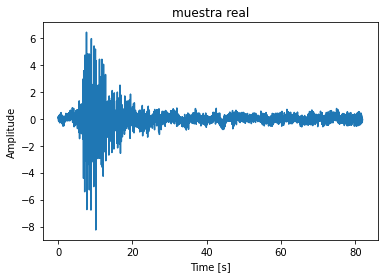

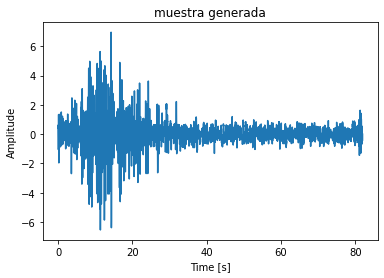

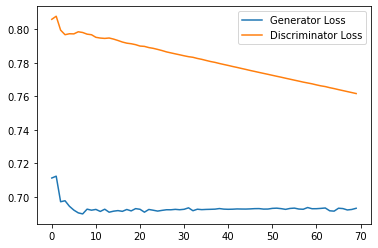

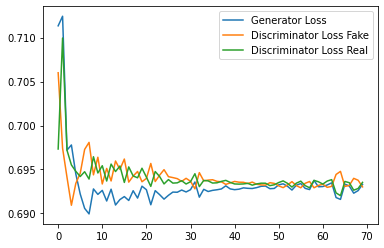

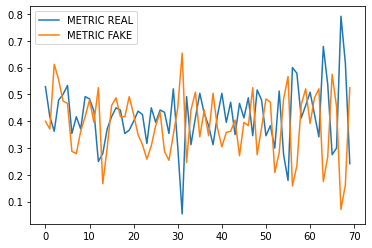

Step 1450: Generator loss: 0.6931685384114584, discriminator loss: 0.7606328666210175
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


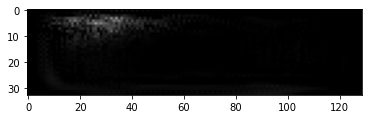

Espectrogramas Reales


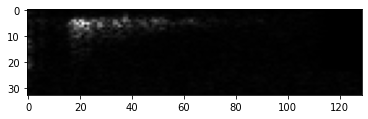

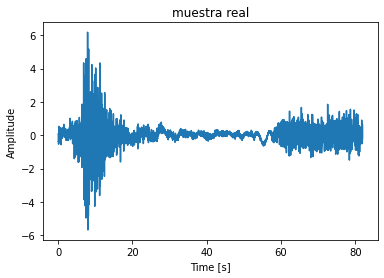

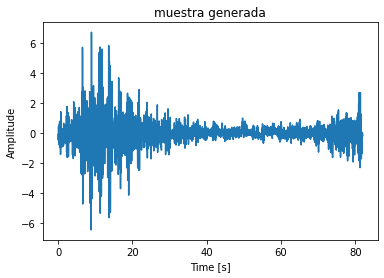

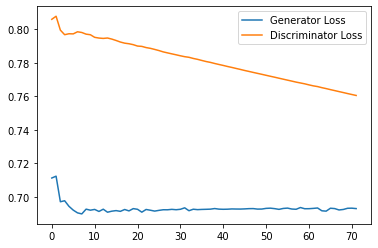

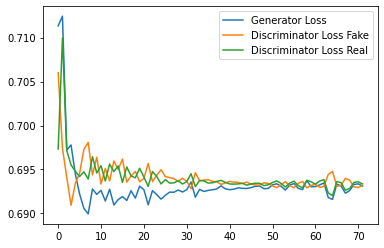

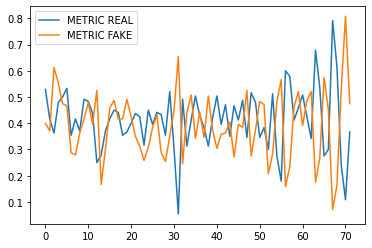

Step 1500: Generator loss: 0.6930505299568176, discriminator loss: 0.7592056417465209
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


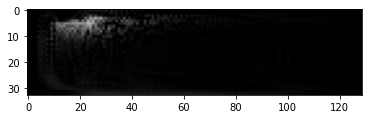

Espectrogramas Reales


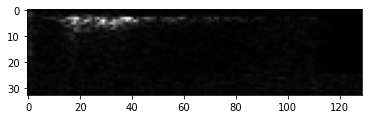

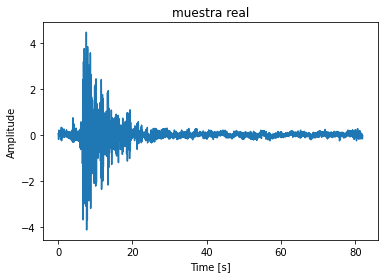

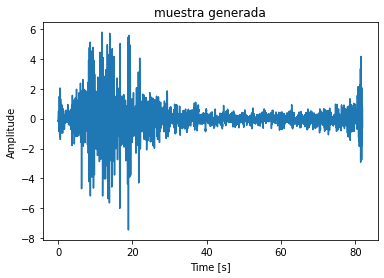

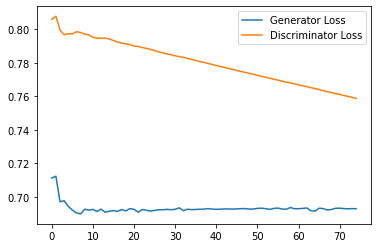

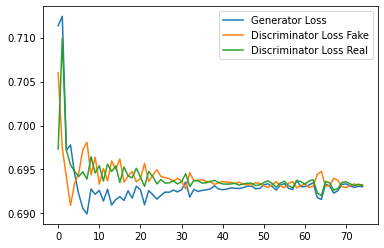

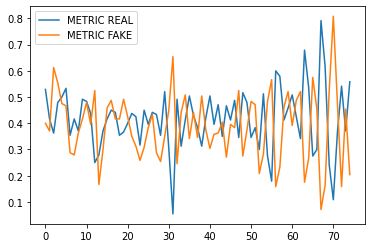

Epoch: 3


  0%|          | 0/513 [00:00<?, ?it/s]

Step 1550: Generator loss: 0.6931029272079466, discriminator loss: 0.7578013384342194
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


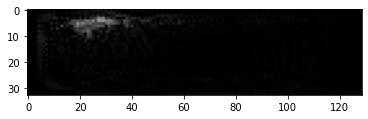

Espectrogramas Reales


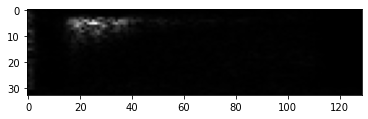

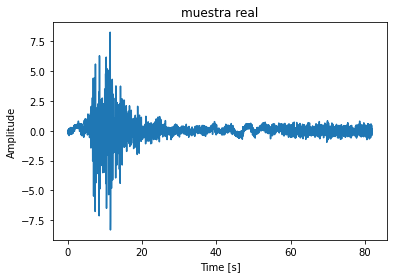

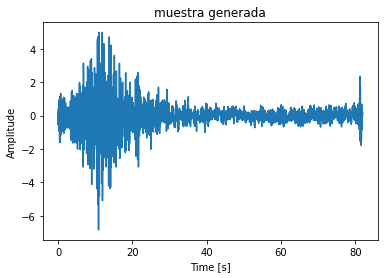

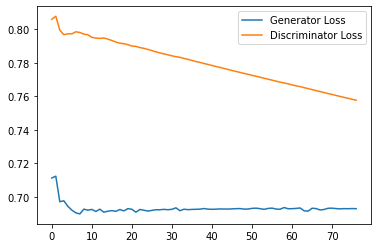

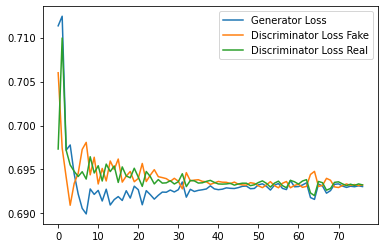

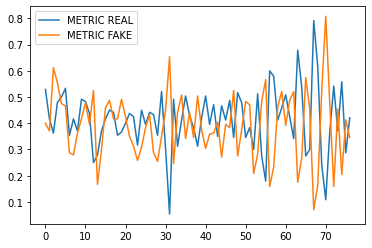

Step 1600: Generator loss: 0.6931479700406393, discriminator loss: 0.7563872241973877
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


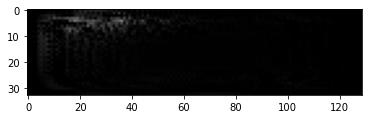

Espectrogramas Reales


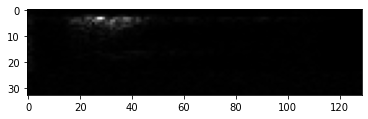

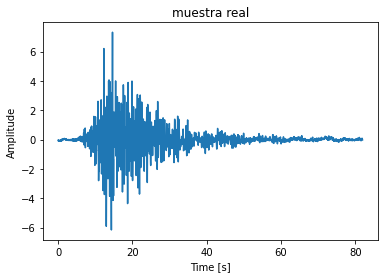

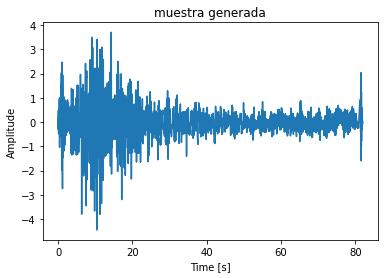

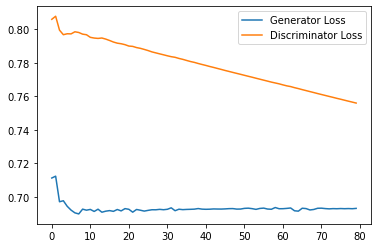

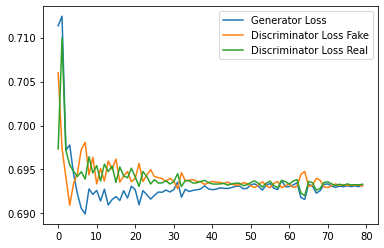

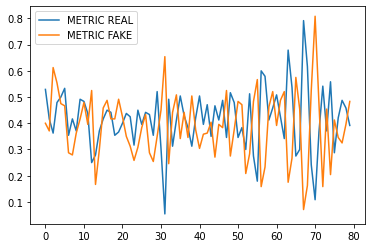

Step 1650: Generator loss: 0.6931486546993259, discriminator loss: 0.7549814581871033
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


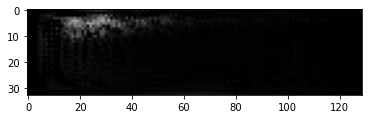

Espectrogramas Reales


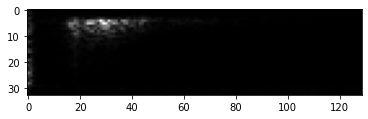

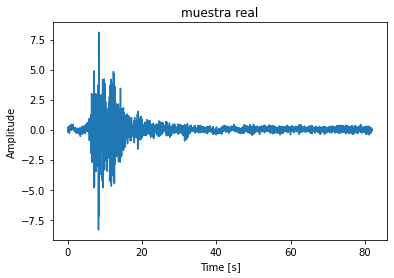

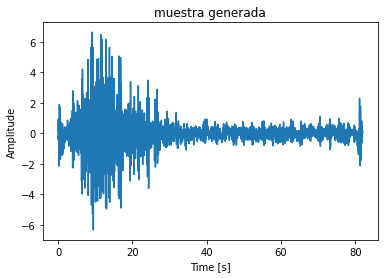

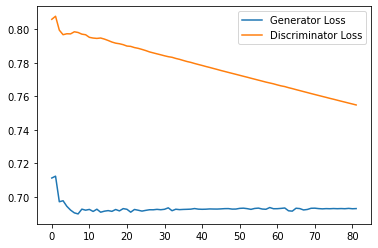

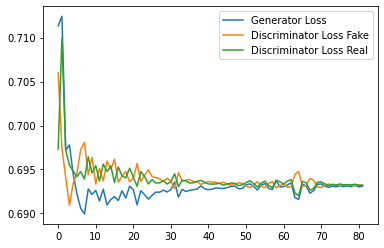

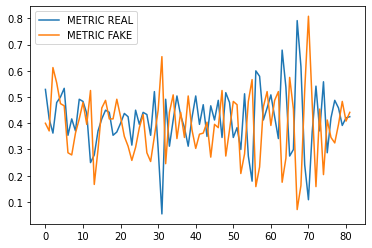

Step 1700: Generator loss: 0.6933661476771037, discriminator loss: 0.753597515821457
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


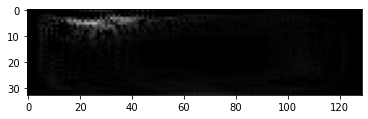

Espectrogramas Reales


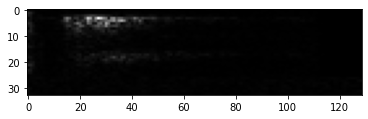

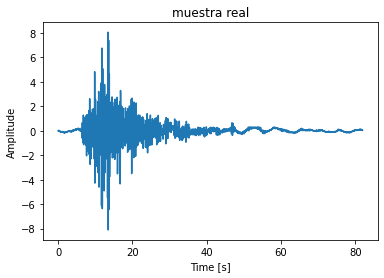

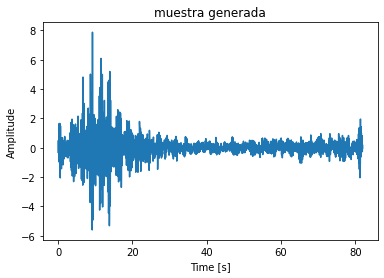

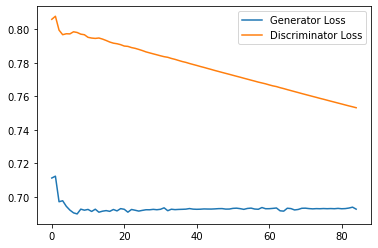

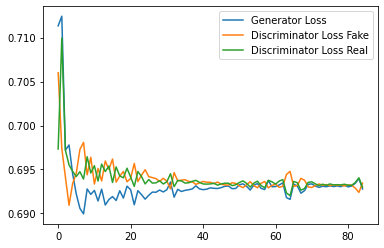

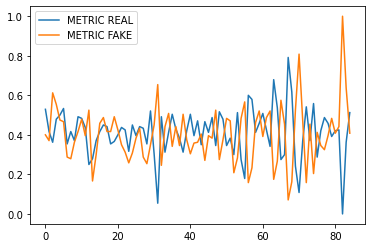

Step 1750: Generator loss: 0.6931587413946789, discriminator loss: 0.7522083711624146
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


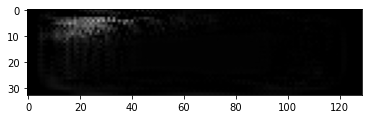

Espectrogramas Reales


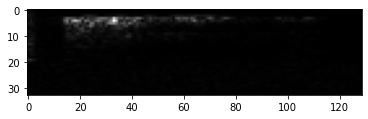

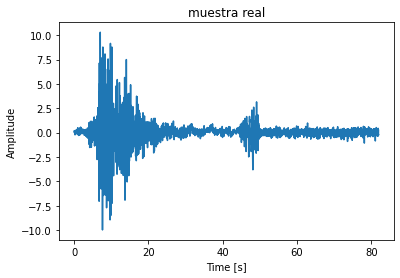

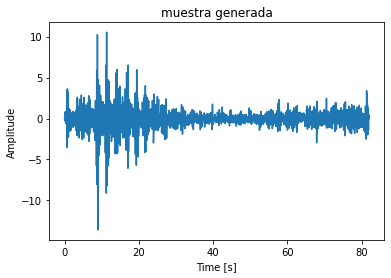

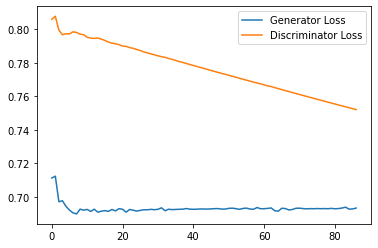

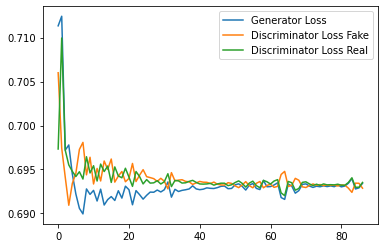

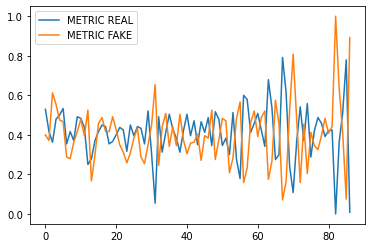

Step 1800: Generator loss: 0.6929515441258745, discriminator loss: 0.7508363258838654
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


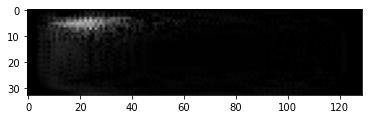

Espectrogramas Reales


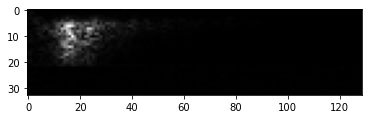

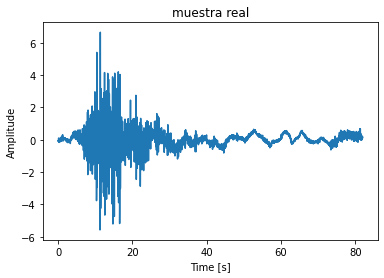

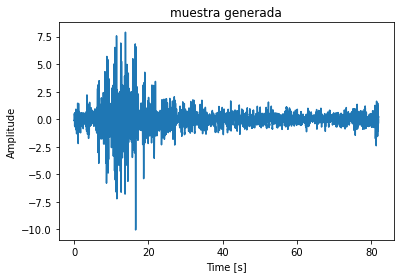

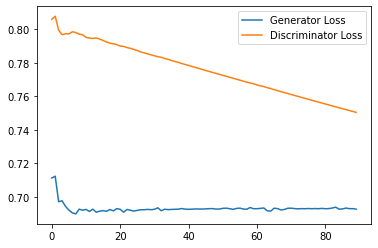

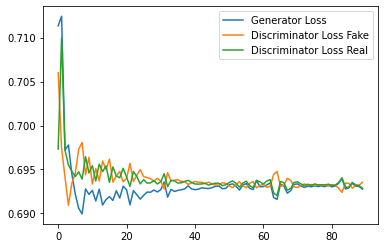

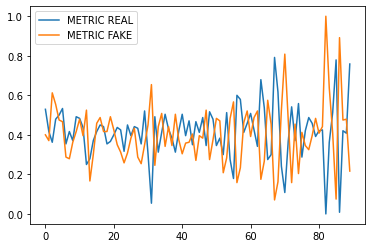

Step 1850: Generator loss: 0.6930296190579733, discriminator loss: 0.7494688844680786
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


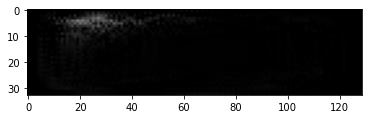

Espectrogramas Reales


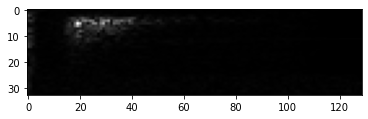

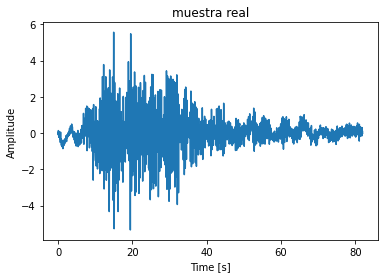

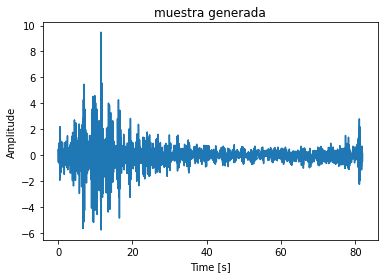

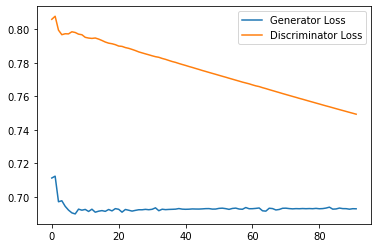

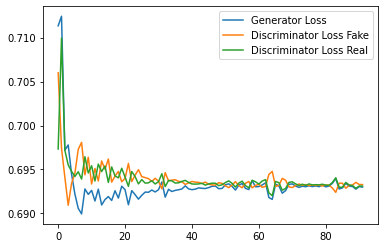

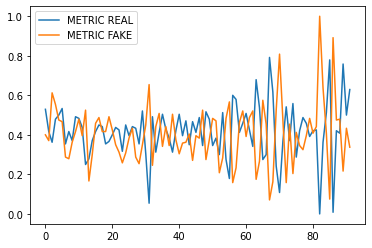

Step 1900: Generator loss: 0.6932127539316812, discriminator loss: 0.7481007385253906
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


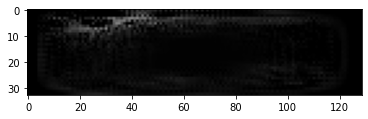

Espectrogramas Reales


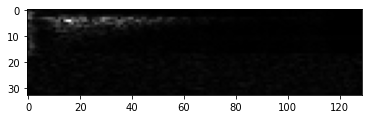

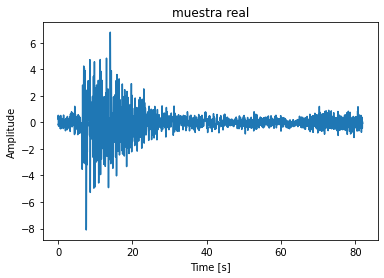

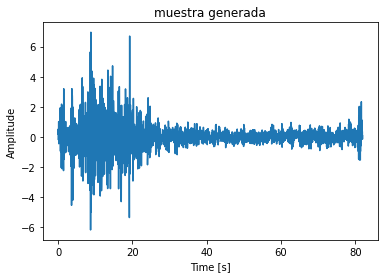

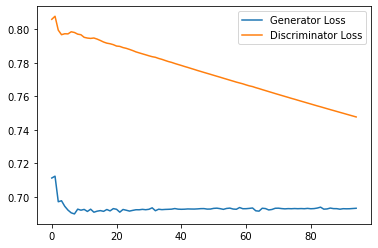

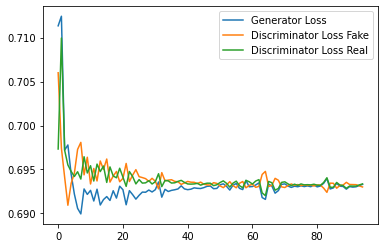

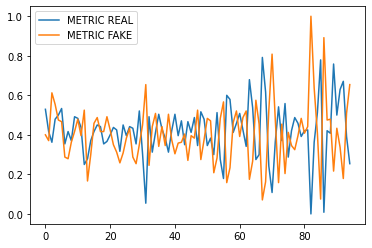

Step 1950: Generator loss: 0.6933498211701711, discriminator loss: 0.7467390513420105
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


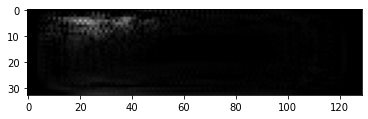

Espectrogramas Reales


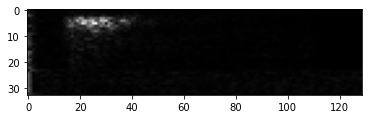

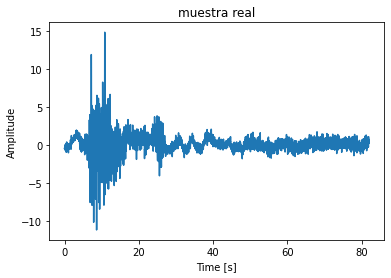

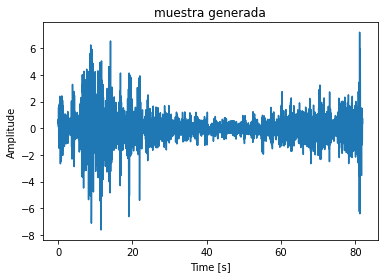

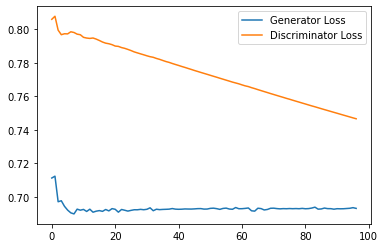

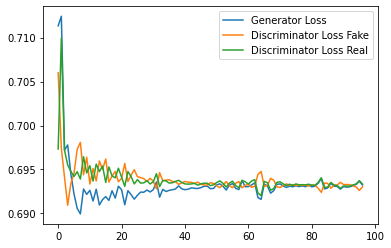

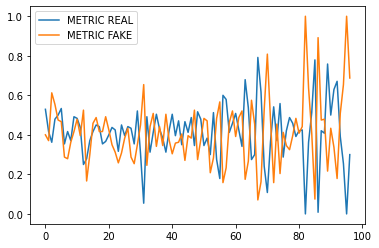

Step 2000: Generator loss: 0.693022964000702, discriminator loss: 0.7454102635383606
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


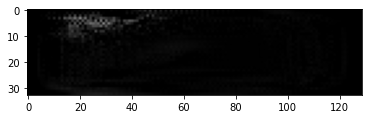

Espectrogramas Reales


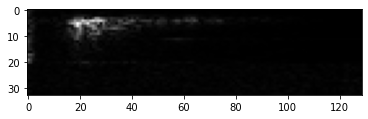

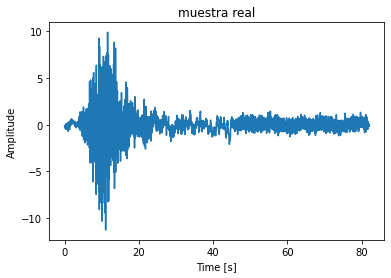

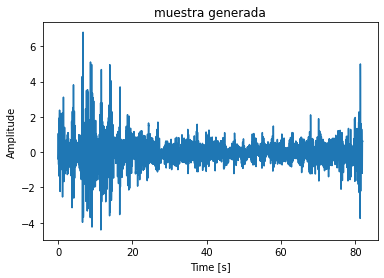

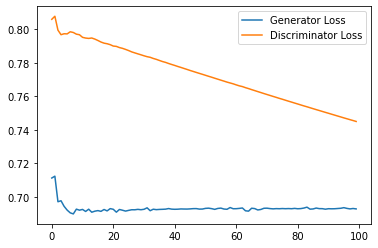

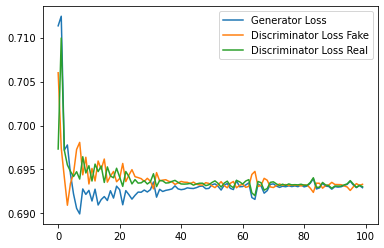

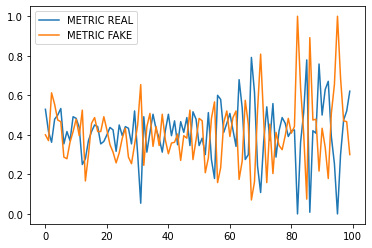

Step 2050: Generator loss: 0.6929906372229258, discriminator loss: 0.7440651559829712
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


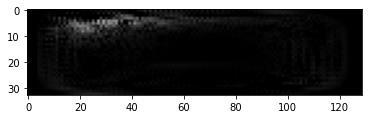

Espectrogramas Reales


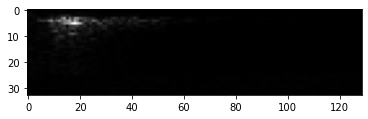

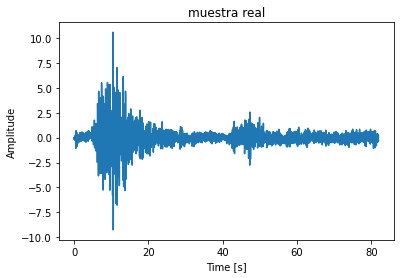

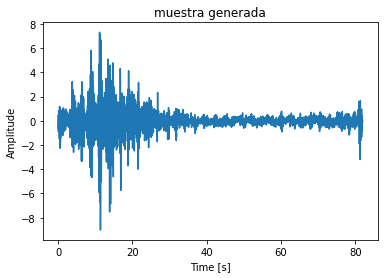

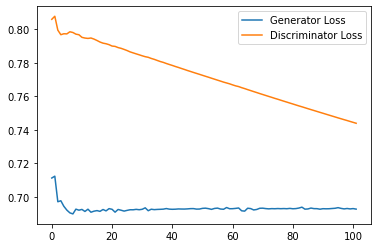

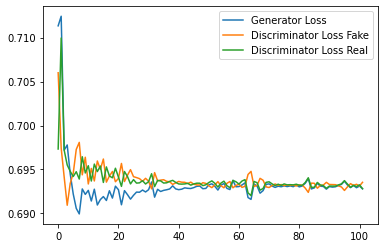

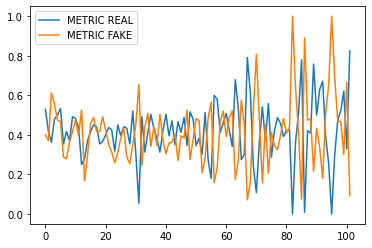

Epoch: 4


  0%|          | 0/513 [00:00<?, ?it/s]

Step 2100: Generator loss: 0.6930961557229359, discriminator loss: 0.742727472782135
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


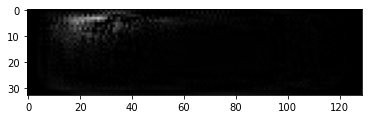

Espectrogramas Reales


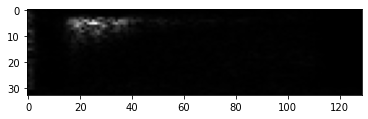

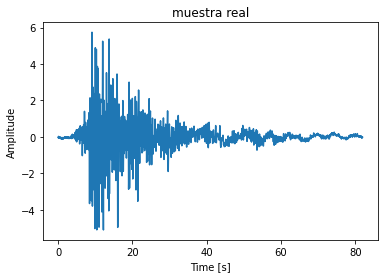

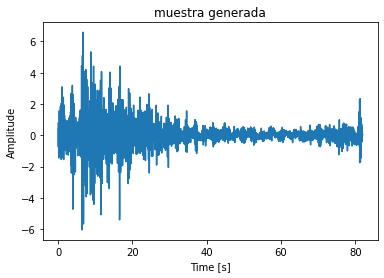

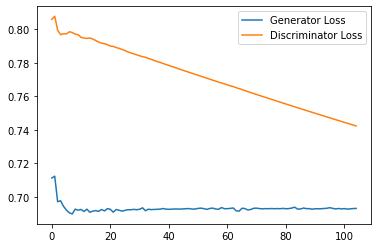

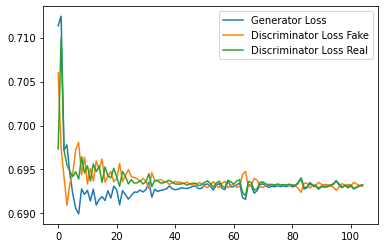

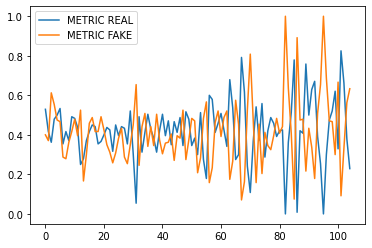

Step 2150: Generator loss: 0.6931498591105144, discriminator loss: 0.7414066803455353
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


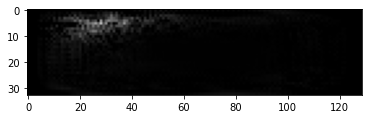

Espectrogramas Reales


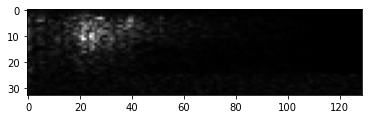

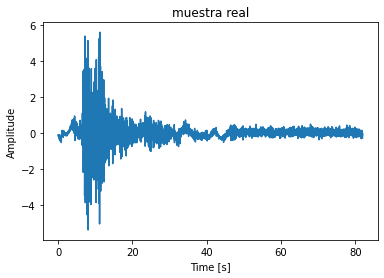

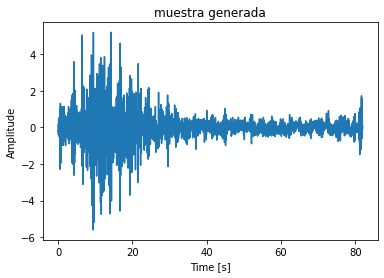

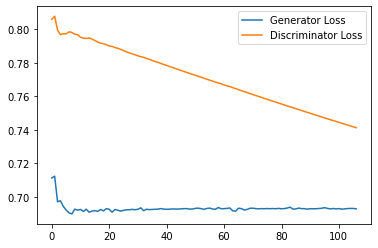

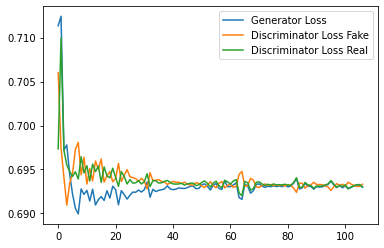

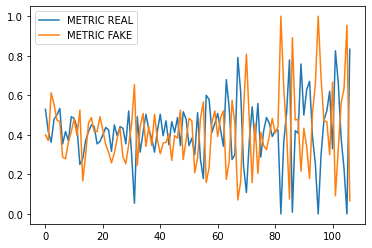

Step 2200: Generator loss: 0.693061137199402, discriminator loss: 0.7400845777988434
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


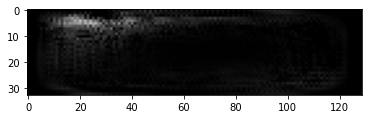

Espectrogramas Reales


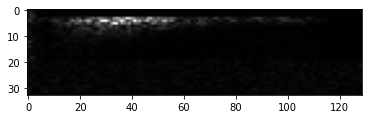

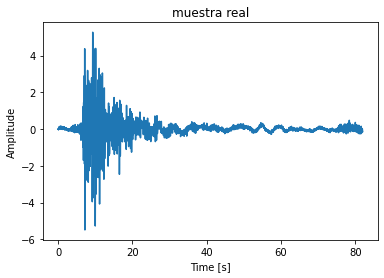

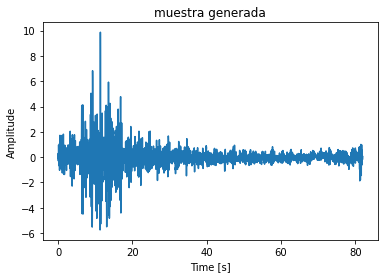

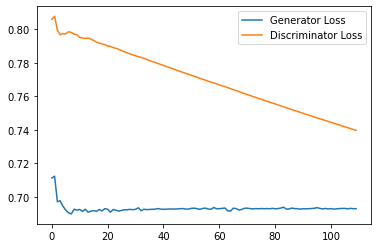

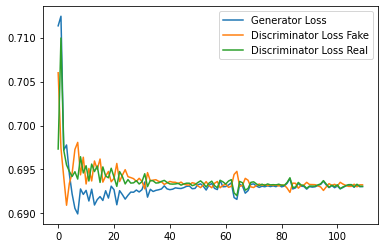

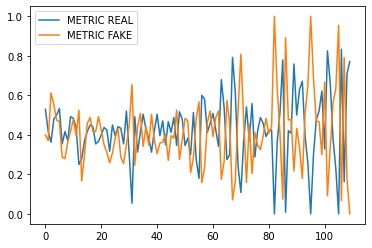

Step 2250: Generator loss: 0.6931064029534657, discriminator loss: 0.7387752032279968
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


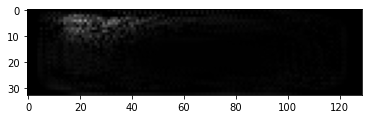

Espectrogramas Reales


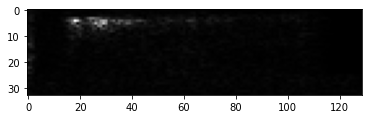

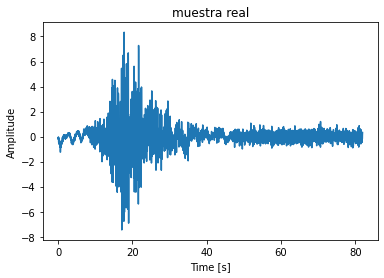

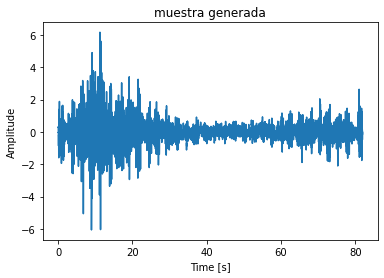

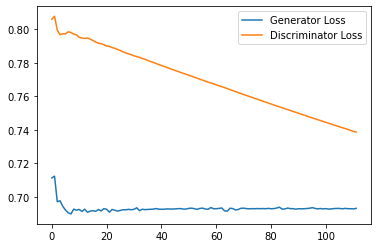

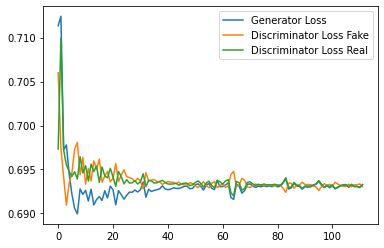

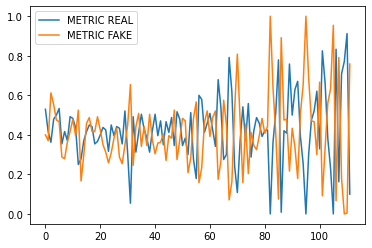

Step 2300: Generator loss: 0.693148327668508, discriminator loss: 0.7374719429016113
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


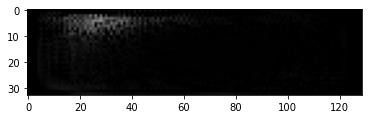

Espectrogramas Reales


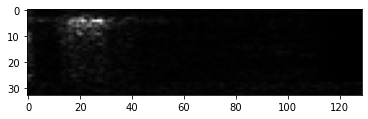

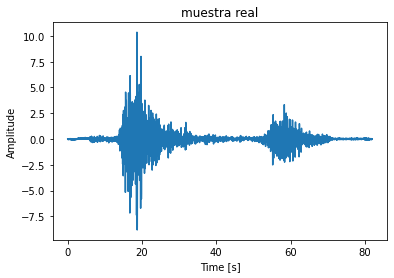

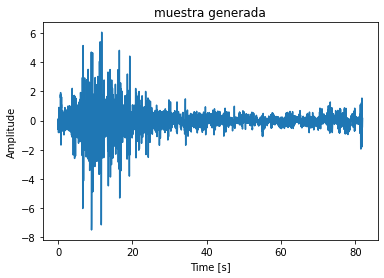

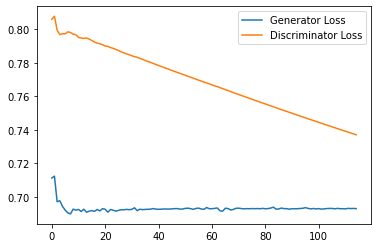

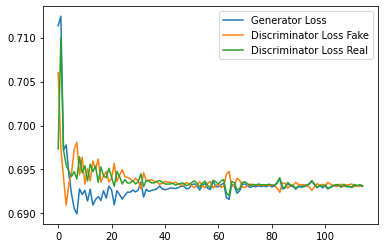

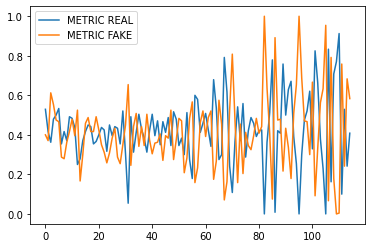

Step 2350: Generator loss: 0.6929625749588015, discriminator loss: 0.7361779320240021
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


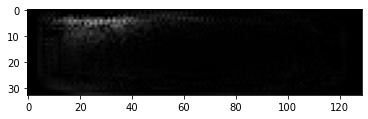

Espectrogramas Reales


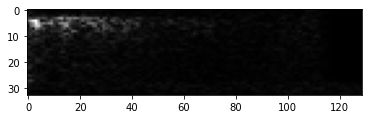

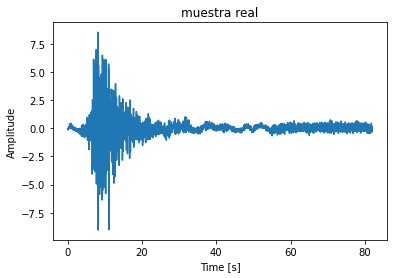

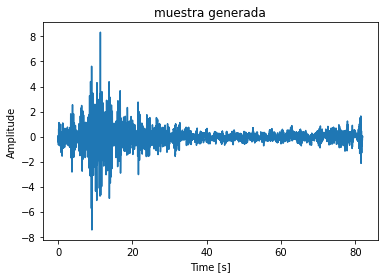

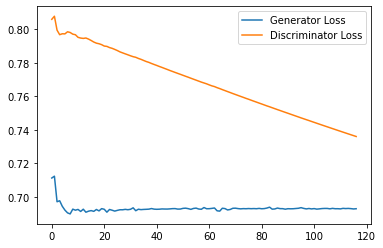

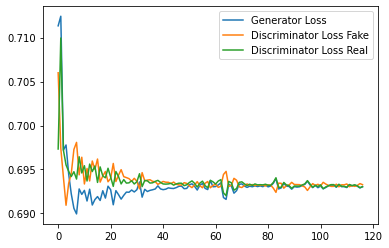

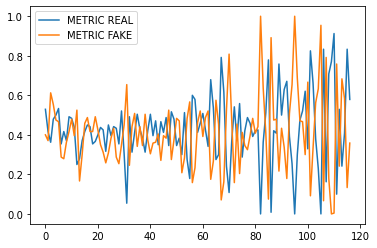

Step 2400: Generator loss: 0.6933025066057842, discriminator loss: 0.73489044547081
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


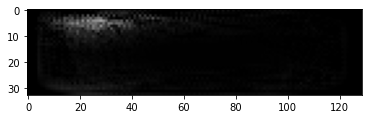

Espectrogramas Reales


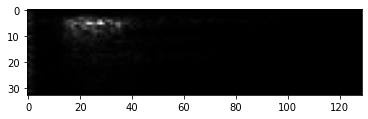

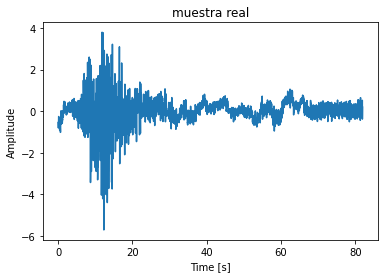

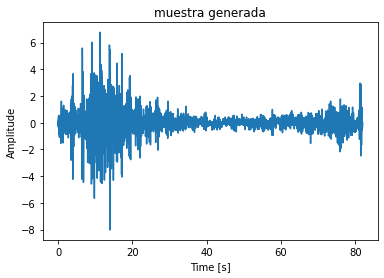

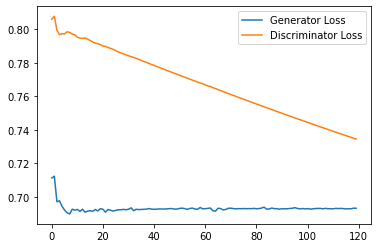

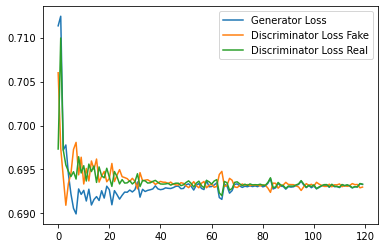

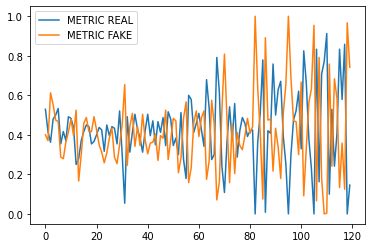

Step 2450: Generator loss: 0.6932044374942783, discriminator loss: 0.7336135327816009
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


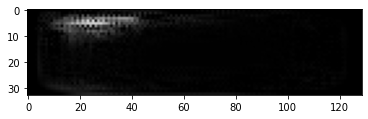

Espectrogramas Reales


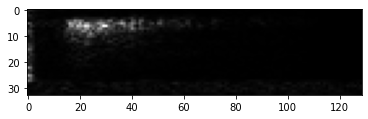

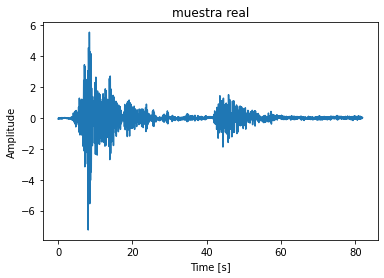

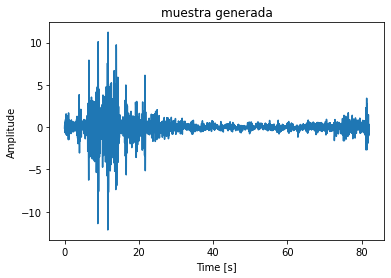

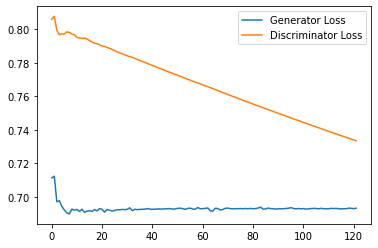

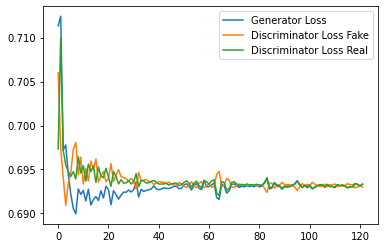

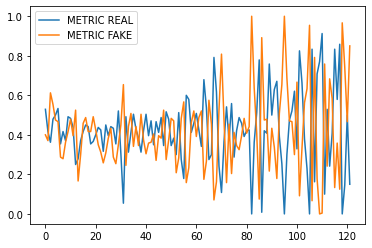

Step 2500: Generator loss: 0.6931319077809651, discriminator loss: 0.7323433470726013
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


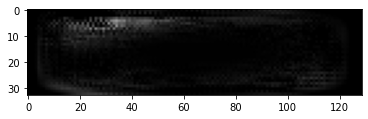

Espectrogramas Reales


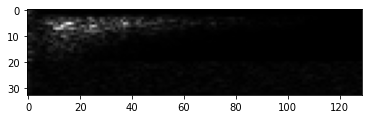

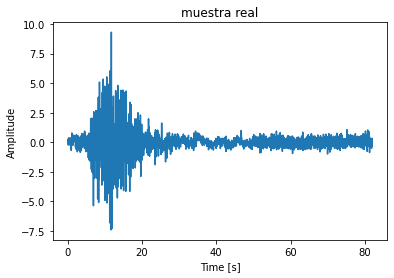

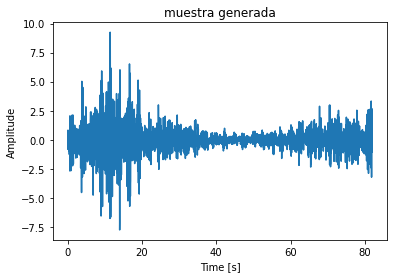

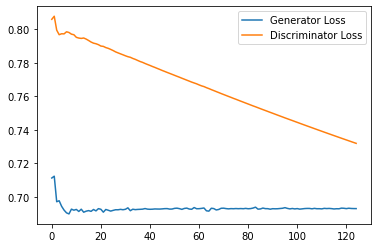

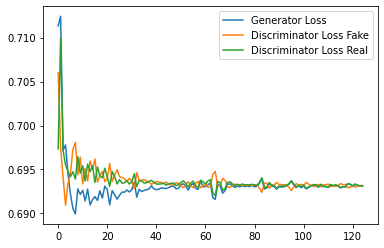

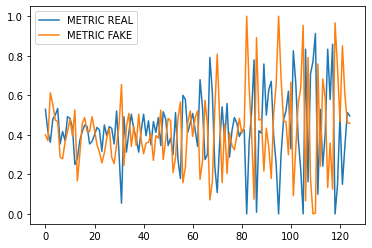

Step 2550: Generator loss: 0.6939851546287535, discriminator loss: 0.7310875475406646
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


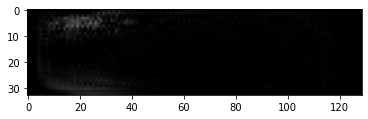

Espectrogramas Reales


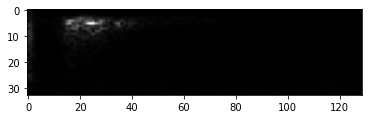

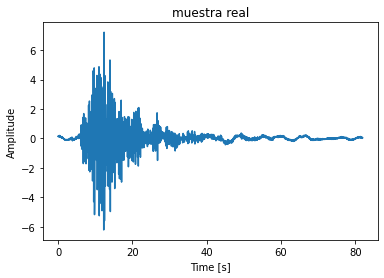

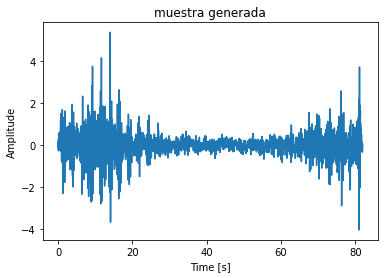

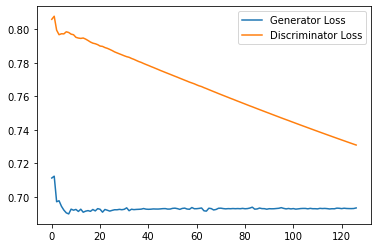

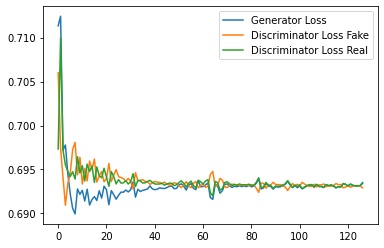

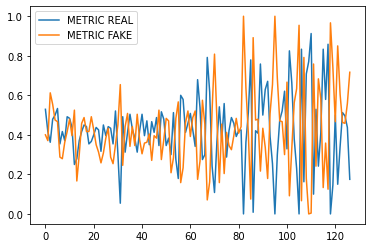

Epoch: 5


  0%|          | 0/513 [00:00<?, ?it/s]

Step 2600: Generator loss: 0.6927980407079058, discriminator loss: 0.7298436486721038
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


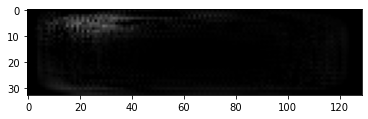

Espectrogramas Reales


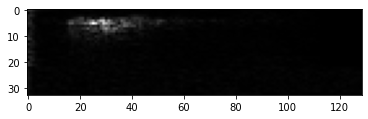

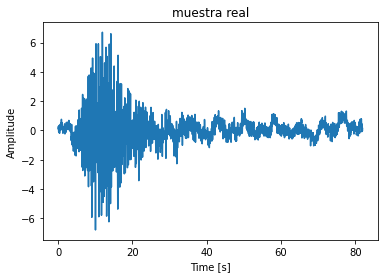

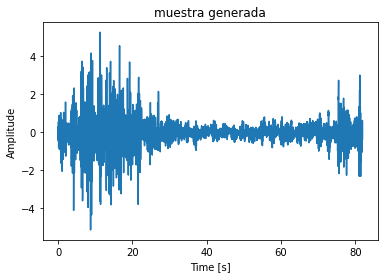

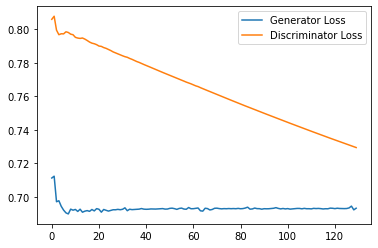

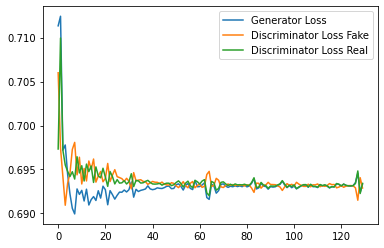

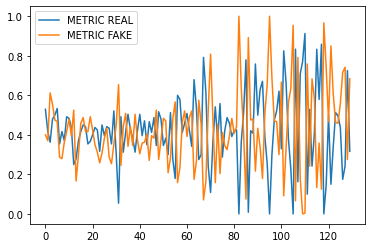

Step 2650: Generator loss: 0.6935424307982128, discriminator loss: 0.7285911583900452
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


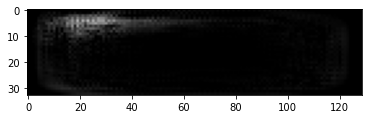

Espectrogramas Reales


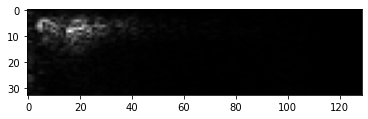

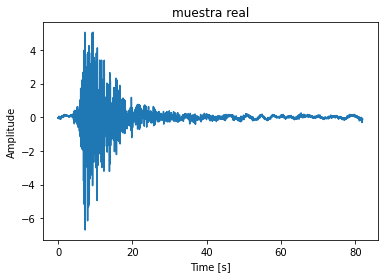

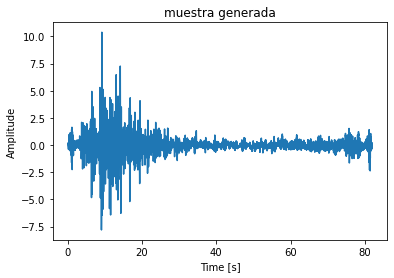

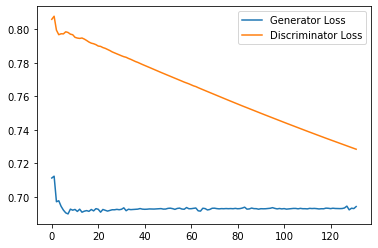

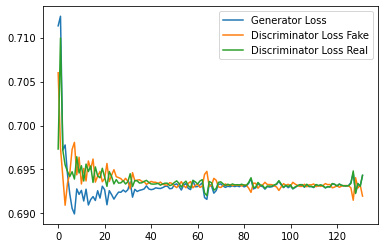

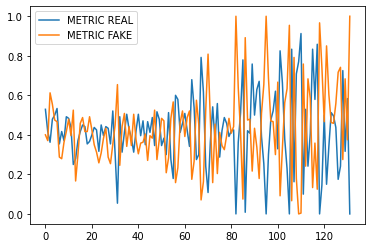

Step 2700: Generator loss: 0.69274010181427, discriminator loss: 0.7273544847965241
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


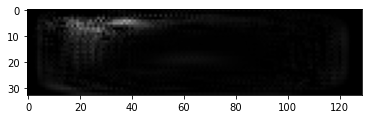

Espectrogramas Reales


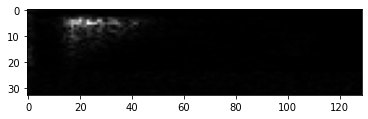

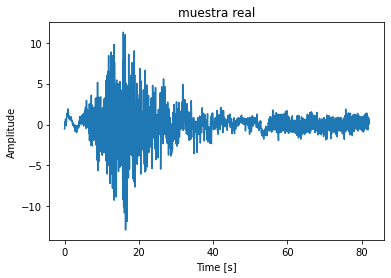

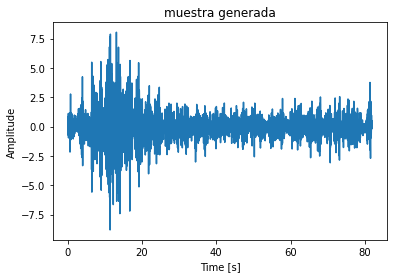

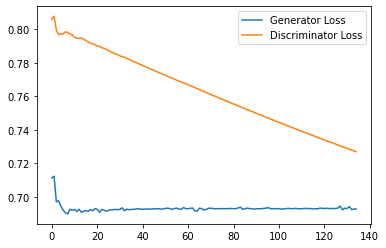

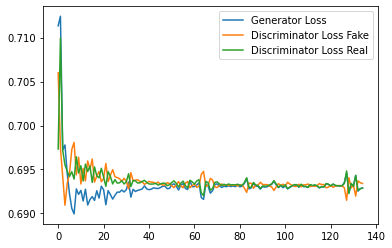

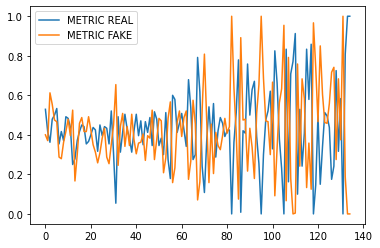

Step 2750: Generator loss: 0.6931701004505159, discriminator loss: 0.726125785112381
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


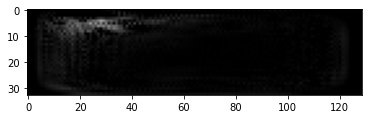

Espectrogramas Reales


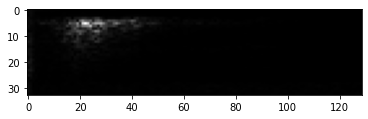

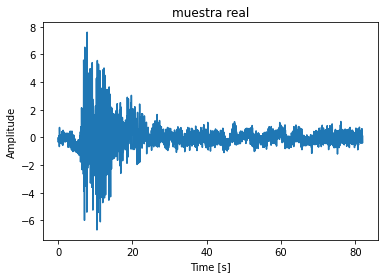

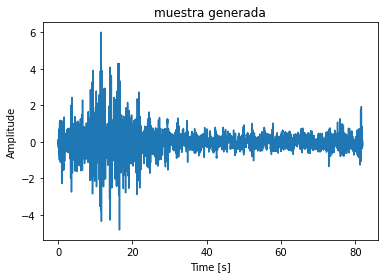

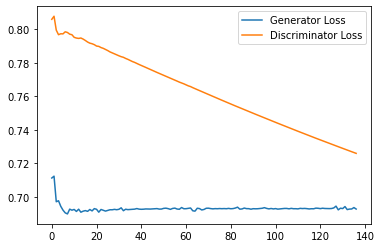

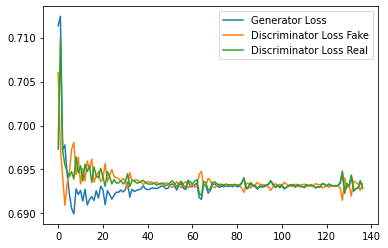

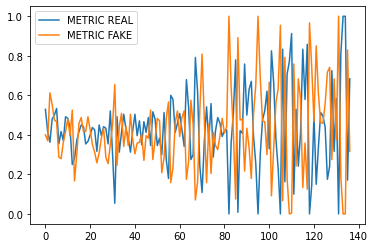

Step 2800: Generator loss: 0.6929337179660797, discriminator loss: 0.7249064731597901
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


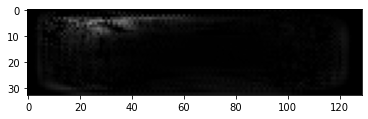

Espectrogramas Reales


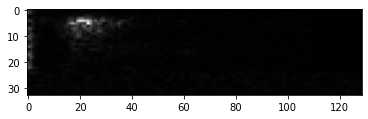

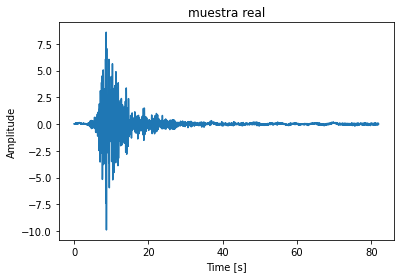

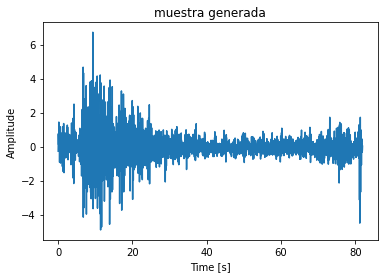

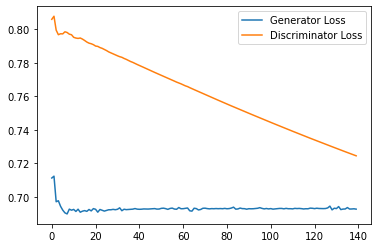

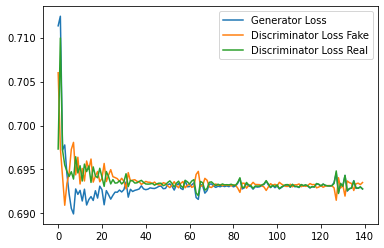

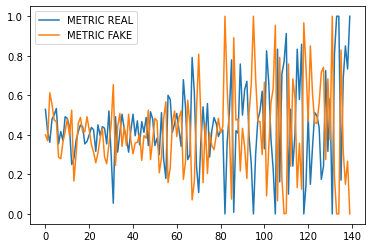

Step 2850: Generator loss: 0.6932463975747426, discriminator loss: 0.7236936450004577
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


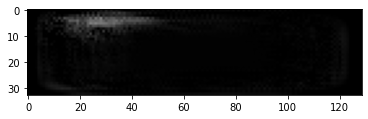

Espectrogramas Reales


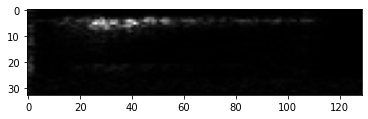

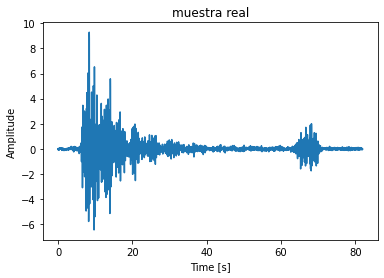

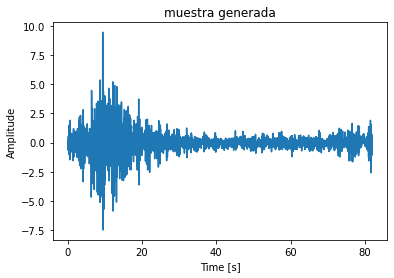

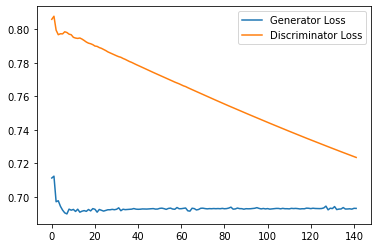

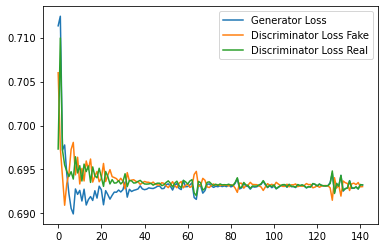

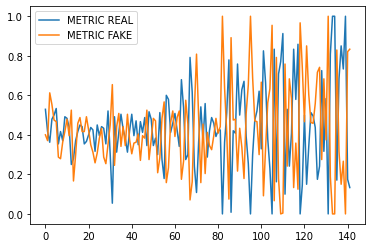

Step 2900: Generator loss: 0.693339690764745, discriminator loss: 0.7224903905391693
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


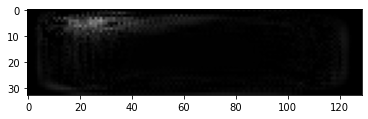

Espectrogramas Reales


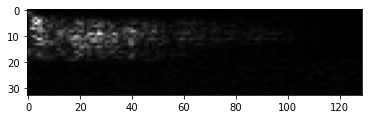

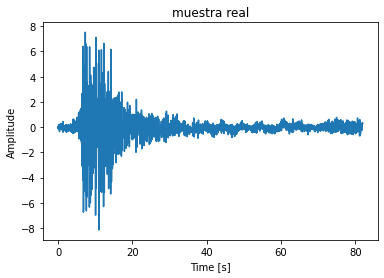

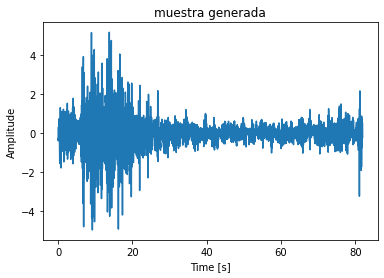

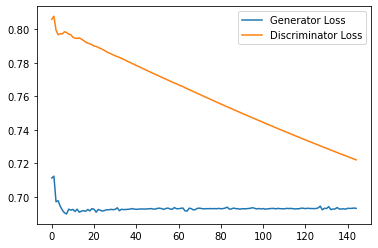

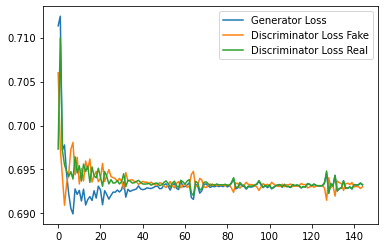

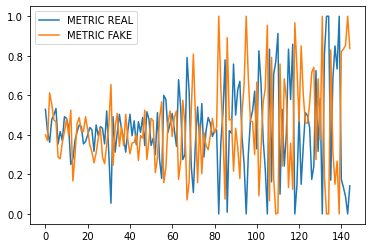

Step 2950: Generator loss: 0.6930670817693073, discriminator loss: 0.7212960350513459
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


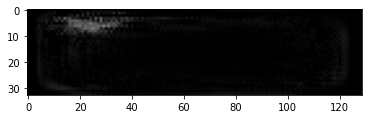

Espectrogramas Reales


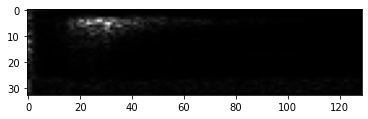

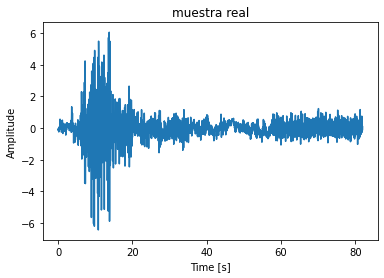

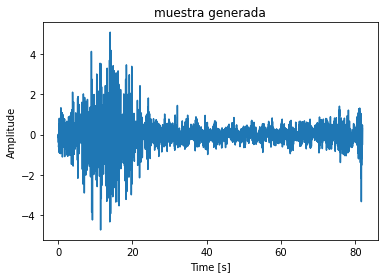

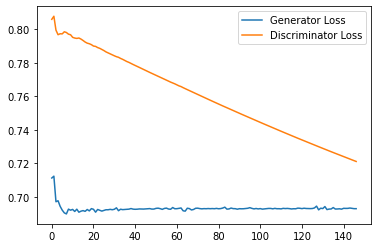

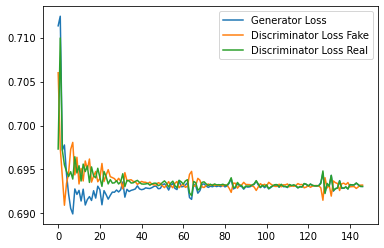

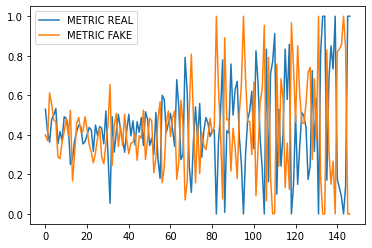

Step 3000: Generator loss: 0.6931667427221933, discriminator loss: 0.7201114189624787
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


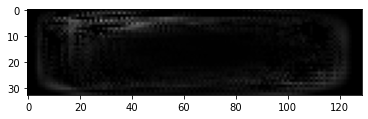

Espectrogramas Reales


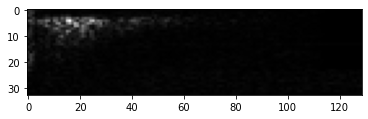

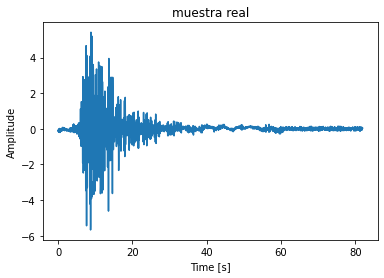

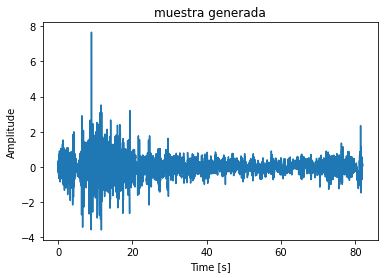

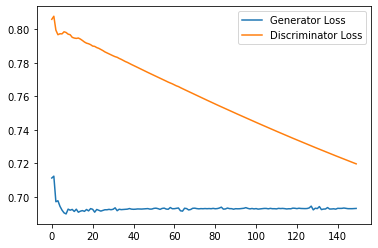

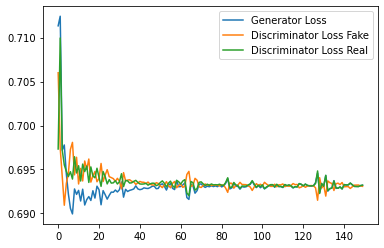

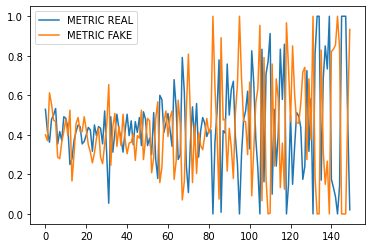

Step 3050: Generator loss: 0.6931359501679739, discriminator loss: 0.7189361202716827
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


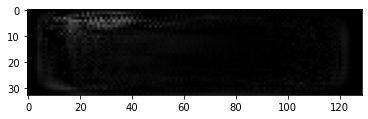

Espectrogramas Reales


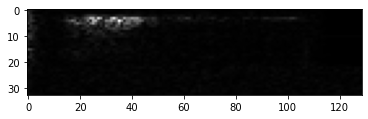

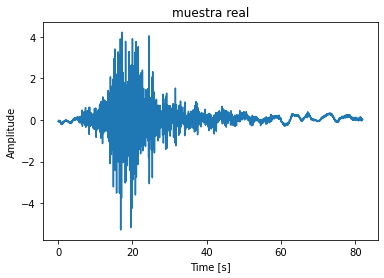

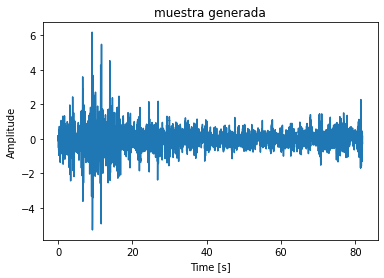

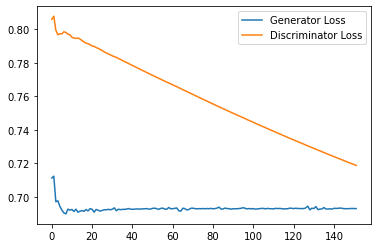

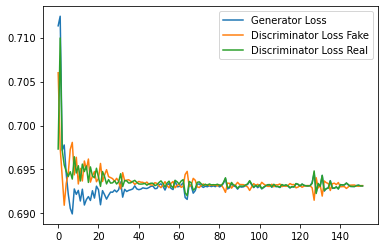

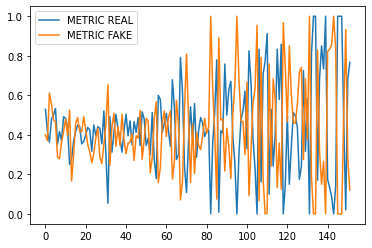

Epoch: 6


  0%|          | 0/513 [00:00<?, ?it/s]

Step 3100: Generator loss: 0.693294439315796, discriminator loss: 0.7177712535858154
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


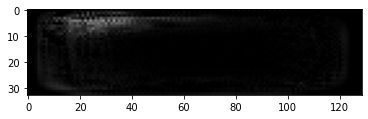

Espectrogramas Reales


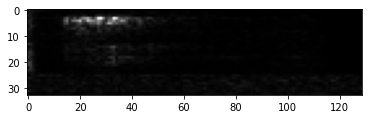

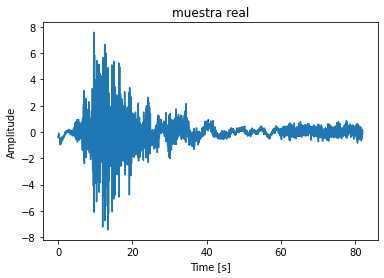

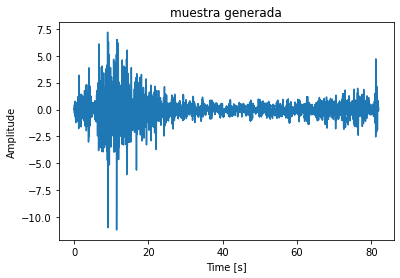

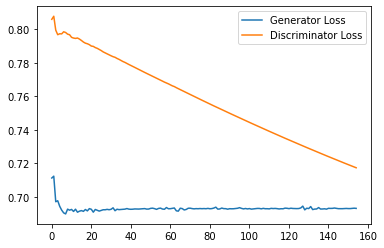

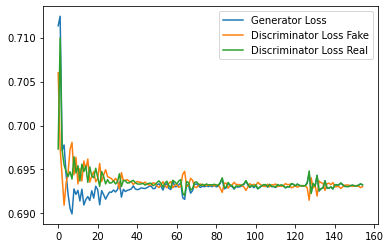

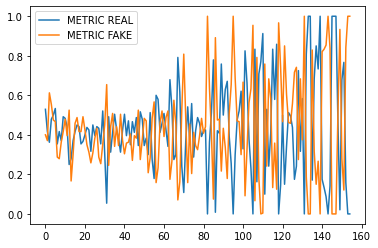

Step 3150: Generator loss: 0.6931004468599954, discriminator loss: 0.7166157162189484
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


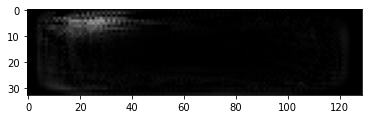

Espectrogramas Reales


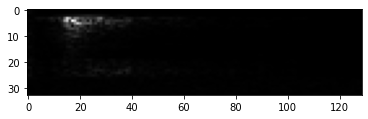

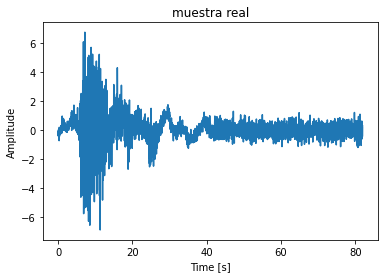

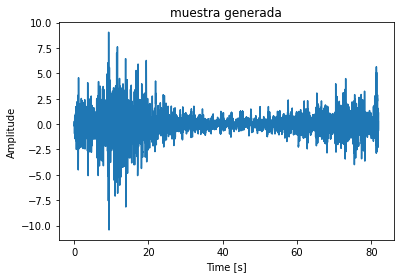

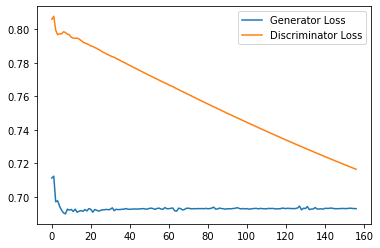

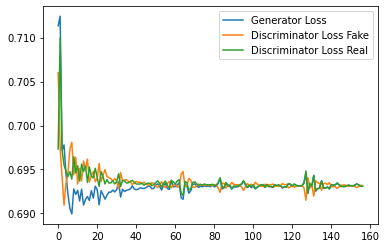

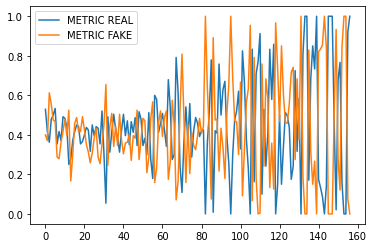

Step 3200: Generator loss: 0.6930818068981169, discriminator loss: 0.7154714429378509
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


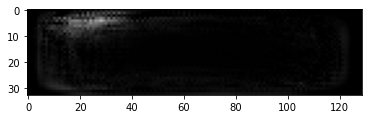

Espectrogramas Reales


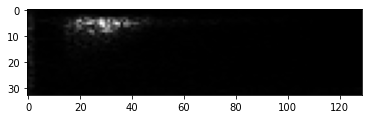

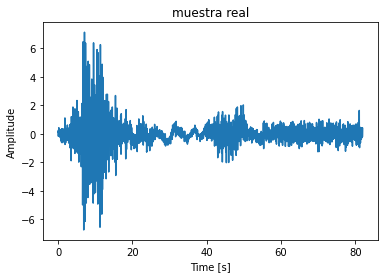

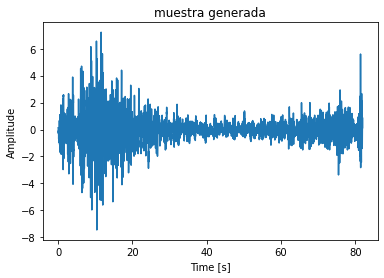

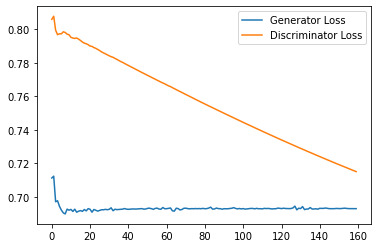

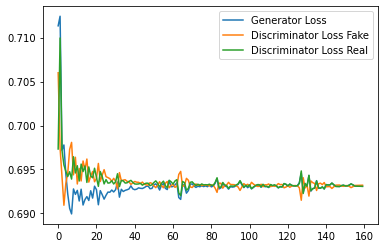

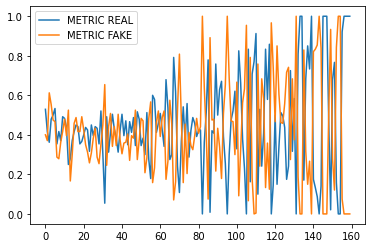

Step 3250: Generator loss: 0.6931117808818815, discriminator loss: 0.7143396973609925
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


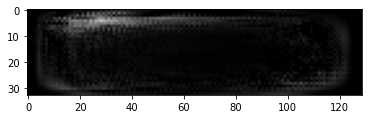

Espectrogramas Reales


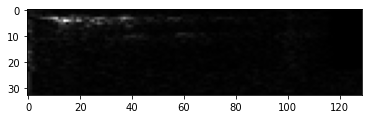

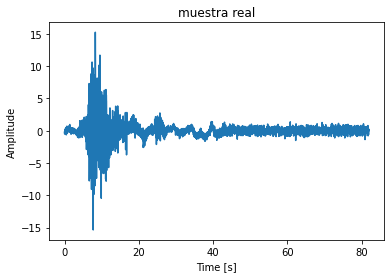

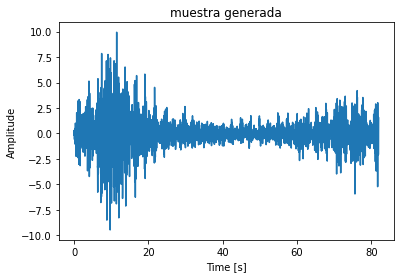

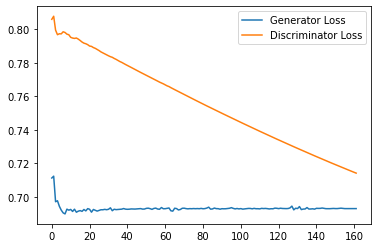

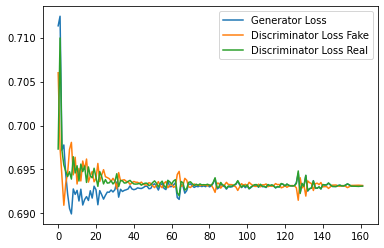

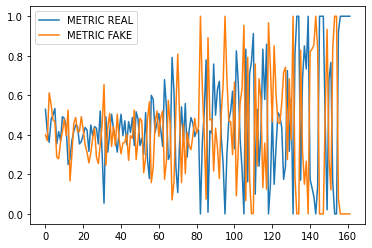

Step 3300: Generator loss: 0.6931438569227855, discriminator loss: 0.7132211697101593
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


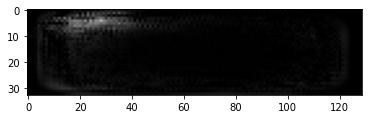

Espectrogramas Reales


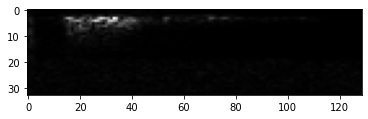

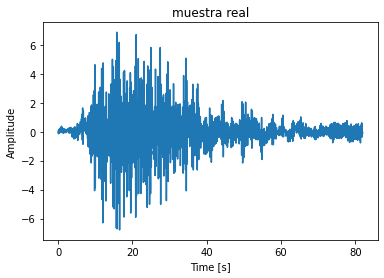

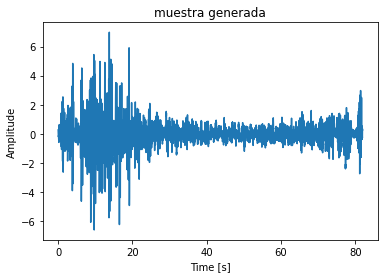

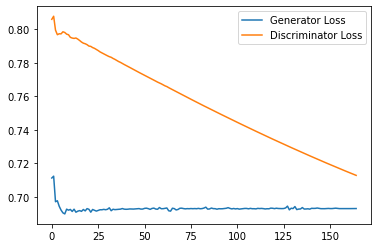

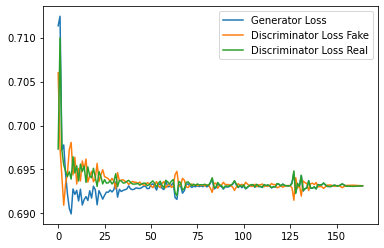

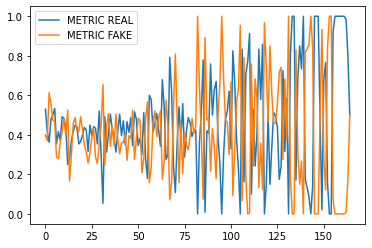

Step 3350: Generator loss: 0.6931461973985036, discriminator loss: 0.7121183168888092
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


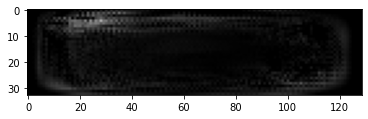

Espectrogramas Reales


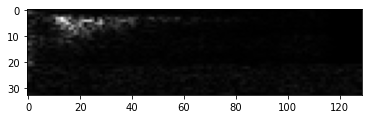

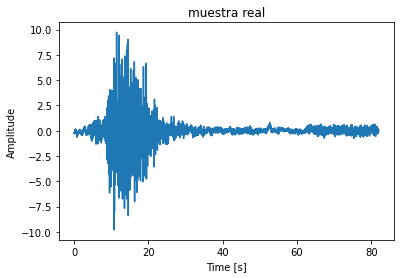

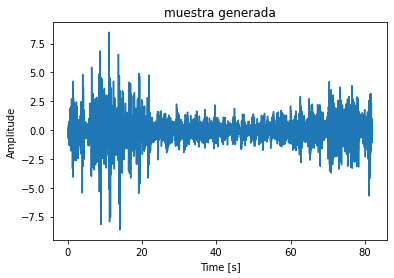

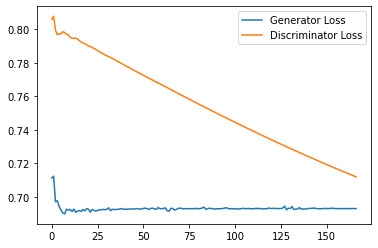

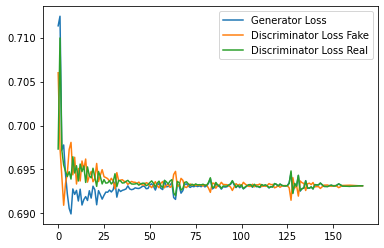

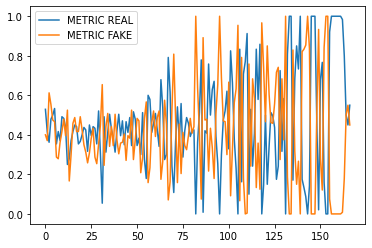

Step 3400: Generator loss: 0.6931457074483235, discriminator loss: 0.7110338783264161
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


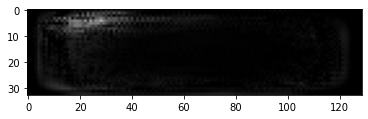

Espectrogramas Reales


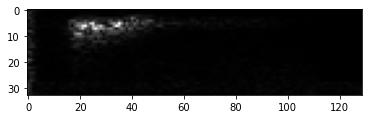

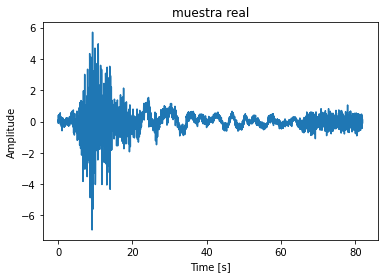

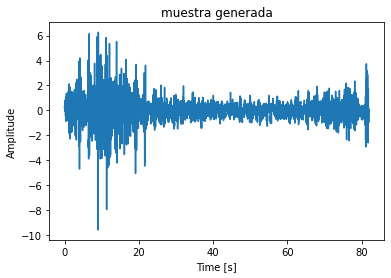

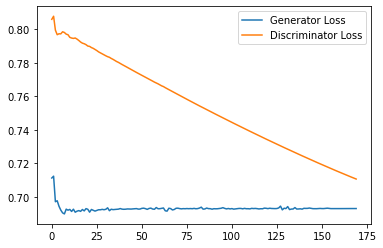

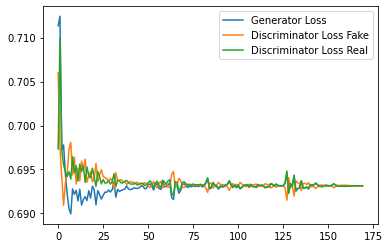

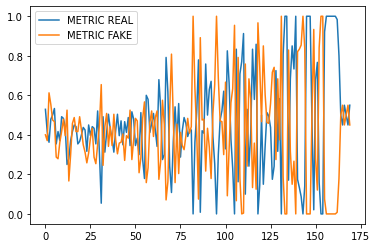

Step 3450: Generator loss: 0.6931472599506379, discriminator loss: 0.7099791526794433
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


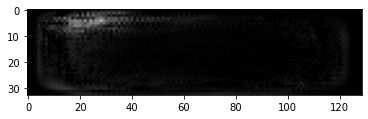

Espectrogramas Reales


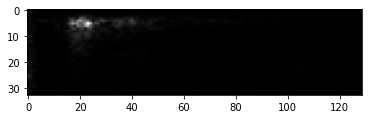

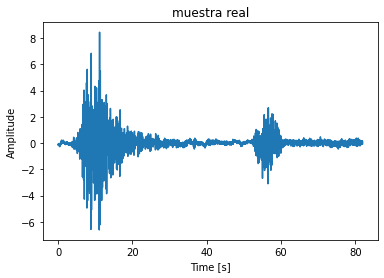

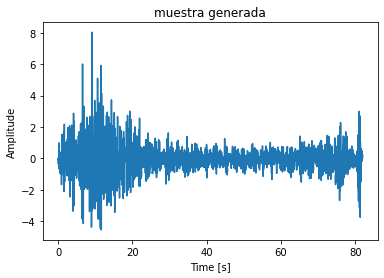

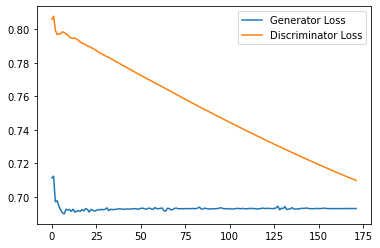

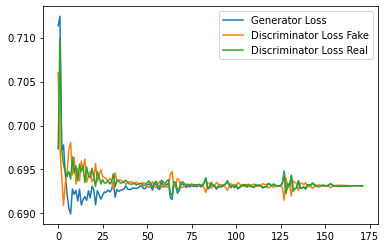

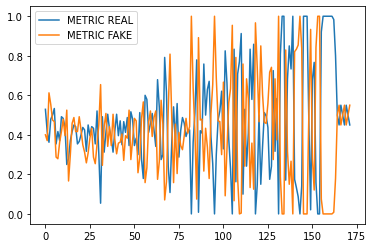

Step 3500: Generator loss: 0.6931470167636872, discriminator loss: 0.7089613878726959
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


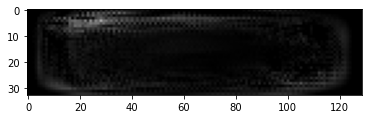

Espectrogramas Reales


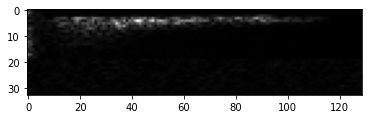

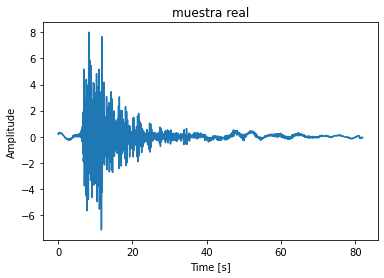

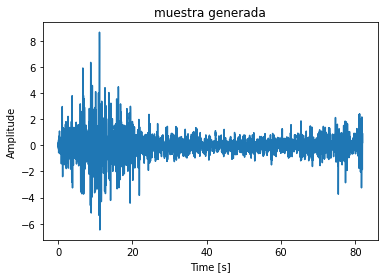

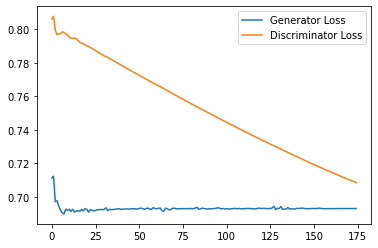

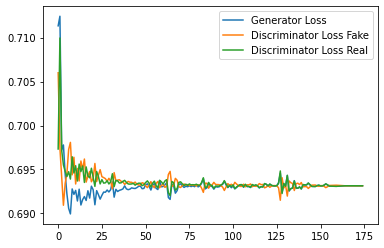

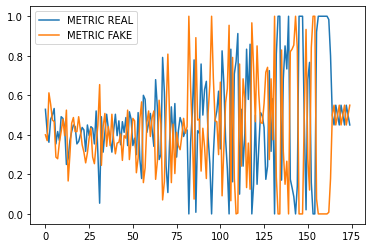

Step 3550: Generator loss: 0.6931472349166871, discriminator loss: 0.7079743421077729
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


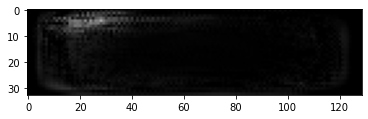

Espectrogramas Reales


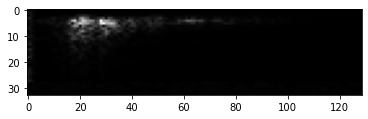

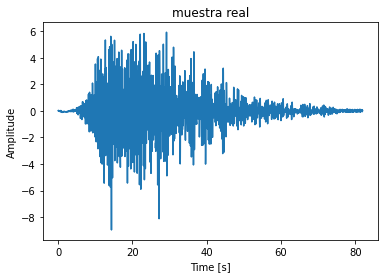

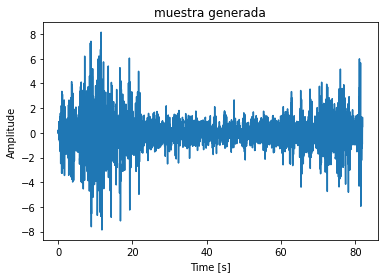

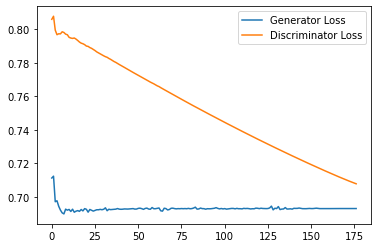

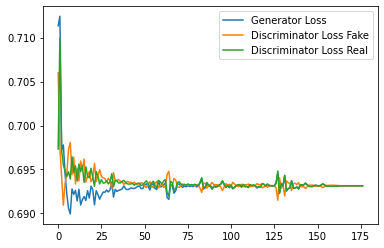

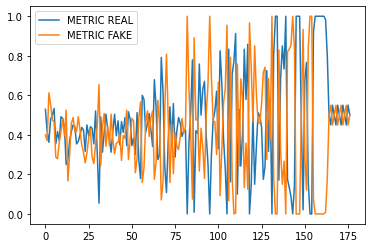

Epoch: 7


  0%|          | 0/513 [00:00<?, ?it/s]

Step 3600: Generator loss: 0.6931473791599274, discriminator loss: 0.7070281541347504
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


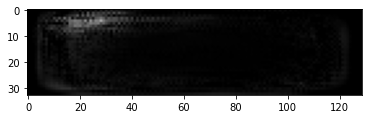

Espectrogramas Reales


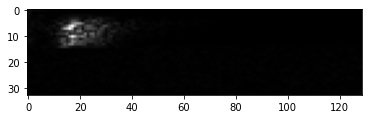

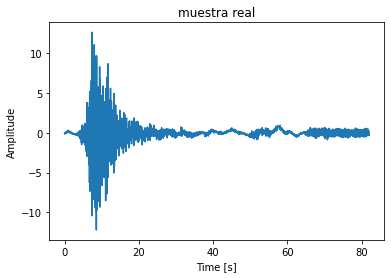

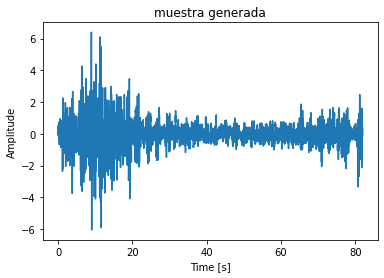

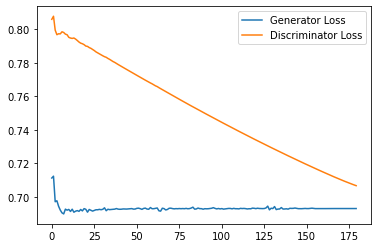

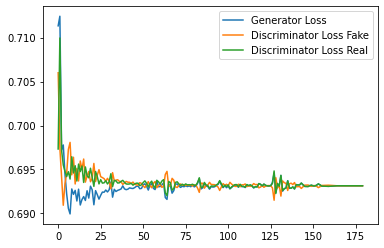

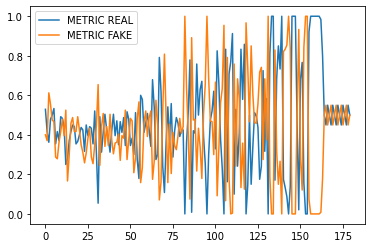

Step 3650: Generator loss: 0.6931470441818237, discriminator loss: 0.7061641192436219
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


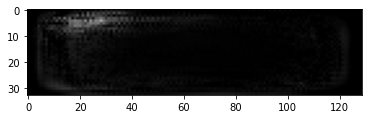

Espectrogramas Reales


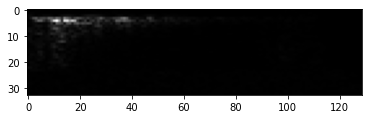

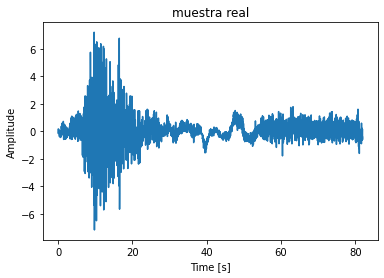

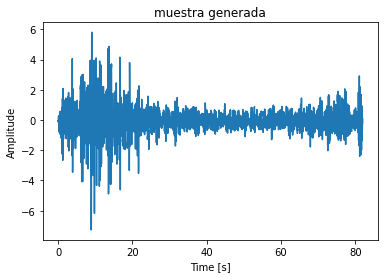

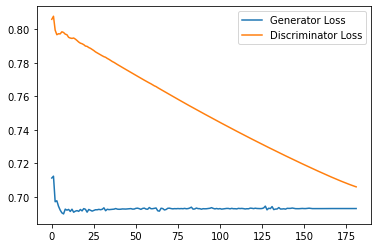

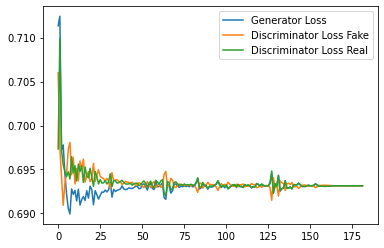

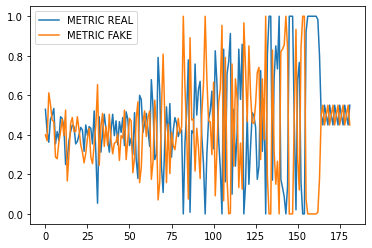

Step 3700: Generator loss: 0.6931472182273865, discriminator loss: 0.7055571913719177
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


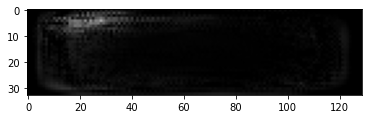

Espectrogramas Reales


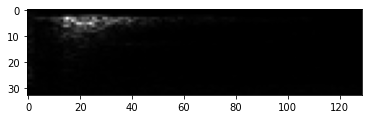

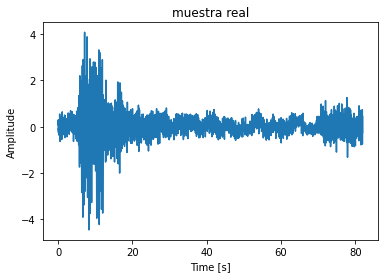

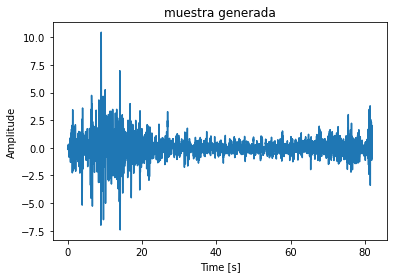

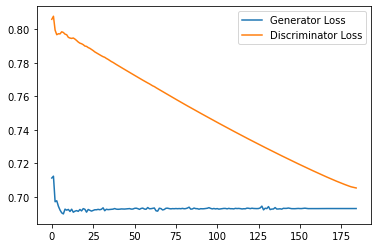

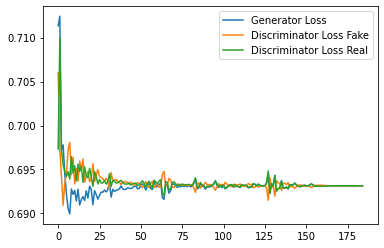

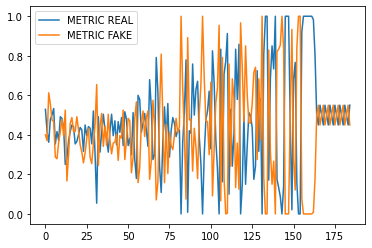

Step 3750: Generator loss: 0.6931473660469055, discriminator loss: 0.7050209009647369
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


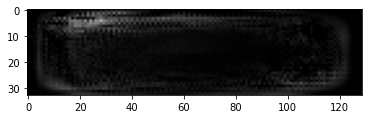

Espectrogramas Reales


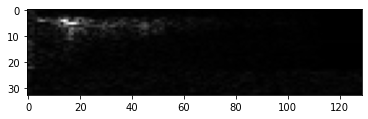

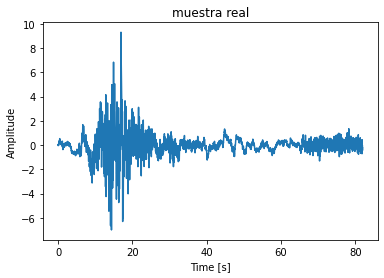

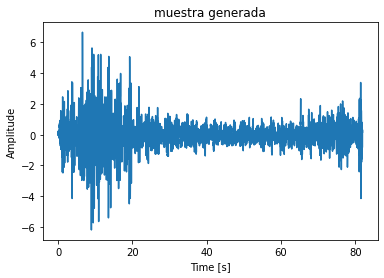

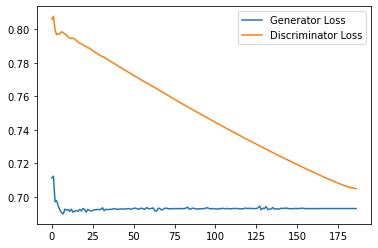

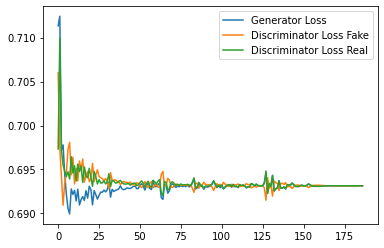

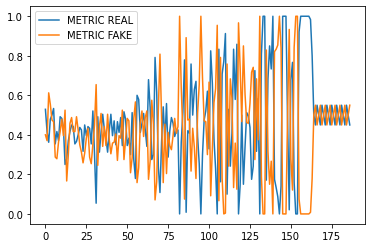

Step 3800: Generator loss: 0.693147040605545, discriminator loss: 0.7044929051399231
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


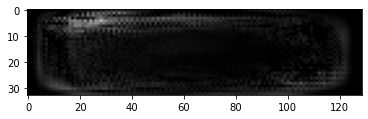

Espectrogramas Reales


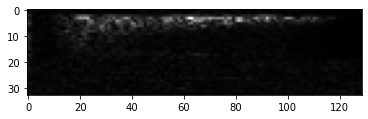

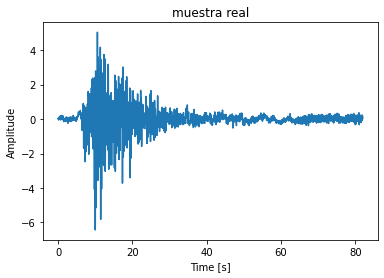

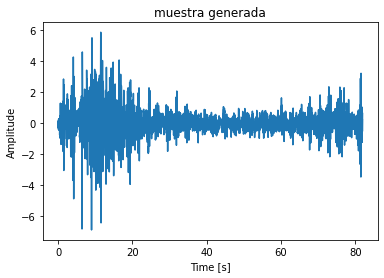

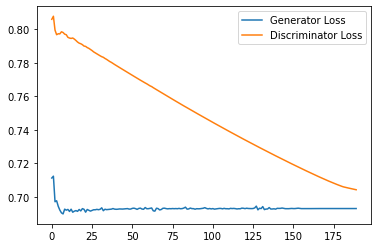

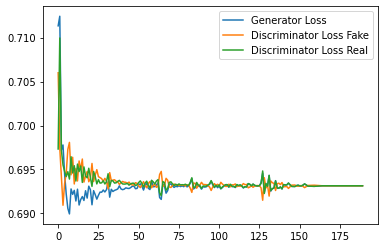

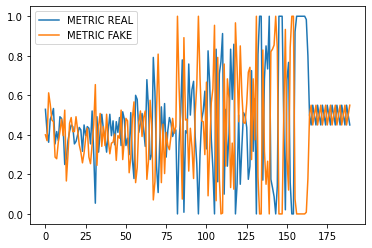

Step 3850: Generator loss: 0.6931472337245941, discriminator loss: 0.7039722728729249
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


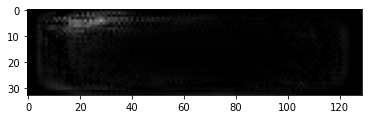

Espectrogramas Reales


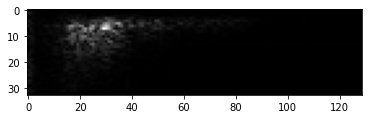

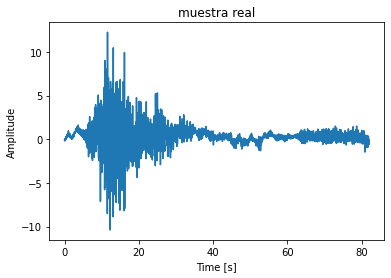

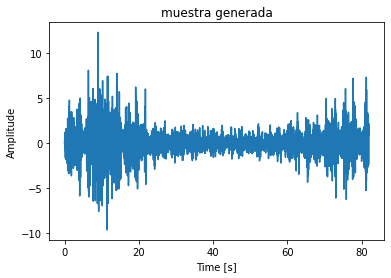

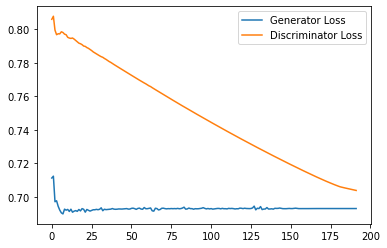

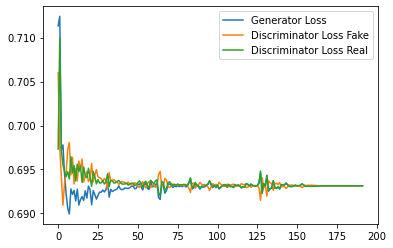

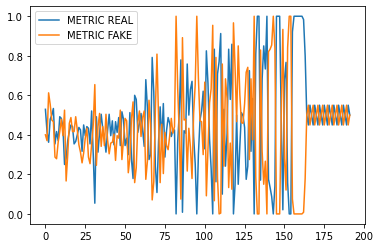

Step 3900: Generator loss: 0.6931473767757416, discriminator loss: 0.7034591794013977
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


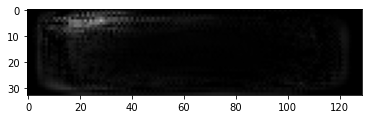

Espectrogramas Reales


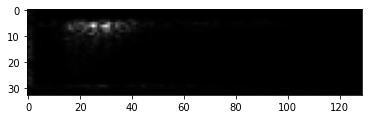

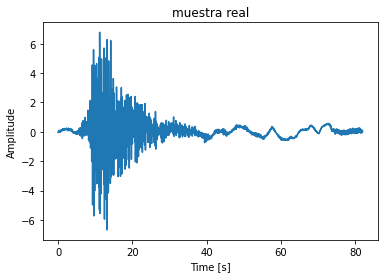

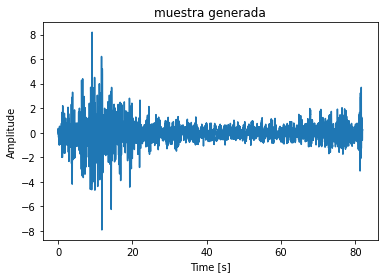

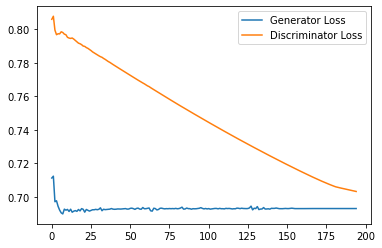

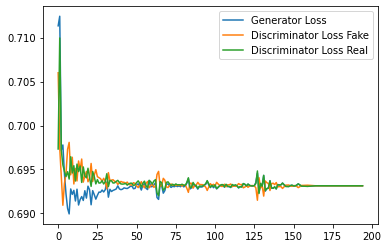

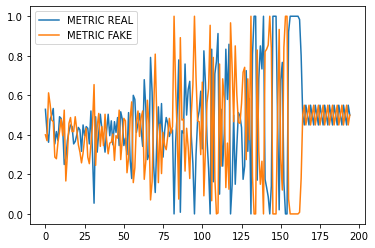

Step 3950: Generator loss: 0.6931470704078674, discriminator loss: 0.7029545485973359
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


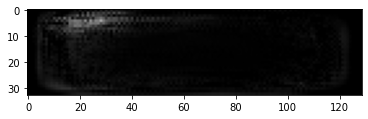

Espectrogramas Reales


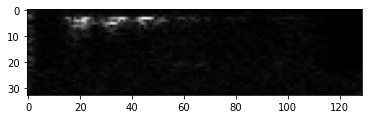

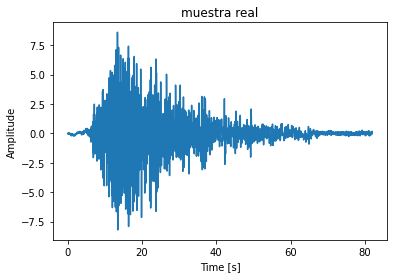

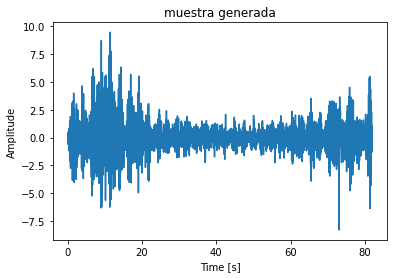

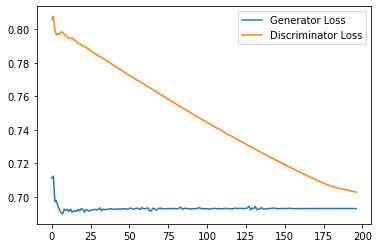

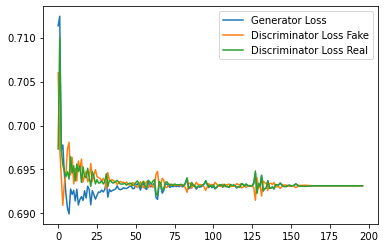

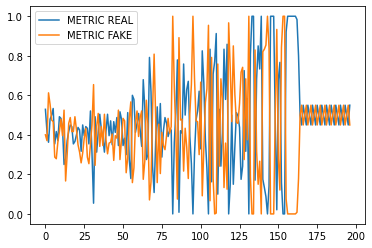

Step 4000: Generator loss: 0.693147257566452, discriminator loss: 0.7024599385261535
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


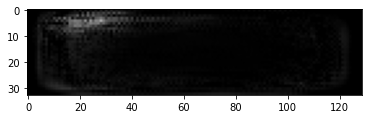

Espectrogramas Reales


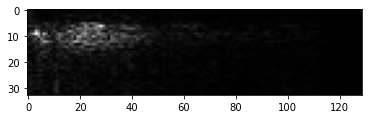

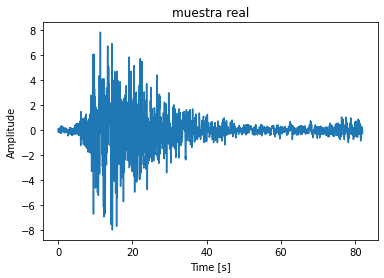

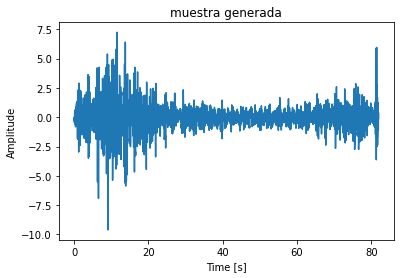

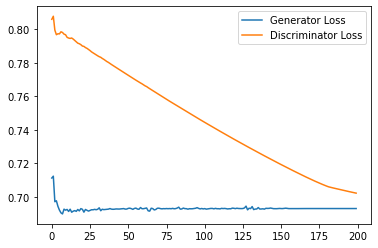

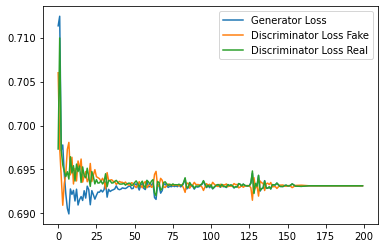

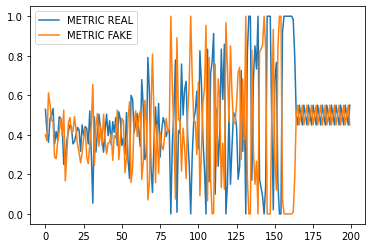

Step 4050: Generator loss: 0.693147394657135, discriminator loss: 0.701976568698883
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


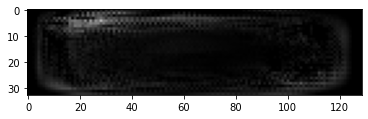

Espectrogramas Reales


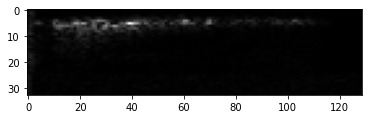

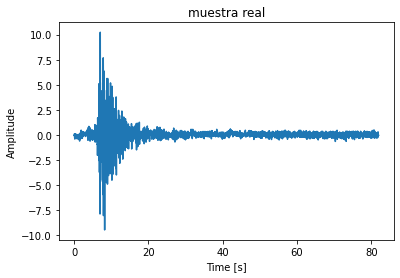

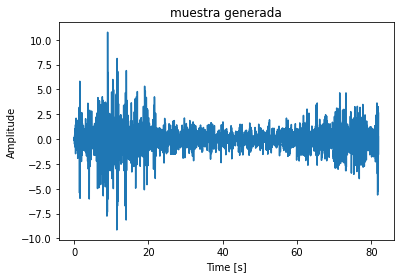

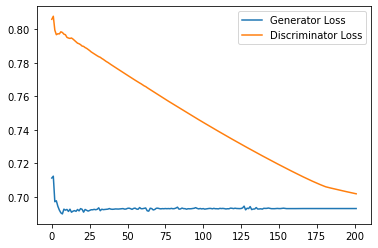

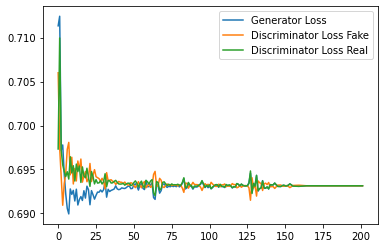

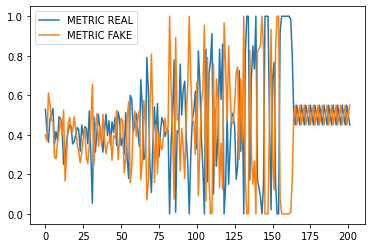

Step 4100: Generator loss: 0.6931470394134521, discriminator loss: 0.7015065121650695
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


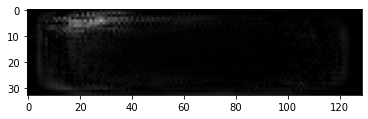

Espectrogramas Reales


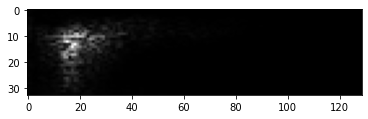

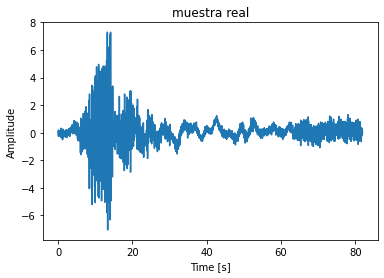

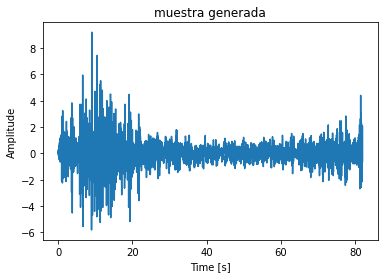

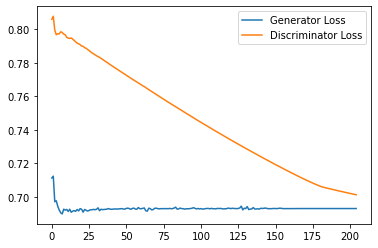

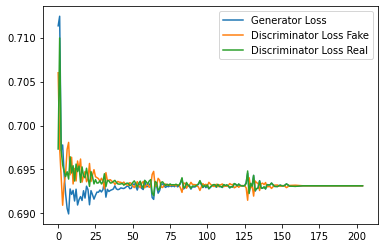

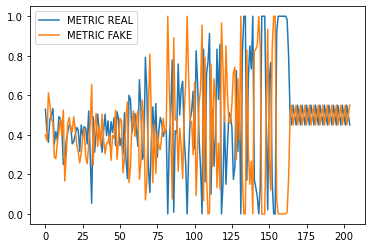

Epoch: 8


  0%|          | 0/513 [00:00<?, ?it/s]

Step 4150: Generator loss: 0.6931472277641296, discriminator loss: 0.7010526132583618
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


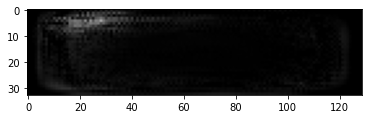

Espectrogramas Reales


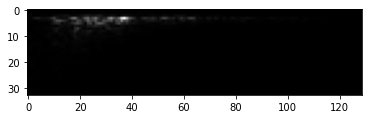

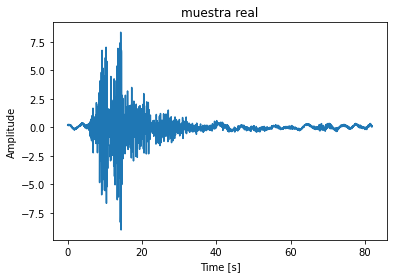

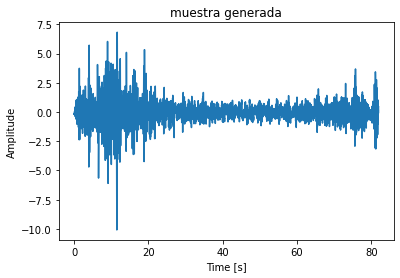

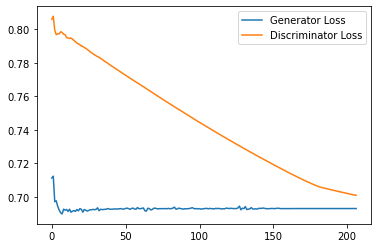

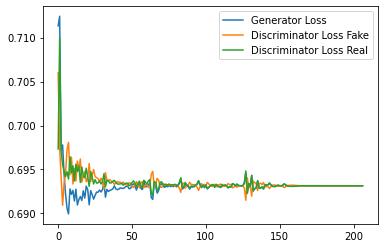

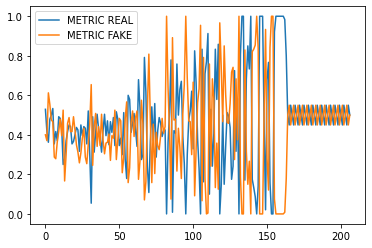

Step 4200: Generator loss: 0.69314737200737, discriminator loss: 0.7006199193000794
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


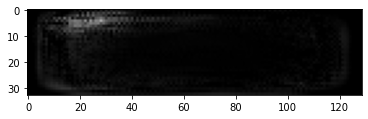

Espectrogramas Reales


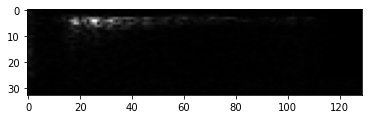

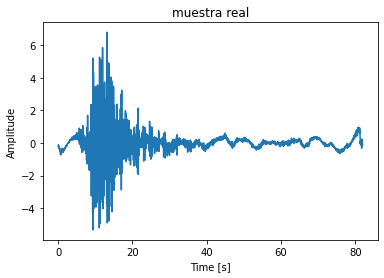

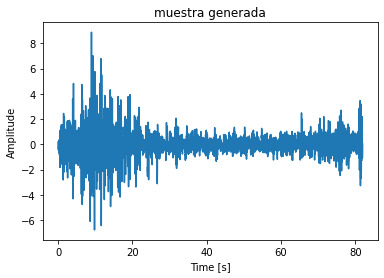

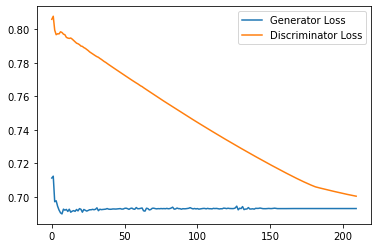

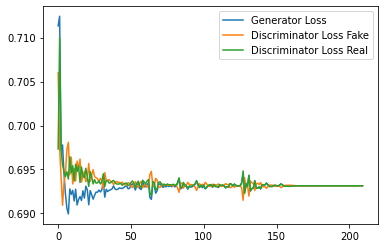

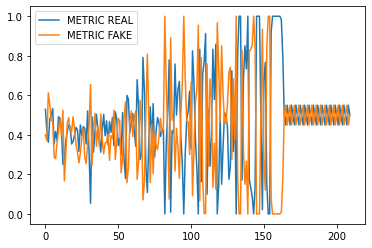

Step 4250: Generator loss: 0.6931470322608948, discriminator loss: 0.7002197015285492
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


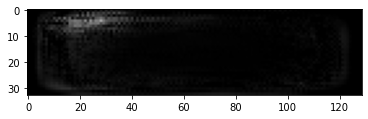

Espectrogramas Reales


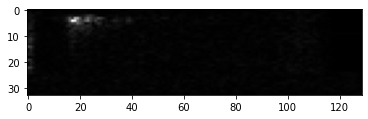

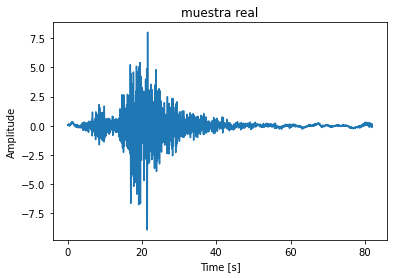

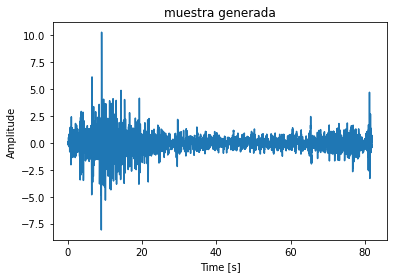

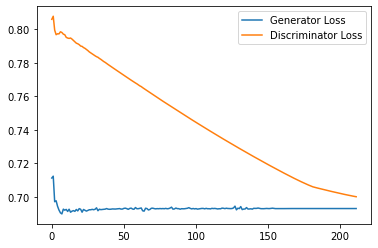

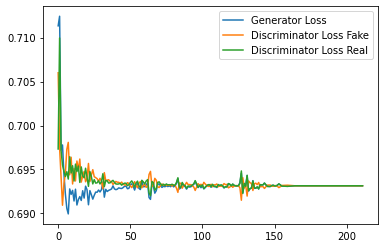

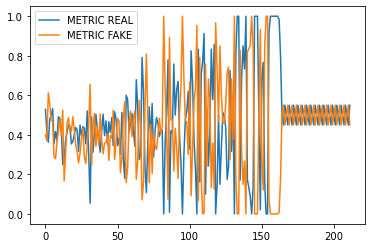

Step 4300: Generator loss: 0.6931472420692444, discriminator loss: 0.6999297380447388
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


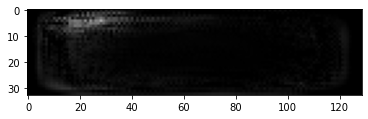

Espectrogramas Reales


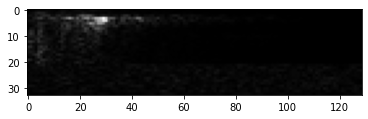

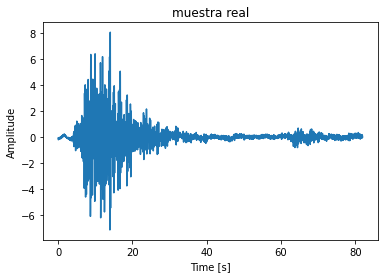

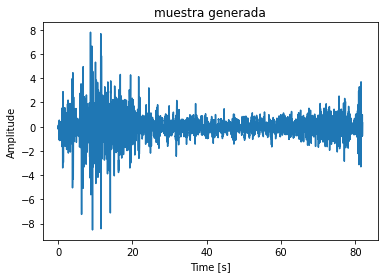

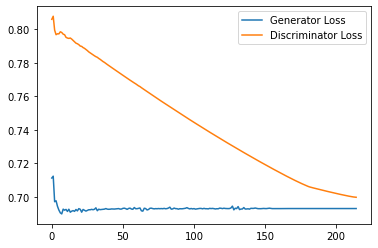

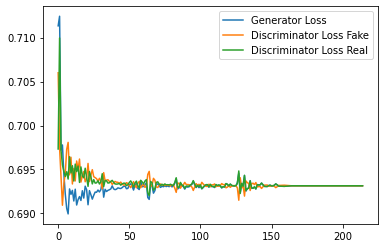

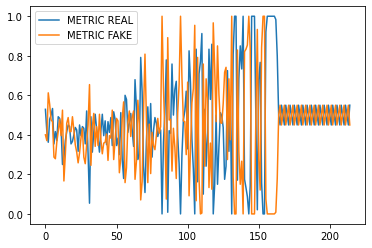

Step 4350: Generator loss: 0.6931473922729492, discriminator loss: 0.6996918475627899
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


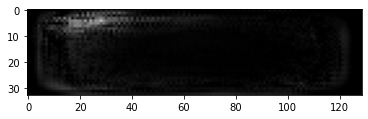

Espectrogramas Reales


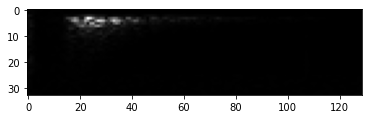

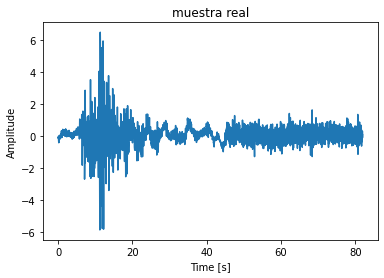

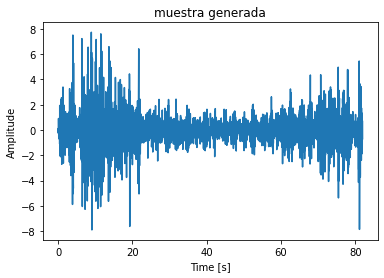

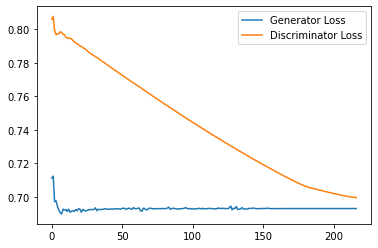

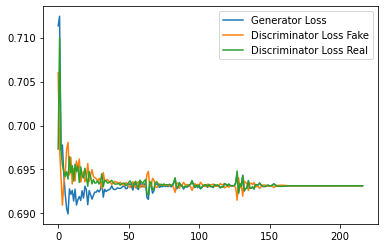

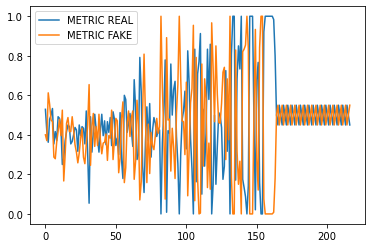

Step 4400: Generator loss: 0.6931470382213593, discriminator loss: 0.6994569218158722
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


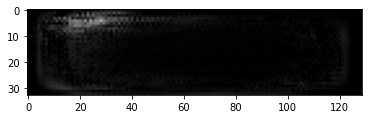

Espectrogramas Reales


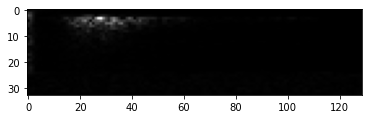

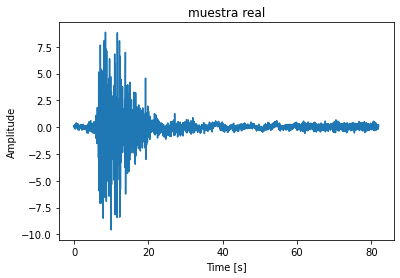

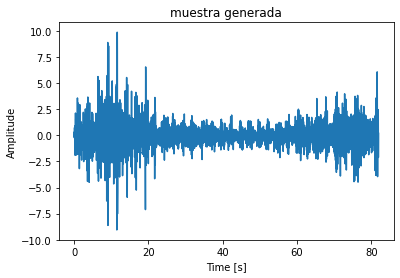

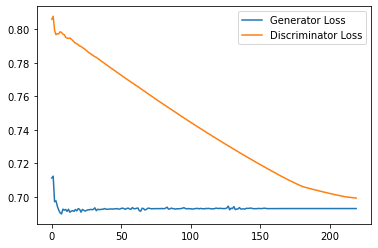

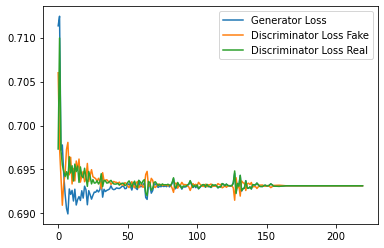

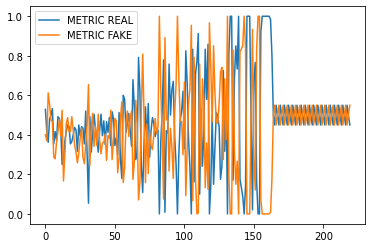

Step 4450: Generator loss: 0.6931472349166871, discriminator loss: 0.6992234337329865
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


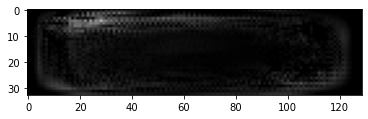

Espectrogramas Reales


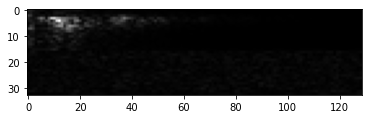

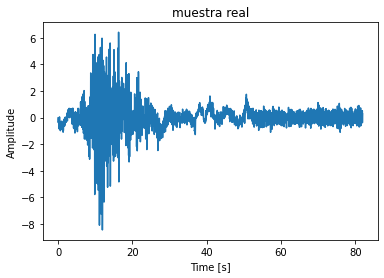

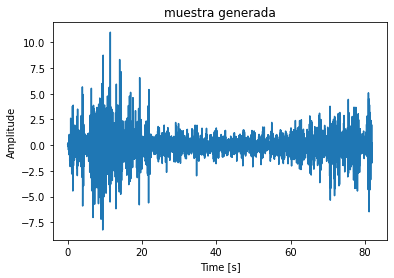

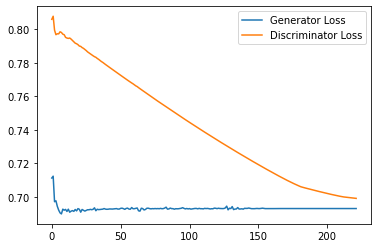

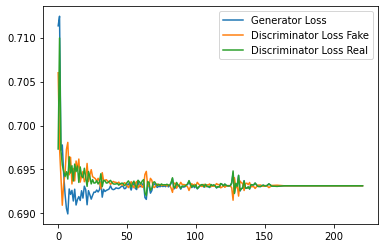

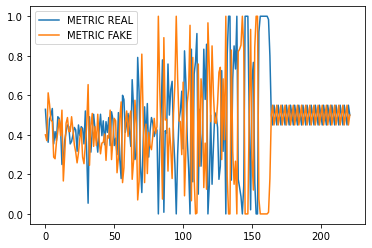

Step 4500: Generator loss: 0.6931473970413208, discriminator loss: 0.6989937067031861
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


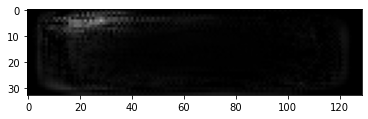

Espectrogramas Reales


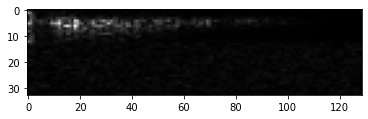

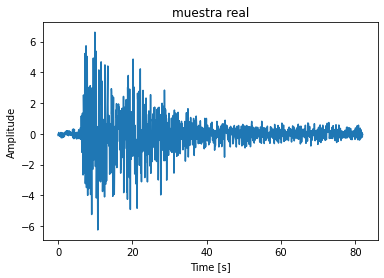

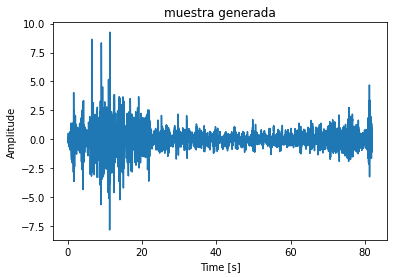

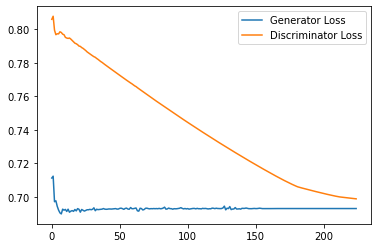

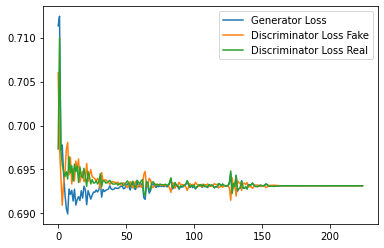

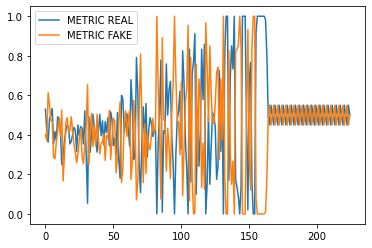

Step 4550: Generator loss: 0.6931470346450805, discriminator loss: 0.6987665438652039
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


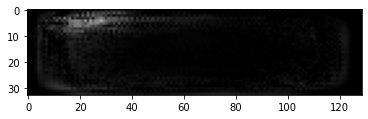

Espectrogramas Reales


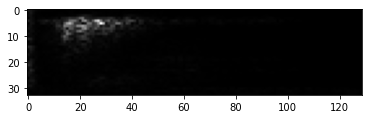

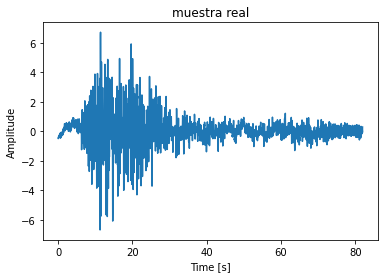

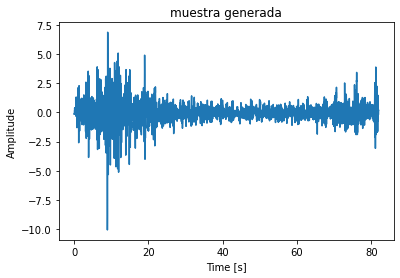

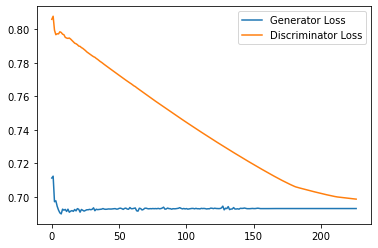

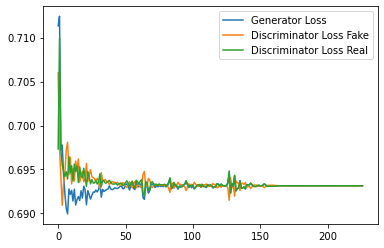

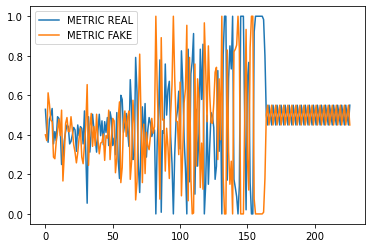

Step 4600: Generator loss: 0.6931472420692444, discriminator loss: 0.6985428607463837
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


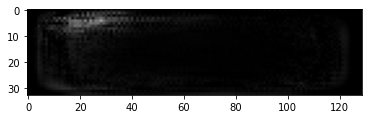

Espectrogramas Reales


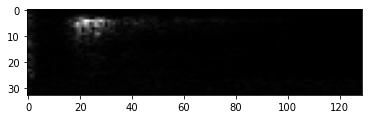

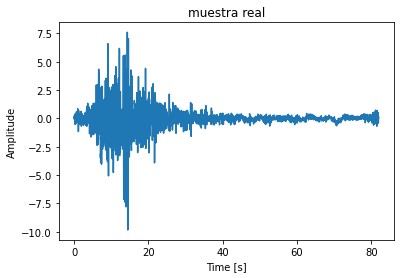

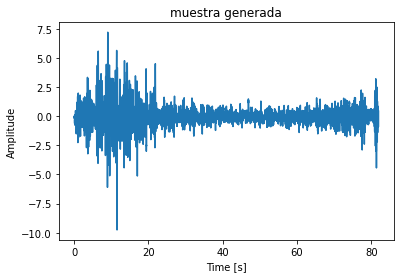

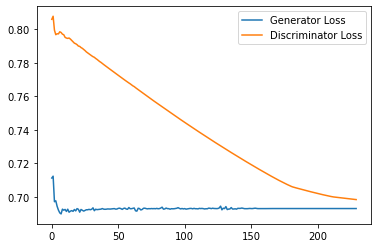

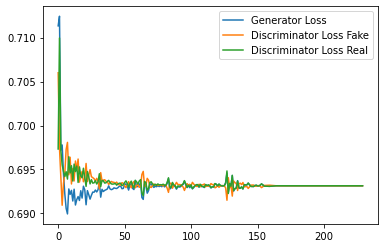

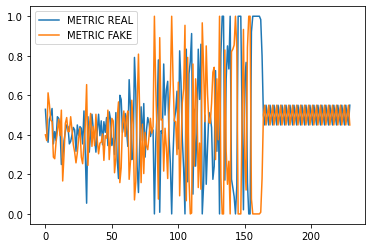

Epoch: 9


  0%|          | 0/513 [00:00<?, ?it/s]

Step 4650: Generator loss: 0.6931473910808563, discriminator loss: 0.6983226883411408
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


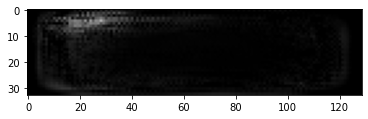

Espectrogramas Reales


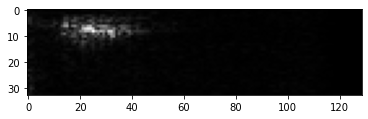

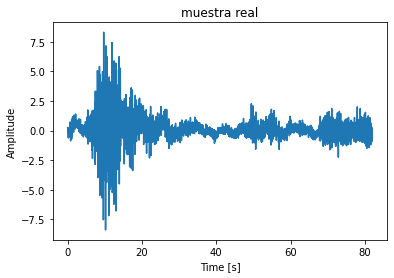

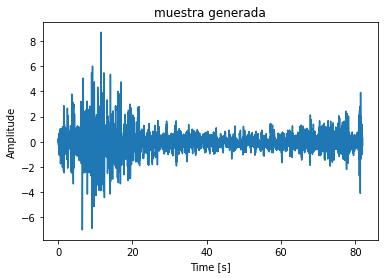

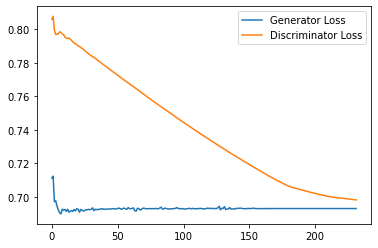

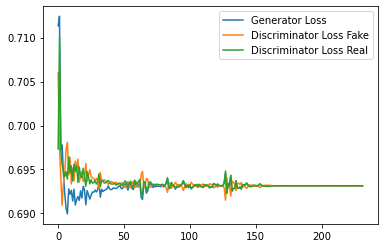

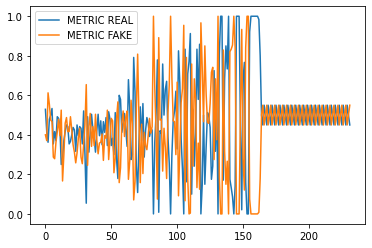

Step 4700: Generator loss: 0.6931470155715942, discriminator loss: 0.698105719089508
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


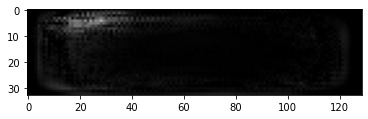

Espectrogramas Reales


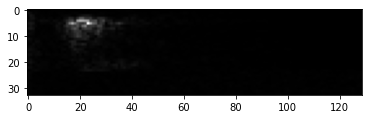

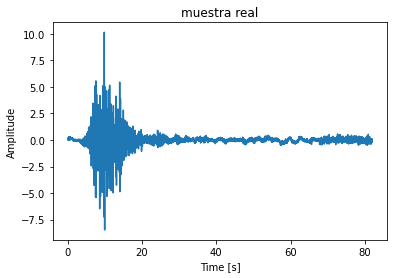

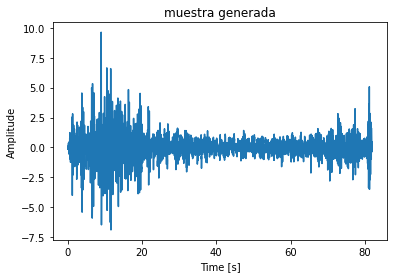

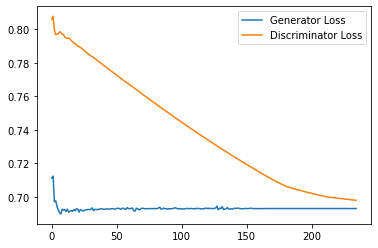

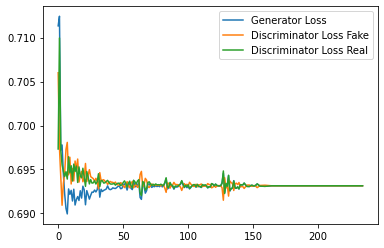

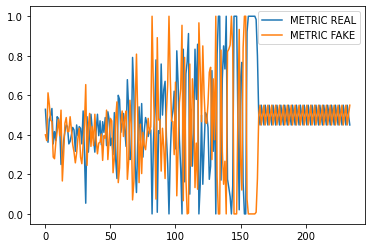

Step 4750: Generator loss: 0.6931472218036652, discriminator loss: 0.6978929507732391
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


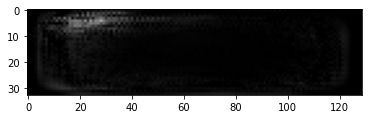

Espectrogramas Reales


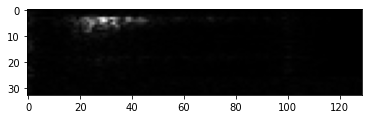

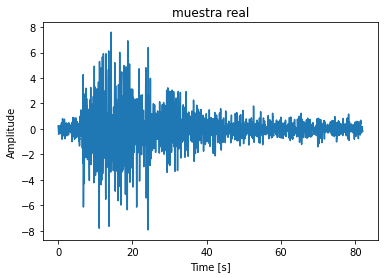

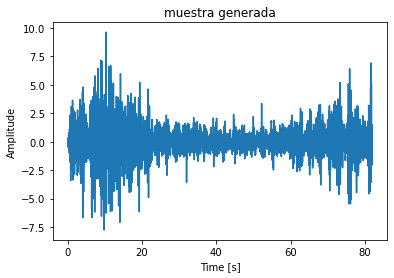

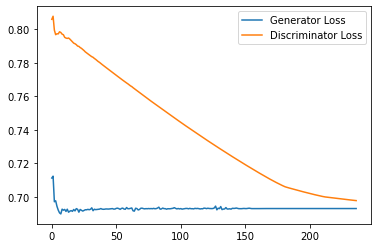

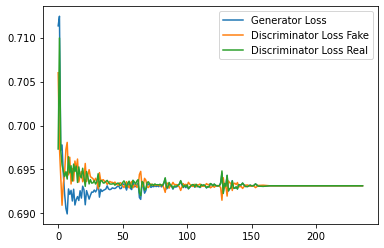

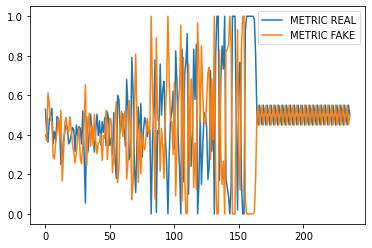

Step 4800: Generator loss: 0.6931473743915558, discriminator loss: 0.6976846528053283
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


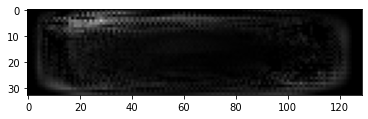

Espectrogramas Reales


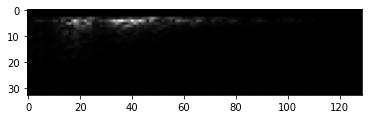

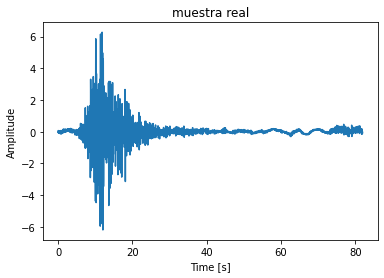

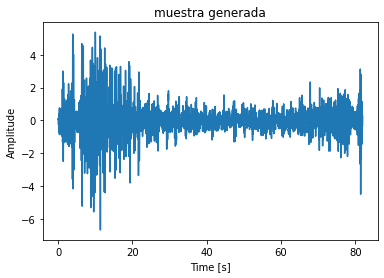

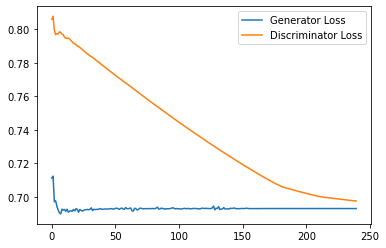

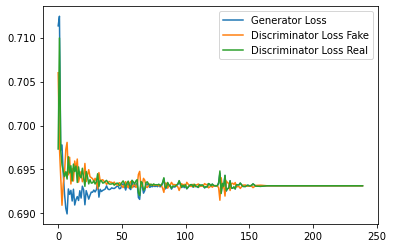

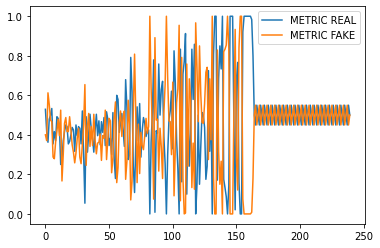

Step 4850: Generator loss: 0.6931470143795013, discriminator loss: 0.6974821209907531
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


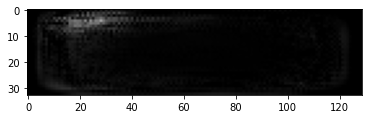

Espectrogramas Reales


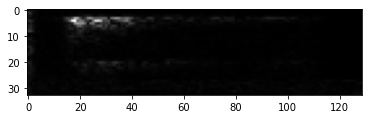

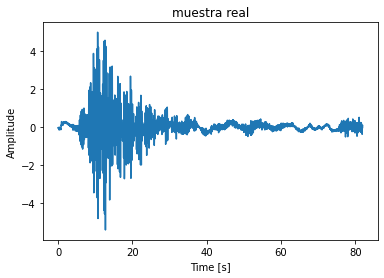

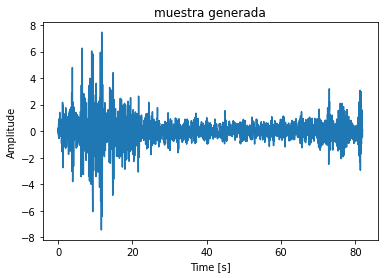

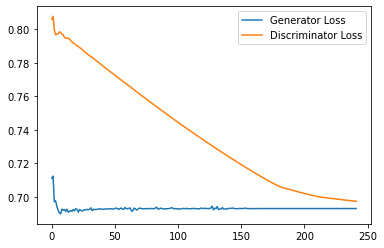

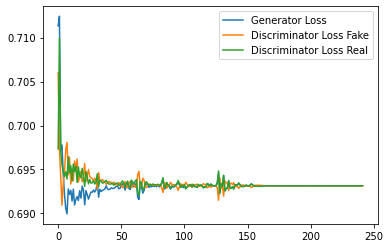

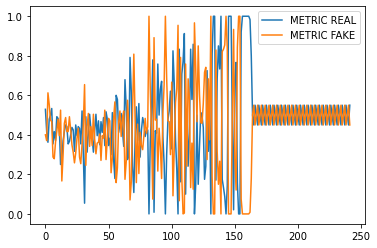

Step 4900: Generator loss: 0.6931472659111023, discriminator loss: 0.6972842490673066
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


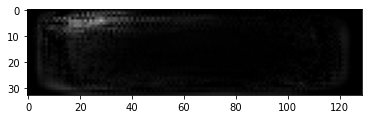

Espectrogramas Reales


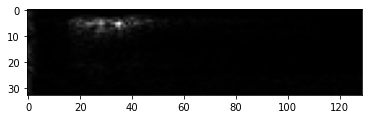

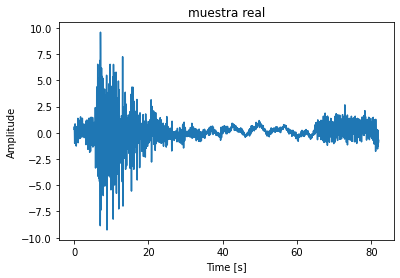

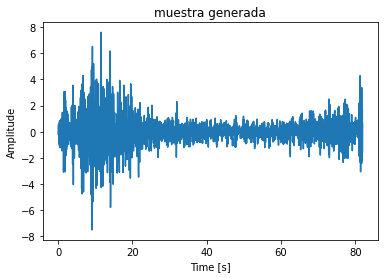

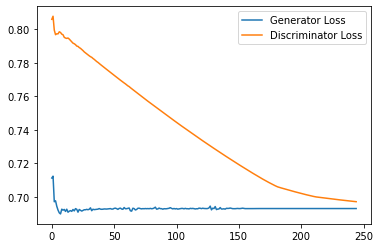

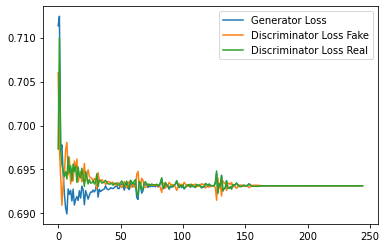

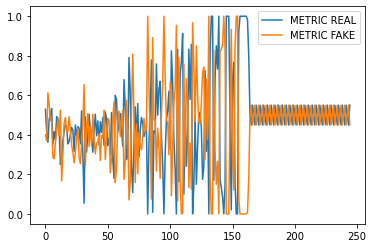

Step 4950: Generator loss: 0.6931474471092224, discriminator loss: 0.6970932459831238
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


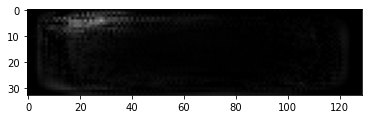

Espectrogramas Reales


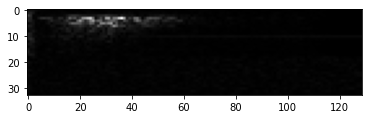

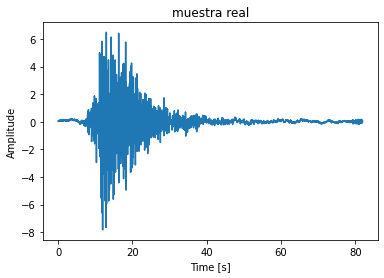

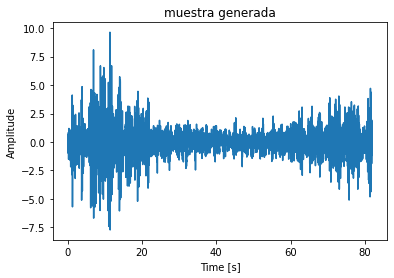

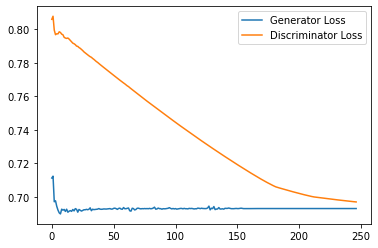

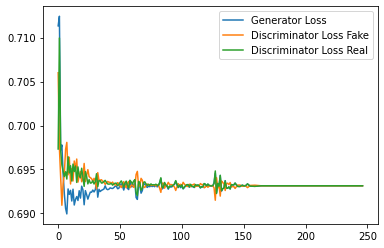

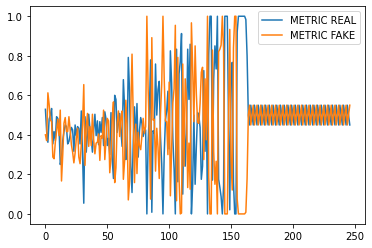

Step 5000: Generator loss: 0.6931470489501953, discriminator loss: 0.696909692287445
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


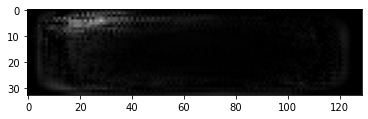

Espectrogramas Reales


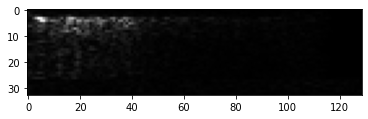

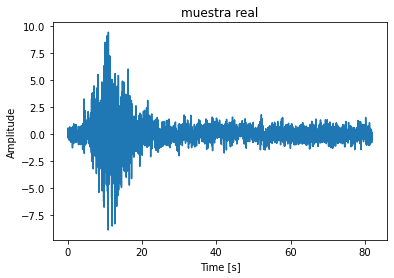

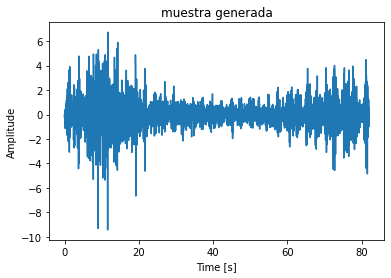

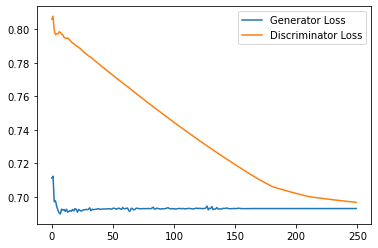

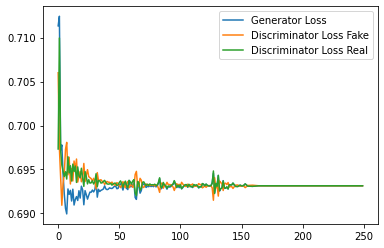

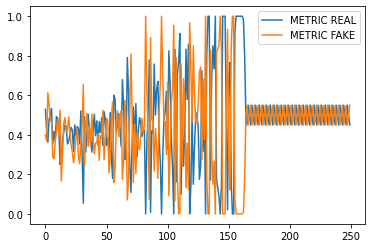

Step 5050: Generator loss: 0.6931472492218017, discriminator loss: 0.696732656955719
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


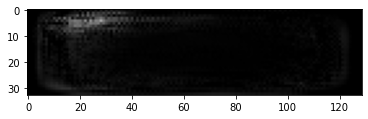

Espectrogramas Reales


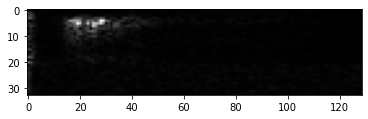

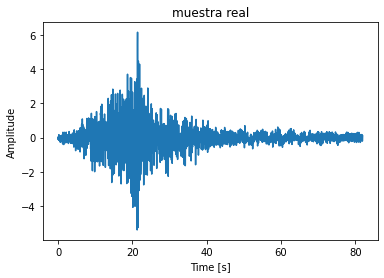

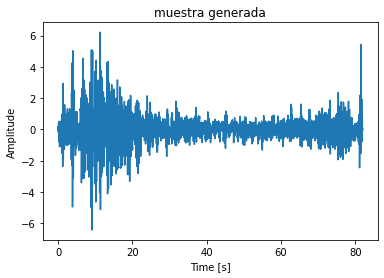

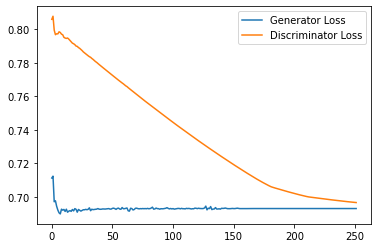

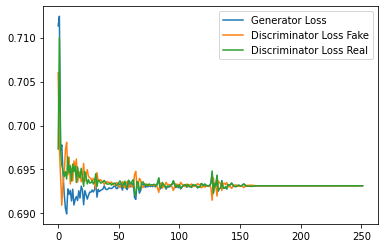

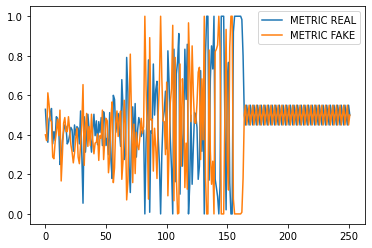

Step 5100: Generator loss: 0.6931474041938782, discriminator loss: 0.6965662097930908
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


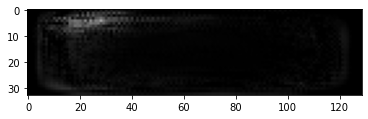

Espectrogramas Reales


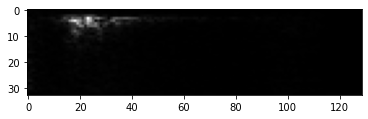

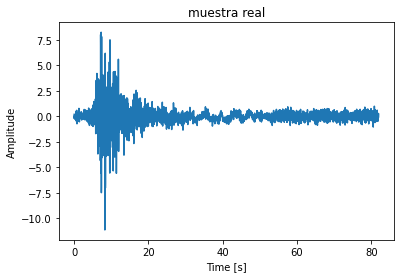

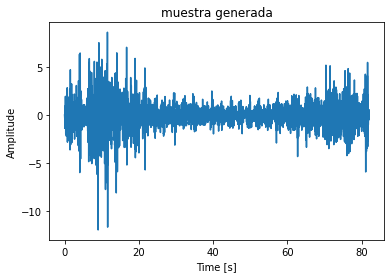

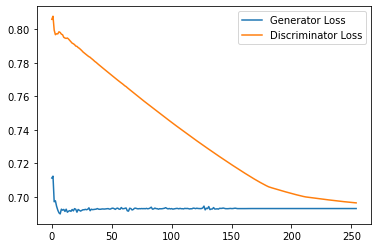

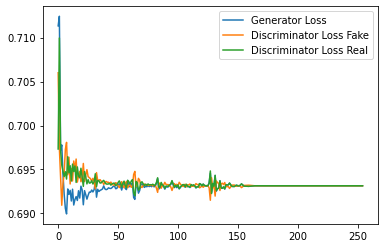

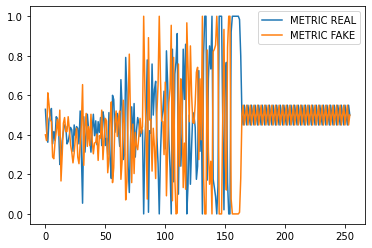

Epoch: 10


  0%|          | 0/513 [00:00<?, ?it/s]

Step 5150: Generator loss: 0.693147029876709, discriminator loss: 0.6964120745658875
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


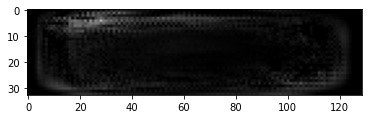

Espectrogramas Reales


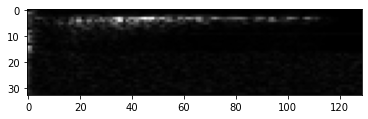

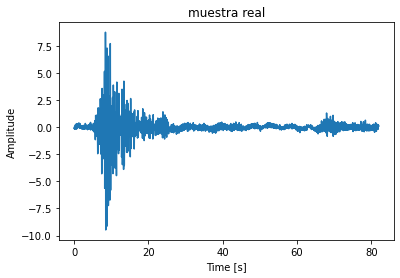

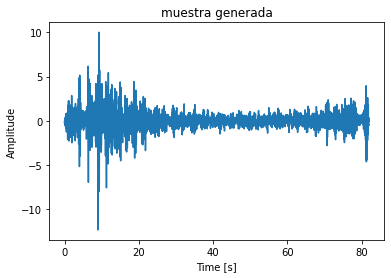

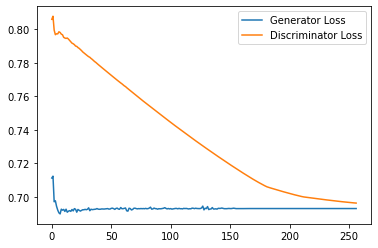

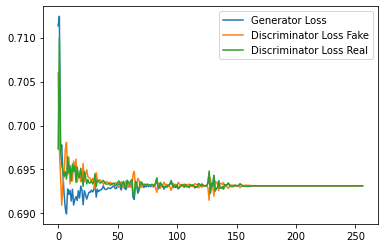

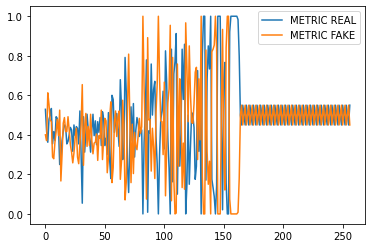

Step 5200: Generator loss: 0.6931472527980804, discriminator loss: 0.6963024616241456
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


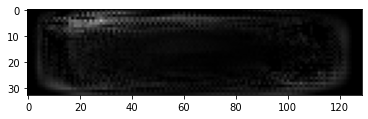

Espectrogramas Reales


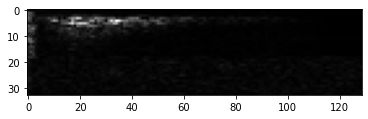

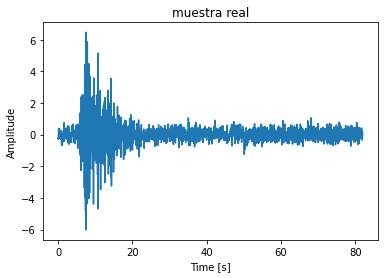

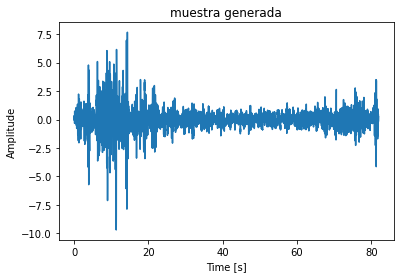

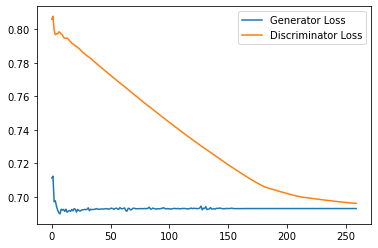

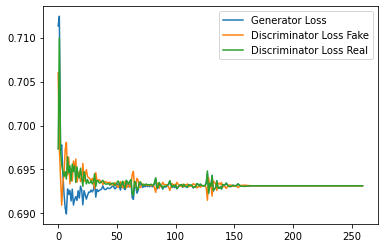

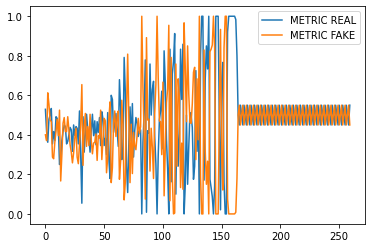

Step 5250: Generator loss: 0.6931474256515503, discriminator loss: 0.696204674243927
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


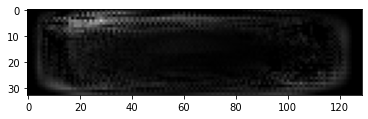

Espectrogramas Reales


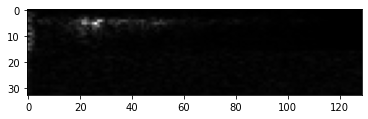

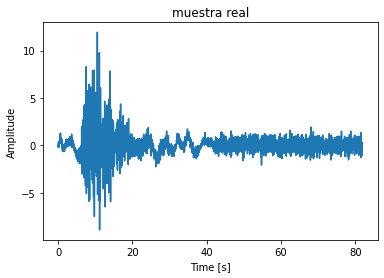

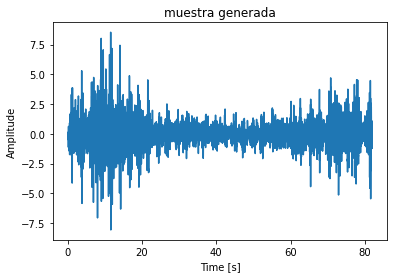

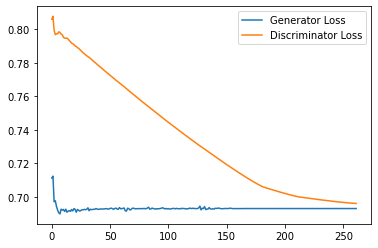

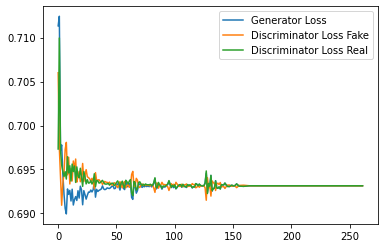

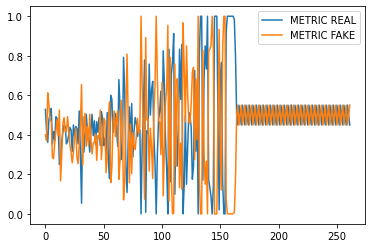

Step 5300: Generator loss: 0.6931470322608948, discriminator loss: 0.6961073207855225
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


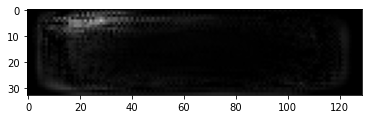

Espectrogramas Reales


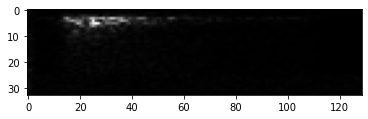

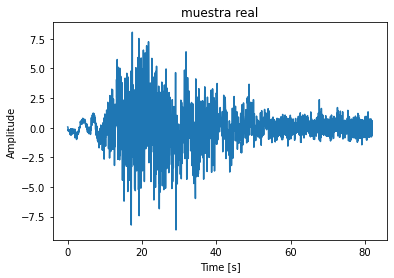

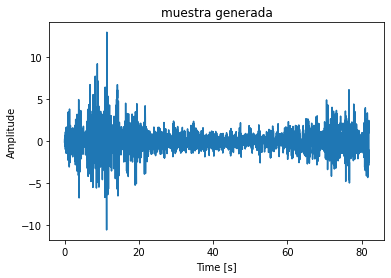

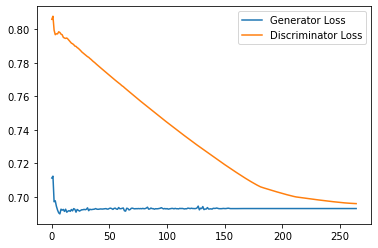

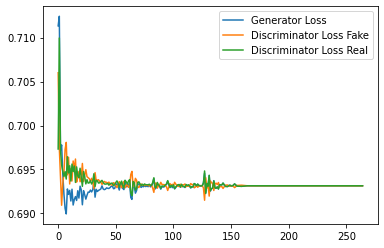

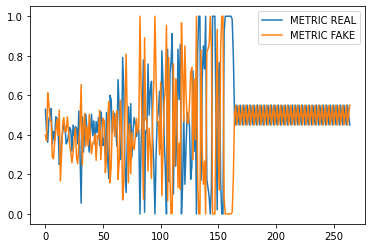

Step 5350: Generator loss: 0.693147246837616, discriminator loss: 0.696010879278183
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


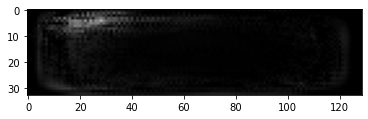

Espectrogramas Reales


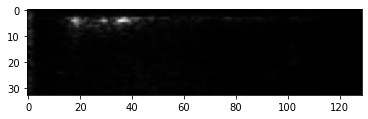

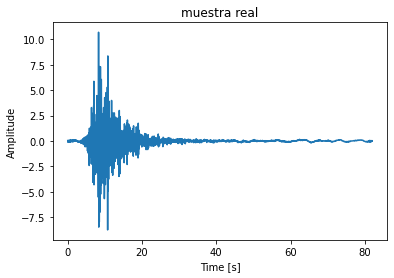

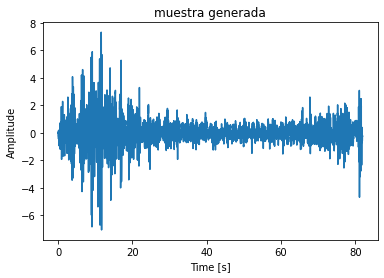

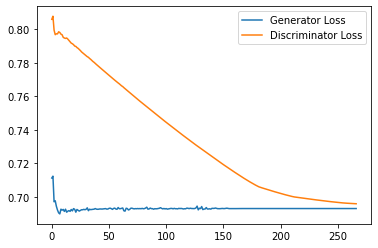

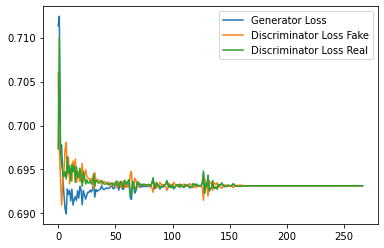

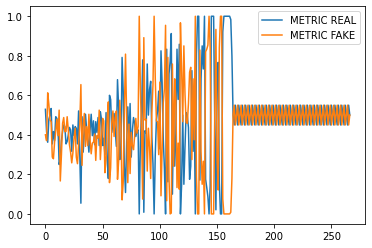

Step 5400: Generator loss: 0.6931474077701568, discriminator loss: 0.6959153234958648
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


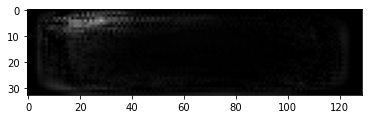

Espectrogramas Reales


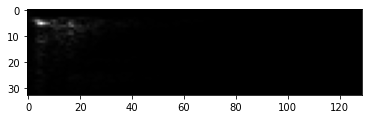

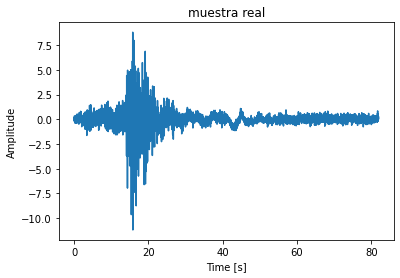

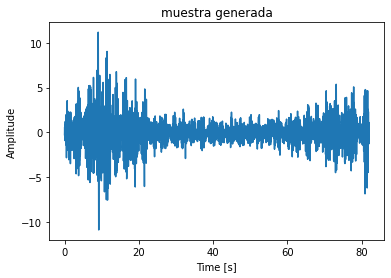

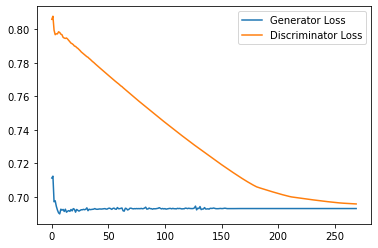

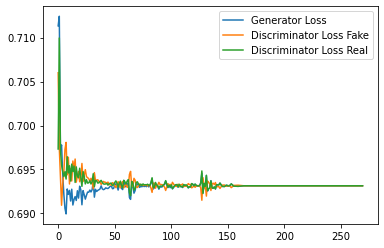

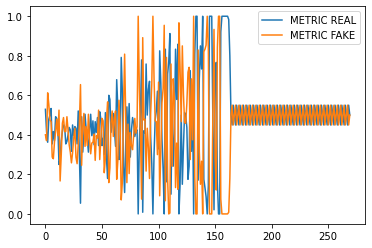

Step 5450: Generator loss: 0.6931470286846161, discriminator loss: 0.6958206033706665
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


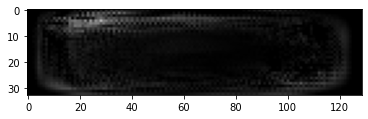

Espectrogramas Reales


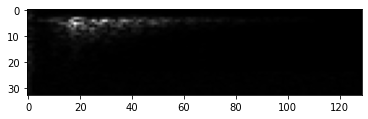

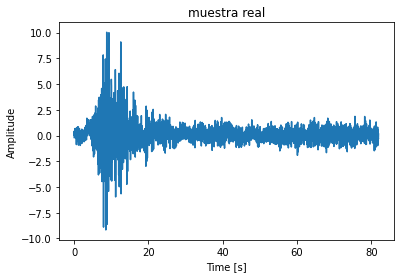

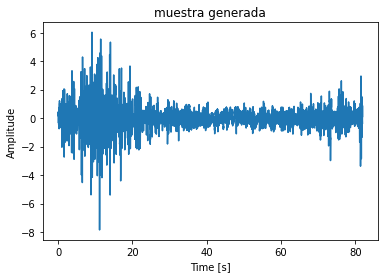

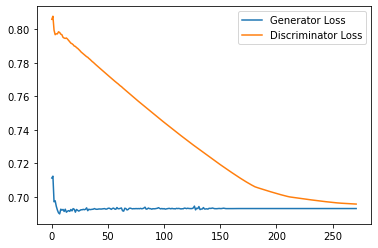

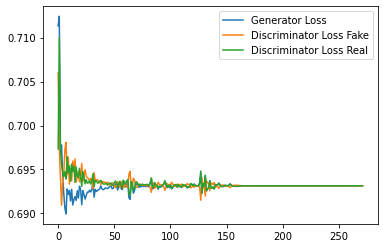

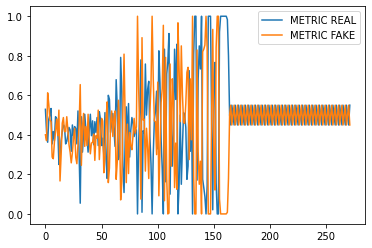

Step 5500: Generator loss: 0.6931472563743591, discriminator loss: 0.6957275152206421
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


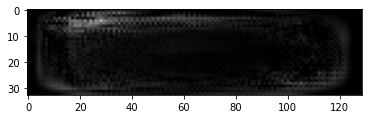

Espectrogramas Reales


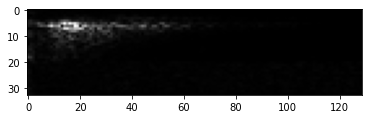

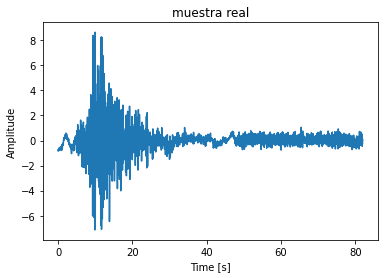

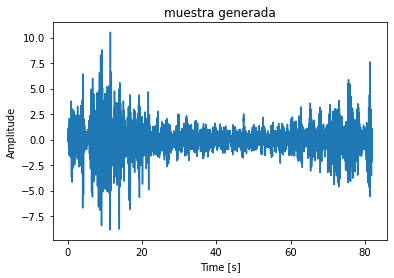

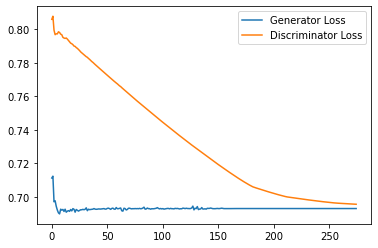

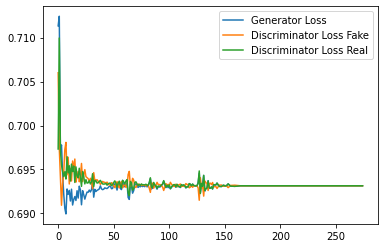

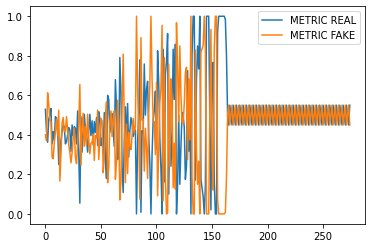

Step 5550: Generator loss: 0.6931474137306214, discriminator loss: 0.6956339621543884
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


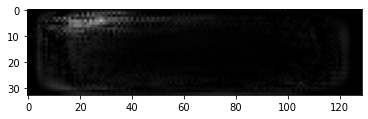

Espectrogramas Reales


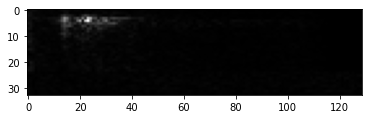

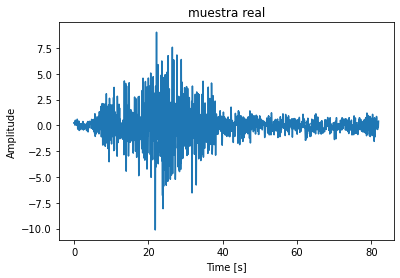

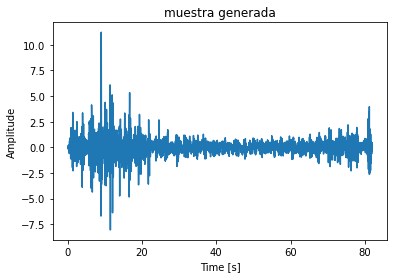

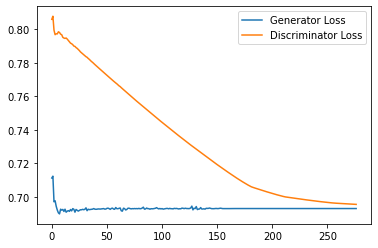

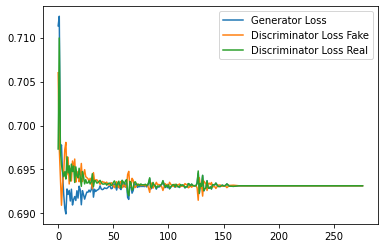

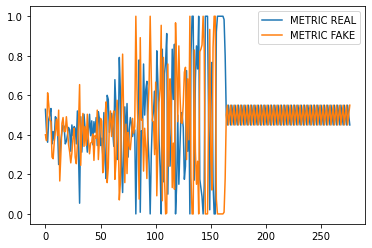

Step 5600: Generator loss: 0.69314701795578, discriminator loss: 0.6955422997474671
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


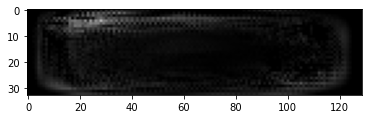

Espectrogramas Reales


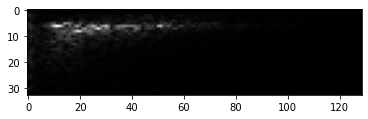

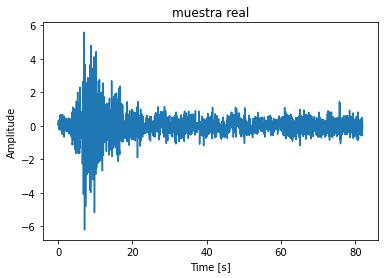

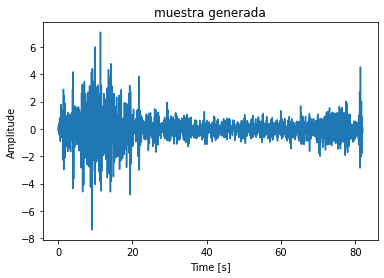

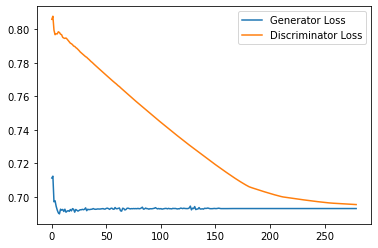

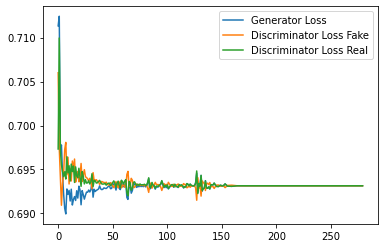

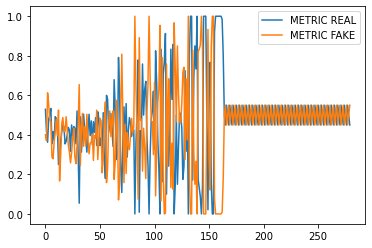

Epoch: 11


  0%|          | 0/513 [00:00<?, ?it/s]

Step 5650: Generator loss: 0.6931472623348236, discriminator loss: 0.6954515671730042
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


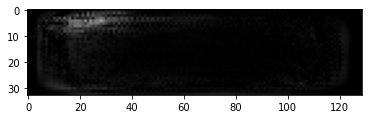

Espectrogramas Reales


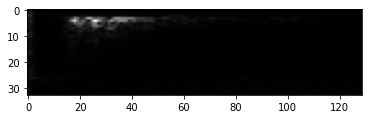

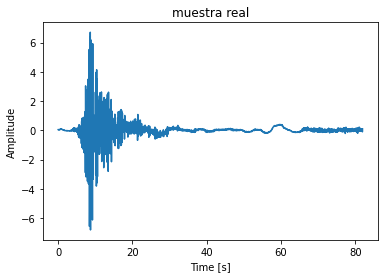

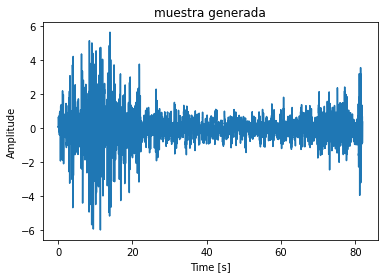

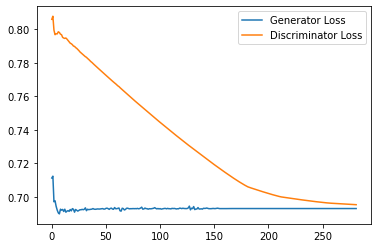

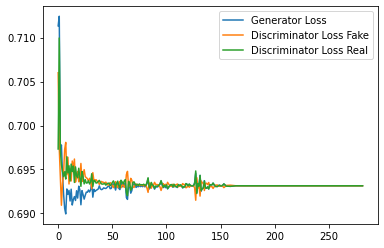

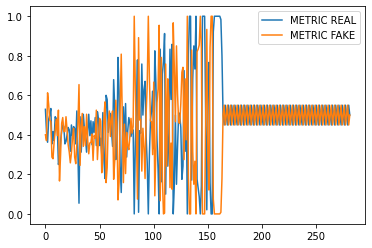

Step 5700: Generator loss: 0.6931474316120148, discriminator loss: 0.6953625547885894
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


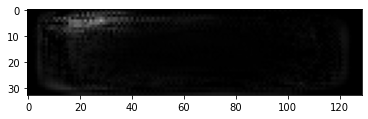

Espectrogramas Reales


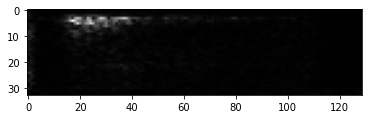

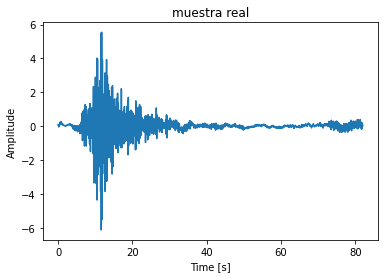

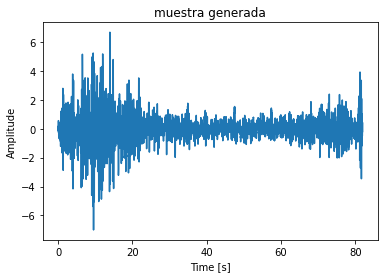

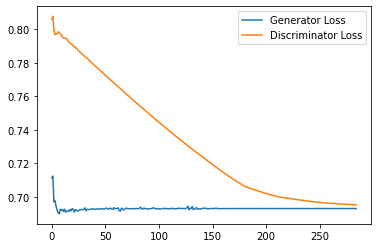

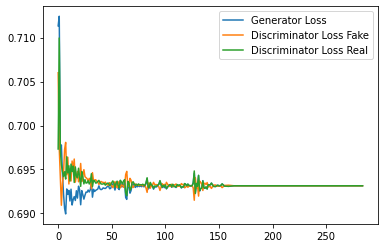

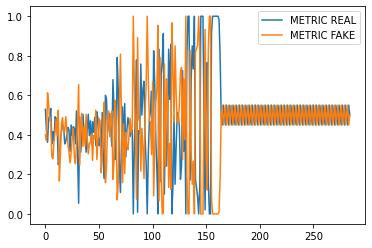

Step 5750: Generator loss: 0.6931470394134521, discriminator loss: 0.6952749538421631
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


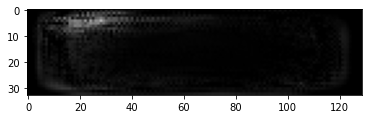

Espectrogramas Reales


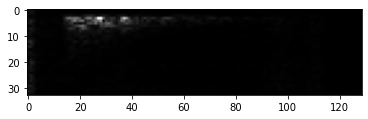

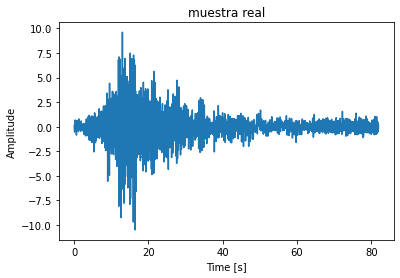

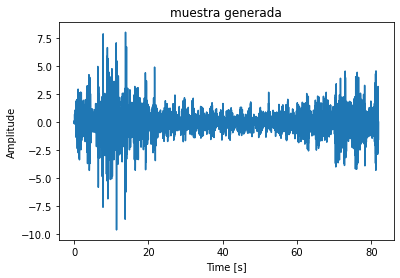

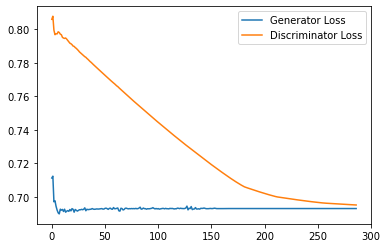

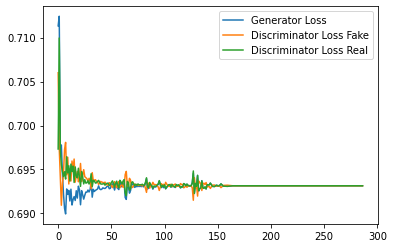

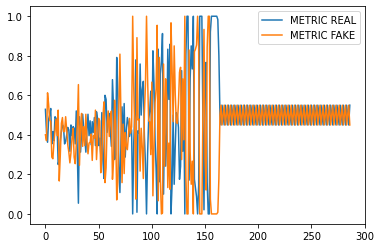

Step 5800: Generator loss: 0.6931472551822663, discriminator loss: 0.6951894164085388
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


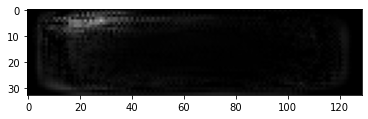

Espectrogramas Reales


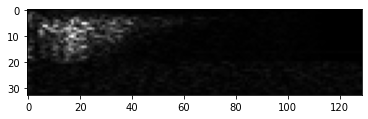

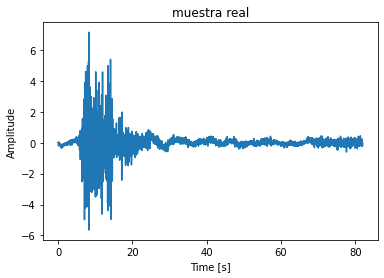

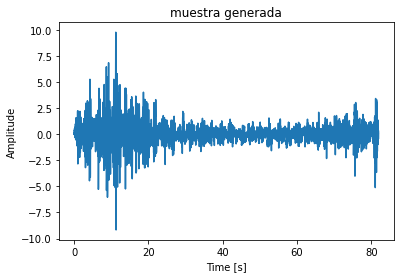

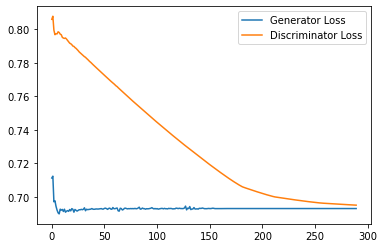

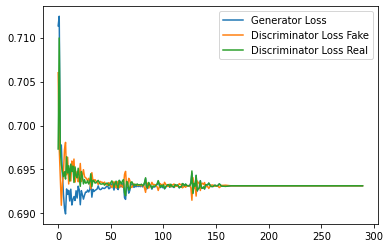

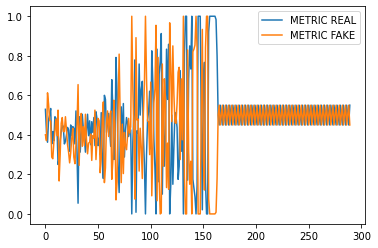

Step 5850: Generator loss: 0.6931474220752716, discriminator loss: 0.695106121301651
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


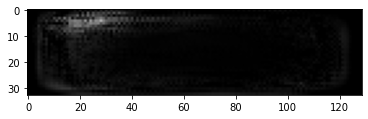

Espectrogramas Reales


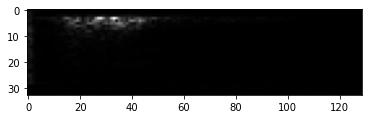

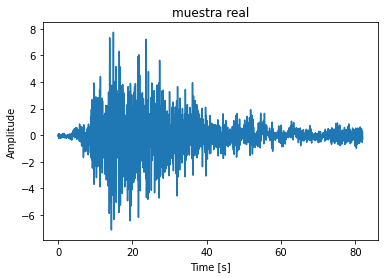

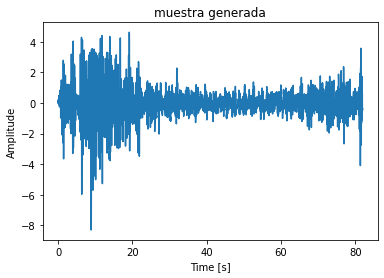

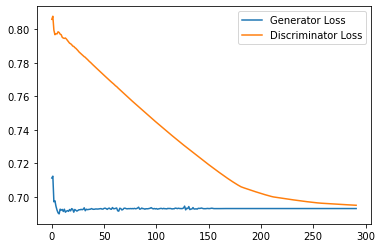

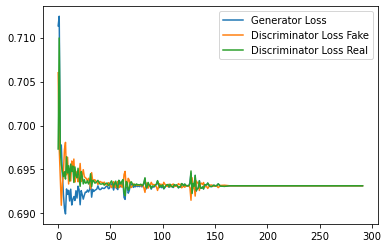

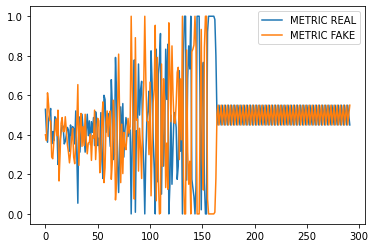

Step 5900: Generator loss: 0.6931470274925232, discriminator loss: 0.695025429725647
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


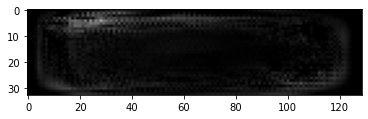

Espectrogramas Reales


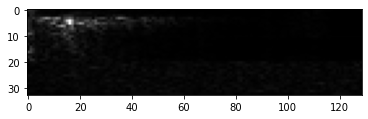

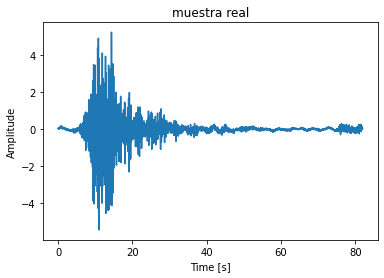

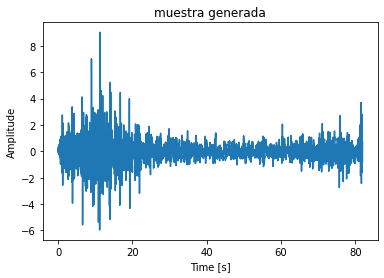

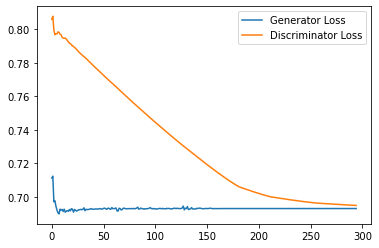

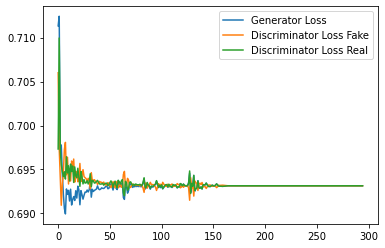

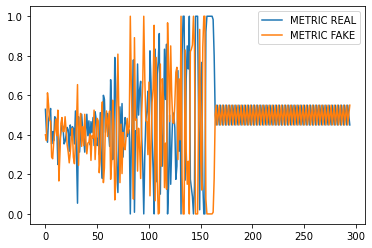

Step 5950: Generator loss: 0.6931472611427307, discriminator loss: 0.6949476408958435
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


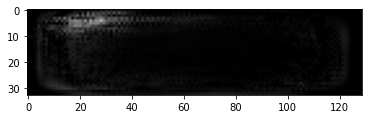

Espectrogramas Reales


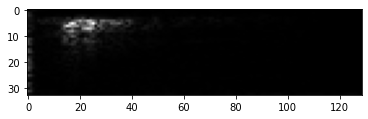

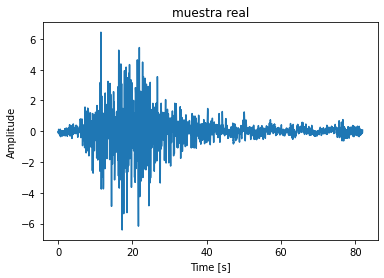

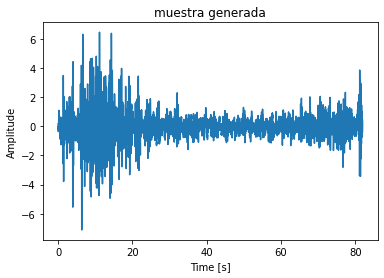

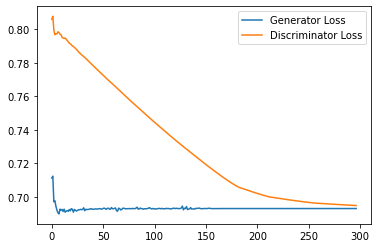

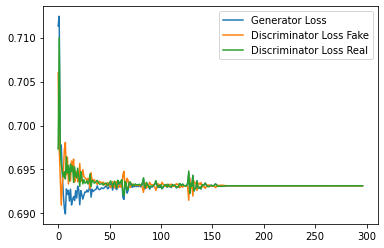

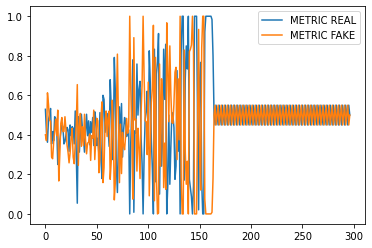

Step 6000: Generator loss: 0.6931474232673644, discriminator loss: 0.6948723566532135
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


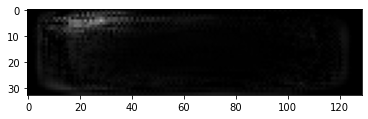

Espectrogramas Reales


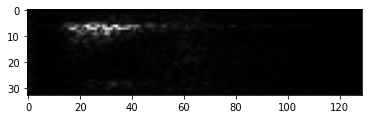

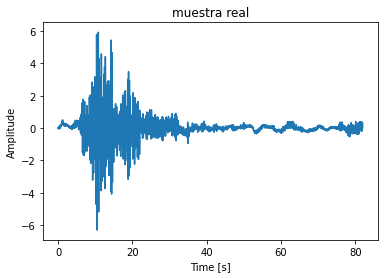

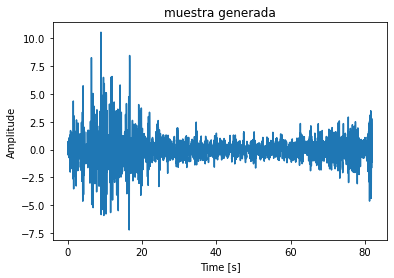

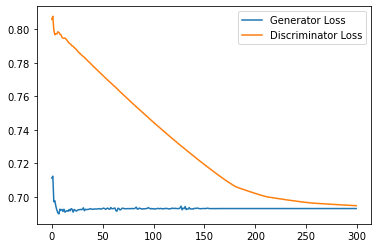

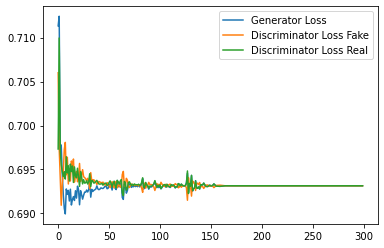

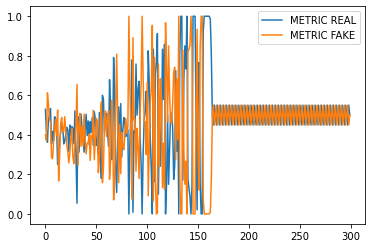

Step 6050: Generator loss: 0.69314701795578, discriminator loss: 0.6948015749454498
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


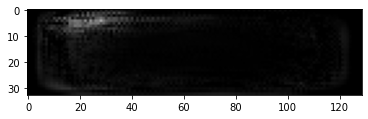

Espectrogramas Reales


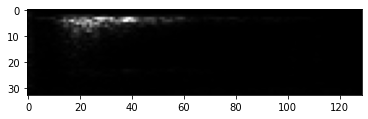

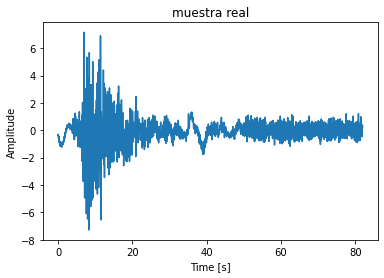

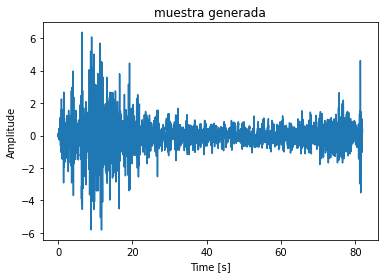

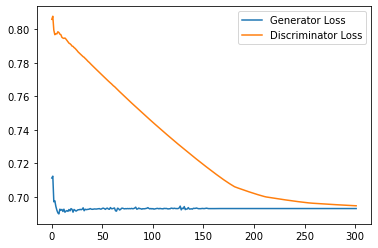

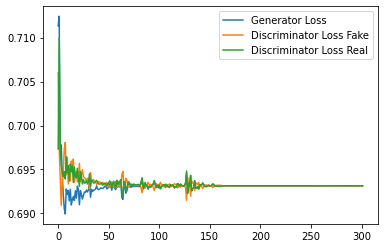

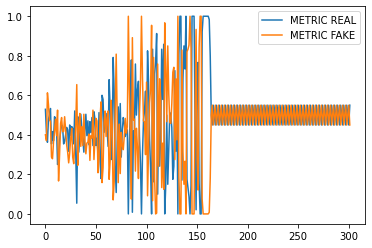

Step 6100: Generator loss: 0.6931472551822663, discriminator loss: 0.6947337532043457
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


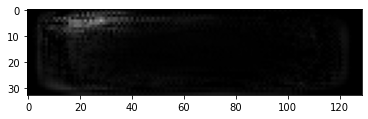

Espectrogramas Reales


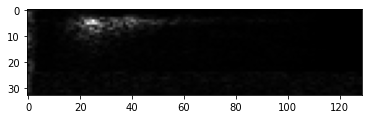

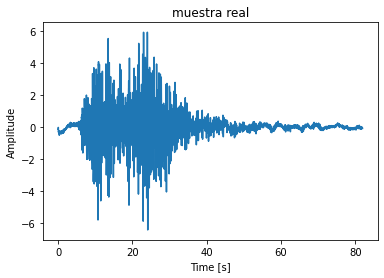

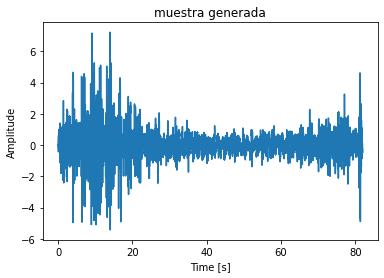

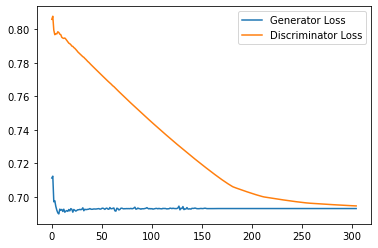

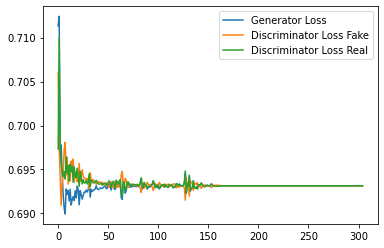

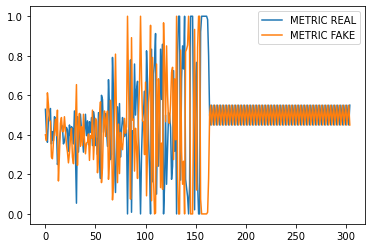

Step 6150: Generator loss: 0.6931474232673644, discriminator loss: 0.6946693909168243
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


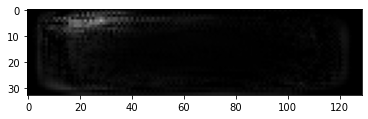

Espectrogramas Reales


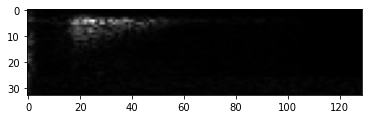

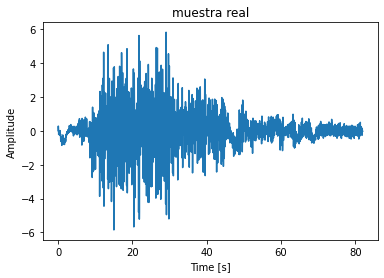

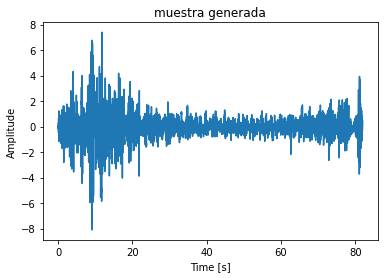

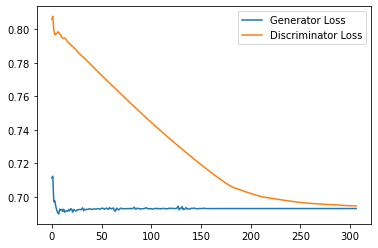

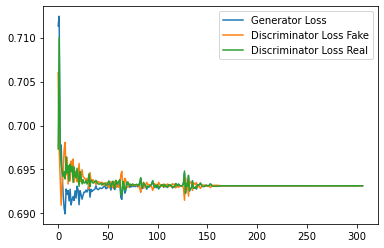

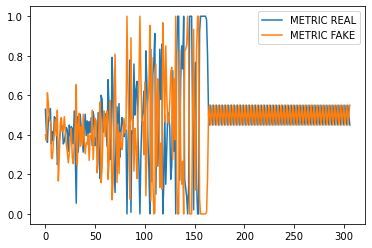

Epoch: 12


  0%|          | 0/513 [00:00<?, ?it/s]

Step 6200: Generator loss: 0.6931470167636872, discriminator loss: 0.6946077907085418
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


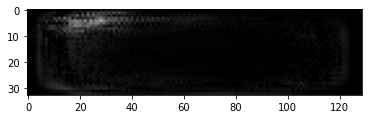

Espectrogramas Reales


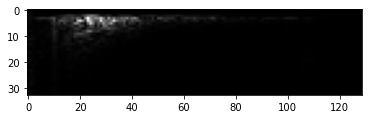

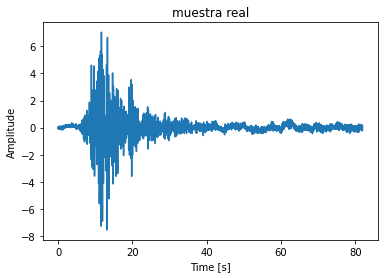

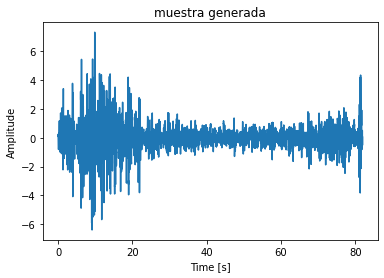

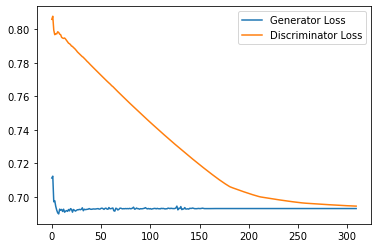

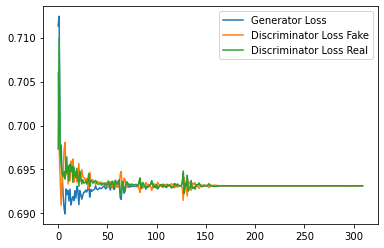

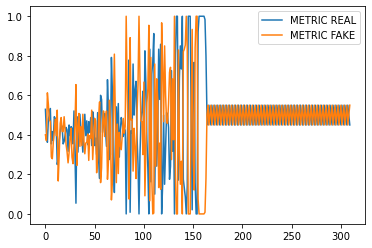

Step 6250: Generator loss: 0.6931472635269165, discriminator loss: 0.6945496320724487
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


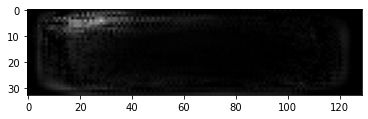

Espectrogramas Reales


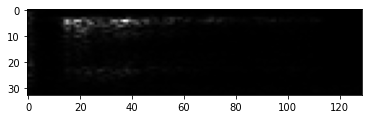

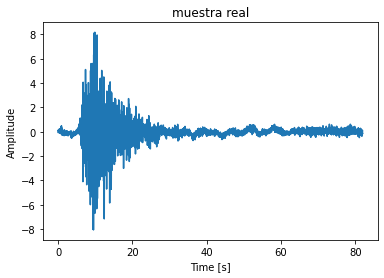

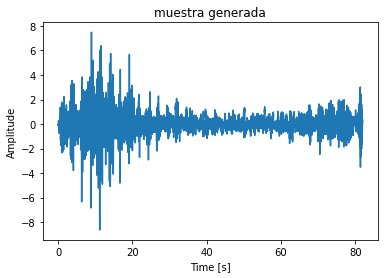

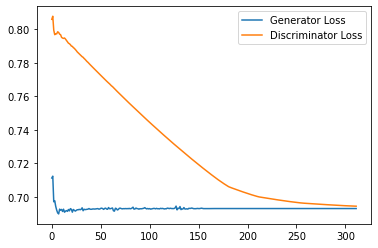

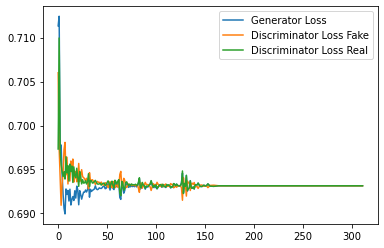

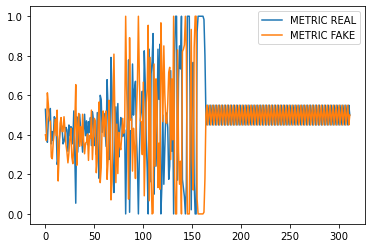

Step 6300: Generator loss: 0.6931474161148071, discriminator loss: 0.6944944047927857
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


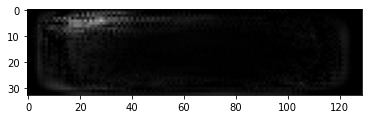

Espectrogramas Reales


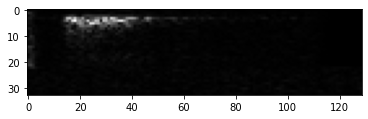

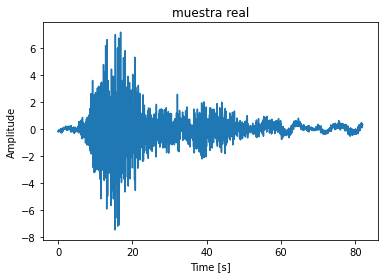

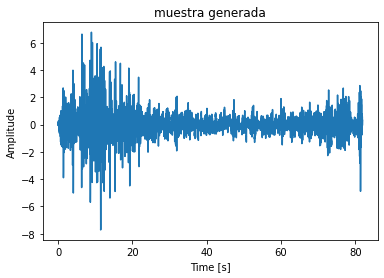

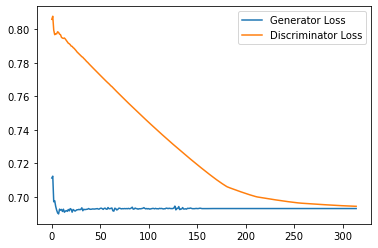

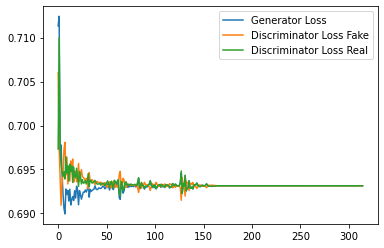

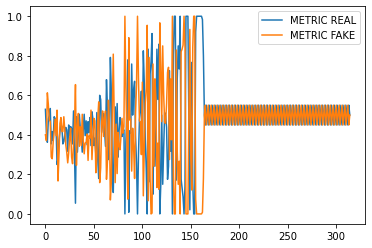

Step 6350: Generator loss: 0.693147006034851, discriminator loss: 0.6944424104690552
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


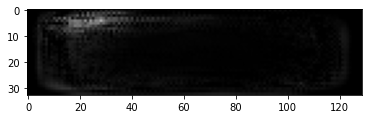

Espectrogramas Reales


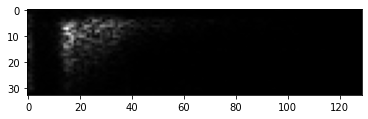

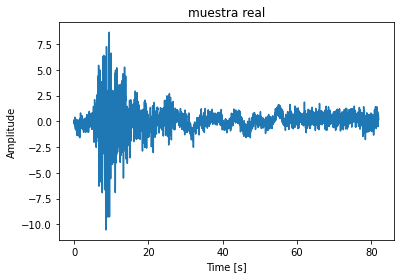

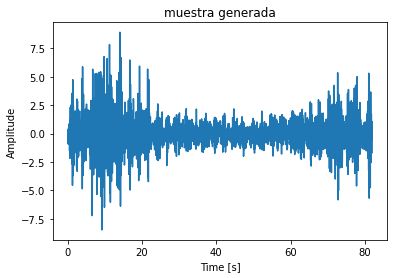

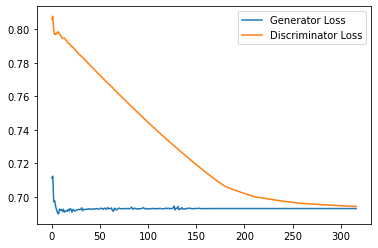

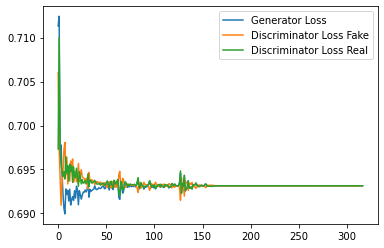

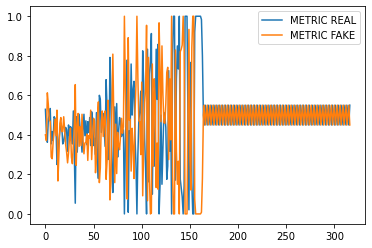

Step 6400: Generator loss: 0.6931472480297088, discriminator loss: 0.6943913161754608
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


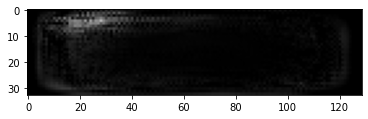

Espectrogramas Reales


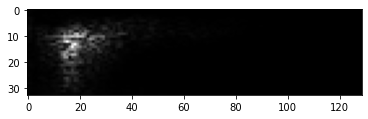

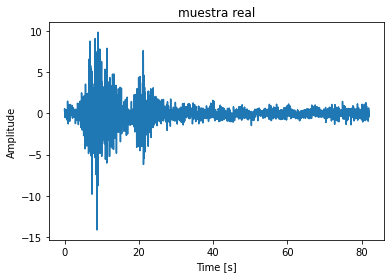

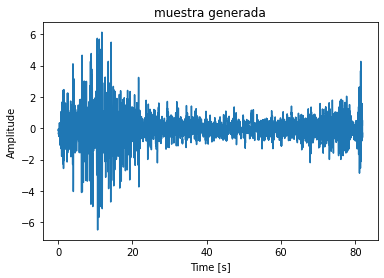

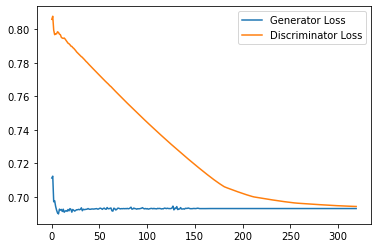

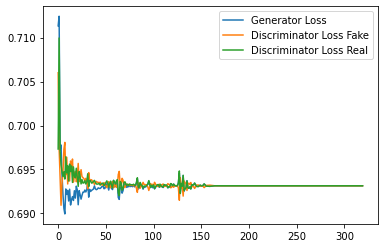

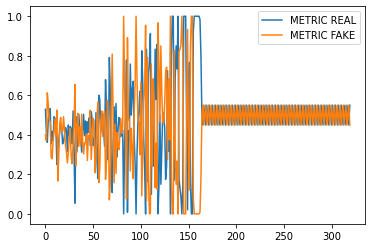

Step 6450: Generator loss: 0.6931474256515503, discriminator loss: 0.6943508458137512
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


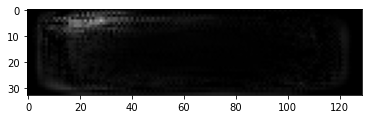

Espectrogramas Reales


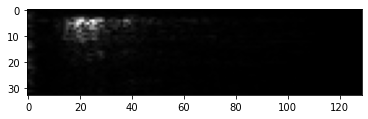

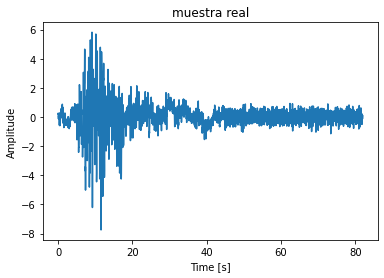

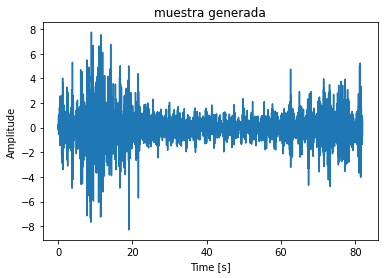

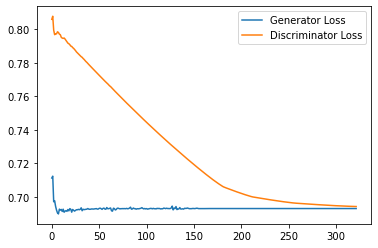

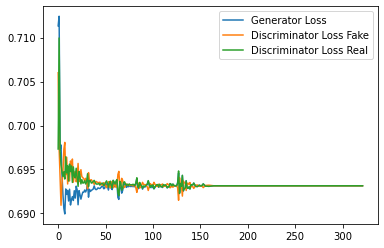

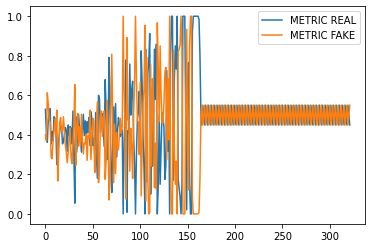

Step 6500: Generator loss: 0.6931470286846161, discriminator loss: 0.6943189132213593
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


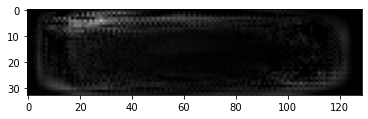

Espectrogramas Reales


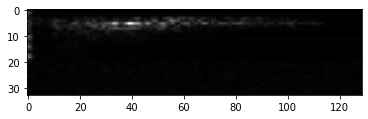

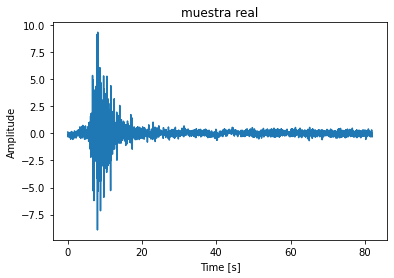

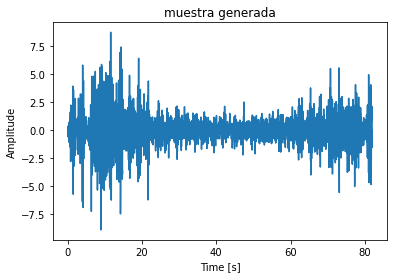

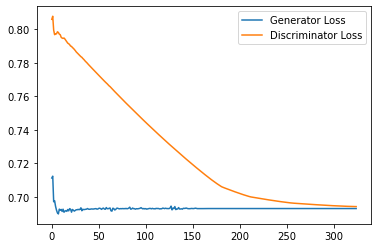

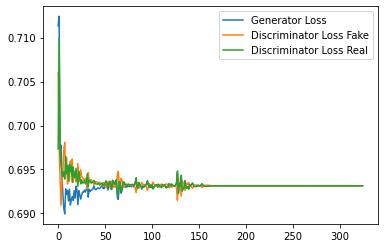

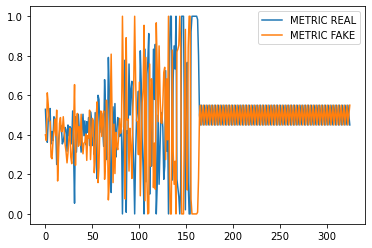

Step 6550: Generator loss: 0.6931472647190094, discriminator loss: 0.6942860710620881
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


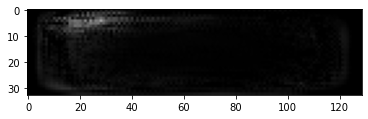

Espectrogramas Reales


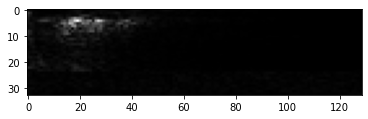

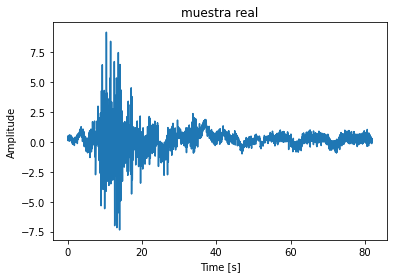

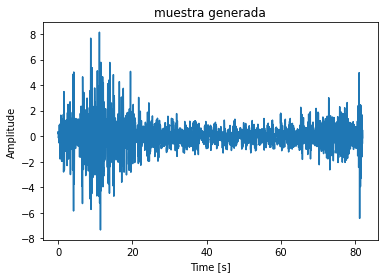

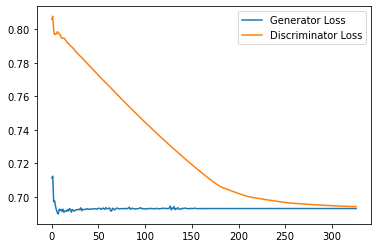

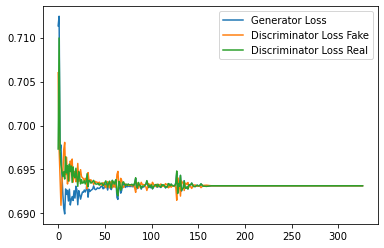

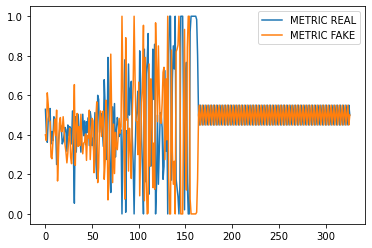

Step 6600: Generator loss: 0.6931474351882935, discriminator loss: 0.6942554199695588
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


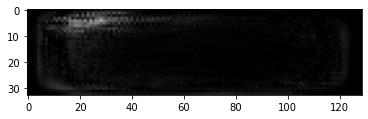

Espectrogramas Reales


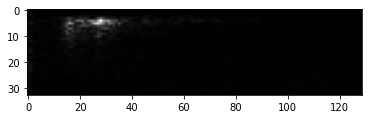

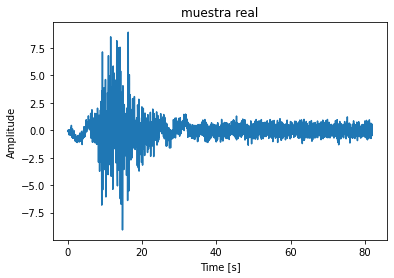

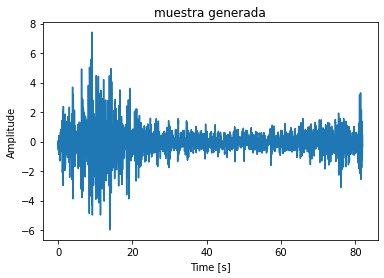

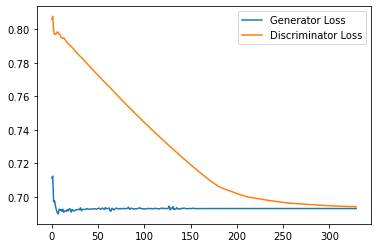

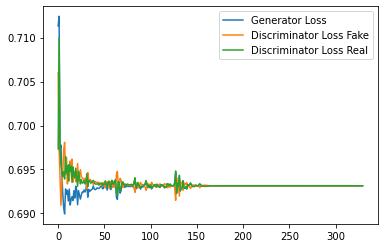

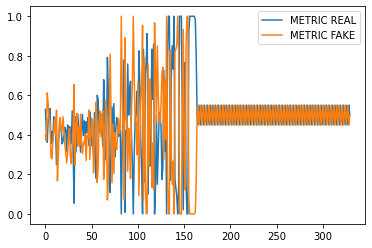

Step 6650: Generator loss: 0.6931470263004303, discriminator loss: 0.6942233633995056
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


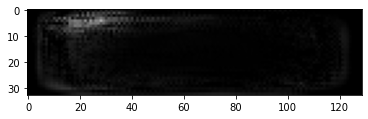

Espectrogramas Reales


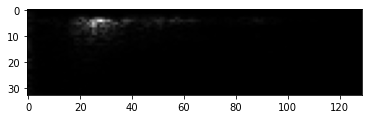

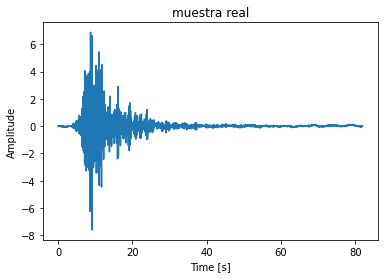

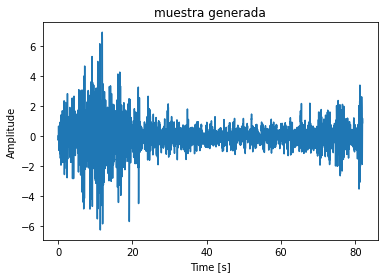

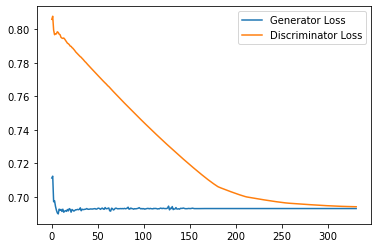

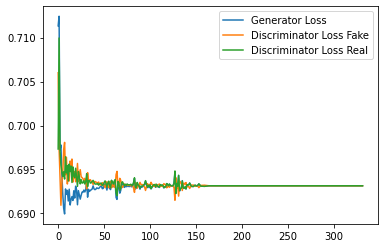

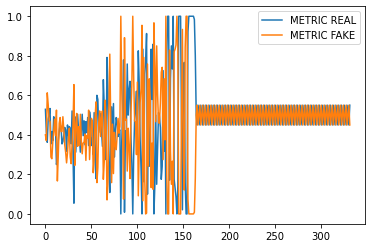

Epoch: 13


  0%|          | 0/513 [00:00<?, ?it/s]

Step 6700: Generator loss: 0.6931472647190094, discriminator loss: 0.6941920506954193
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


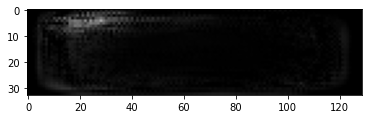

Espectrogramas Reales


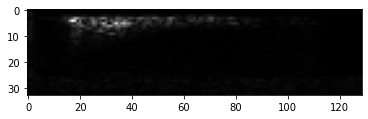

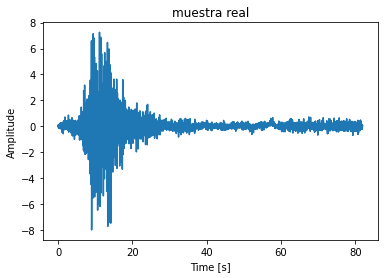

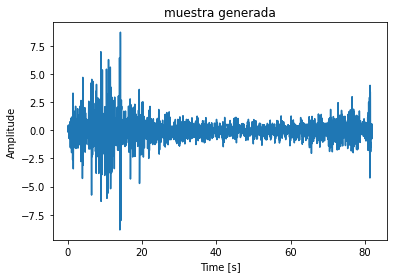

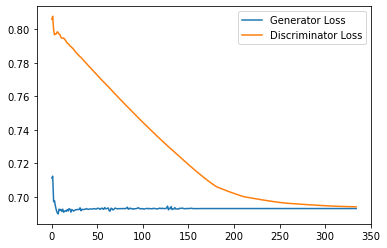

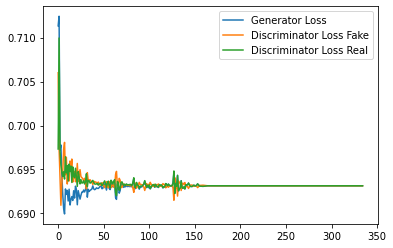

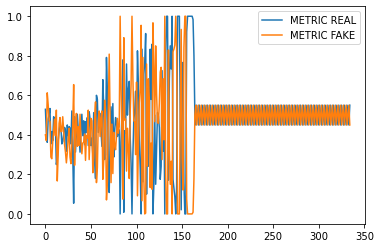

Step 6750: Generator loss: 0.6931474351882935, discriminator loss: 0.6941601967811585
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


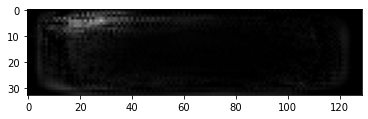

Espectrogramas Reales


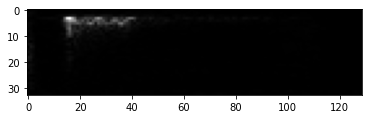

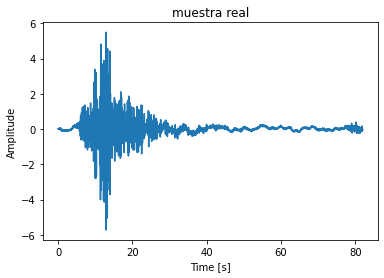

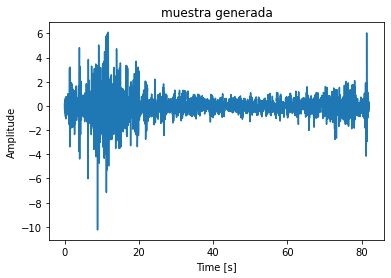

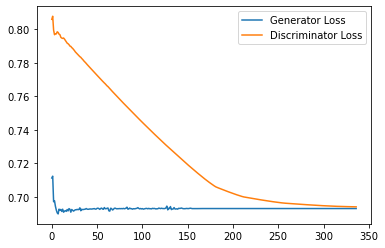

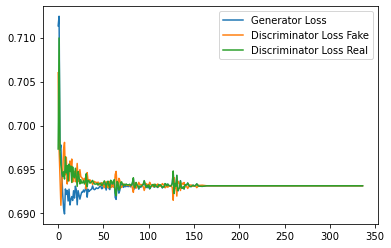

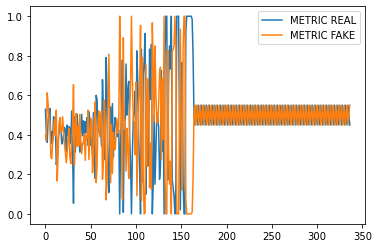

Step 6800: Generator loss: 0.6931469988822937, discriminator loss: 0.6941301715373993
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


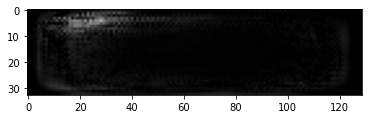

Espectrogramas Reales


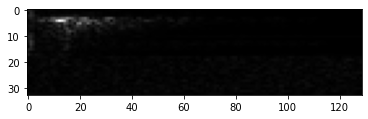

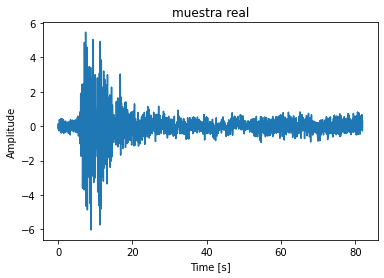

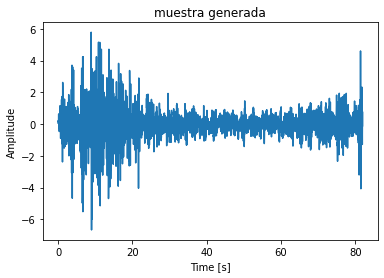

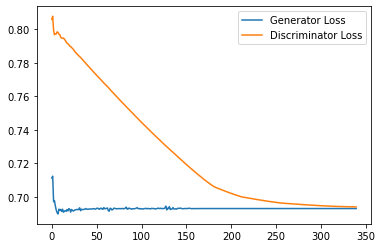

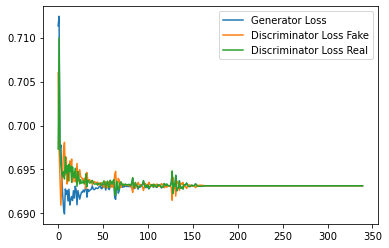

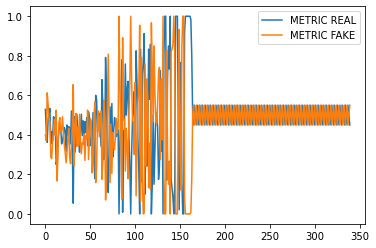

Step 6850: Generator loss: 0.6931472313404083, discriminator loss: 0.6940991318225861
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


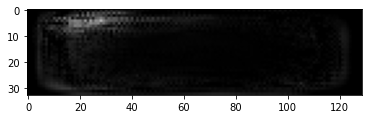

Espectrogramas Reales


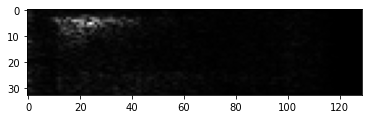

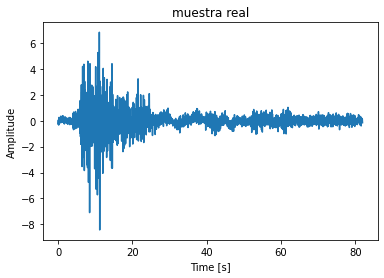

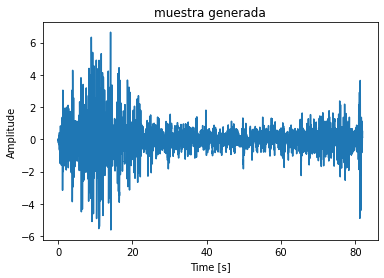

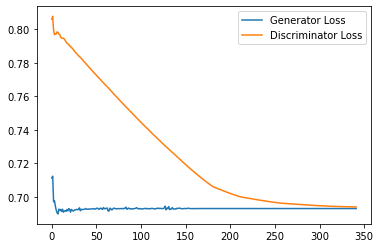

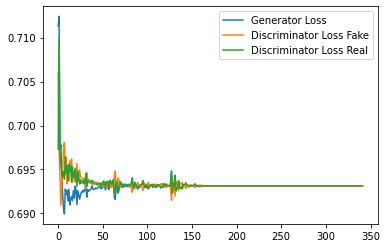

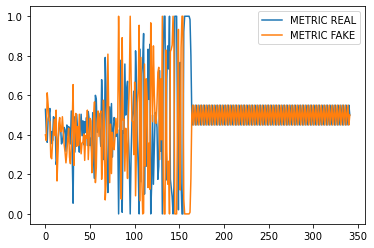

Step 6900: Generator loss: 0.6931473875045776, discriminator loss: 0.6940683901309967
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


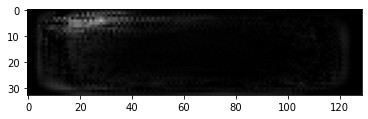

Espectrogramas Reales


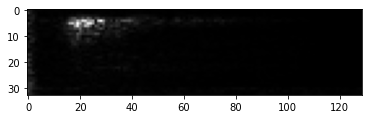

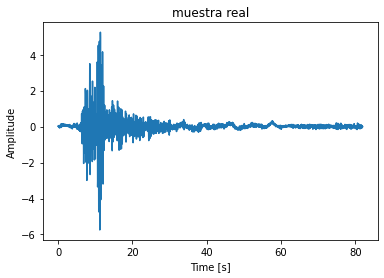

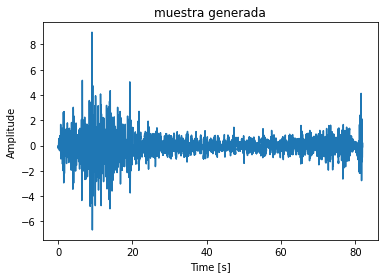

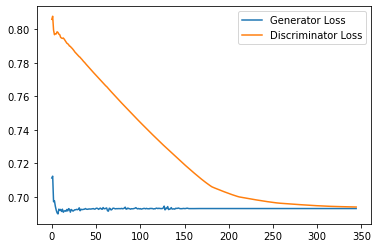

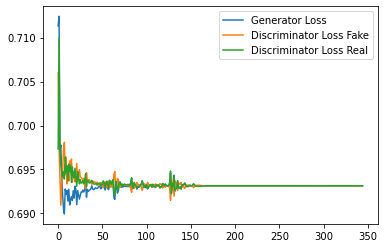

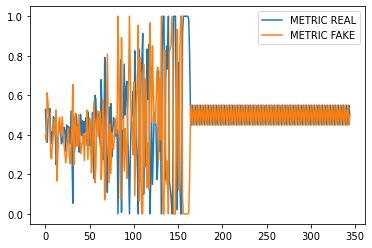

Step 6950: Generator loss: 0.6931469750404358, discriminator loss: 0.6940382146835327
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


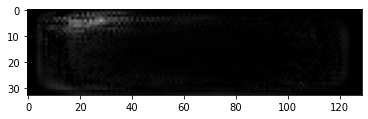

Espectrogramas Reales


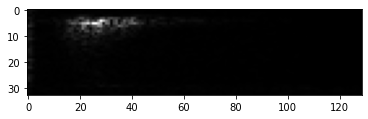

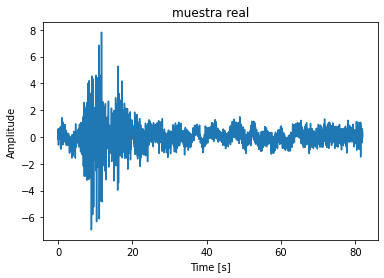

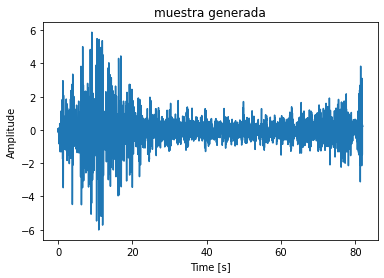

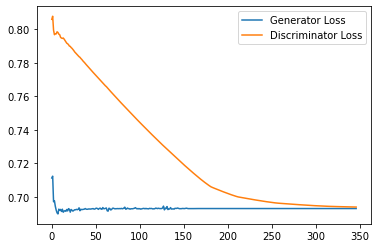

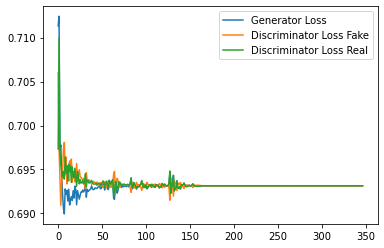

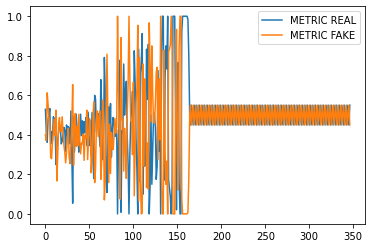

Step 7000: Generator loss: 0.6931472170352936, discriminator loss: 0.6940097713470459
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


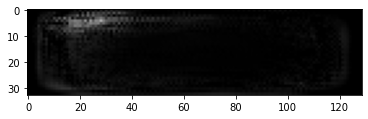

Espectrogramas Reales


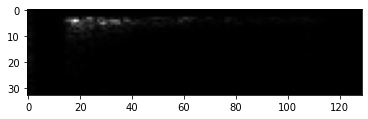

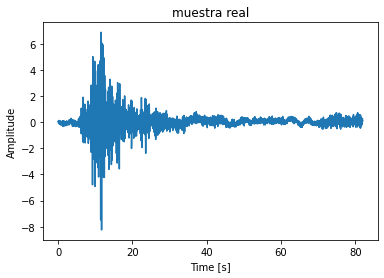

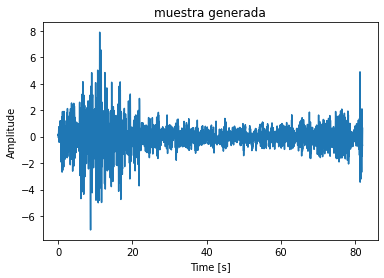

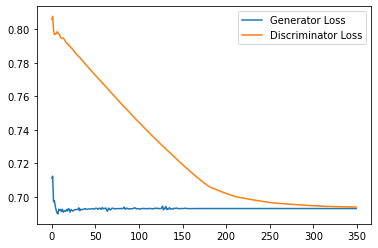

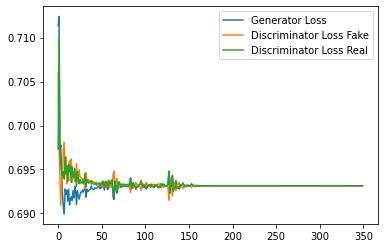

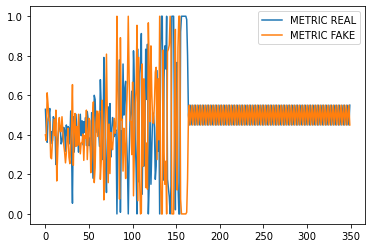

Step 7050: Generator loss: 0.6931473922729492, discriminator loss: 0.6939792799949646
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


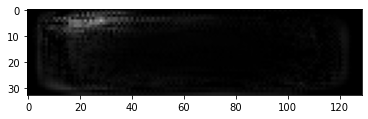

Espectrogramas Reales


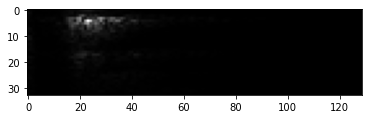

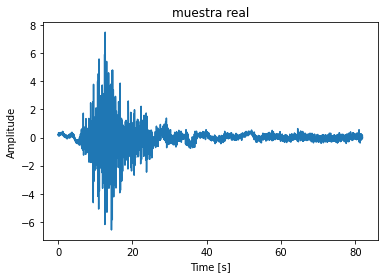

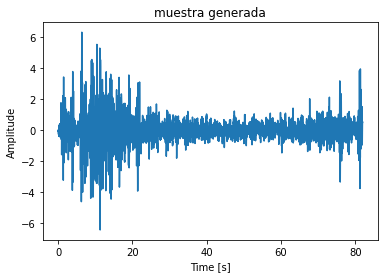

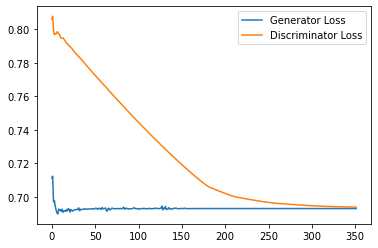

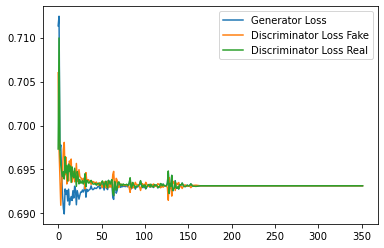

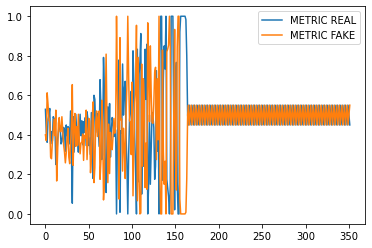

Step 7100: Generator loss: 0.6931469798088074, discriminator loss: 0.6939498209953308
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


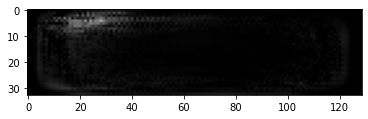

Espectrogramas Reales


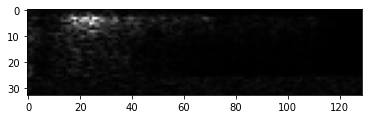

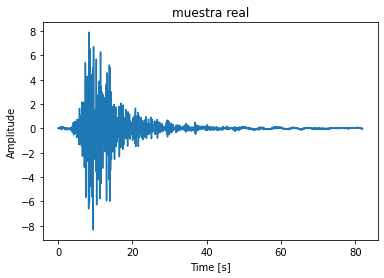

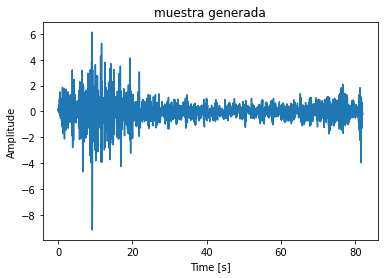

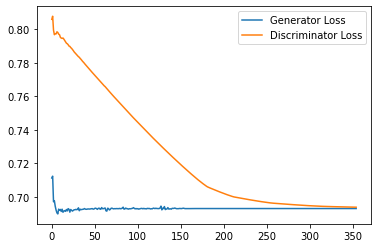

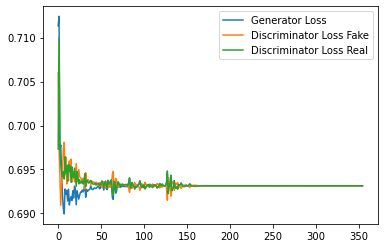

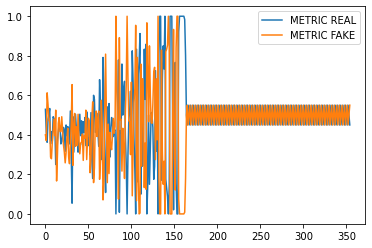

Step 7150: Generator loss: 0.6931472289562225, discriminator loss: 0.6939219927787781
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


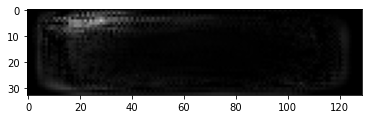

Espectrogramas Reales


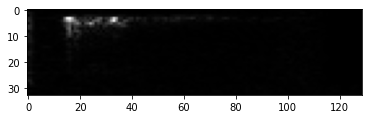

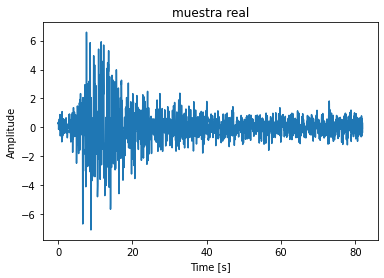

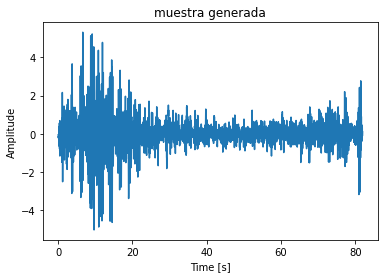

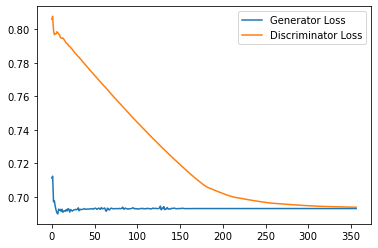

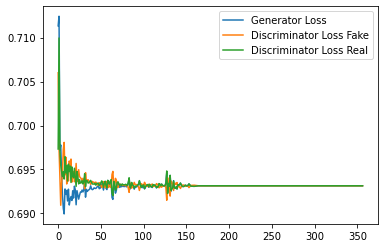

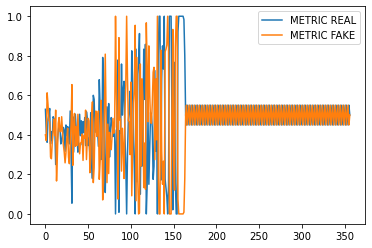

Epoch: 14


  0%|          | 0/513 [00:00<?, ?it/s]

Step 7200: Generator loss: 0.6931474089622498, discriminator loss: 0.6938927233219147
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


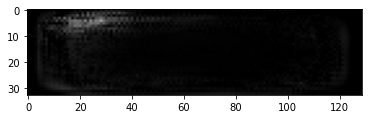

Espectrogramas Reales


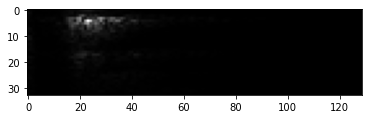

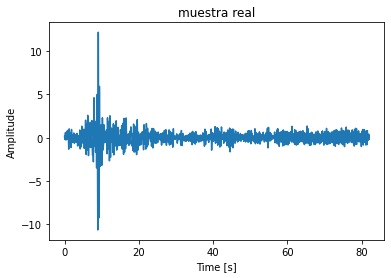

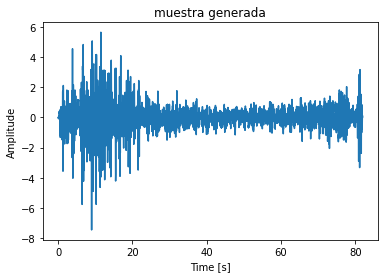

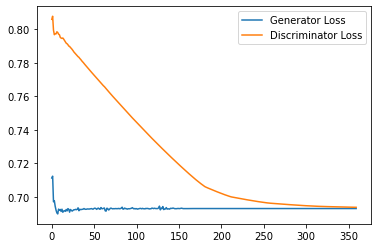

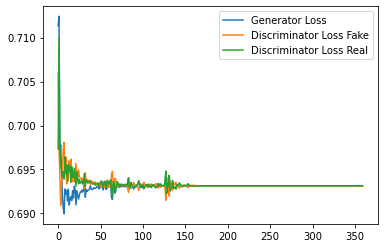

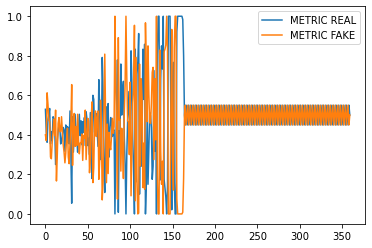

Step 7250: Generator loss: 0.6931469941139221, discriminator loss: 0.6938653719425202
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


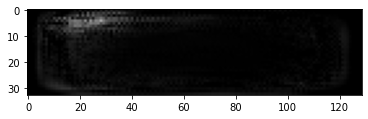

Espectrogramas Reales


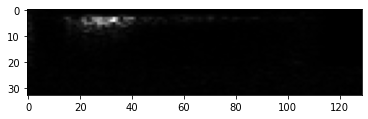

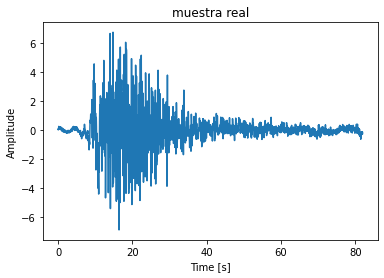

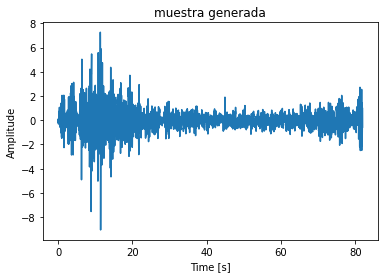

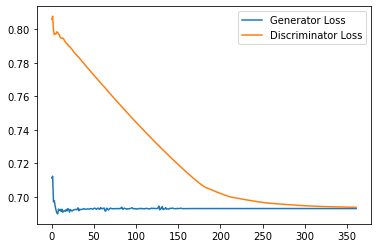

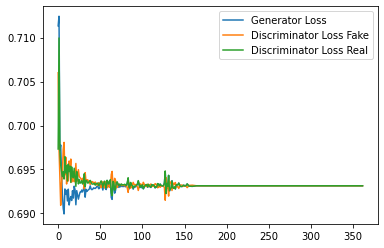

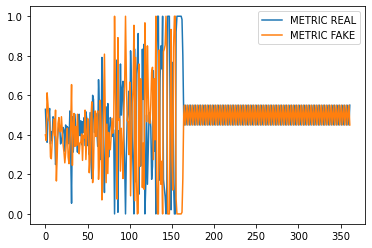

Step 7300: Generator loss: 0.6931472337245941, discriminator loss: 0.6938380014896393
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


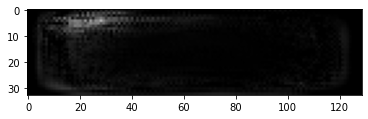

Espectrogramas Reales


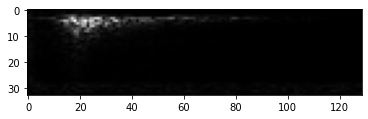

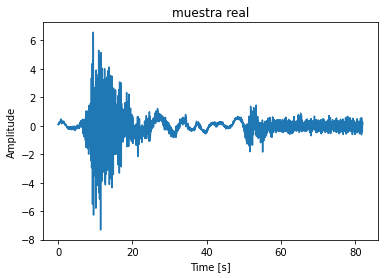

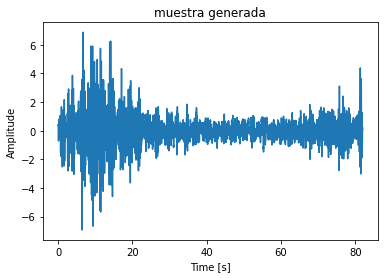

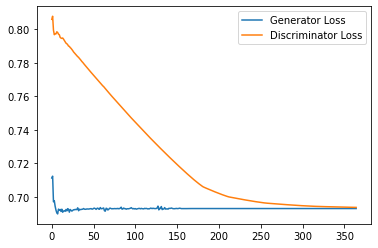

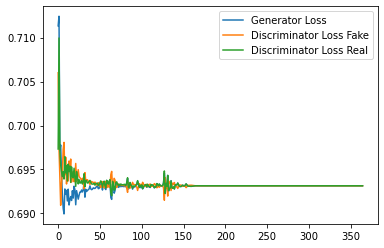

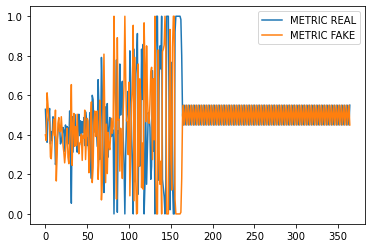

Step 7350: Generator loss: 0.6931474089622498, discriminator loss: 0.6938104200363159
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


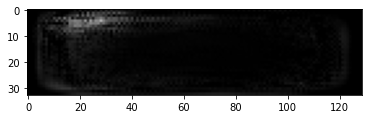

Espectrogramas Reales


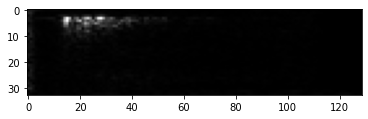

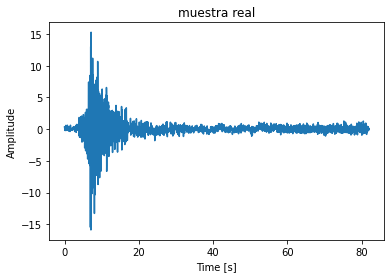

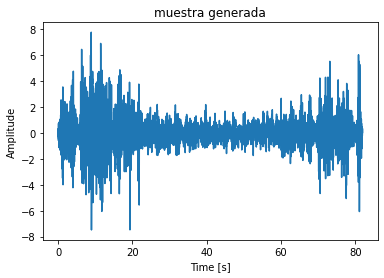

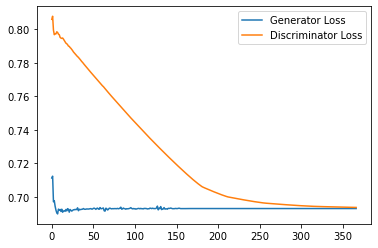

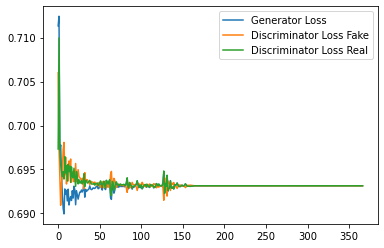

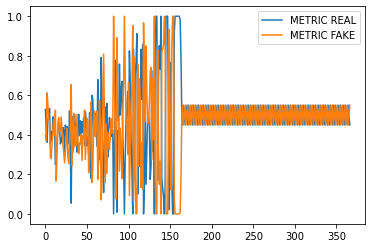

Step 7400: Generator loss: 0.6931469941139221, discriminator loss: 0.6937836587429047
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


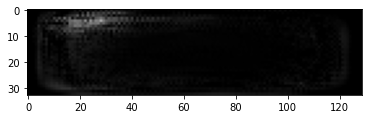

Espectrogramas Reales


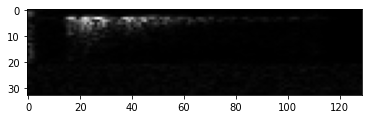

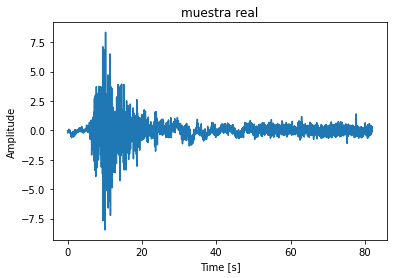

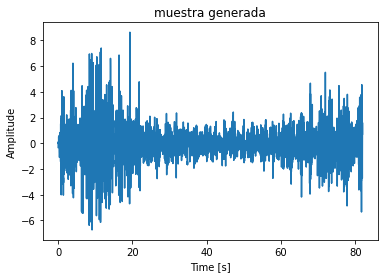

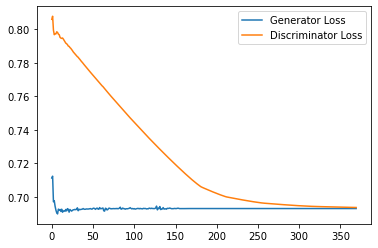

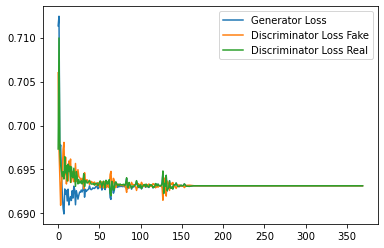

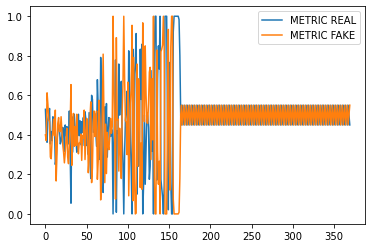

Step 7450: Generator loss: 0.6931472325325012, discriminator loss: 0.6937579047679902
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


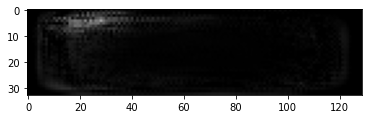

Espectrogramas Reales


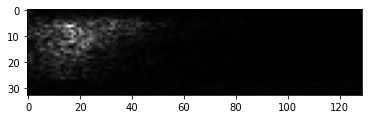

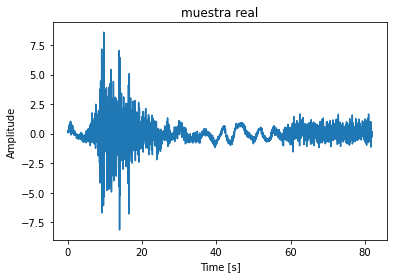

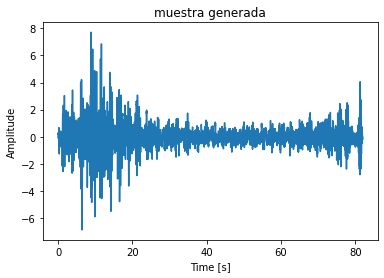

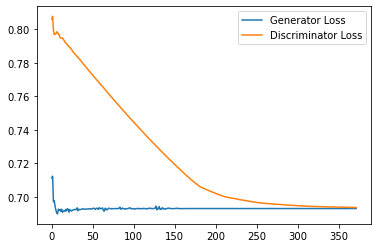

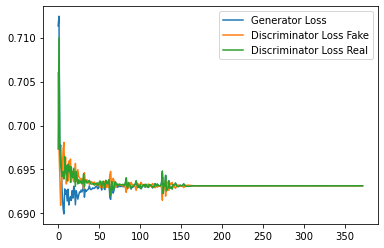

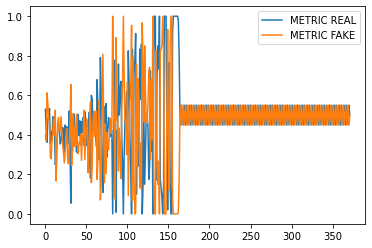

Step 7500: Generator loss: 0.6931474030017852, discriminator loss: 0.6937325012683868
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


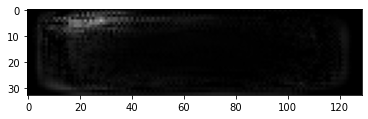

Espectrogramas Reales


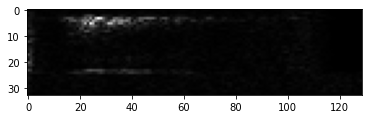

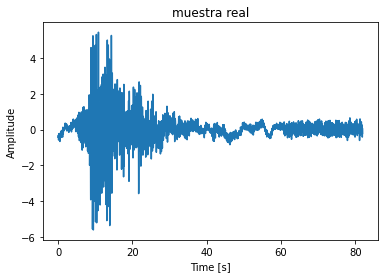

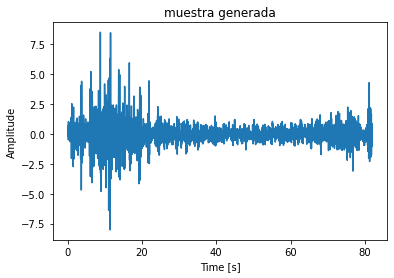

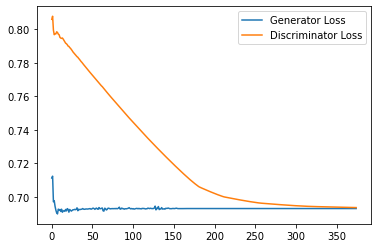

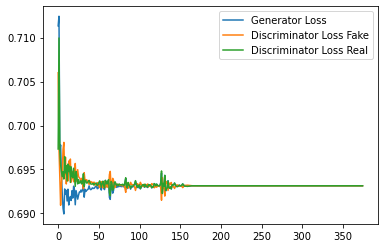

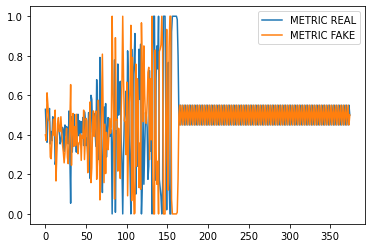

Step 7550: Generator loss: 0.6931469857692718, discriminator loss: 0.6937060844898224
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


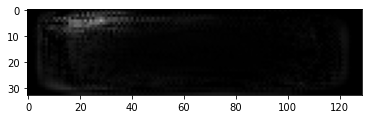

Espectrogramas Reales


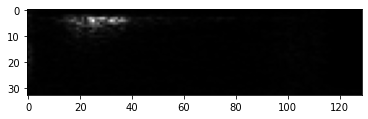

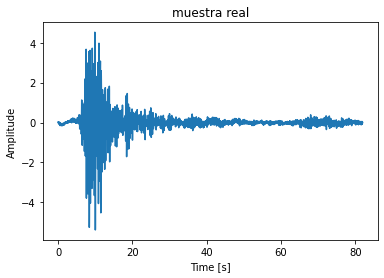

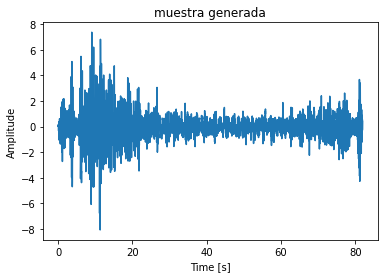

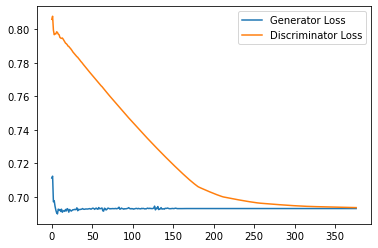

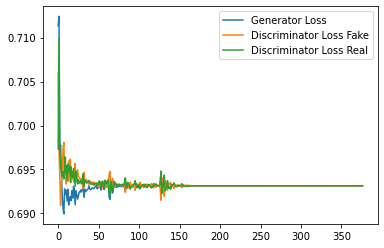

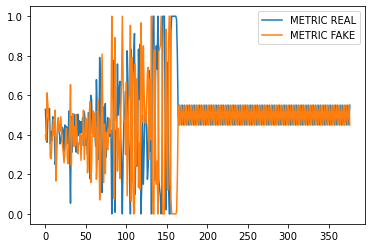

Step 7600: Generator loss: 0.6931472265720368, discriminator loss: 0.6936817562580109
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


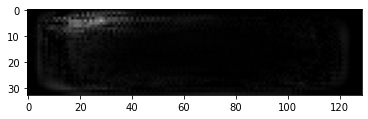

Espectrogramas Reales


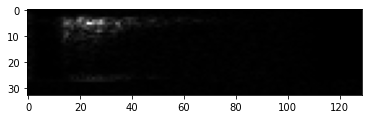

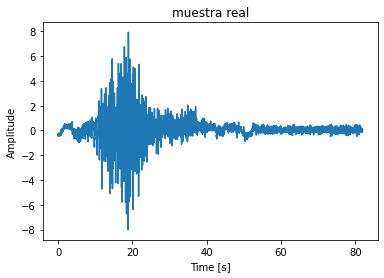

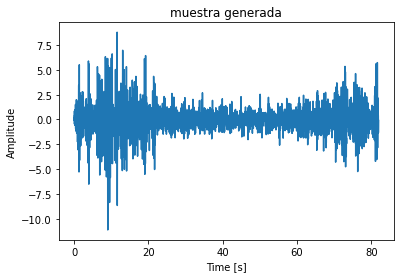

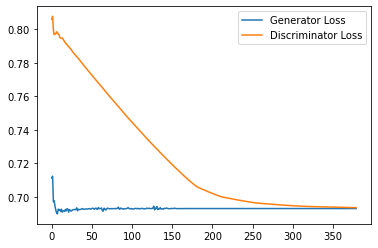

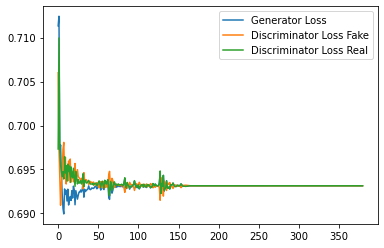

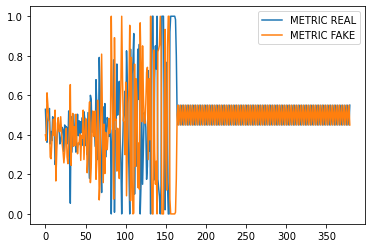

Step 7650: Generator loss: 0.6931474006175995, discriminator loss: 0.6936573481559754
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


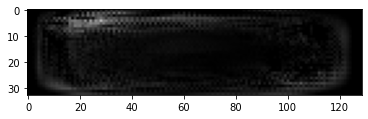

Espectrogramas Reales


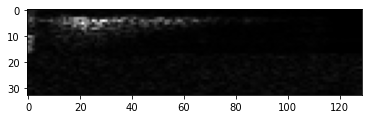

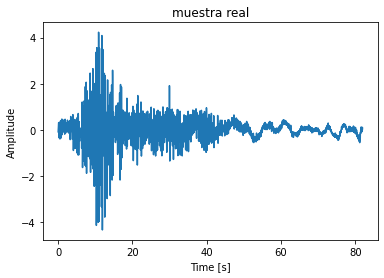

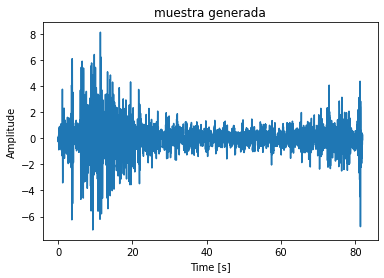

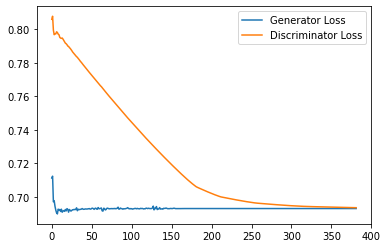

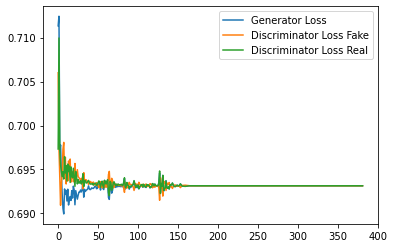

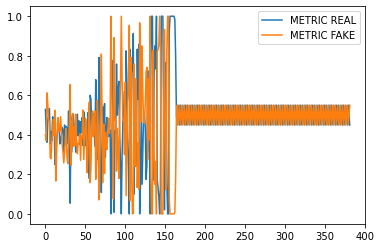

Epoch: 15


  0%|          | 0/513 [00:00<?, ?it/s]

Step 7700: Generator loss: 0.6931469857692718, discriminator loss: 0.6936329638957978
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


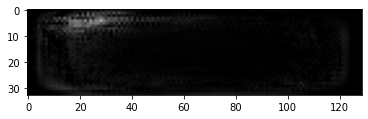

Espectrogramas Reales


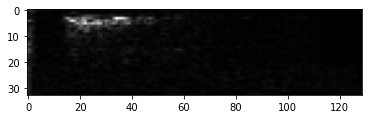

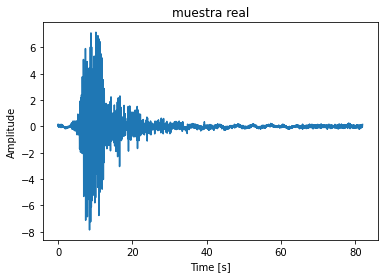

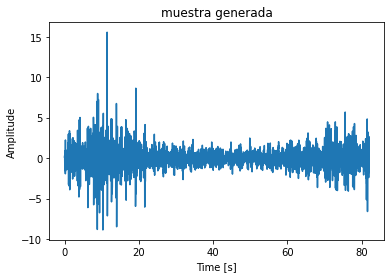

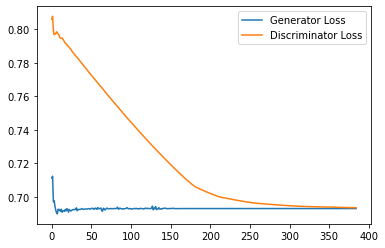

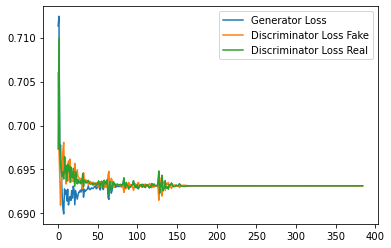

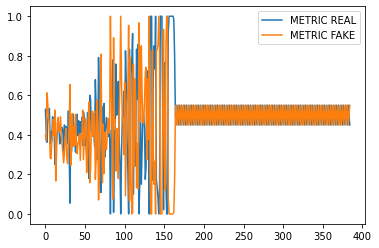

Step 7750: Generator loss: 0.6931472265720368, discriminator loss: 0.6936090183258057
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


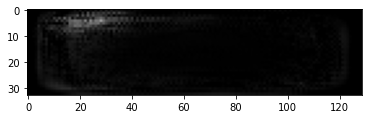

Espectrogramas Reales


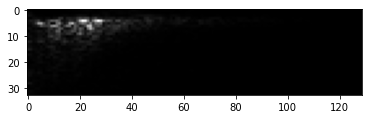

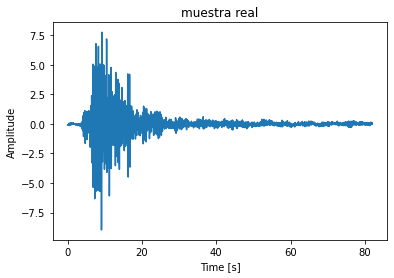

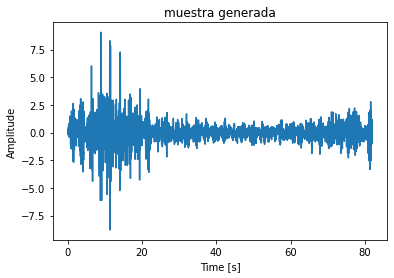

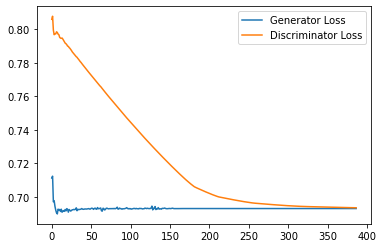

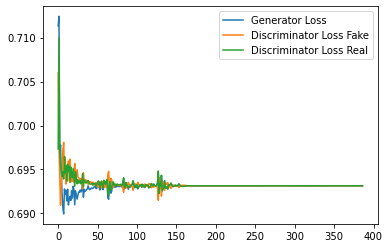

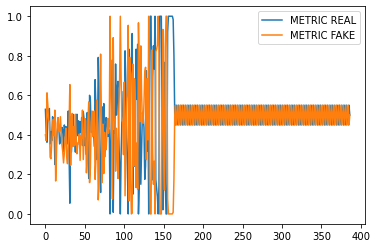

Step 7800: Generator loss: 0.6931474018096924, discriminator loss: 0.6935858082771301
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


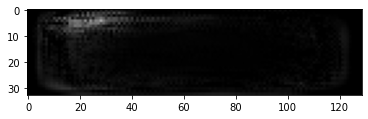

Espectrogramas Reales


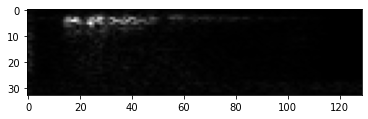

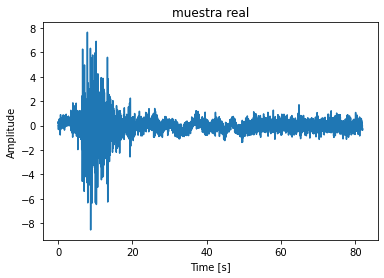

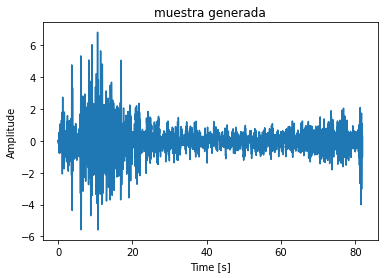

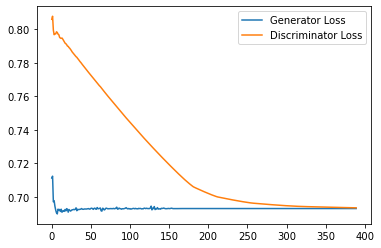

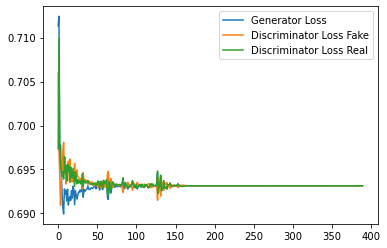

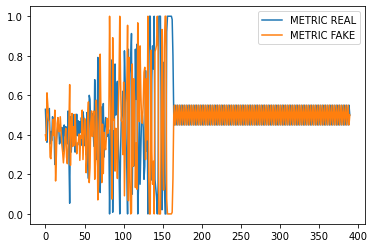

Step 7850: Generator loss: 0.6931469857692718, discriminator loss: 0.6935629951953888
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


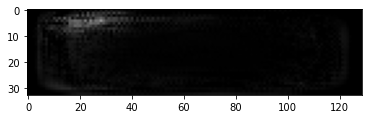

Espectrogramas Reales


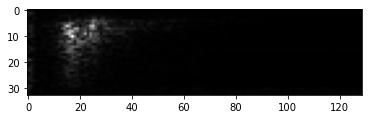

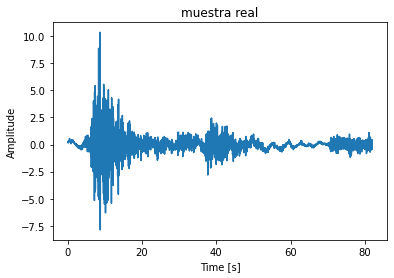

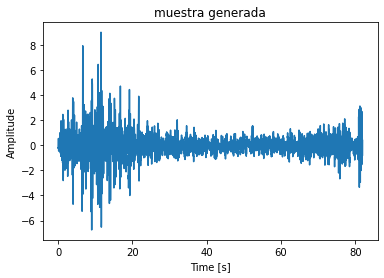

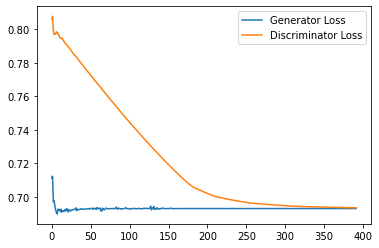

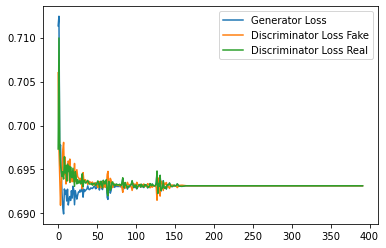

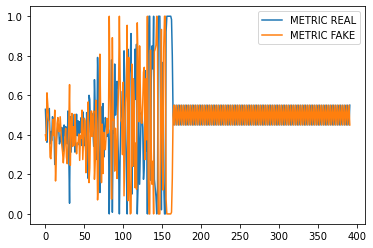

Step 7900: Generator loss: 0.6931472384929657, discriminator loss: 0.6935414445400238
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


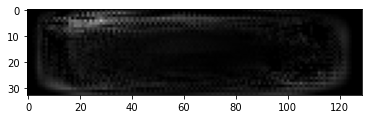

Espectrogramas Reales


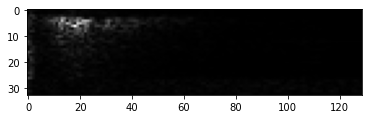

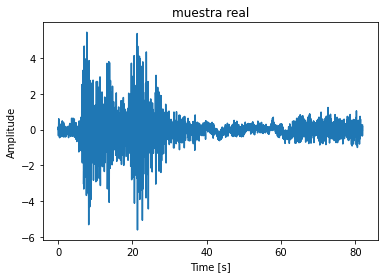

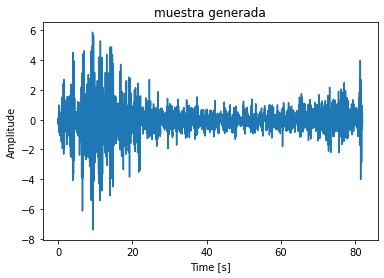

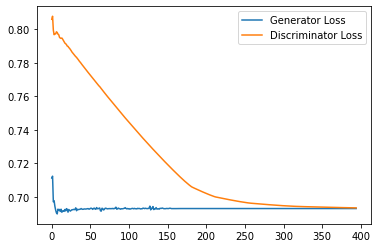

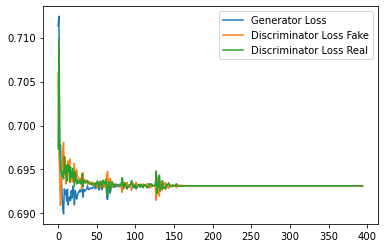

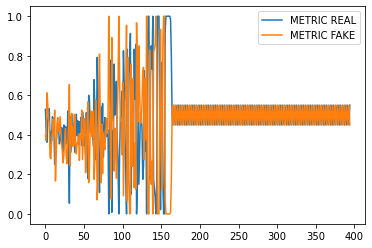

Step 7950: Generator loss: 0.6931474232673644, discriminator loss: 0.6935185158252716
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


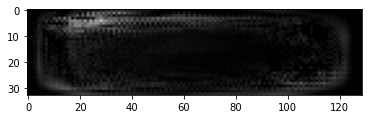

Espectrogramas Reales


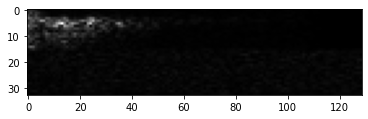

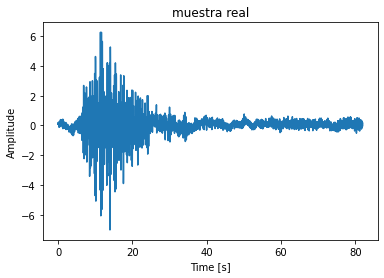

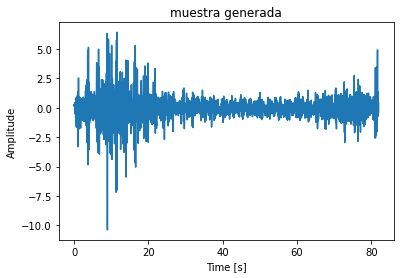

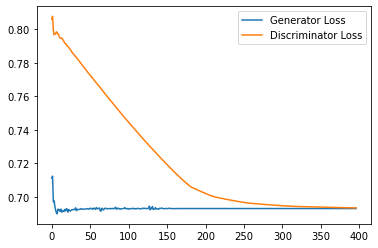

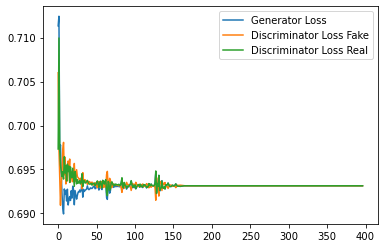

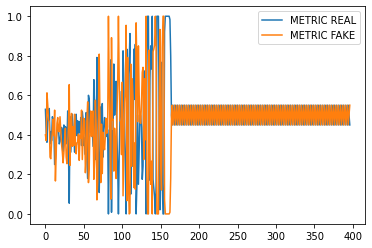

Step 8000: Generator loss: 0.6931470096111297, discriminator loss: 0.6934975337982178
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


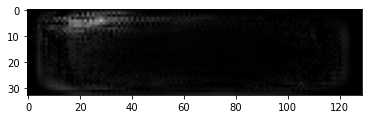

Espectrogramas Reales


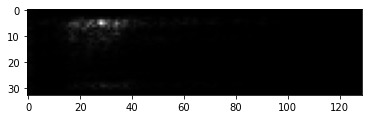

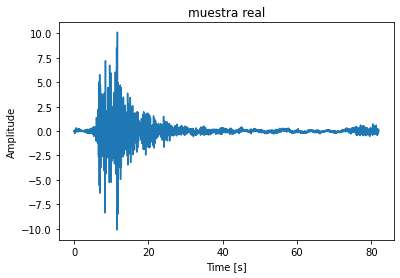

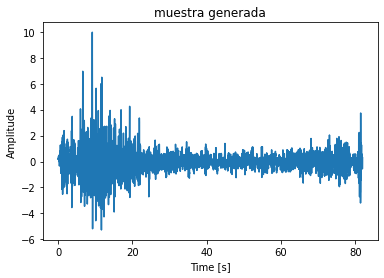

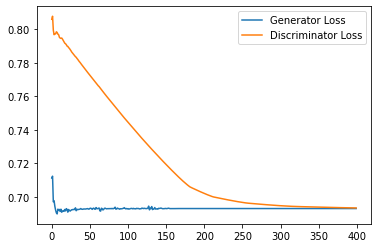

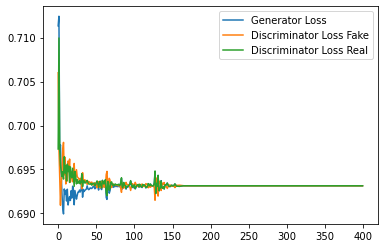

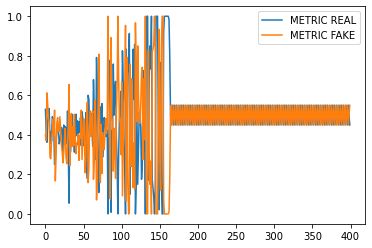

Step 8050: Generator loss: 0.6931472563743591, discriminator loss: 0.6934755623340607
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


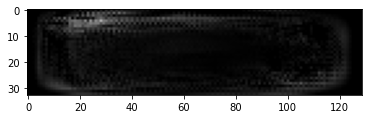

Espectrogramas Reales


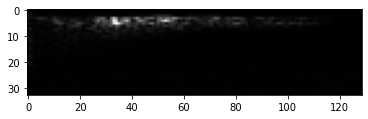

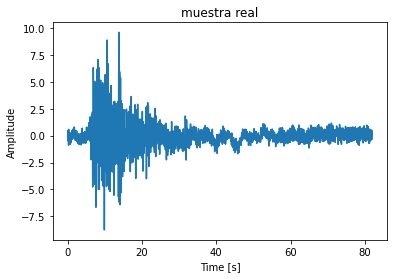

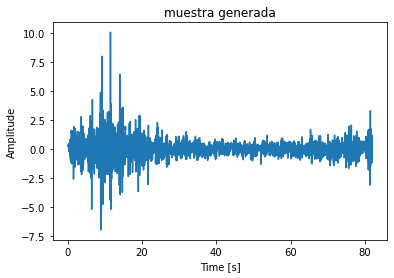

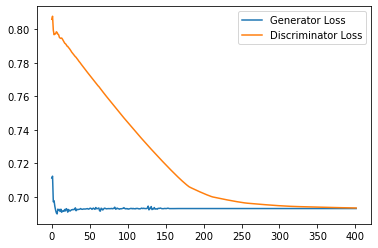

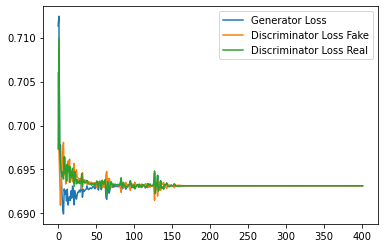

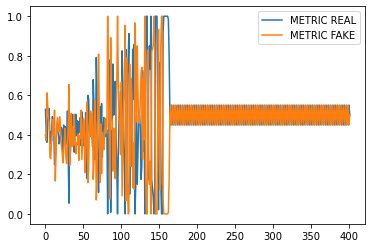

Step 8100: Generator loss: 0.6931474328041076, discriminator loss: 0.6934547817707062
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


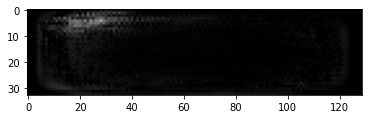

Espectrogramas Reales


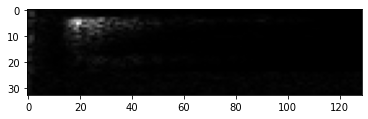

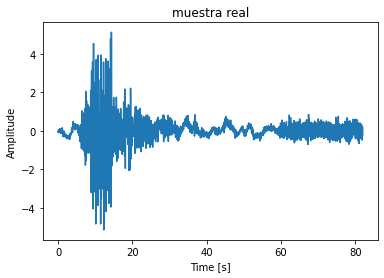

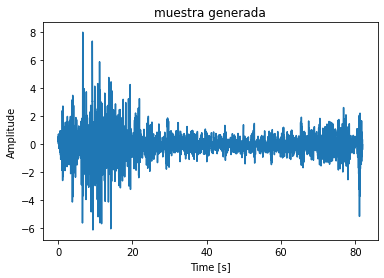

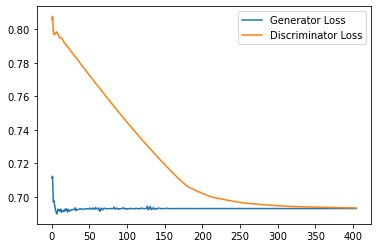

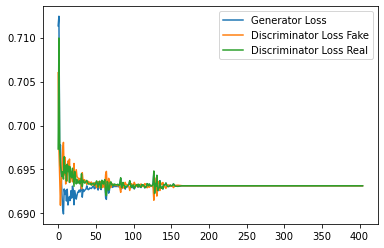

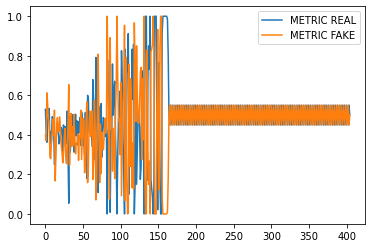

Step 8150: Generator loss: 0.6931470119953156, discriminator loss: 0.6934354484081269
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


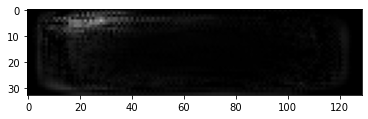

Espectrogramas Reales


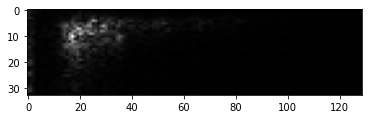

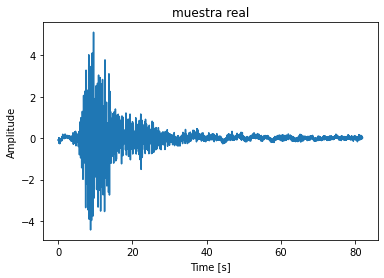

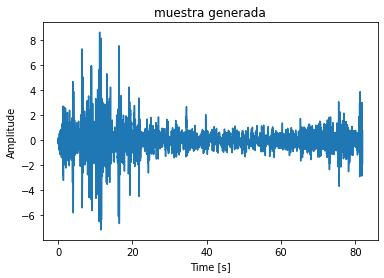

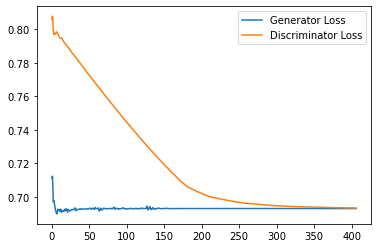

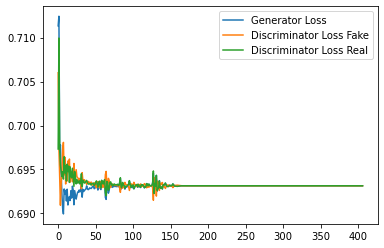

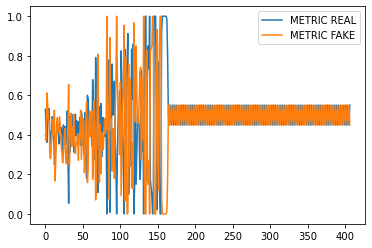

Step 8200: Generator loss: 0.693147246837616, discriminator loss: 0.6934199118614197
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


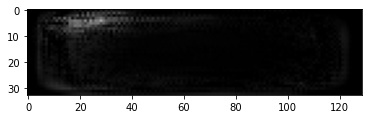

Espectrogramas Reales


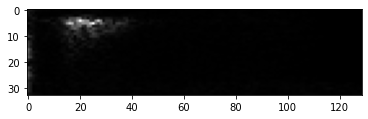

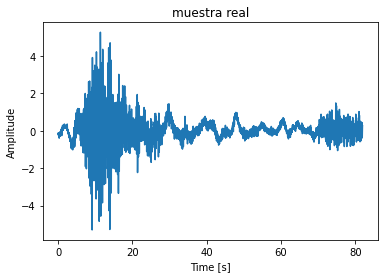

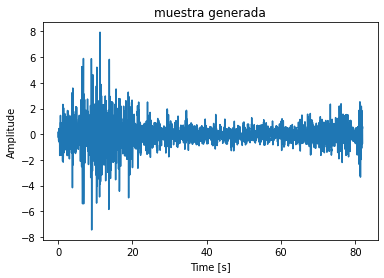

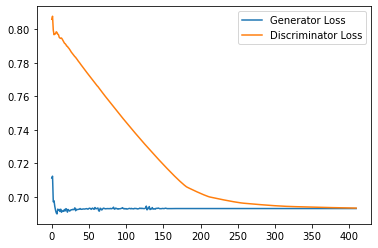

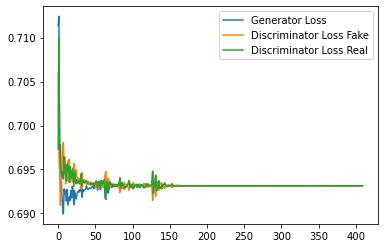

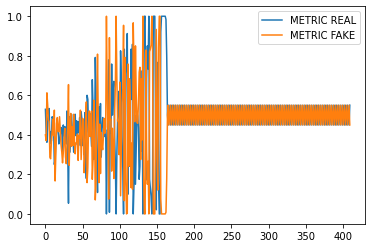

Epoch: 16


  0%|          | 0/513 [00:00<?, ?it/s]

Step 8250: Generator loss: 0.6931474232673644, discriminator loss: 0.693414568901062
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


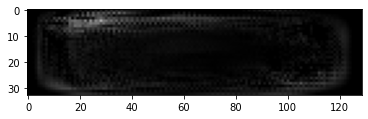

Espectrogramas Reales


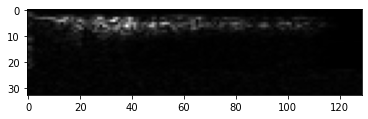

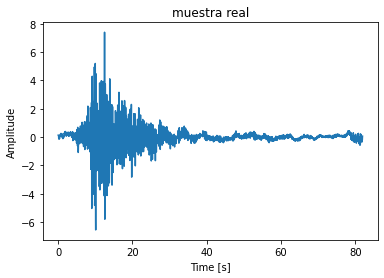

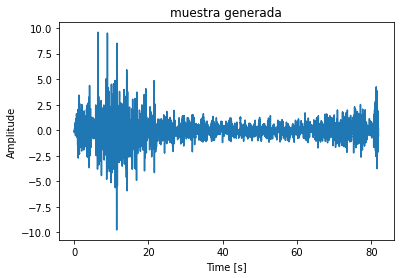

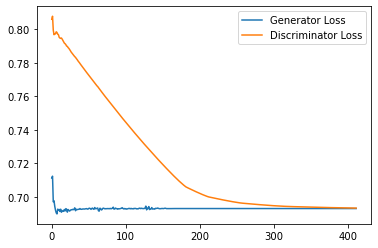

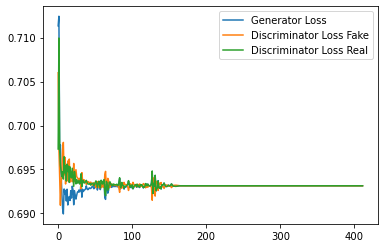

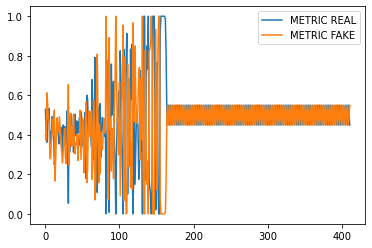

Step 8300: Generator loss: 0.693147006034851, discriminator loss: 0.693409309387207
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


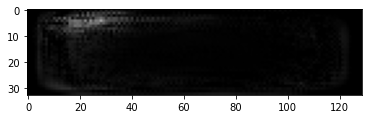

Espectrogramas Reales


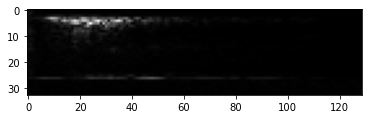

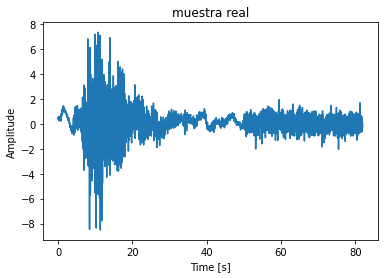

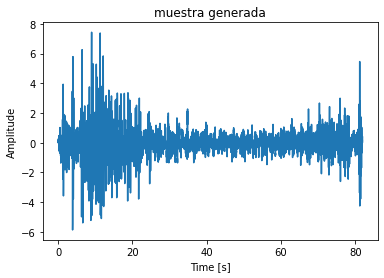

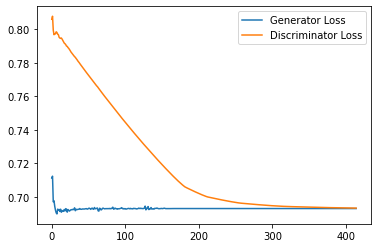

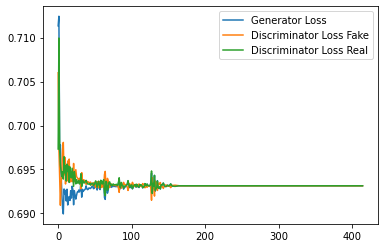

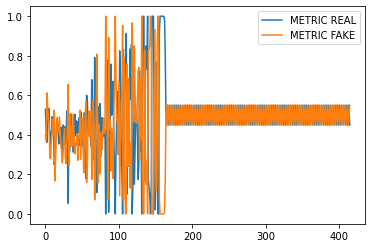

Step 8350: Generator loss: 0.6931472456455231, discriminator loss: 0.6934046113491058
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


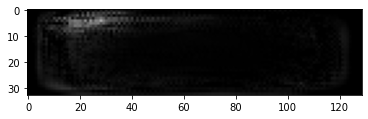

Espectrogramas Reales


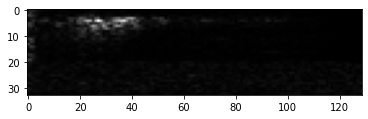

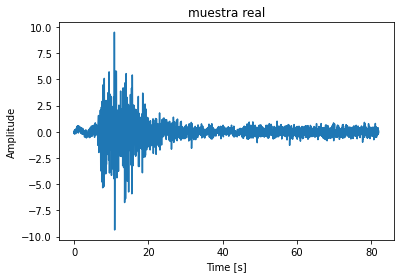

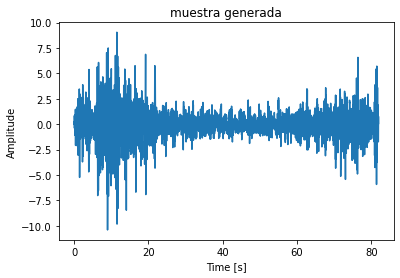

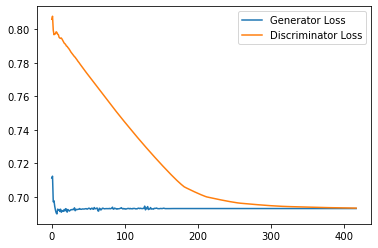

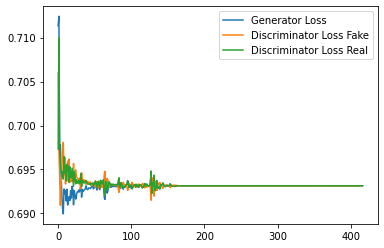

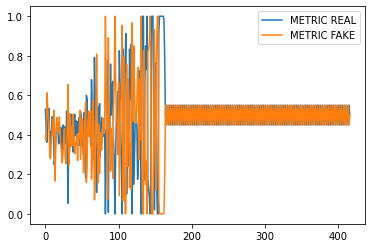

Step 8400: Generator loss: 0.6931474244594574, discriminator loss: 0.6933996999263763
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


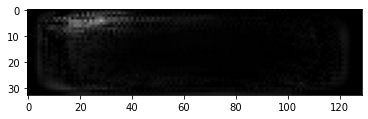

Espectrogramas Reales


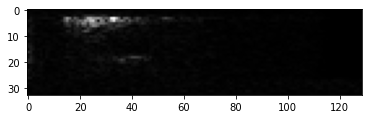

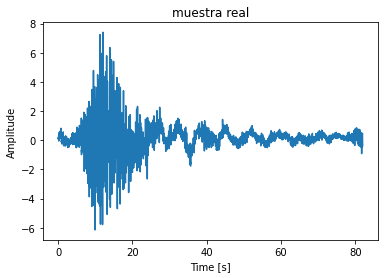

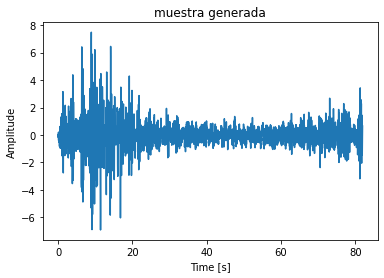

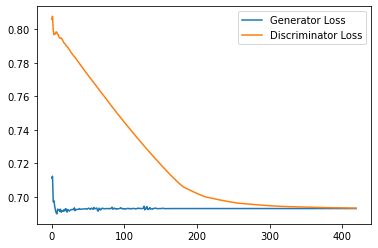

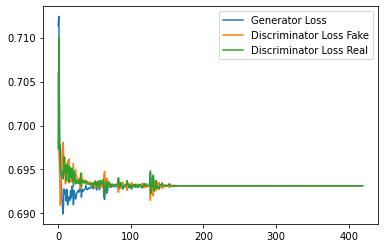

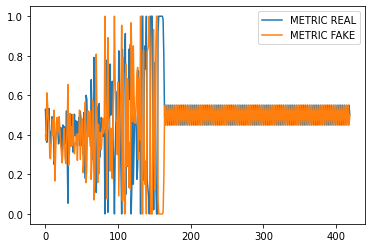

Step 8450: Generator loss: 0.6931470048427582, discriminator loss: 0.6933959972858429
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


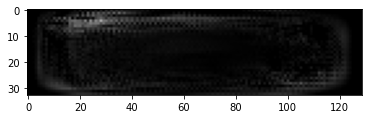

Espectrogramas Reales


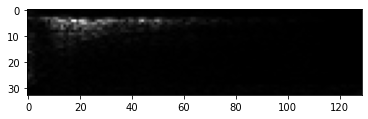

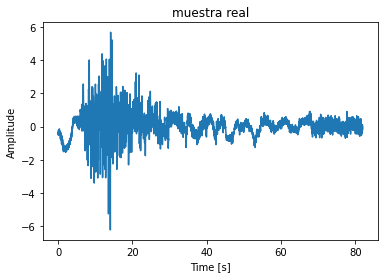

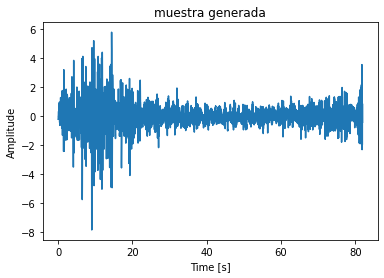

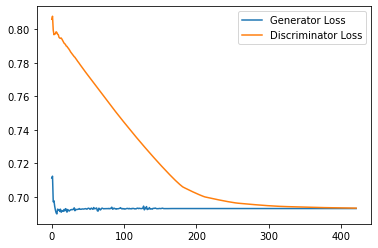

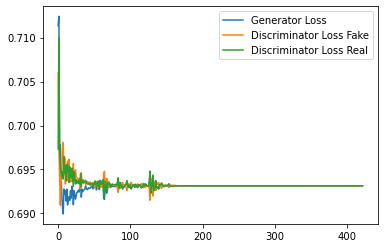

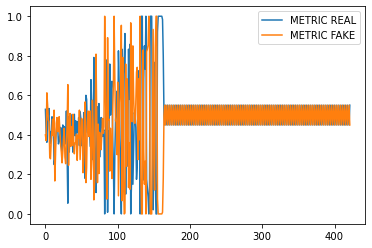

Step 8500: Generator loss: 0.6931472456455231, discriminator loss: 0.6933917319774627
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


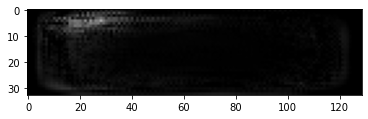

Espectrogramas Reales


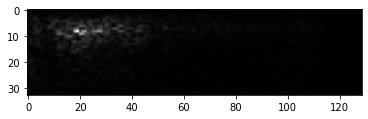

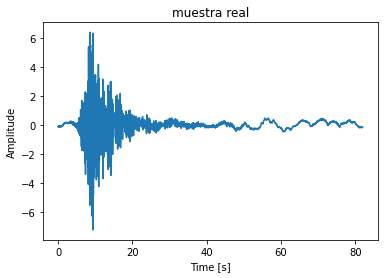

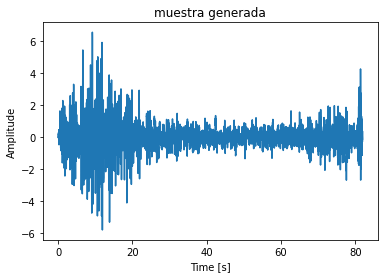

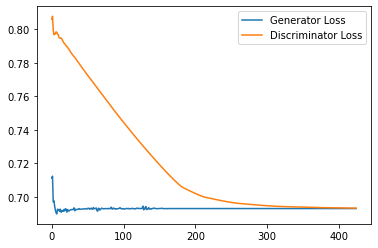

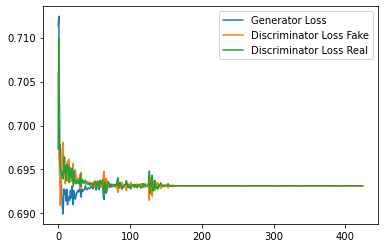

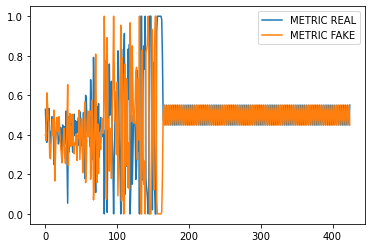

Step 8550: Generator loss: 0.6931474232673644, discriminator loss: 0.693387689590454
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


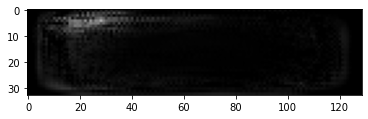

Espectrogramas Reales


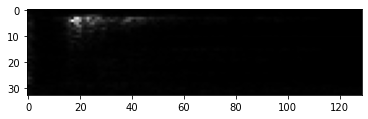

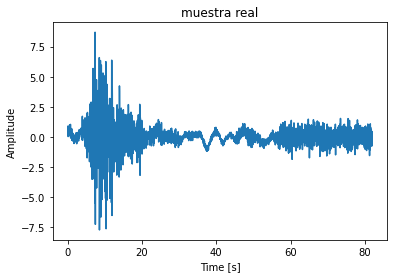

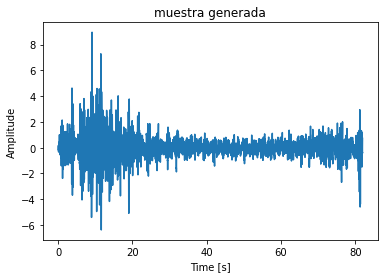

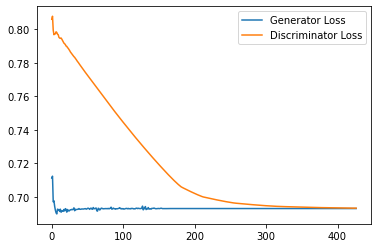

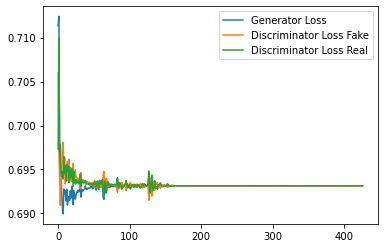

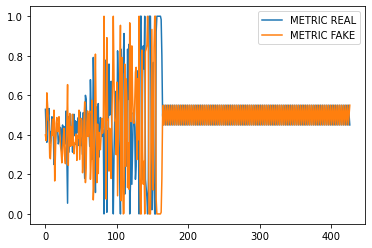

Step 8600: Generator loss: 0.693147006034851, discriminator loss: 0.6933836710453033
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


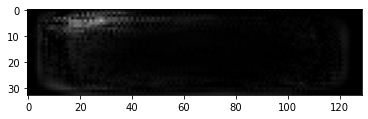

Espectrogramas Reales


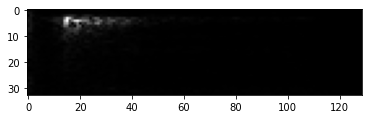

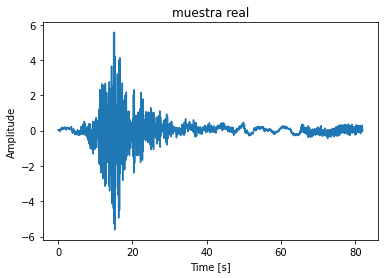

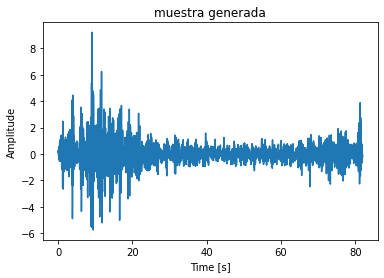

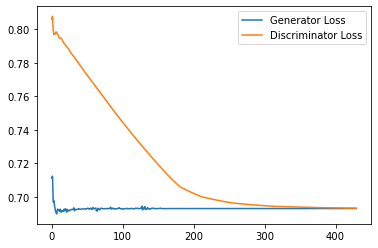

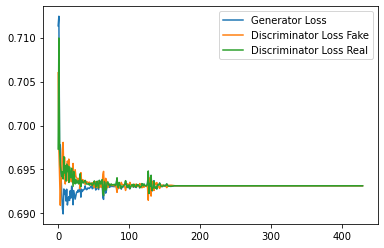

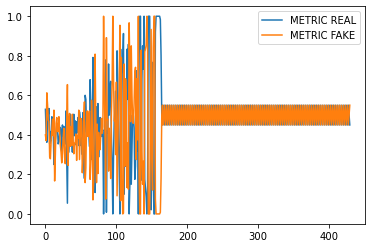

Step 8650: Generator loss: 0.6931472444534301, discriminator loss: 0.6933790457248687
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


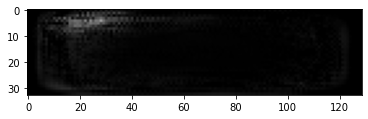

Espectrogramas Reales


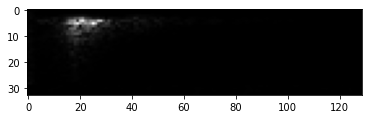

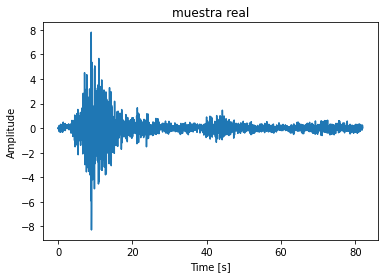

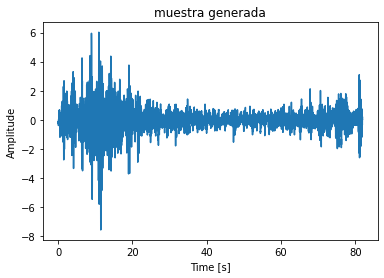

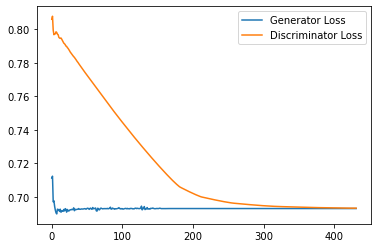

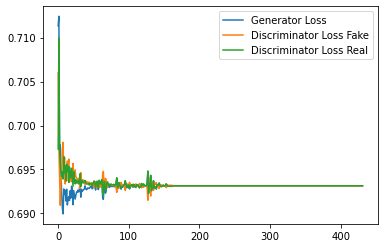

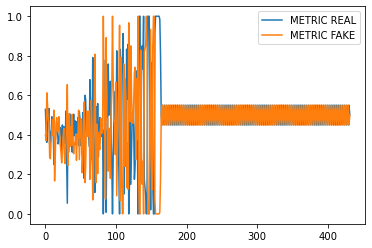

Step 8700: Generator loss: 0.6931474208831787, discriminator loss: 0.693375037908554
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


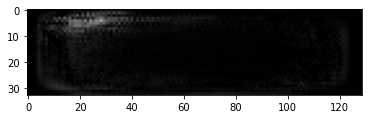

Espectrogramas Reales


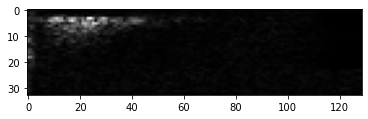

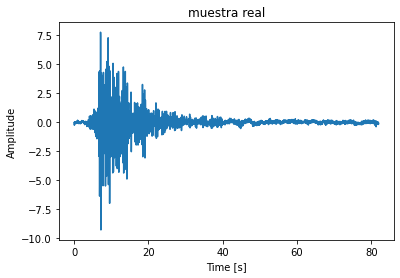

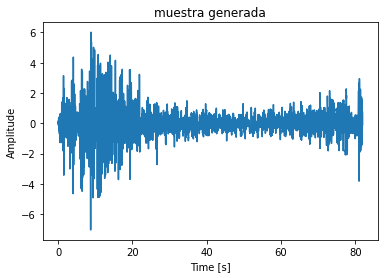

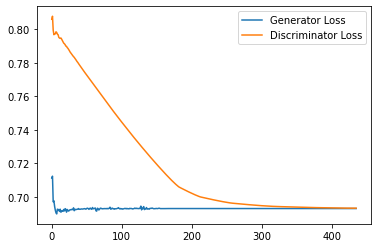

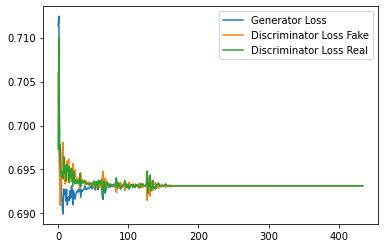

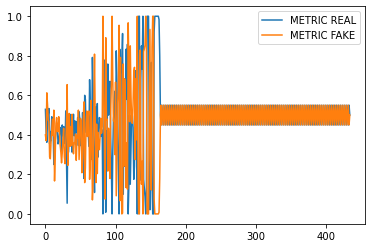

Epoch: 17


  0%|          | 0/513 [00:00<?, ?it/s]

Step 8750: Generator loss: 0.6931470024585724, discriminator loss: 0.6933721423149108
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


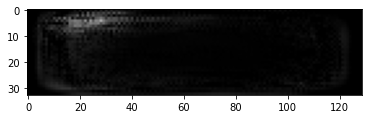

Espectrogramas Reales


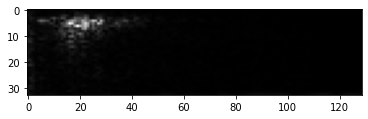

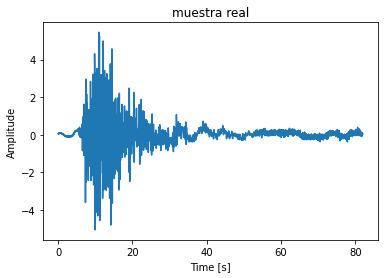

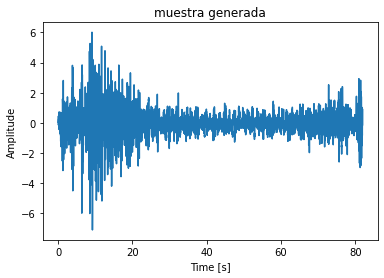

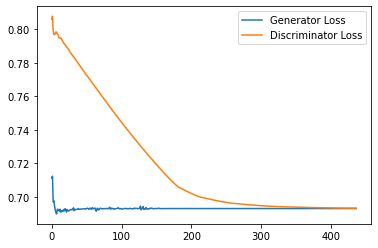

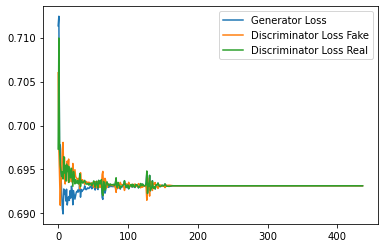

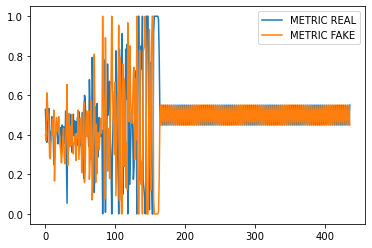

Step 8800: Generator loss: 0.6931472432613373, discriminator loss: 0.6933680665493012
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


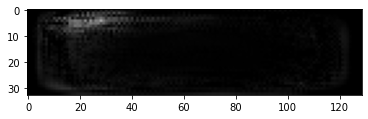

Espectrogramas Reales


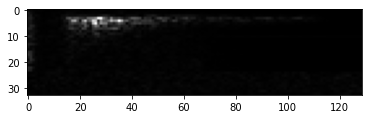

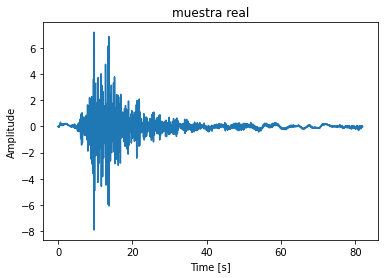

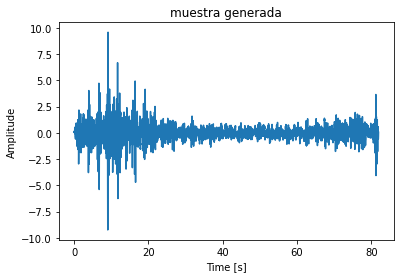

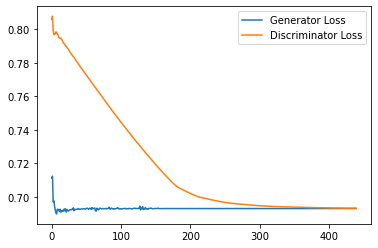

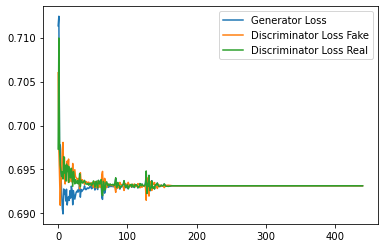

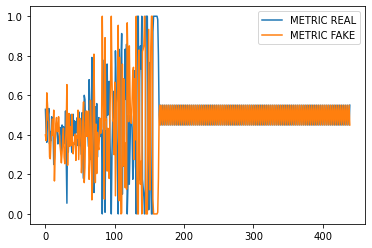

Step 8850: Generator loss: 0.6931474208831787, discriminator loss: 0.6933646130561829
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


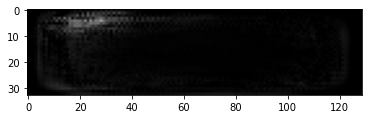

Espectrogramas Reales


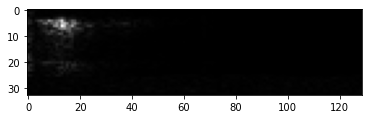

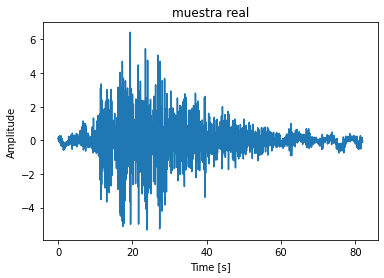

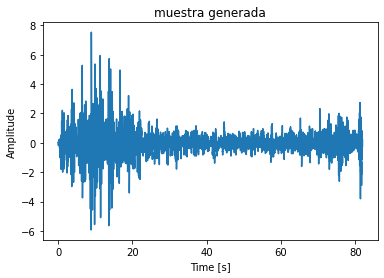

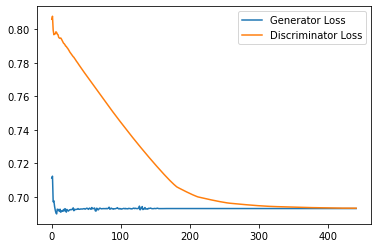

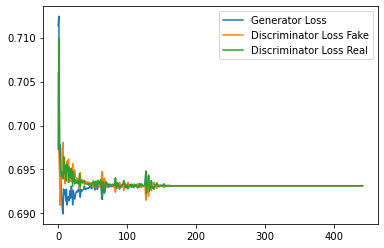

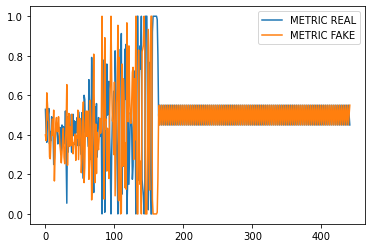

Step 8900: Generator loss: 0.6931470024585724, discriminator loss: 0.6933616840839386
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


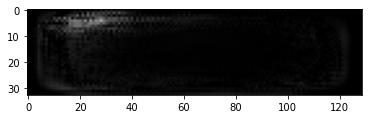

Espectrogramas Reales


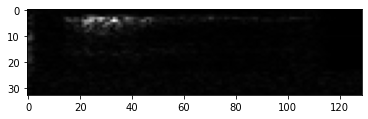

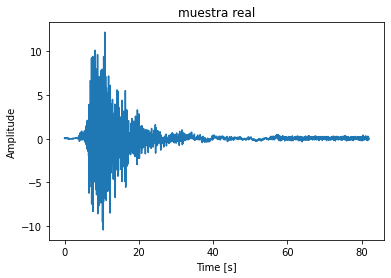

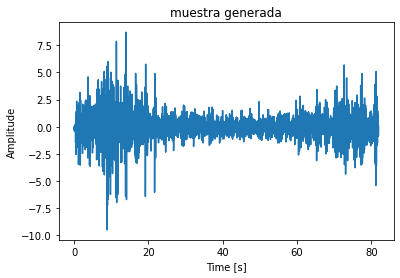

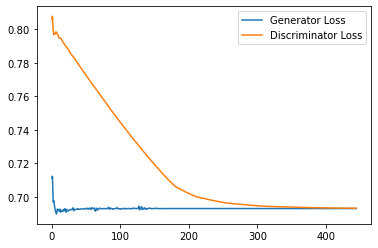

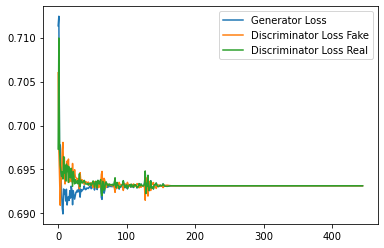

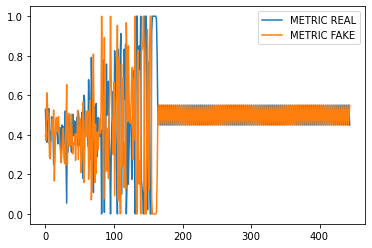

Step 8950: Generator loss: 0.6931472432613373, discriminator loss: 0.6933570182323456
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


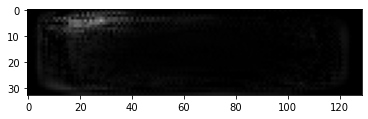

Espectrogramas Reales


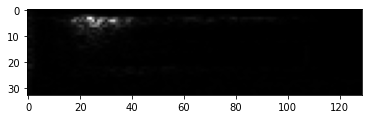

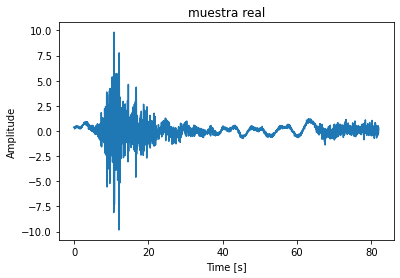

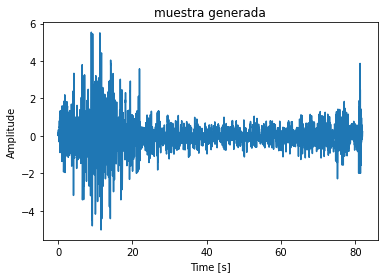

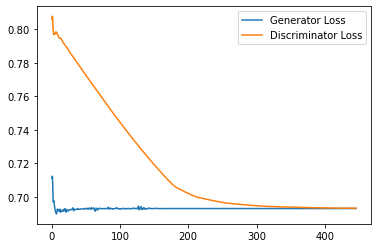

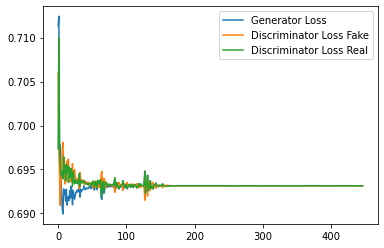

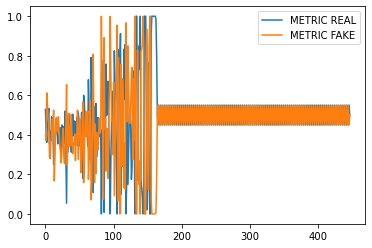

Step 9000: Generator loss: 0.6931474208831787, discriminator loss: 0.6933541548252106
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


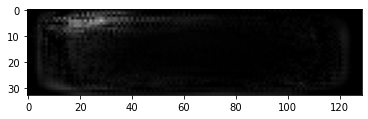

Espectrogramas Reales


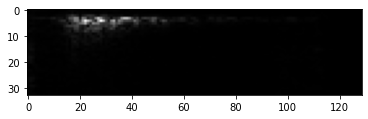

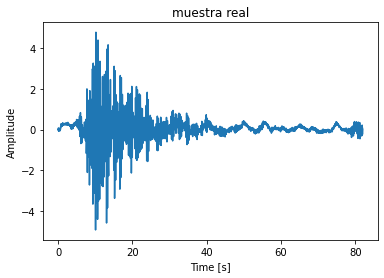

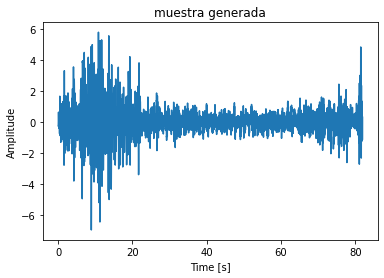

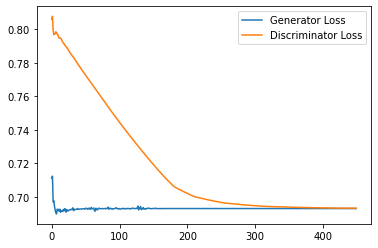

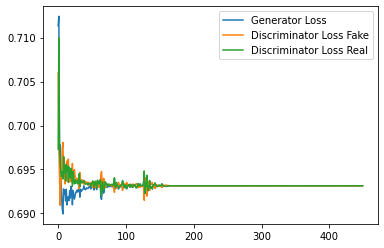

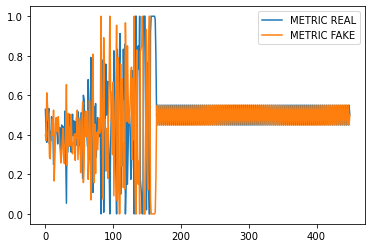

Step 9050: Generator loss: 0.6931470024585724, discriminator loss: 0.6933512210845947
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


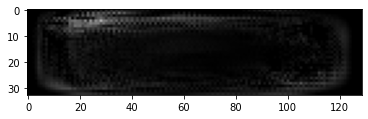

Espectrogramas Reales


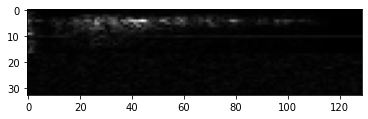

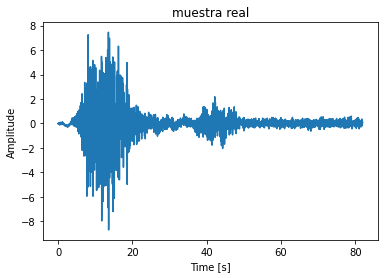

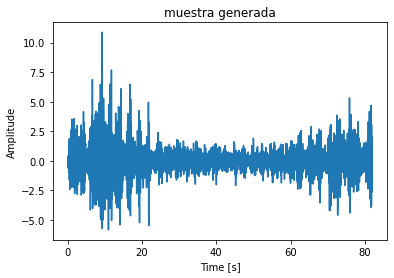

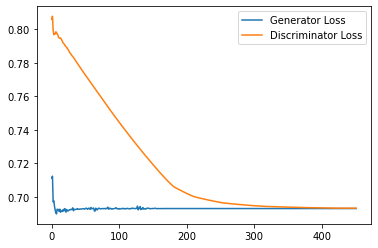

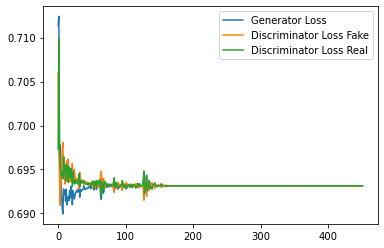

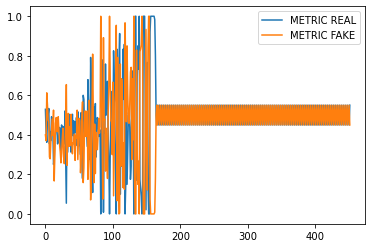

Step 9100: Generator loss: 0.6931472432613373, discriminator loss: 0.6933469641208648
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


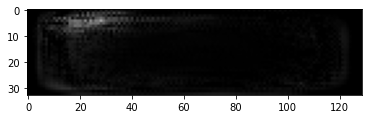

Espectrogramas Reales


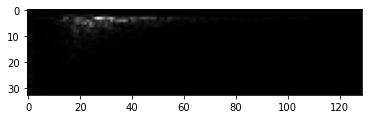

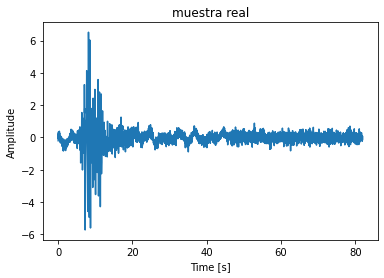

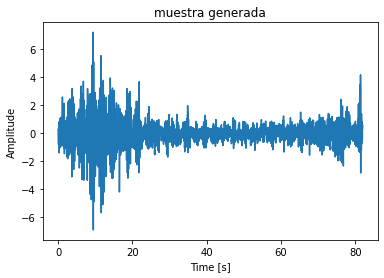

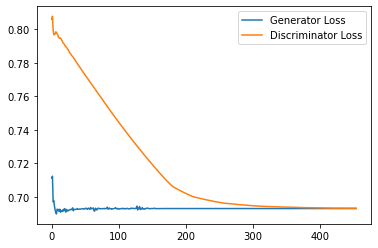

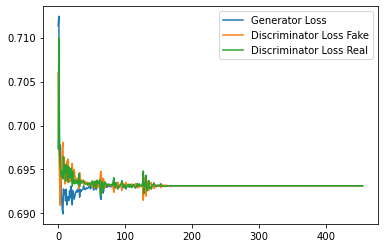

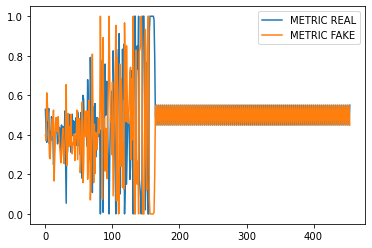

Step 9150: Generator loss: 0.6931474208831787, discriminator loss: 0.6933430528640747
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


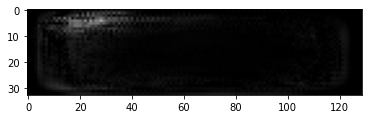

Espectrogramas Reales


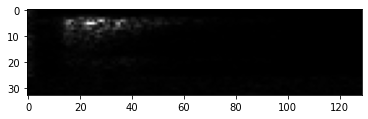

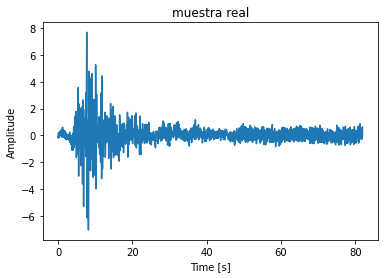

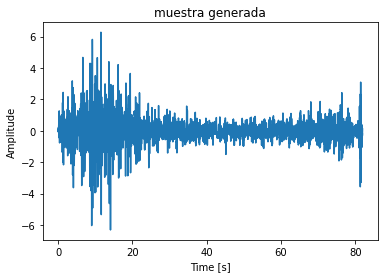

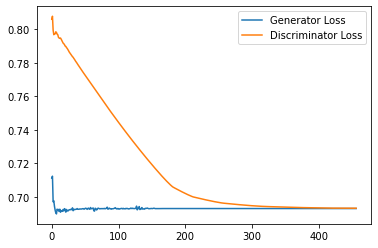

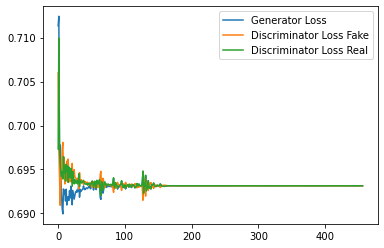

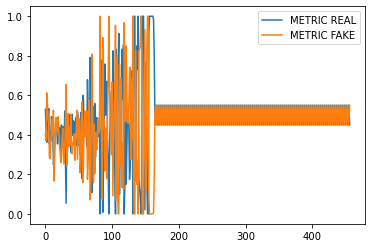

Step 9200: Generator loss: 0.6931470024585724, discriminator loss: 0.6933402371406555
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


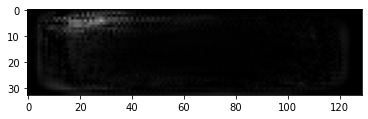

Espectrogramas Reales


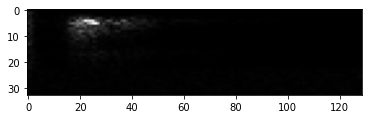

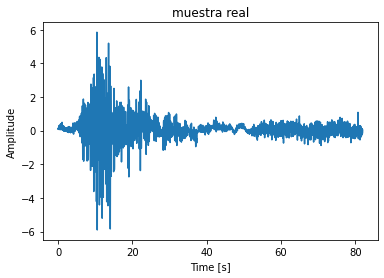

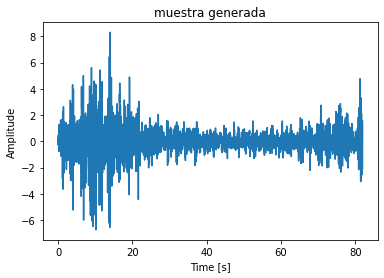

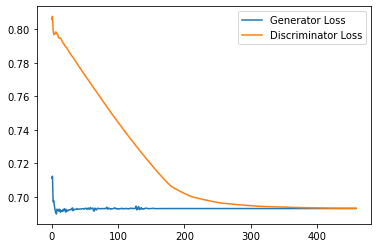

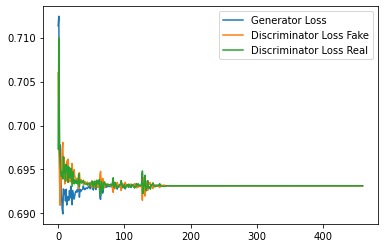

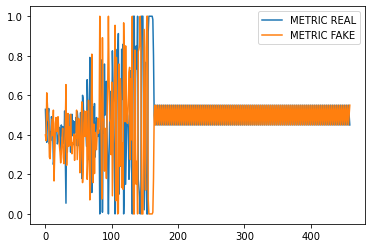

Epoch: 18


  0%|          | 0/513 [00:00<?, ?it/s]

Step 9250: Generator loss: 0.6931472432613373, discriminator loss: 0.6933372211456299
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


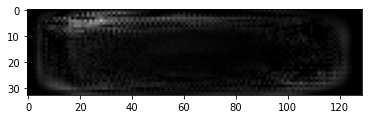

Espectrogramas Reales


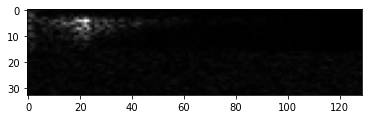

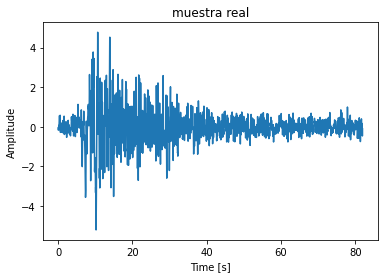

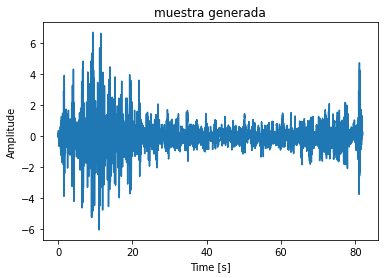

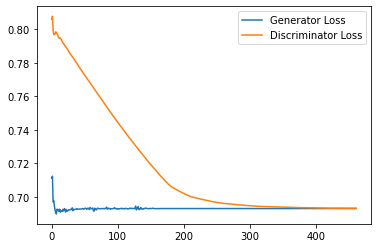

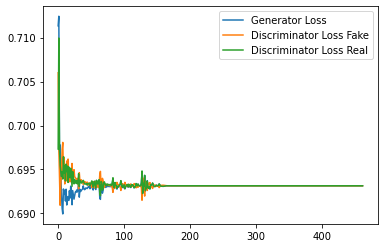

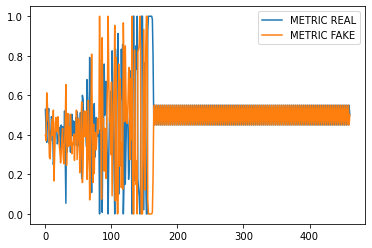

Step 9300: Generator loss: 0.6931474208831787, discriminator loss: 0.6933327603340149
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


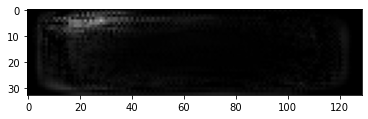

Espectrogramas Reales


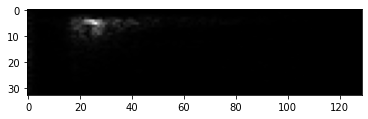

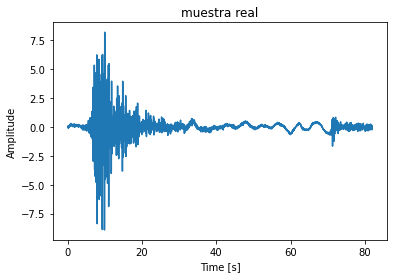

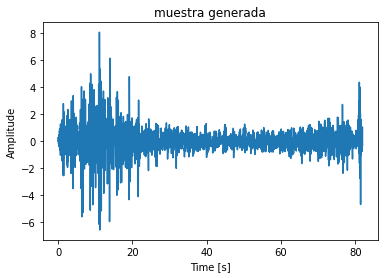

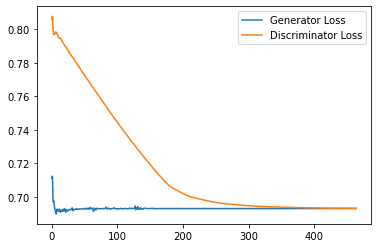

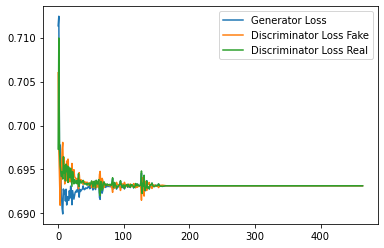

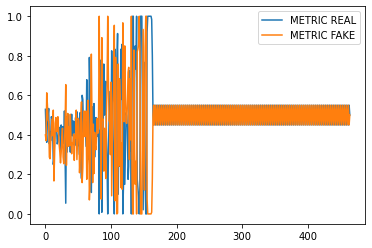

Step 9350: Generator loss: 0.6931470024585724, discriminator loss: 0.693329725265503
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


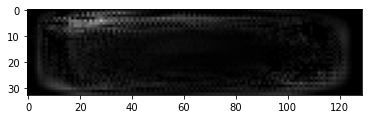

Espectrogramas Reales


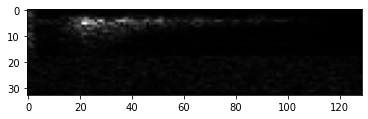

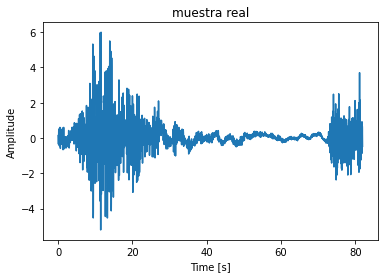

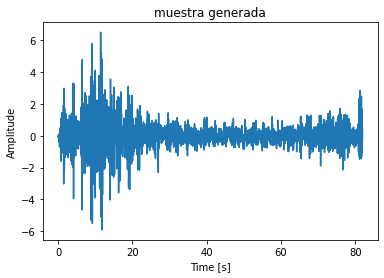

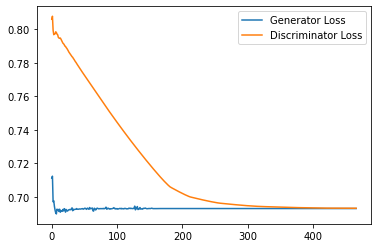

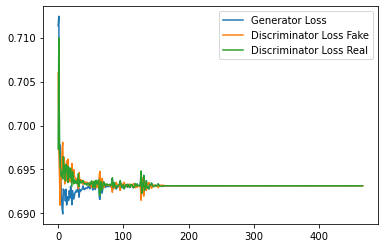

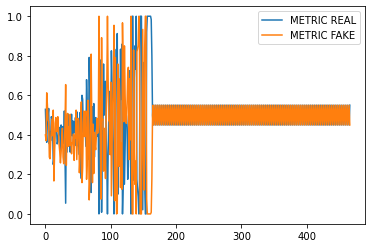

Step 9400: Generator loss: 0.6931472432613373, discriminator loss: 0.6933266401290894
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


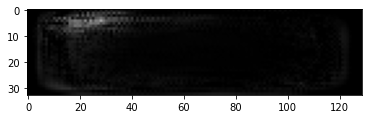

Espectrogramas Reales


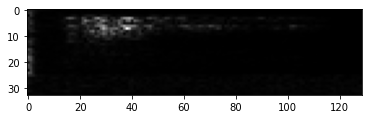

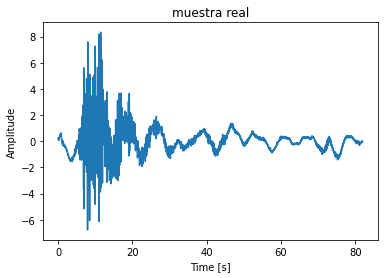

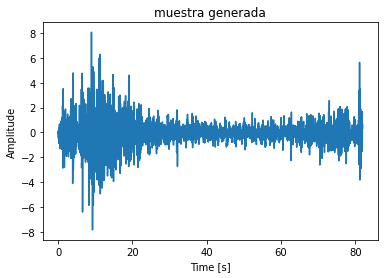

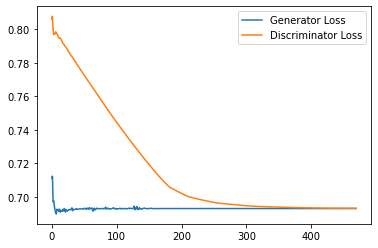

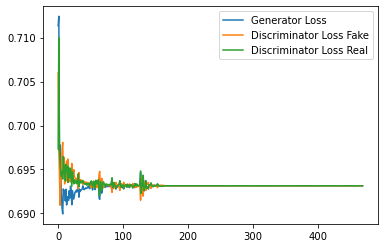

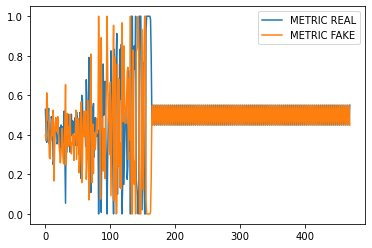

Step 9450: Generator loss: 0.6931474208831787, discriminator loss: 0.6933226871490479
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


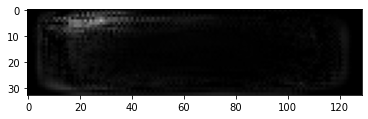

Espectrogramas Reales


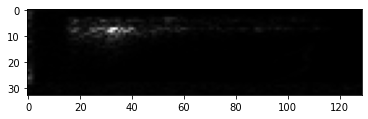

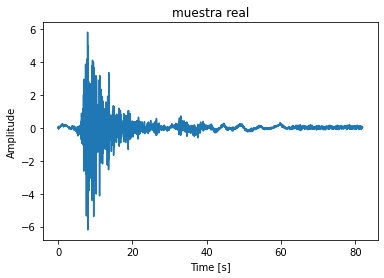

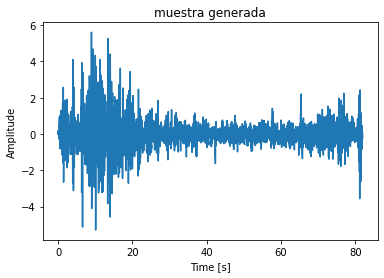

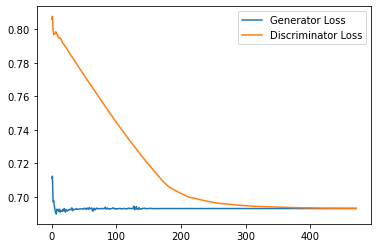

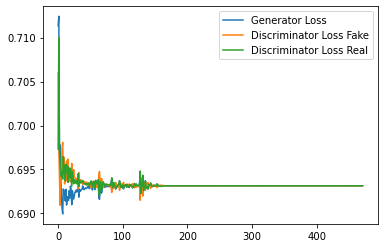

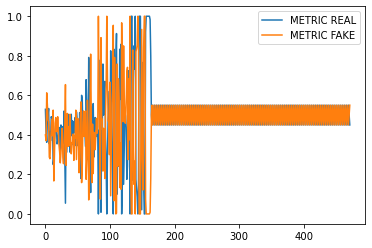

Step 9500: Generator loss: 0.6931470024585724, discriminator loss: 0.6933193504810333
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


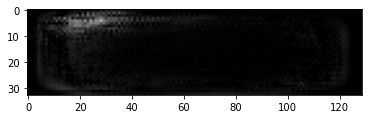

Espectrogramas Reales


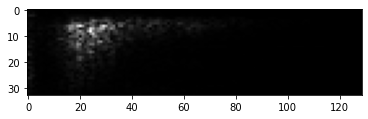

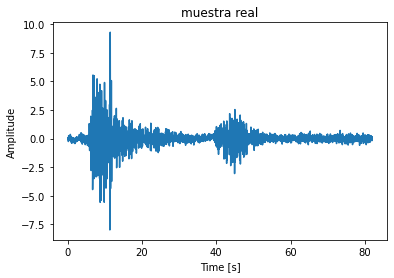

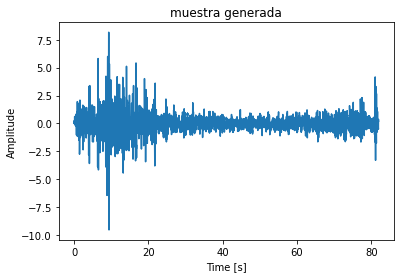

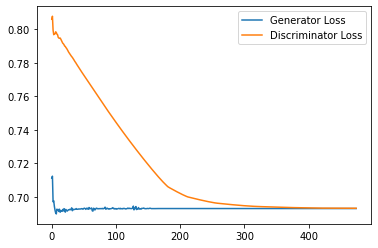

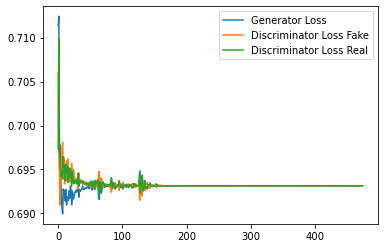

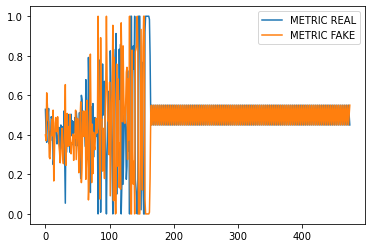

Step 9550: Generator loss: 0.6931472432613373, discriminator loss: 0.6933150386810303
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


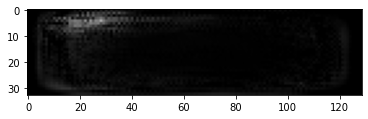

Espectrogramas Reales


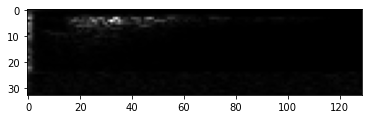

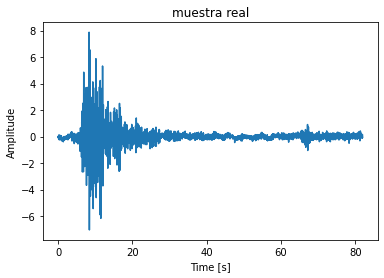

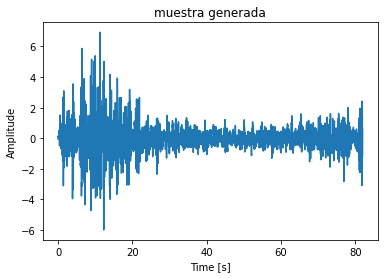

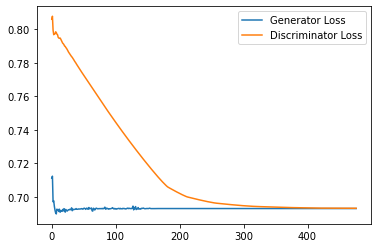

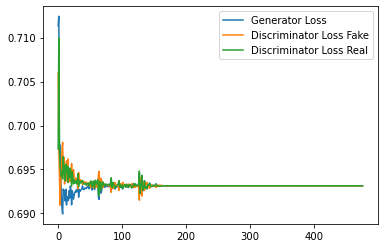

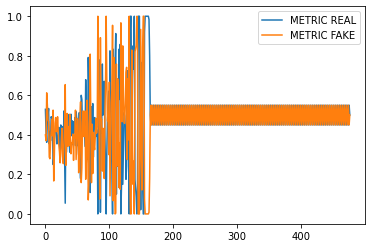

Step 9600: Generator loss: 0.6931474208831787, discriminator loss: 0.6933117163181305
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


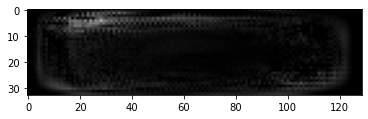

Espectrogramas Reales


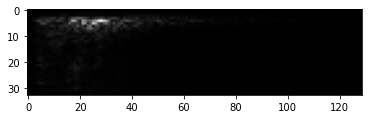

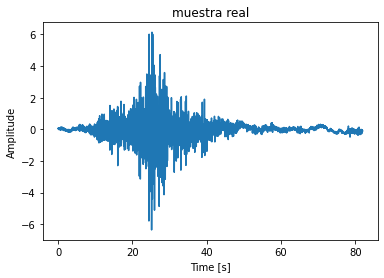

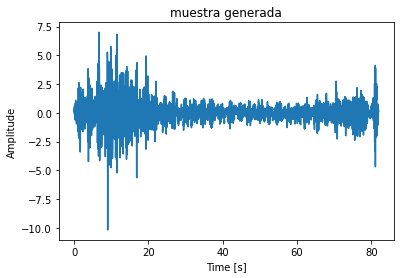

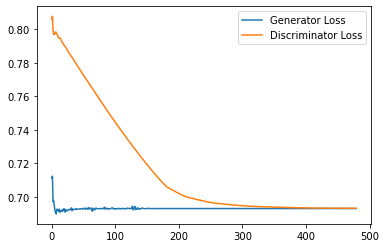

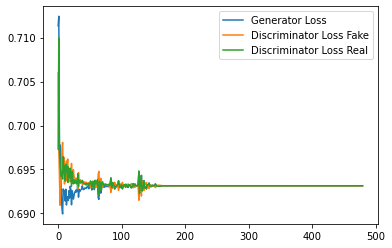

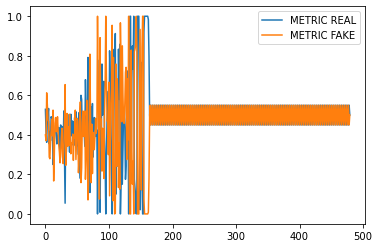

Step 9650: Generator loss: 0.6931470024585724, discriminator loss: 0.6933074295520782
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


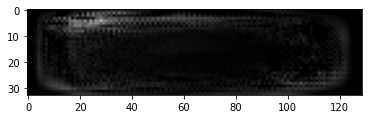

Espectrogramas Reales


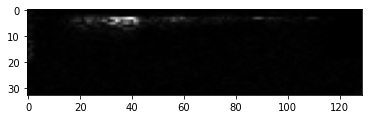

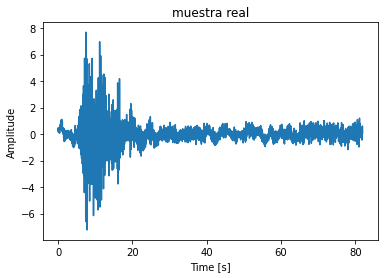

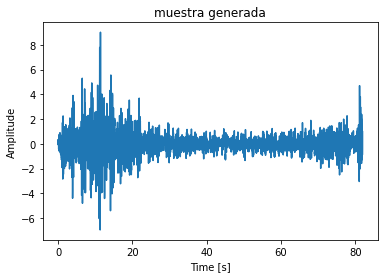

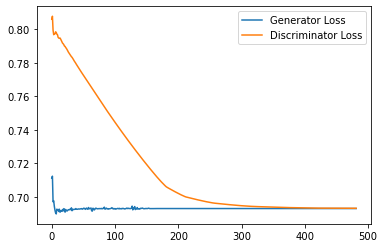

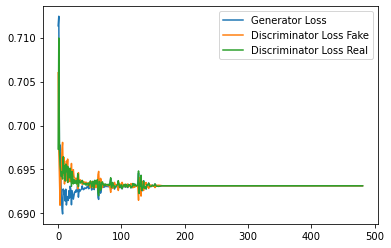

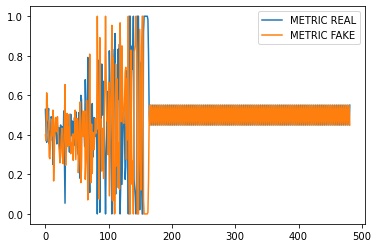

Step 9700: Generator loss: 0.6931472432613373, discriminator loss: 0.6933038353919982
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


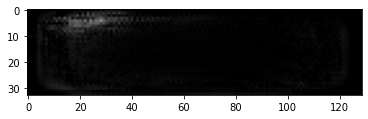

Espectrogramas Reales


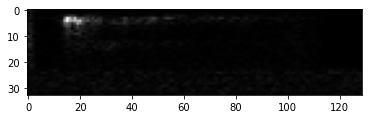

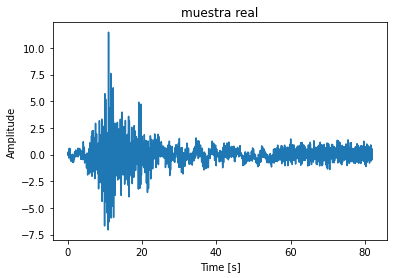

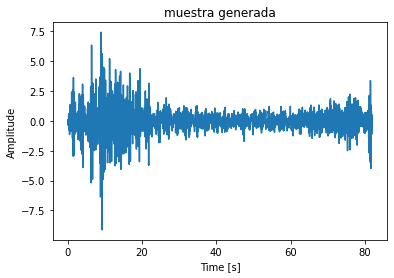

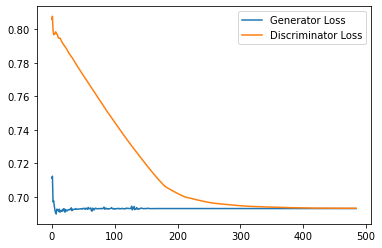

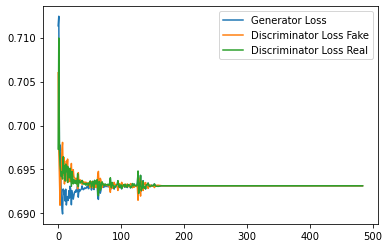

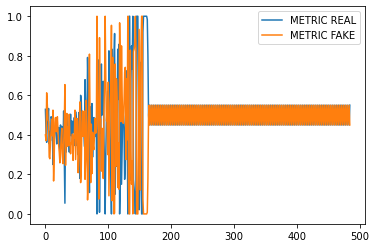

Epoch: 19


  0%|          | 0/513 [00:00<?, ?it/s]

Step 9750: Generator loss: 0.6931474208831787, discriminator loss: 0.6933012890815735
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


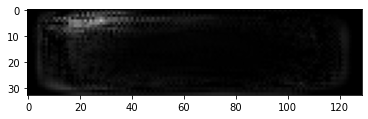

Espectrogramas Reales


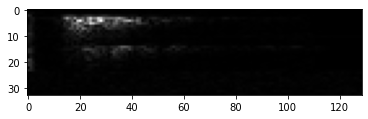

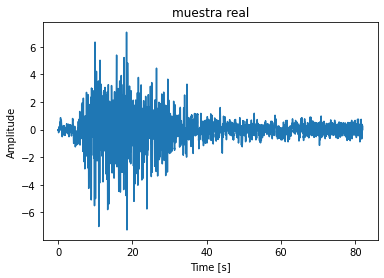

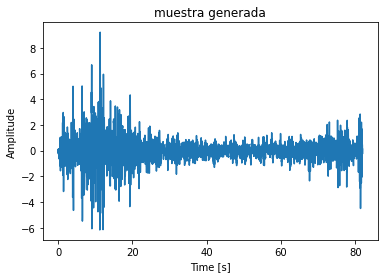

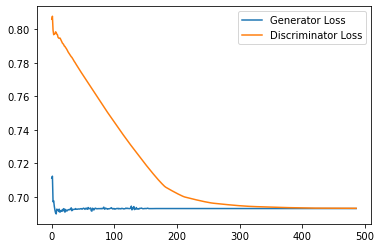

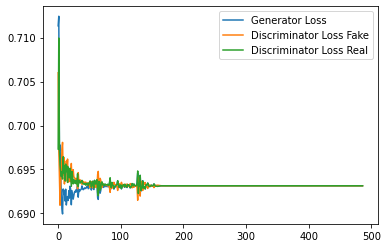

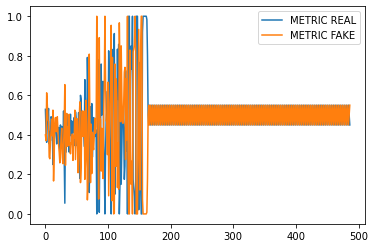

Step 9800: Generator loss: 0.6931470024585724, discriminator loss: 0.6932970225811005
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


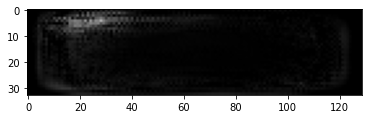

Espectrogramas Reales


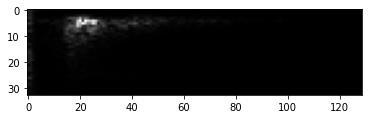

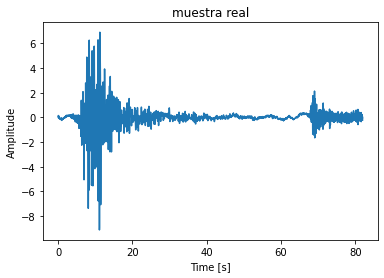

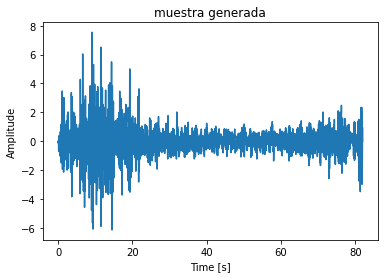

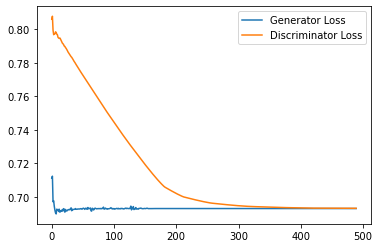

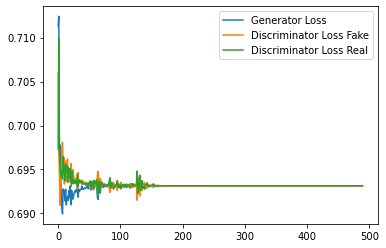

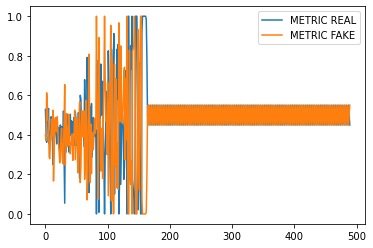

Step 9850: Generator loss: 0.6931472432613373, discriminator loss: 0.6932936716079712
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


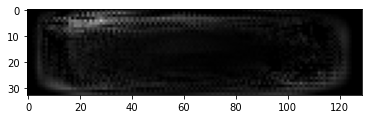

Espectrogramas Reales


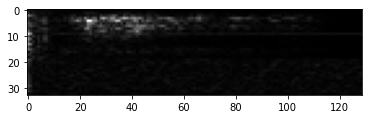

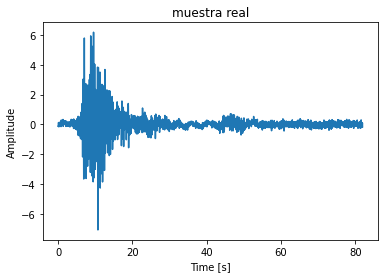

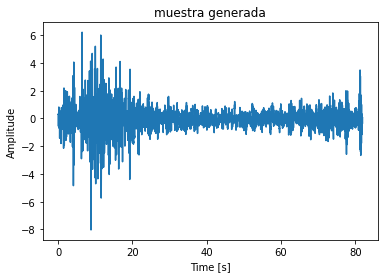

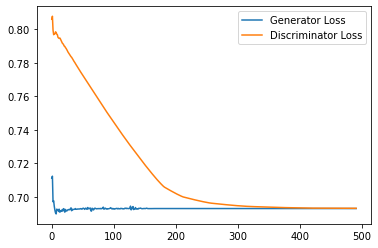

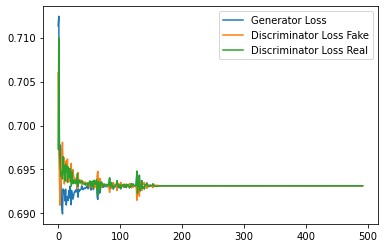

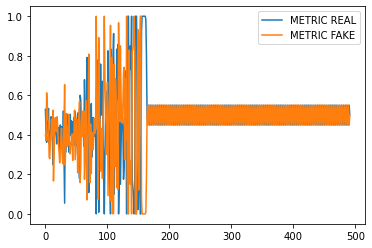

Step 9900: Generator loss: 0.6931474208831787, discriminator loss: 0.6932887244224548
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


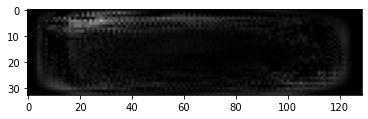

Espectrogramas Reales


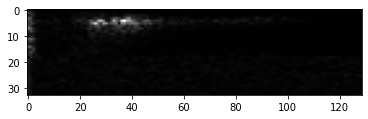

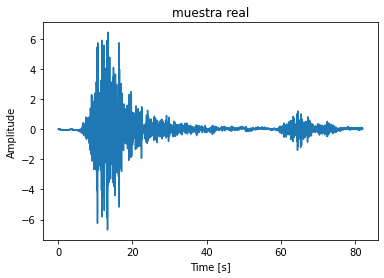

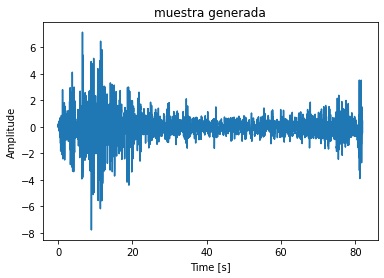

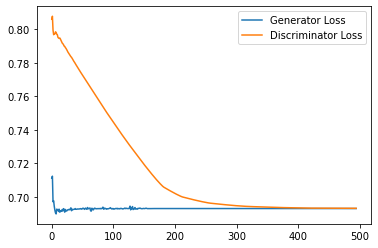

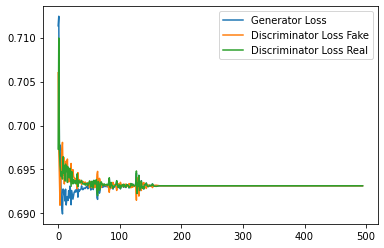

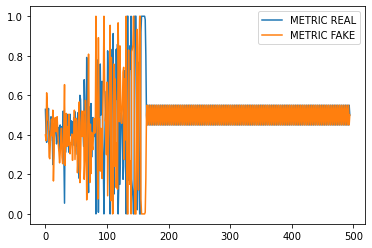

Step 9950: Generator loss: 0.6931470024585724, discriminator loss: 0.6932851767539978
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


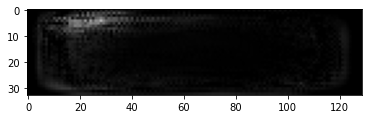

Espectrogramas Reales


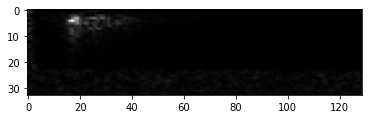

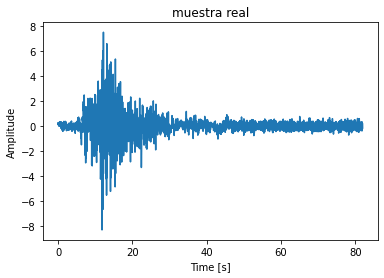

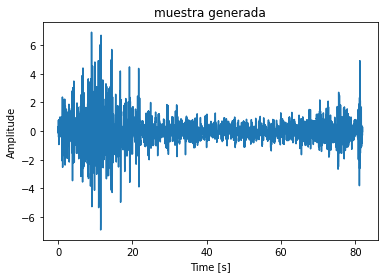

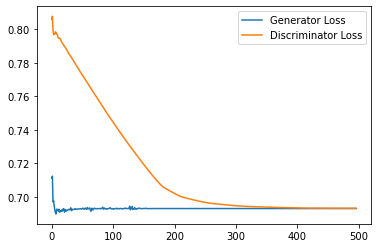

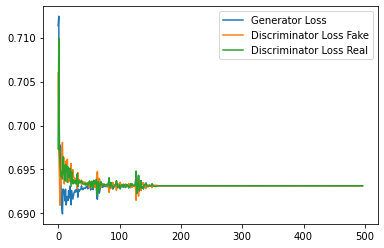

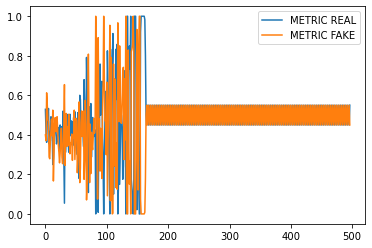

Step 10000: Generator loss: 0.6931472432613373, discriminator loss: 0.693280668258667
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


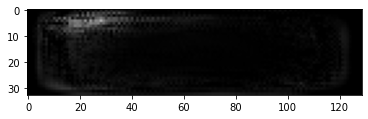

Espectrogramas Reales


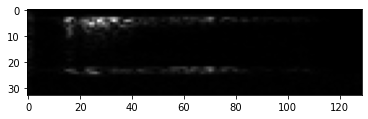

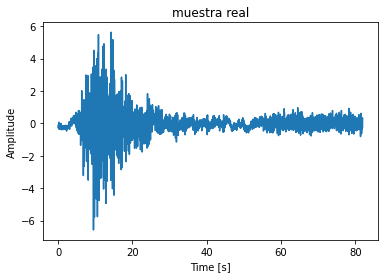

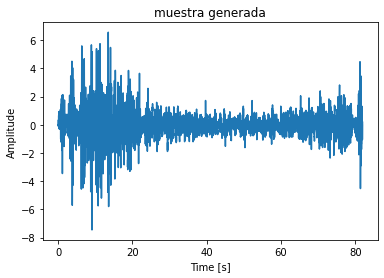

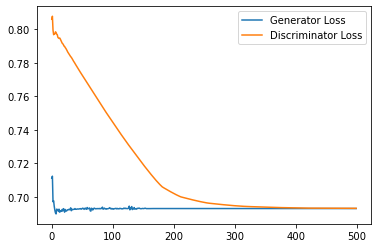

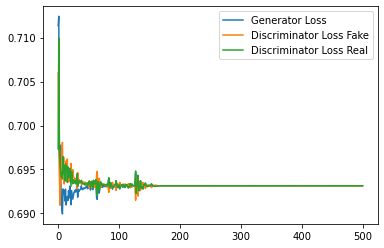

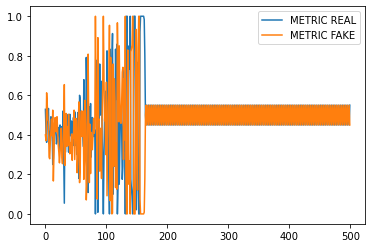

Step 10050: Generator loss: 0.6931474208831787, discriminator loss: 0.6932768750190735
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


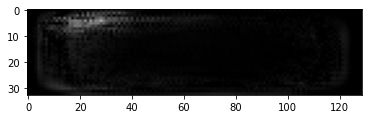

Espectrogramas Reales


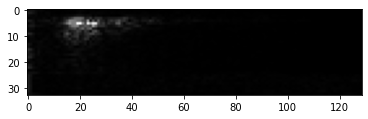

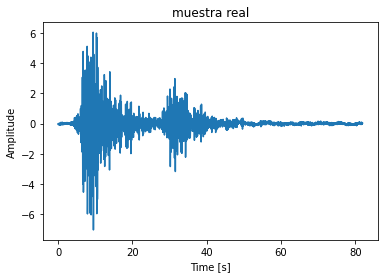

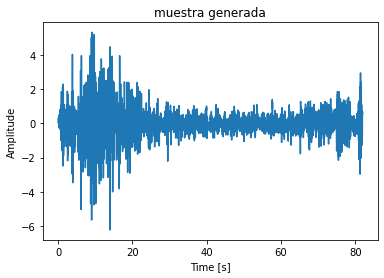

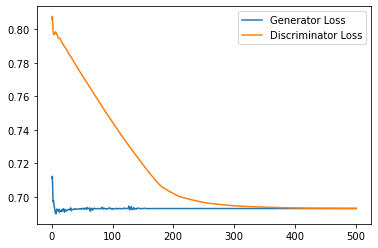

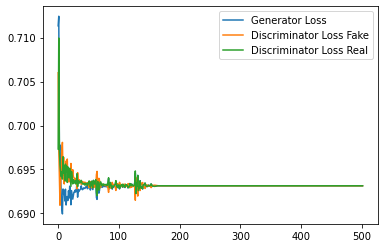

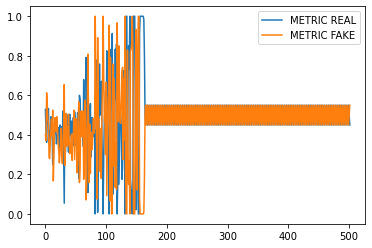

Step 10100: Generator loss: 0.6931470024585724, discriminator loss: 0.6932733523845672
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


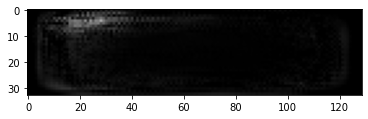

Espectrogramas Reales


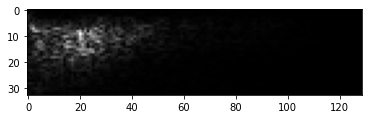

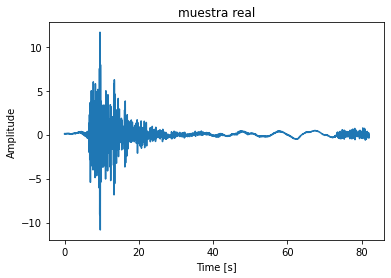

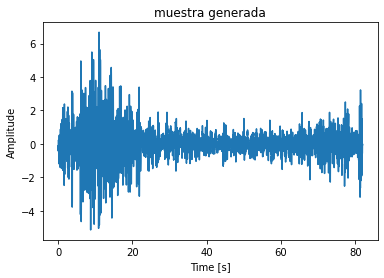

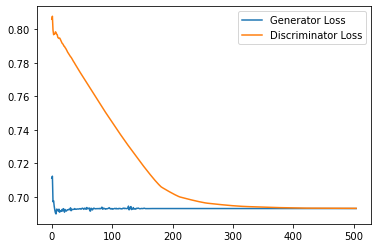

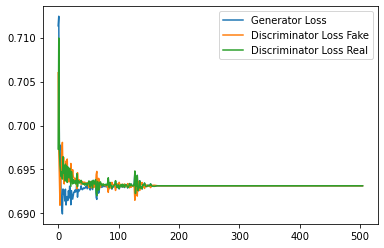

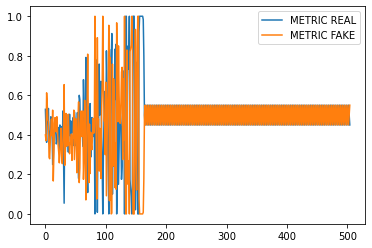

Step 10150: Generator loss: 0.6931472432613373, discriminator loss: 0.6932682931423187
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


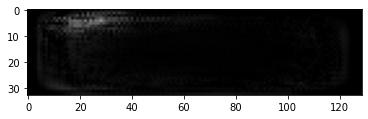

Espectrogramas Reales


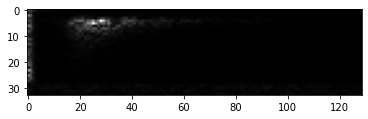

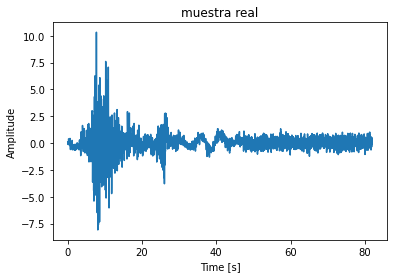

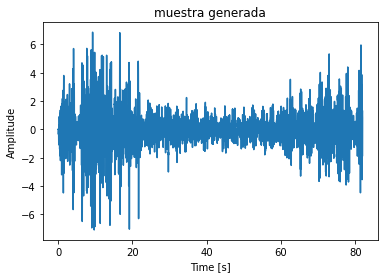

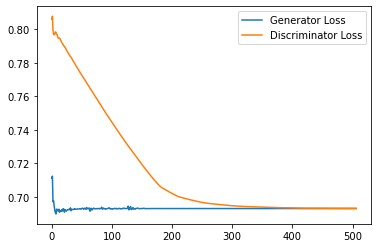

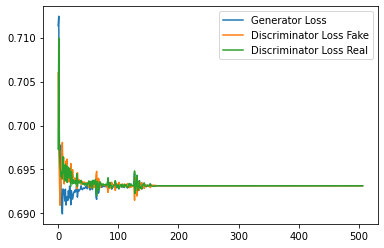

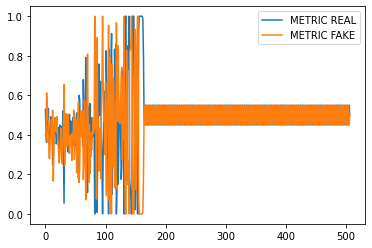

Step 10200: Generator loss: 0.6931474208831787, discriminator loss: 0.6932638251781463
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


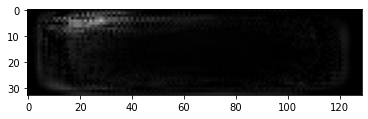

Espectrogramas Reales


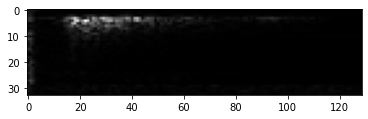

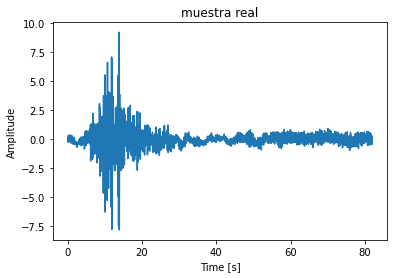

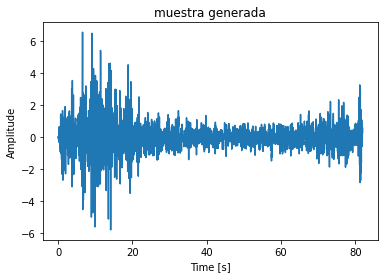

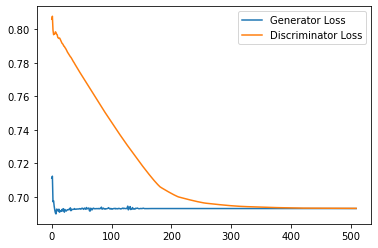

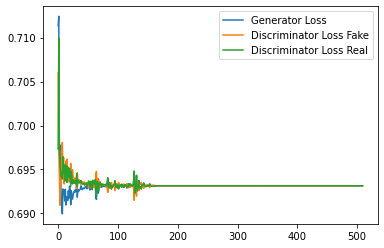

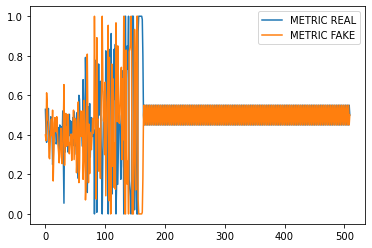

Step 10250: Generator loss: 0.6931470024585724, discriminator loss: 0.6932605719566345
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


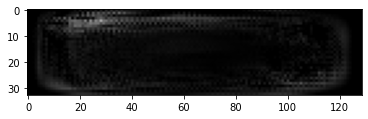

Espectrogramas Reales


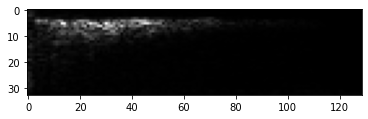

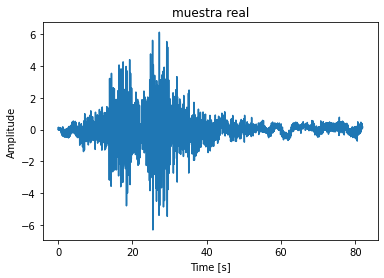

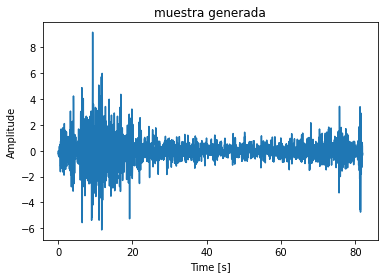

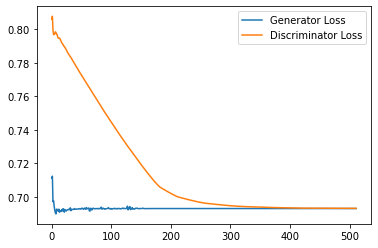

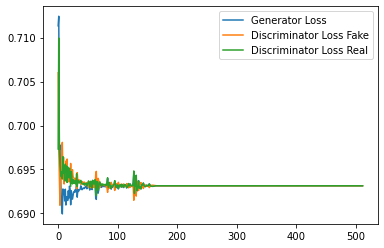

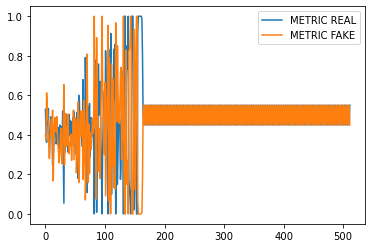

Epoch: 20


  0%|          | 0/513 [00:00<?, ?it/s]

Step 10300: Generator loss: 0.6931472432613373, discriminator loss: 0.6932557380199432
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


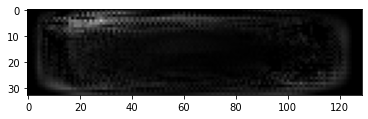

Espectrogramas Reales


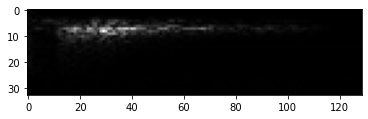

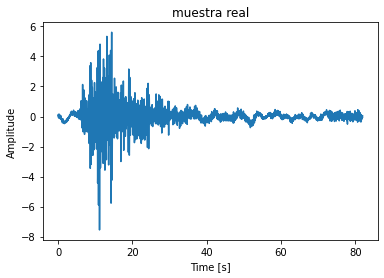

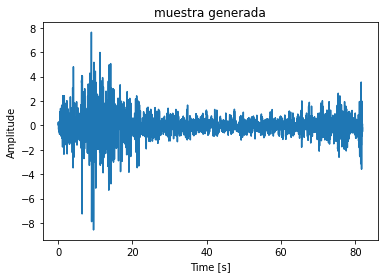

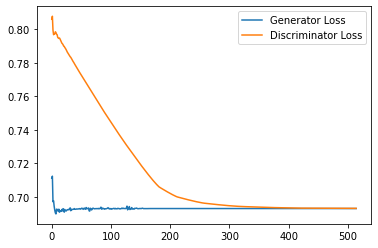

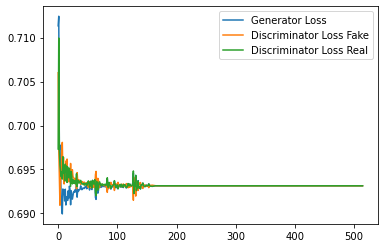

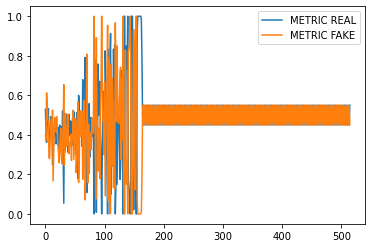

Step 10350: Generator loss: 0.6931474208831787, discriminator loss: 0.6932511699199676
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


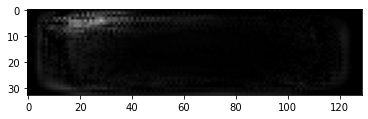

Espectrogramas Reales


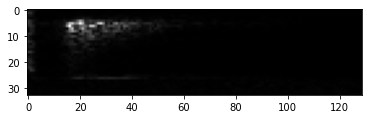

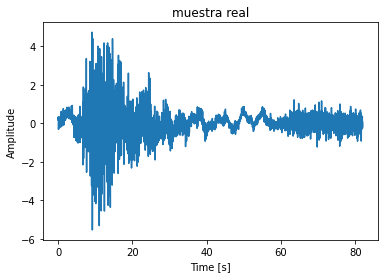

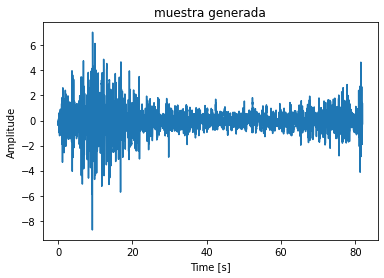

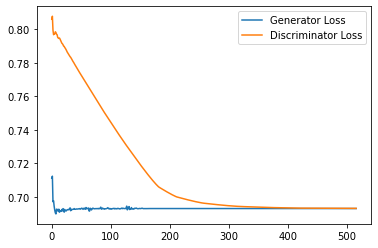

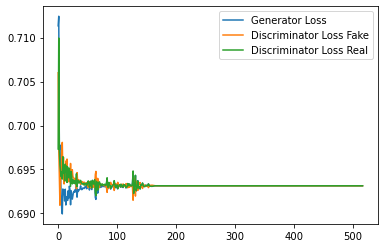

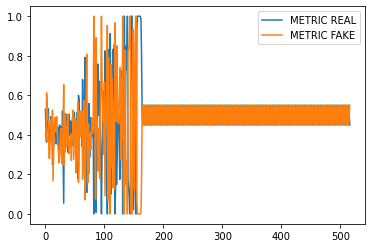

Step 10400: Generator loss: 0.6931470024585724, discriminator loss: 0.693245986700058
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


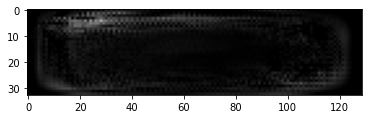

Espectrogramas Reales


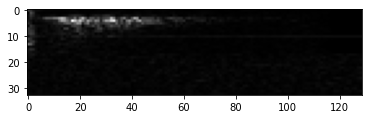

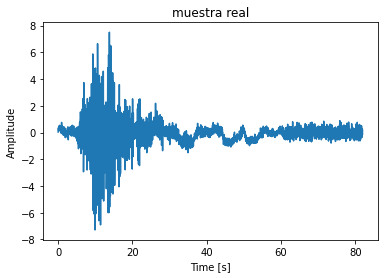

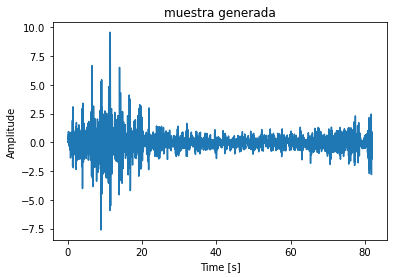

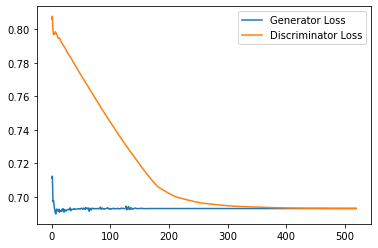

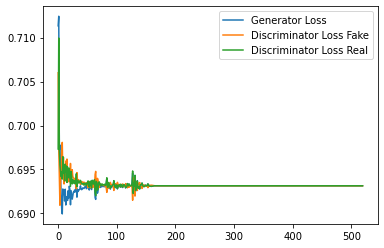

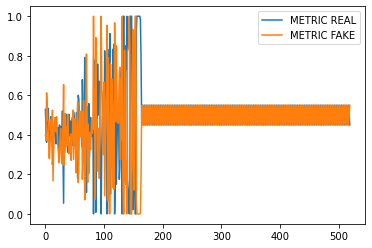

Step 10450: Generator loss: 0.6931472432613373, discriminator loss: 0.6932414329051971
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


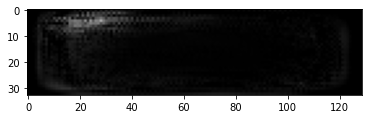

Espectrogramas Reales


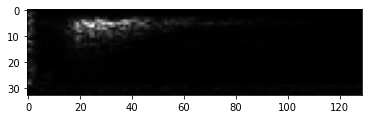

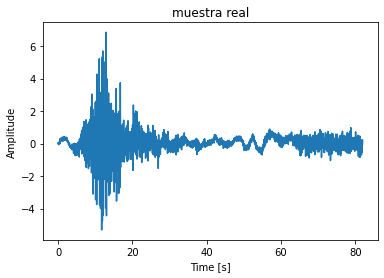

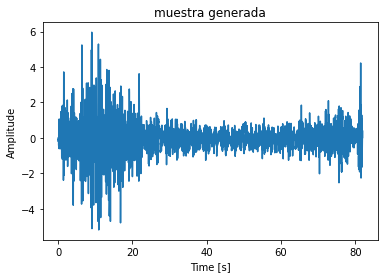

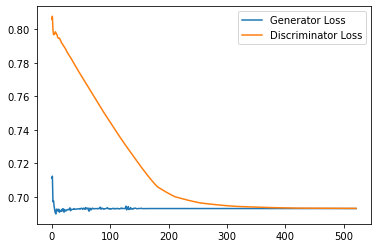

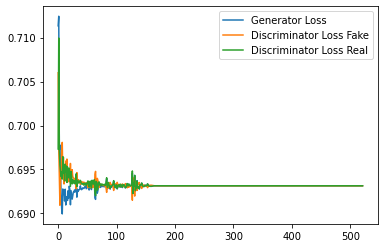

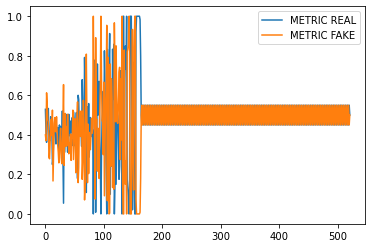

Step 10500: Generator loss: 0.6931474208831787, discriminator loss: 0.6932373571395875
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


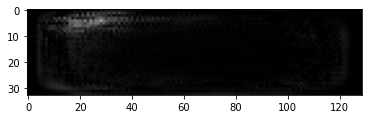

Espectrogramas Reales


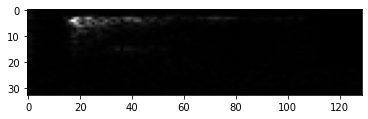

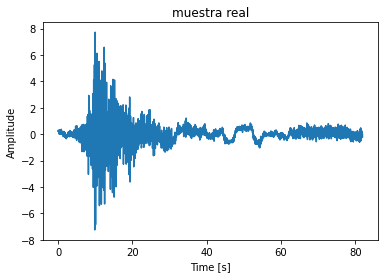

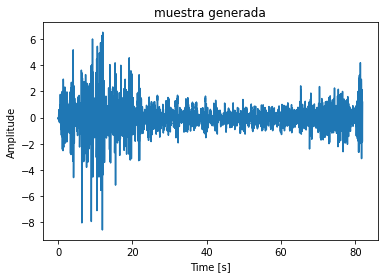

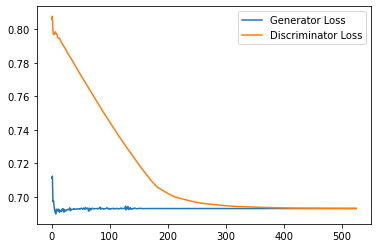

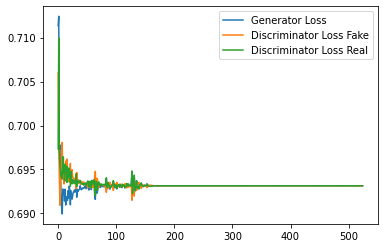

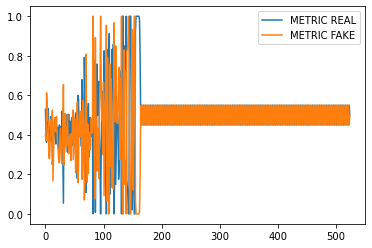

Step 10550: Generator loss: 0.6931470024585724, discriminator loss: 0.693233118057251
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


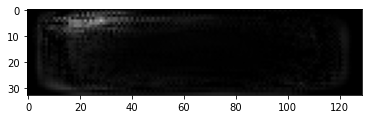

Espectrogramas Reales


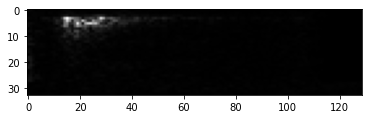

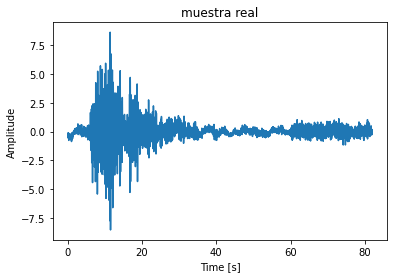

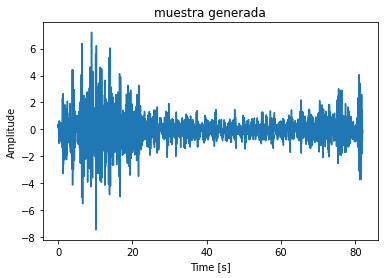

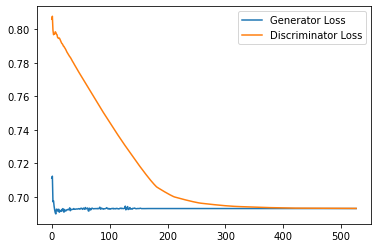

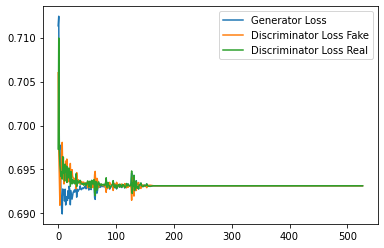

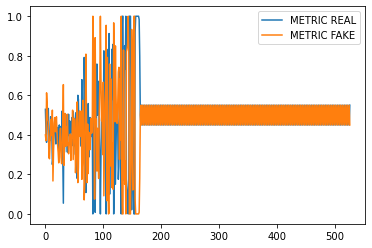

Step 10600: Generator loss: 0.6931472432613373, discriminator loss: 0.6932288718223572
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


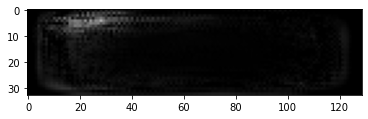

Espectrogramas Reales


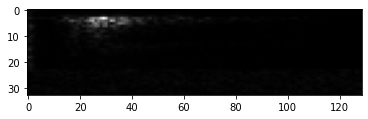

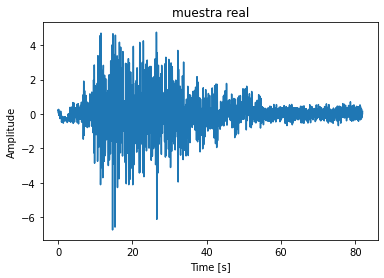

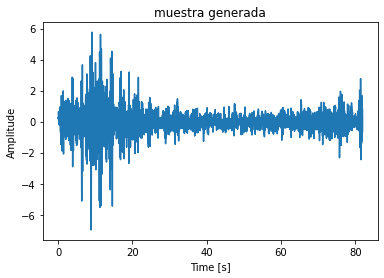

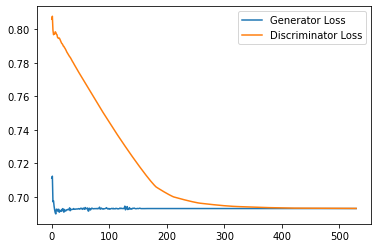

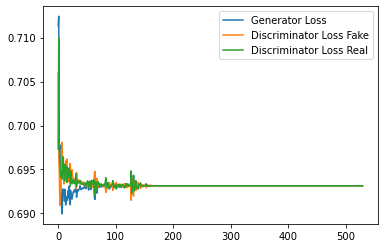

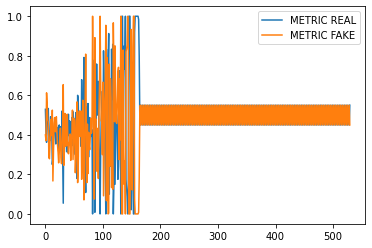

Step 10650: Generator loss: 0.693147418498993, discriminator loss: 0.6932241117954254
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


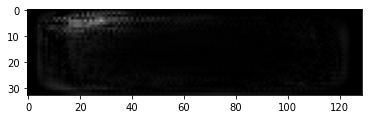

Espectrogramas Reales


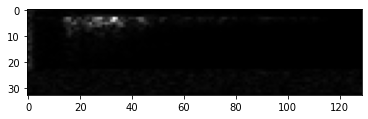

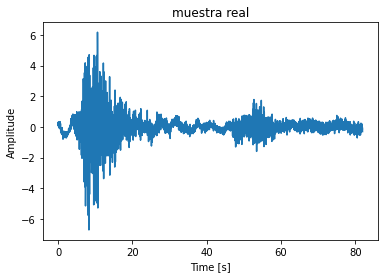

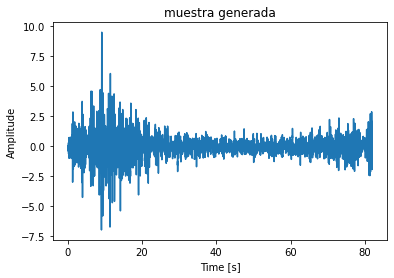

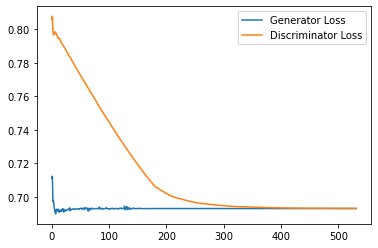

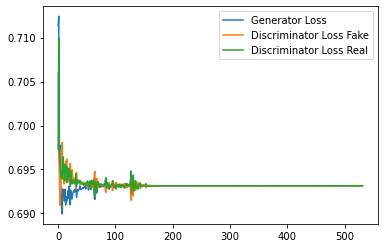

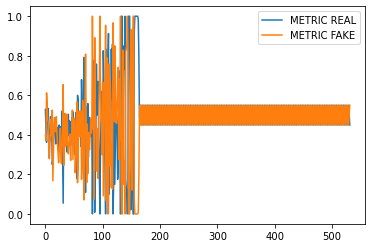

Step 10700: Generator loss: 0.6931469976902008, discriminator loss: 0.6932187056541443
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


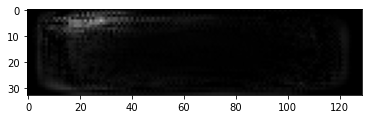

Espectrogramas Reales


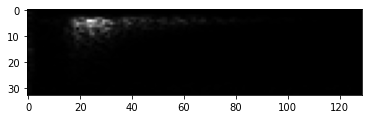

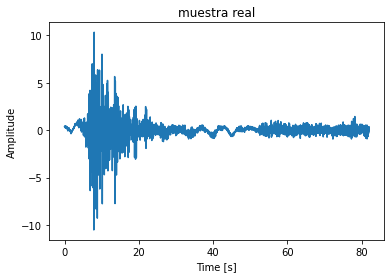

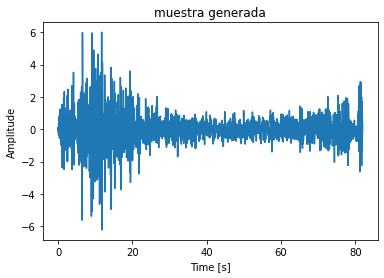

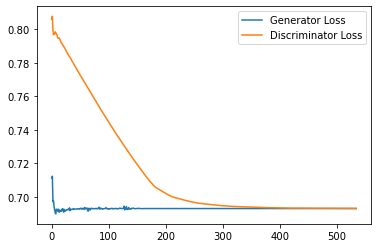

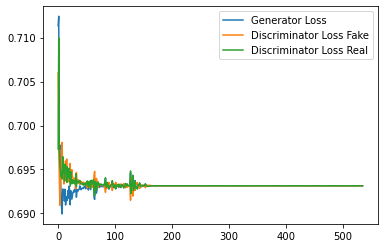

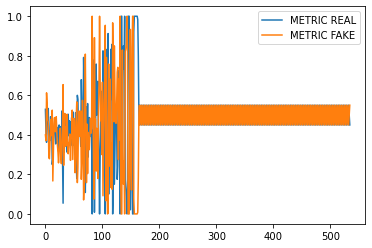

Step 10750: Generator loss: 0.6931472361087799, discriminator loss: 0.6932153558731079
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


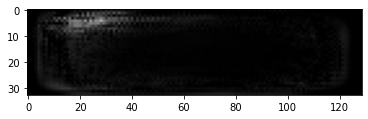

Espectrogramas Reales


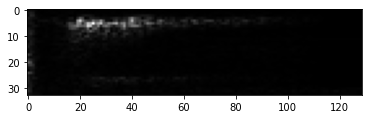

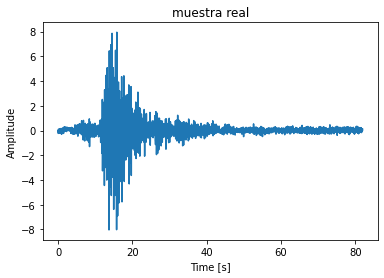

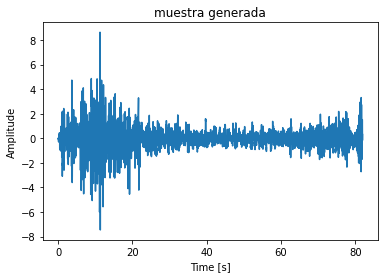

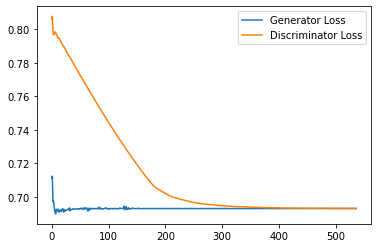

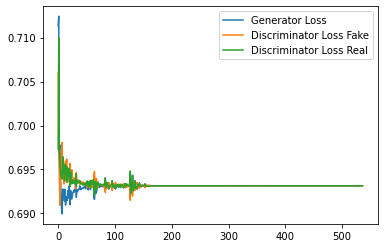

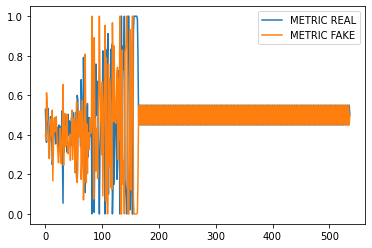

Epoch: 21


  0%|          | 0/513 [00:00<?, ?it/s]

Step 10800: Generator loss: 0.6931474161148071, discriminator loss: 0.6932098722457886
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


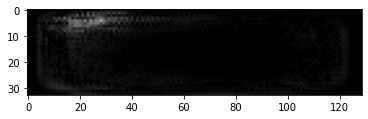

Espectrogramas Reales


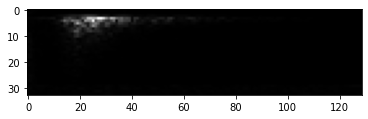

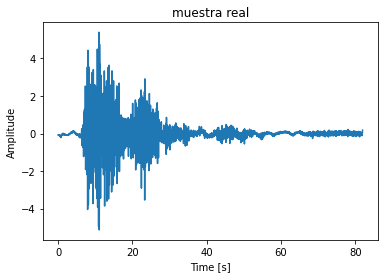

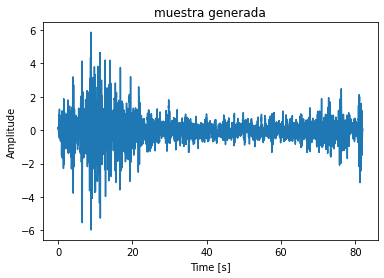

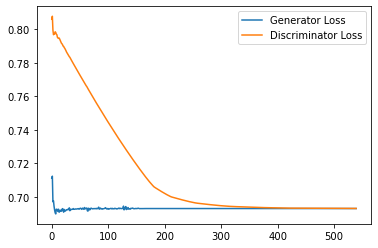

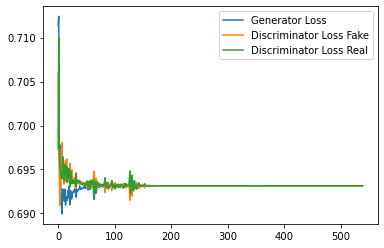

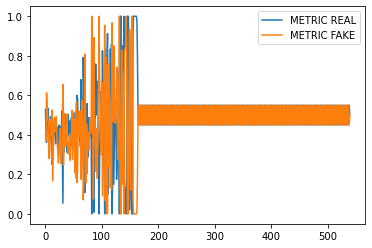

Step 10850: Generator loss: 0.6931469976902008, discriminator loss: 0.6932053339481353
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


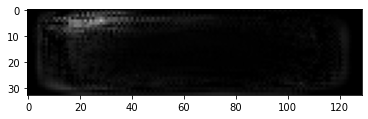

Espectrogramas Reales


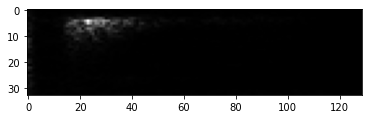

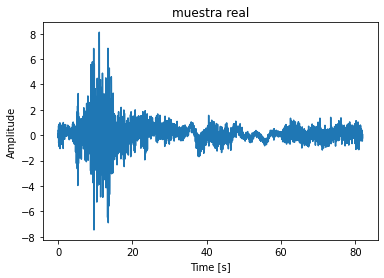

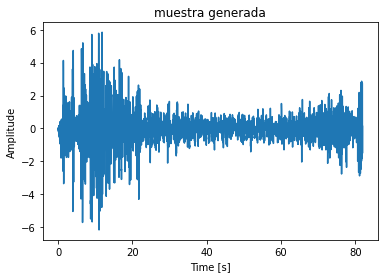

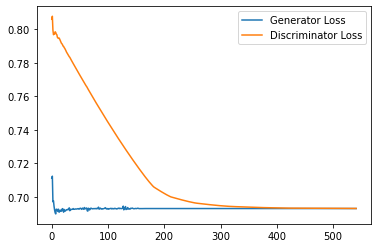

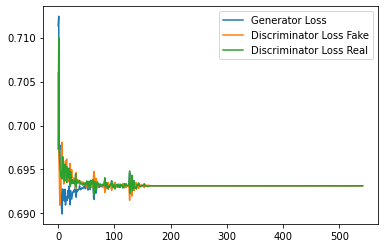

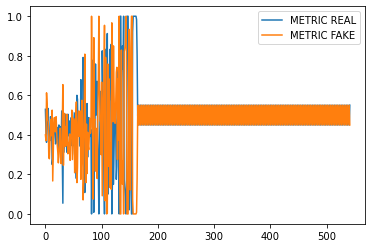

Step 10900: Generator loss: 0.6931472408771515, discriminator loss: 0.6932002639770508
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


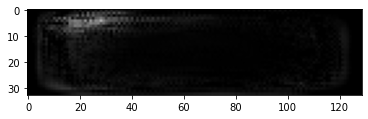

Espectrogramas Reales


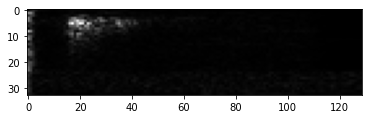

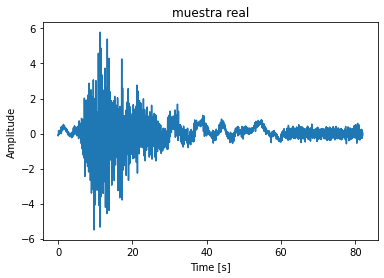

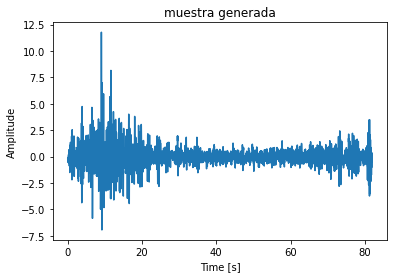

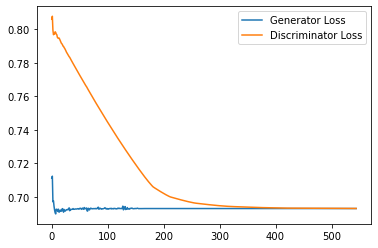

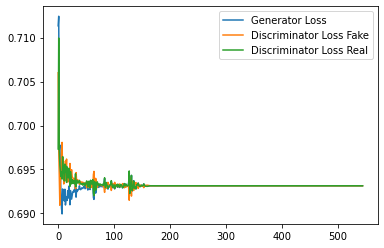

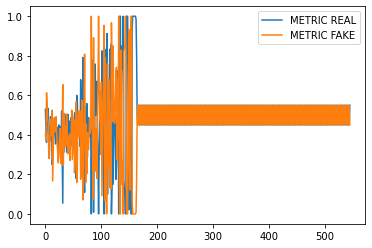

Step 10950: Generator loss: 0.6931474161148071, discriminator loss: 0.6931955480575561
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


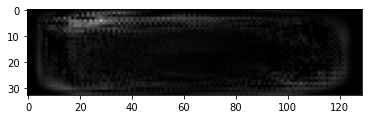

Espectrogramas Reales


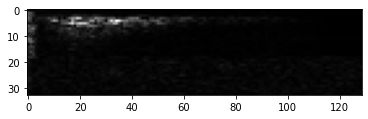

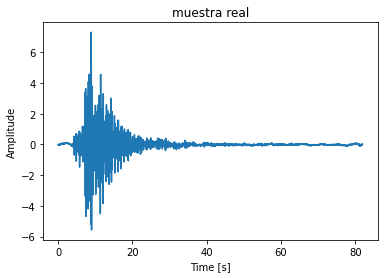

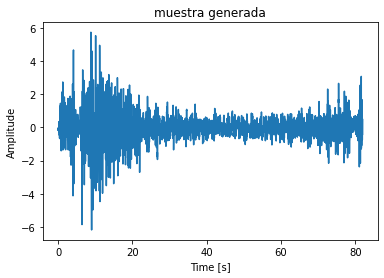

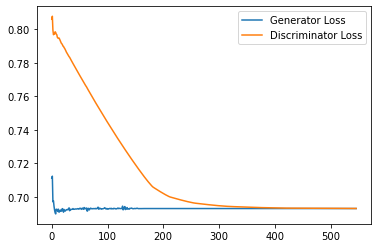

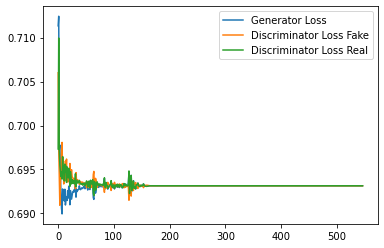

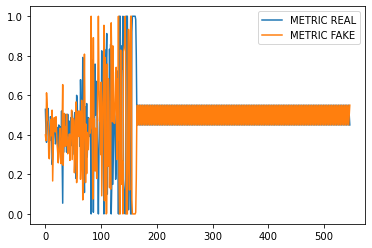

Step 11000: Generator loss: 0.693146995306015, discriminator loss: 0.6931912815570831
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


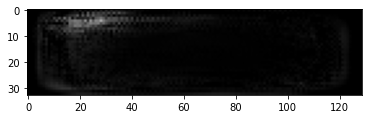

Espectrogramas Reales


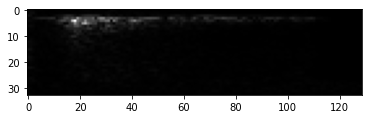

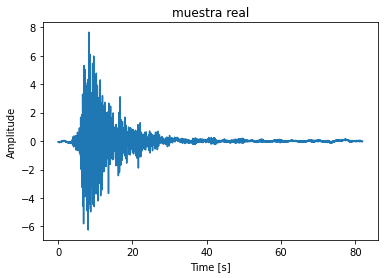

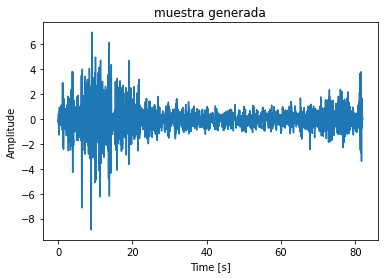

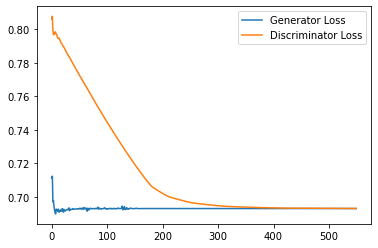

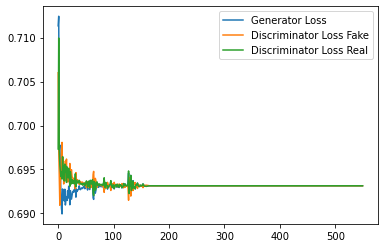

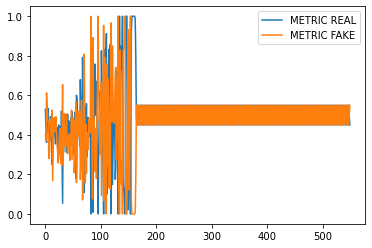

Step 11050: Generator loss: 0.6931472384929657, discriminator loss: 0.6931869149208069
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


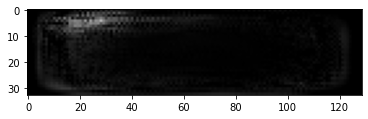

Espectrogramas Reales


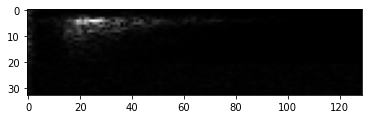

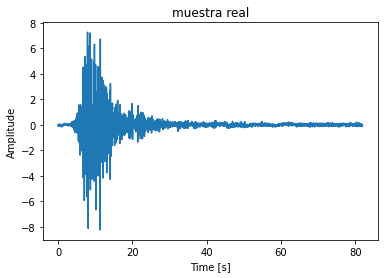

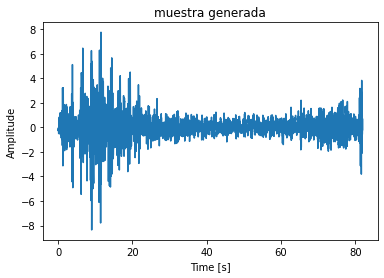

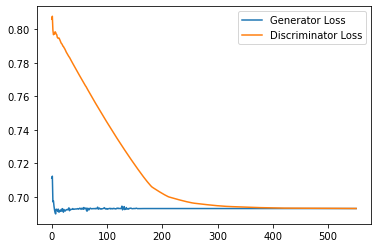

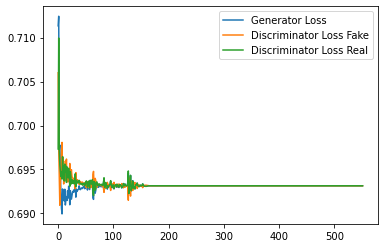

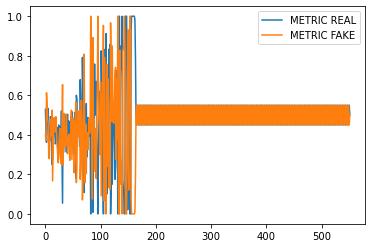

Step 11100: Generator loss: 0.6931474161148071, discriminator loss: 0.693181985616684
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


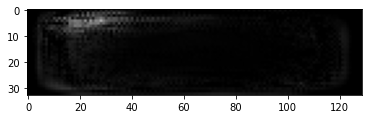

Espectrogramas Reales


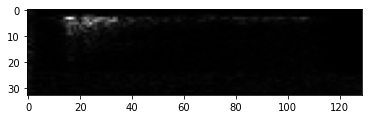

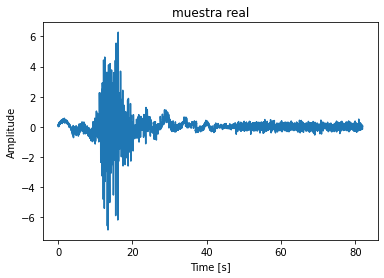

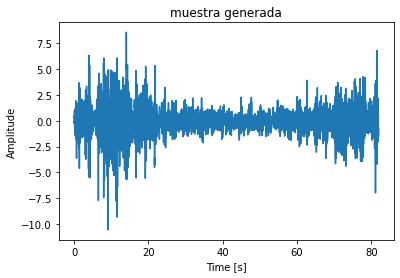

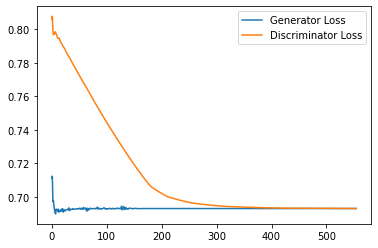

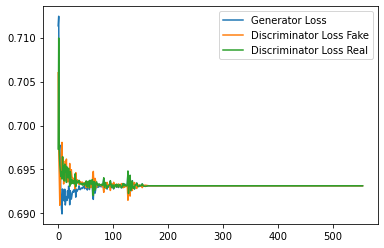

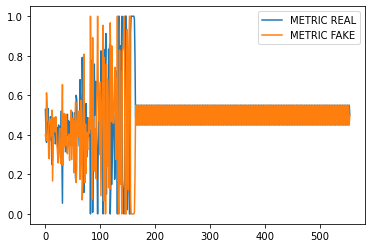

Step 11150: Generator loss: 0.693146995306015, discriminator loss: 0.6931772601604461
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


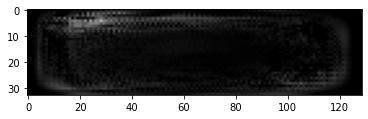

Espectrogramas Reales


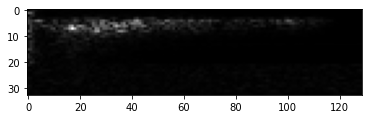

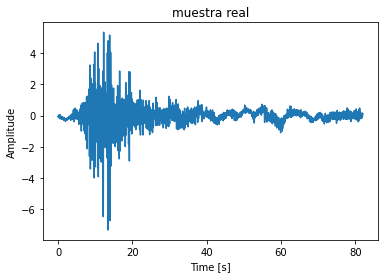

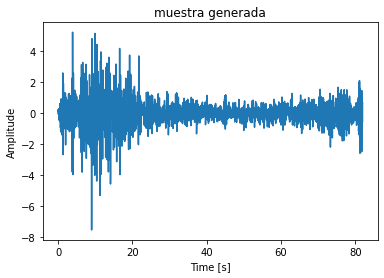

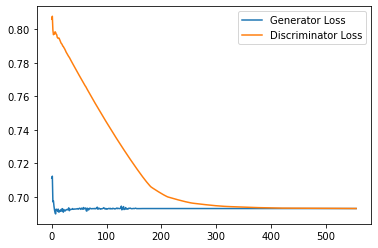

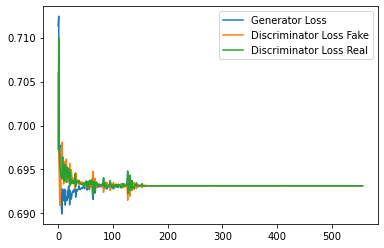

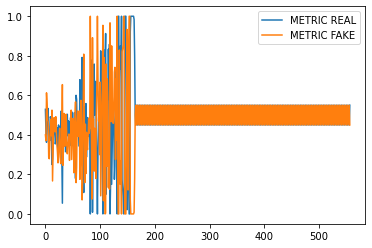

Step 11200: Generator loss: 0.6931472384929657, discriminator loss: 0.6931730771064758
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


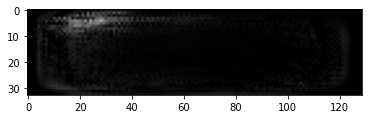

Espectrogramas Reales


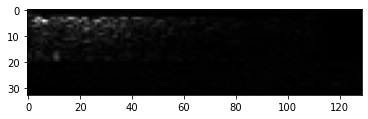

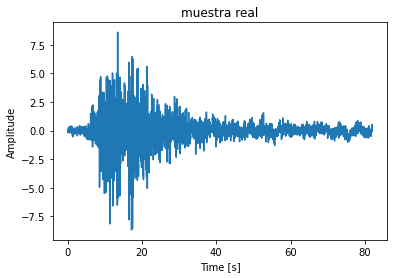

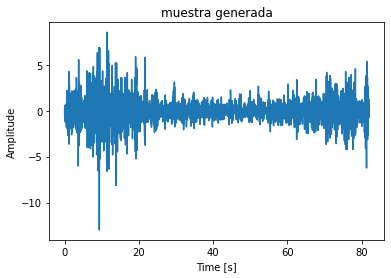

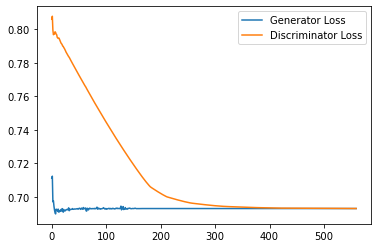

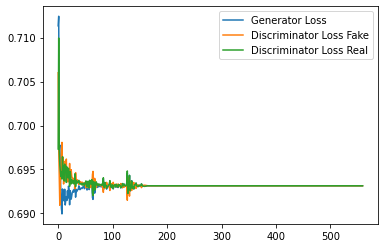

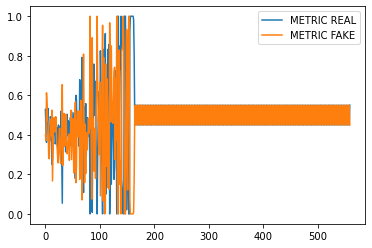

Step 11250: Generator loss: 0.6931474161148071, discriminator loss: 0.6931671214103698
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


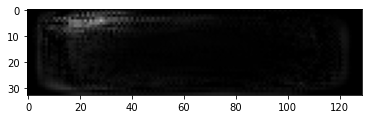

Espectrogramas Reales


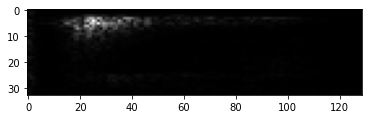

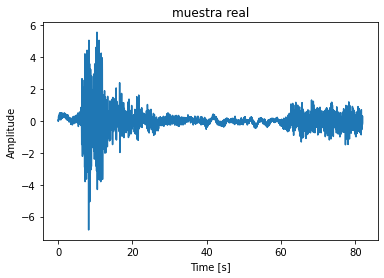

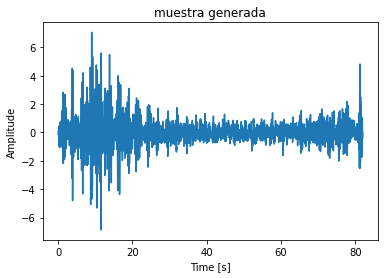

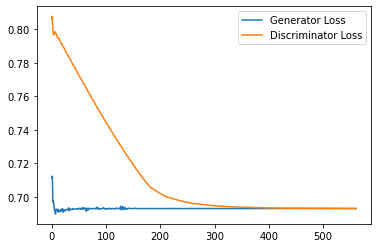

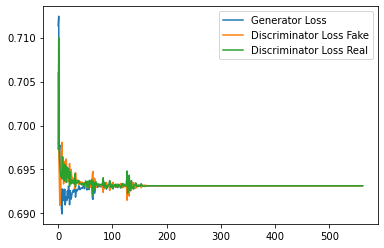

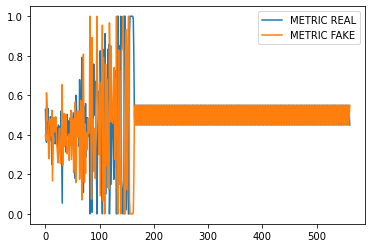

Epoch: 22


  0%|          | 0/513 [00:00<?, ?it/s]

Step 11300: Generator loss: 0.693146995306015, discriminator loss: 0.6931656932830811
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


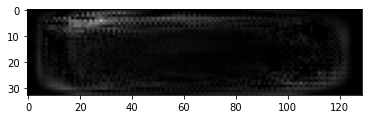

Espectrogramas Reales


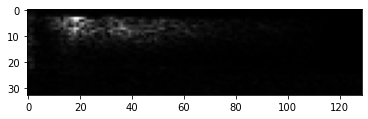

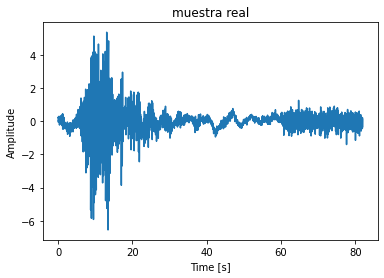

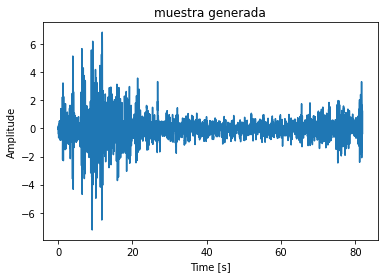

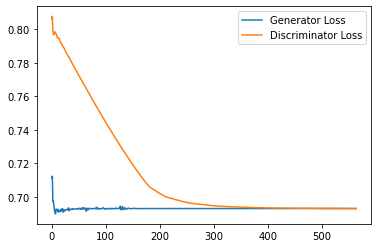

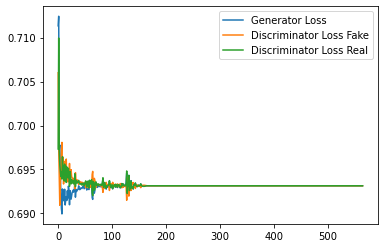

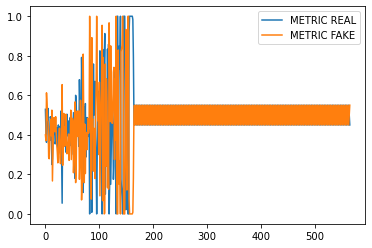

Step 11350: Generator loss: 0.6931472337245941, discriminator loss: 0.6931653130054474
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


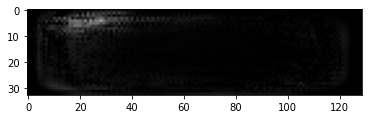

Espectrogramas Reales


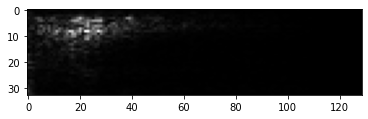

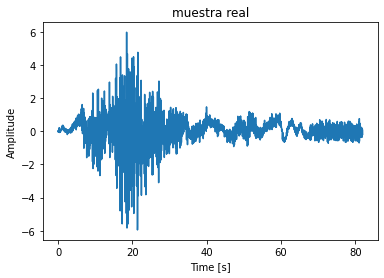

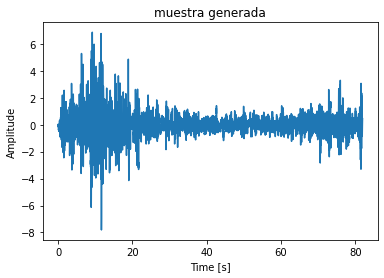

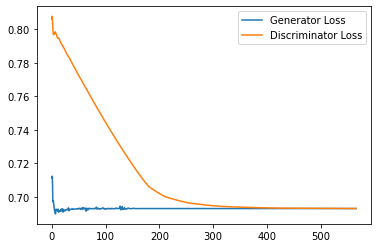

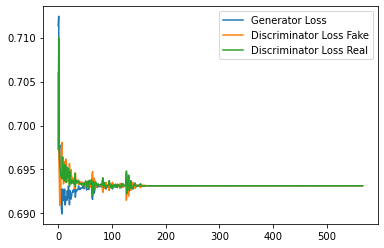

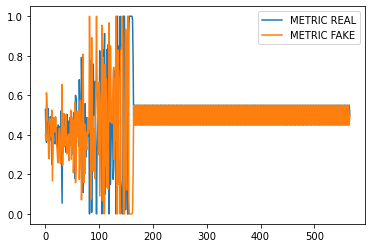

Step 11400: Generator loss: 0.6931474137306214, discriminator loss: 0.6931662249565125
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


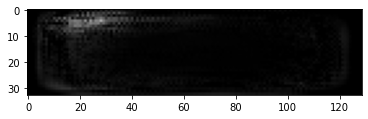

Espectrogramas Reales


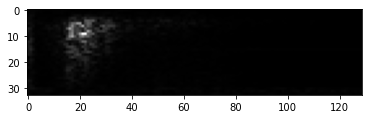

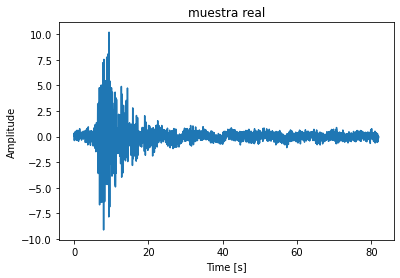

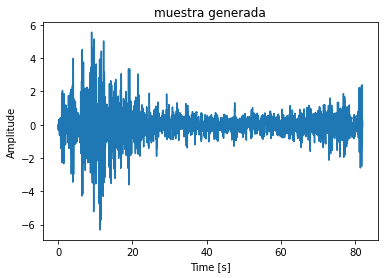

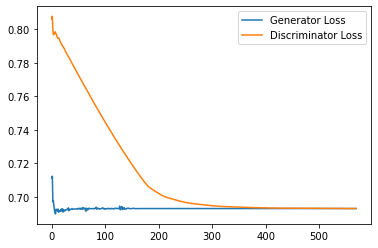

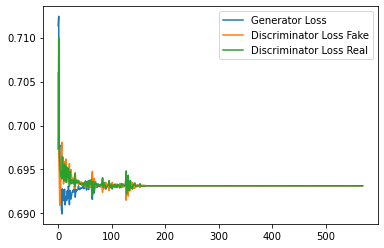

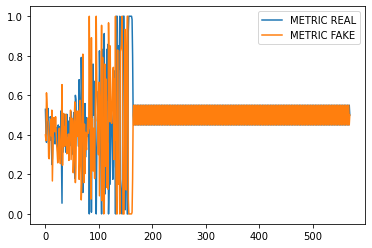

Step 11450: Generator loss: 0.693146995306015, discriminator loss: 0.6931657493114471
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


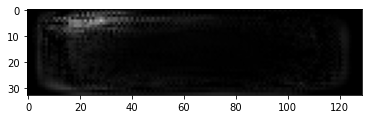

Espectrogramas Reales


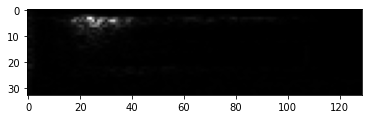

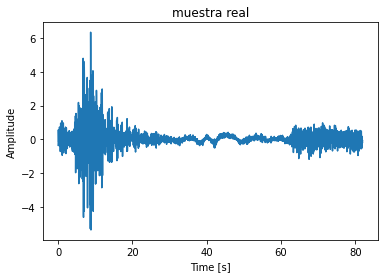

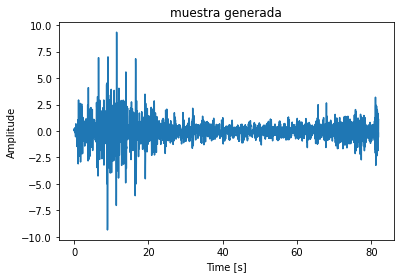

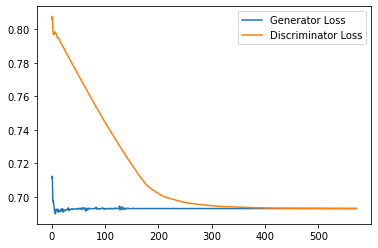

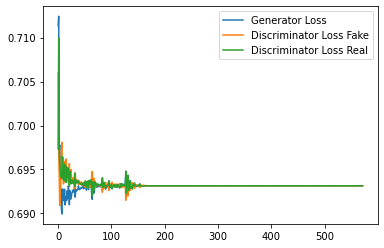

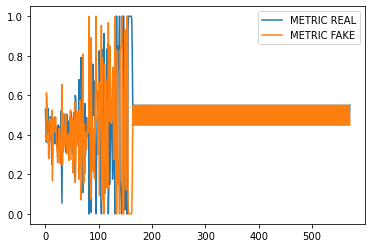

Step 11500: Generator loss: 0.6931472337245941, discriminator loss: 0.6931652998924256
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


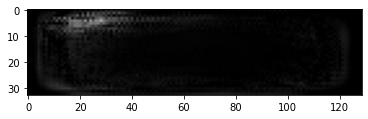

Espectrogramas Reales


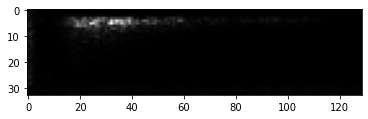

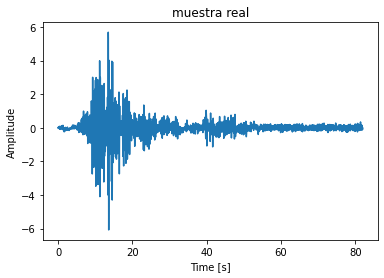

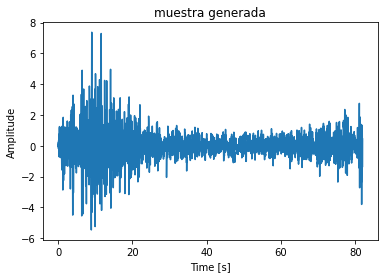

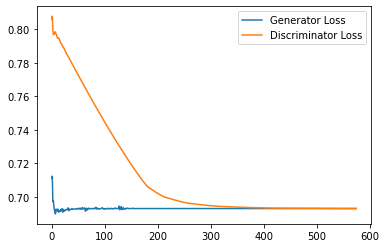

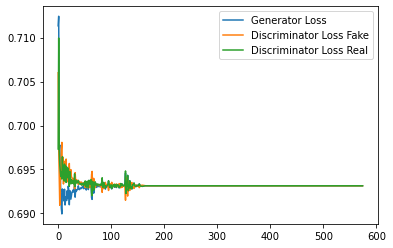

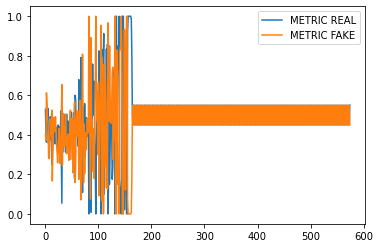

Step 11550: Generator loss: 0.6931474137306214, discriminator loss: 0.6931661045551301
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


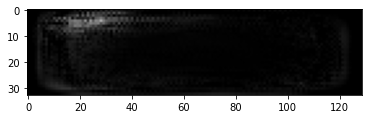

Espectrogramas Reales


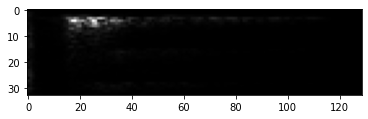

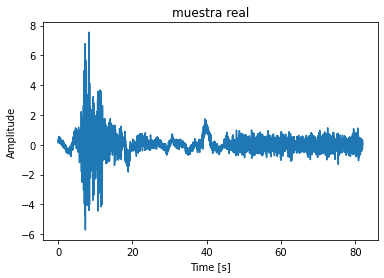

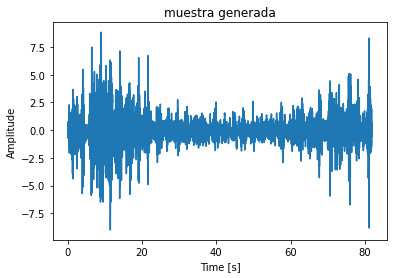

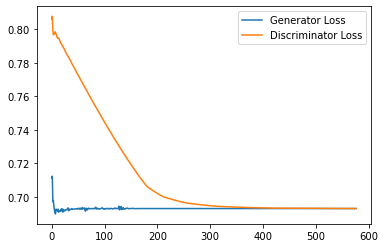

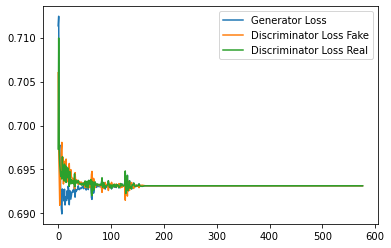

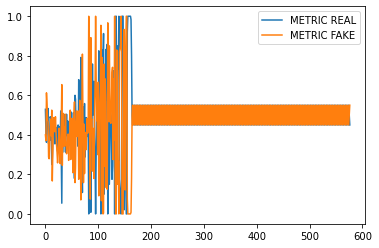

Step 11600: Generator loss: 0.693146995306015, discriminator loss: 0.6931660842895507
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


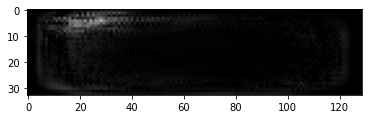

Espectrogramas Reales


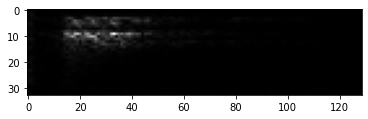

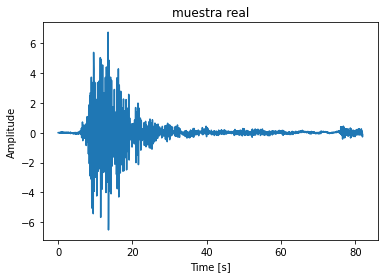

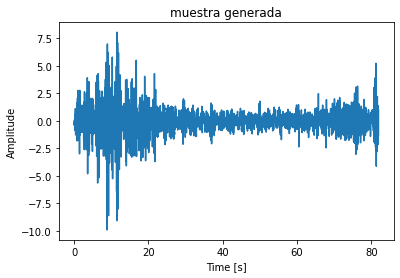

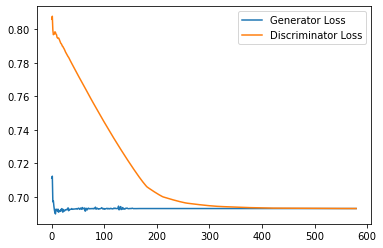

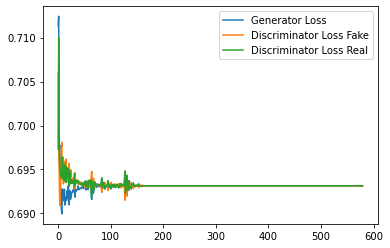

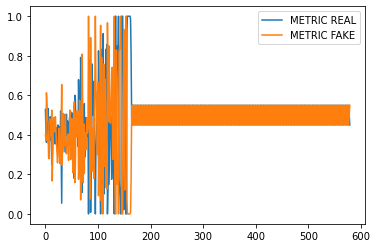

Step 11650: Generator loss: 0.6931472361087799, discriminator loss: 0.6931656658649444
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


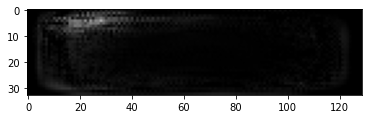

Espectrogramas Reales


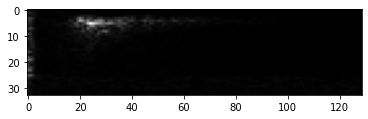

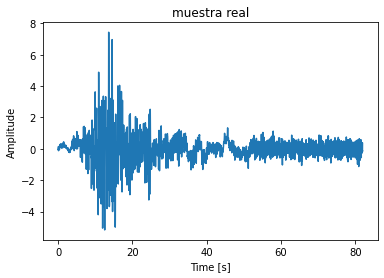

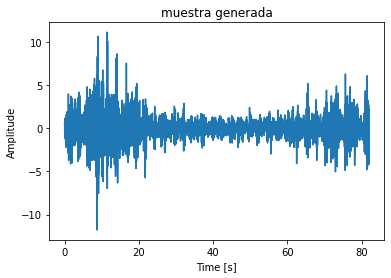

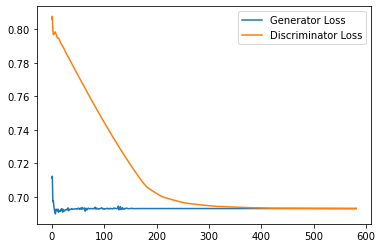

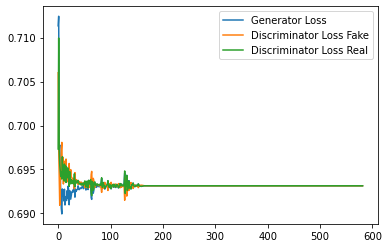

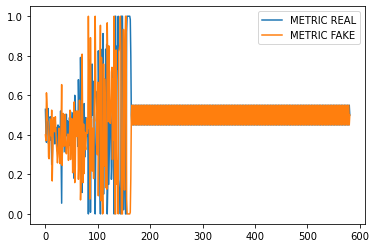

Step 11700: Generator loss: 0.6931474113464355, discriminator loss: 0.6931655669212341
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


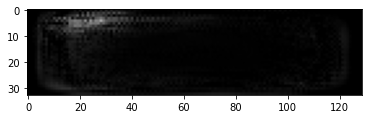

Espectrogramas Reales


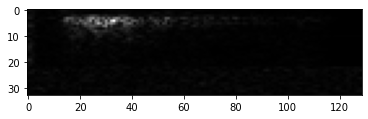

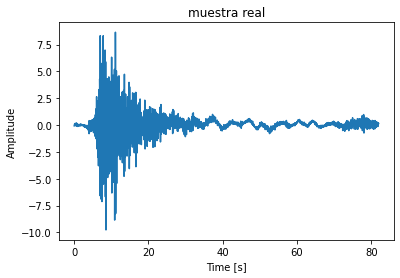

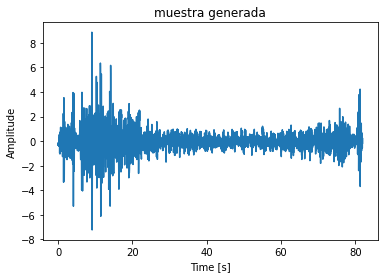

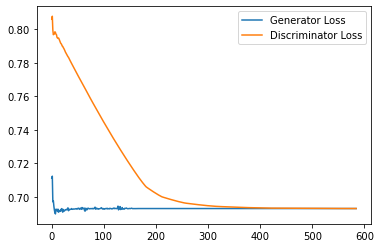

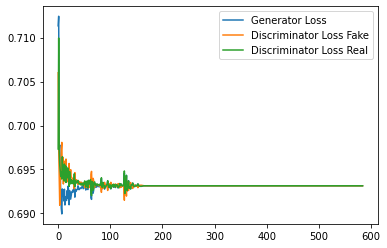

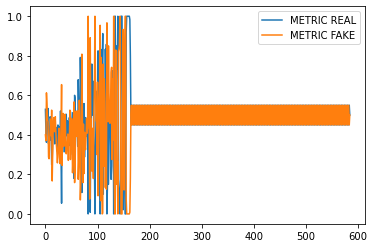

Step 11750: Generator loss: 0.693146995306015, discriminator loss: 0.6931661808490753
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


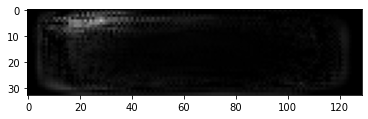

Espectrogramas Reales


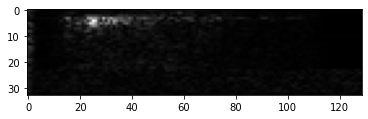

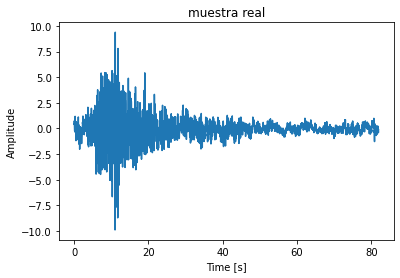

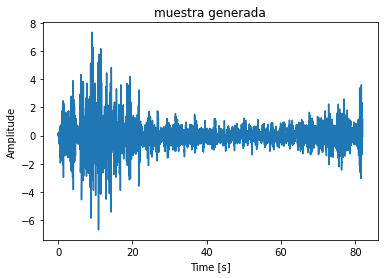

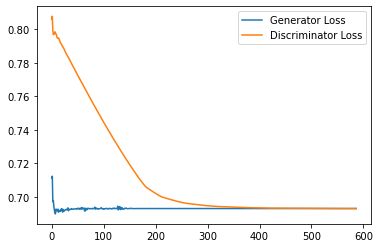

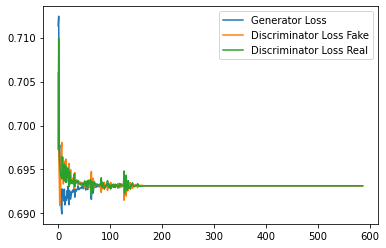

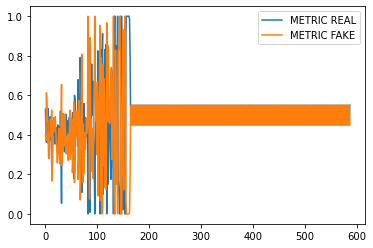

Epoch: 23


  0%|          | 0/513 [00:00<?, ?it/s]

Step 11800: Generator loss: 0.6931472361087799, discriminator loss: 0.6931668126583099
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


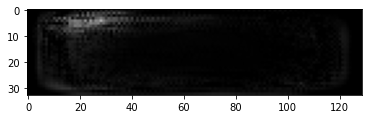

Espectrogramas Reales


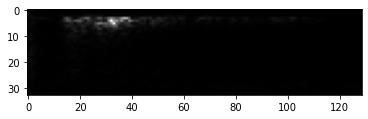

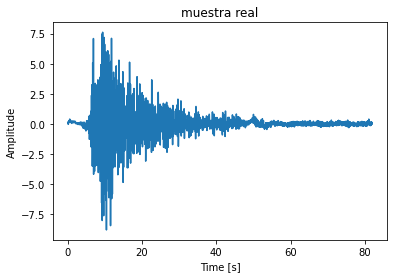

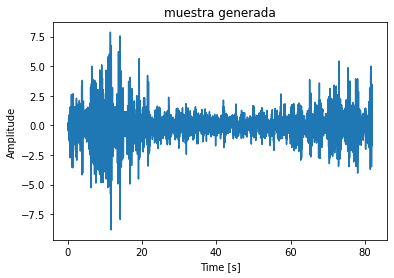

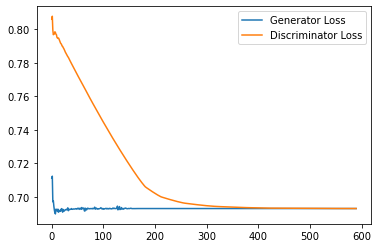

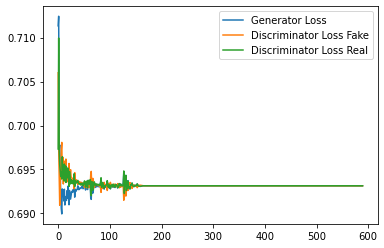

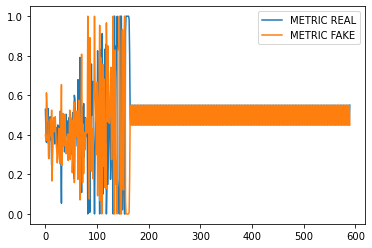

Step 11850: Generator loss: 0.6931474137306214, discriminator loss: 0.6931660485267639
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


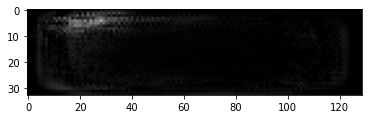

Espectrogramas Reales


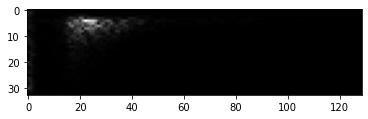

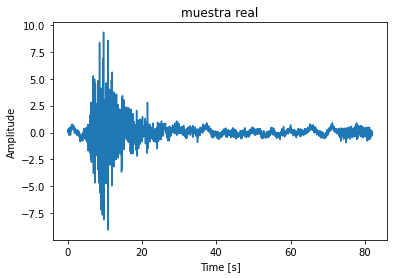

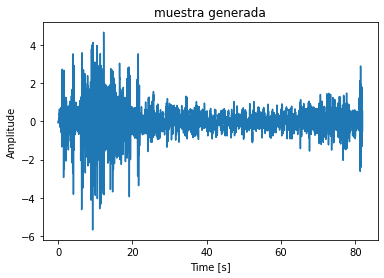

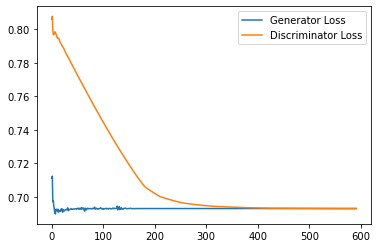

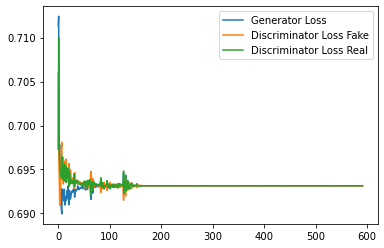

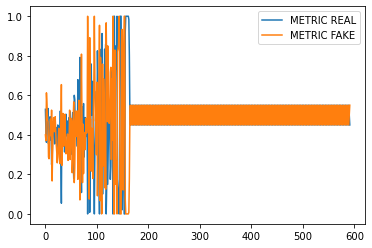

Step 11900: Generator loss: 0.6931469929218292, discriminator loss: 0.6931670260429382
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


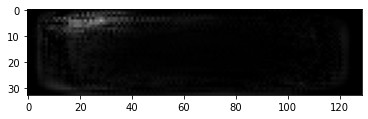

Espectrogramas Reales


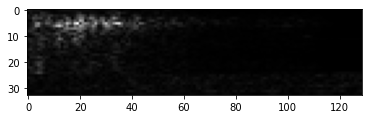

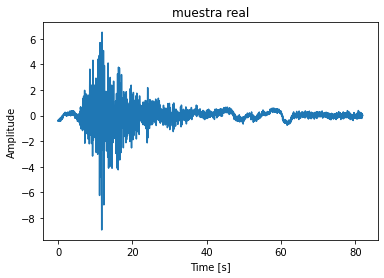

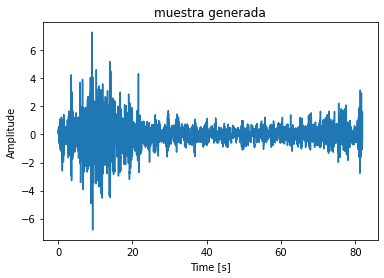

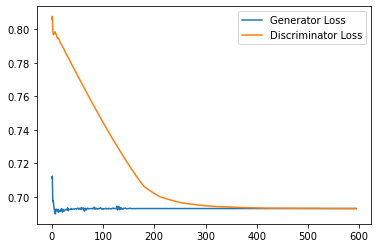

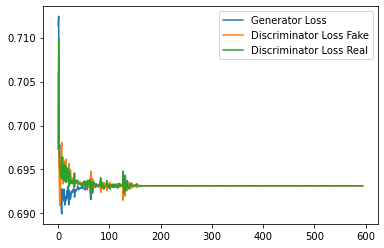

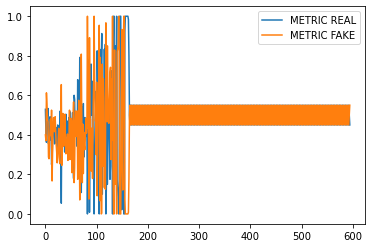

Step 11950: Generator loss: 0.6931472337245941, discriminator loss: 0.6931656849384308
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


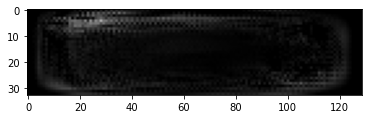

Espectrogramas Reales


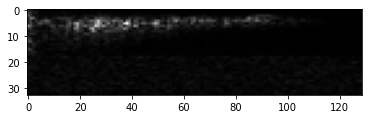

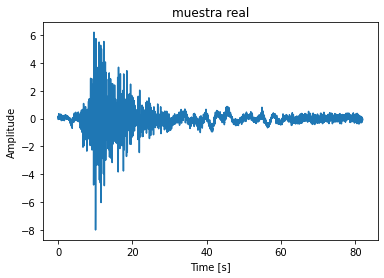

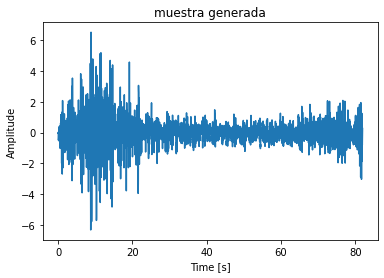

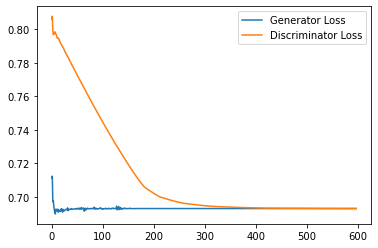

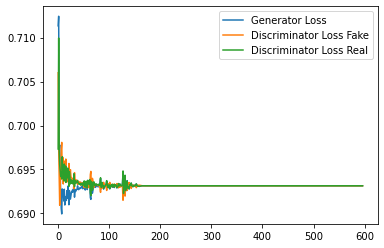

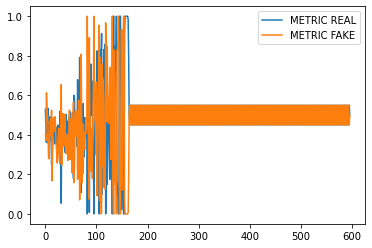

Step 12000: Generator loss: 0.6931474161148071, discriminator loss: 0.6931670582294465
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


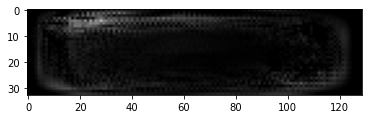

Espectrogramas Reales


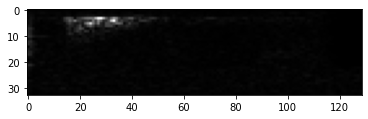

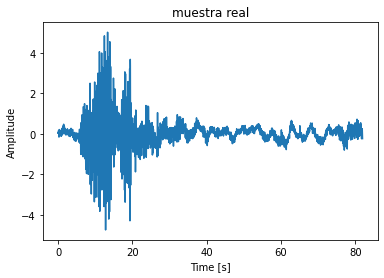

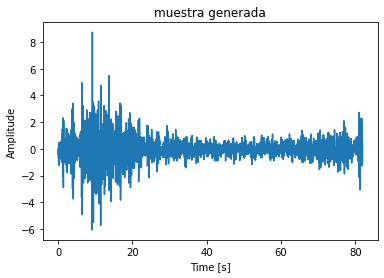

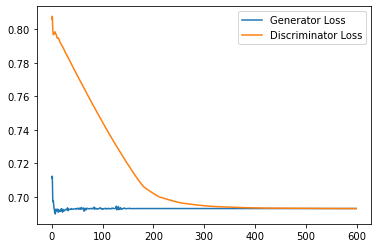

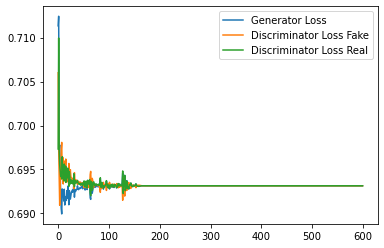

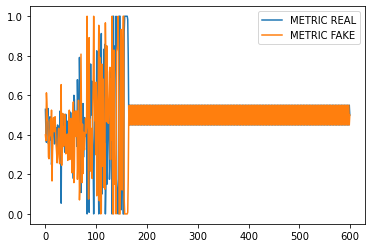

Step 12050: Generator loss: 0.6931469929218292, discriminator loss: 0.6931656503677368
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


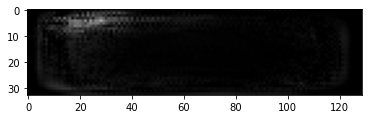

Espectrogramas Reales


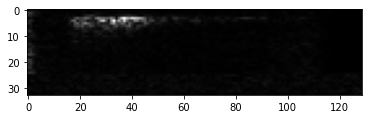

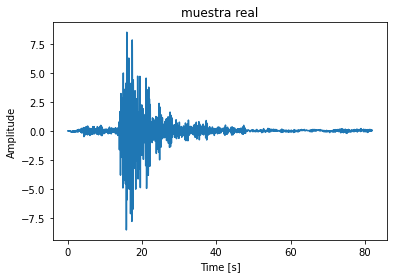

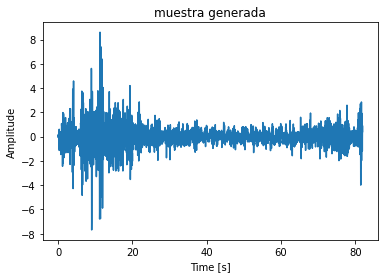

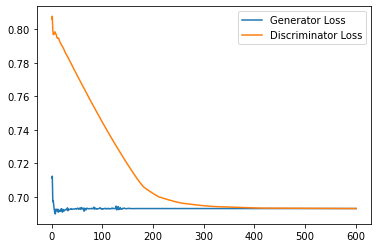

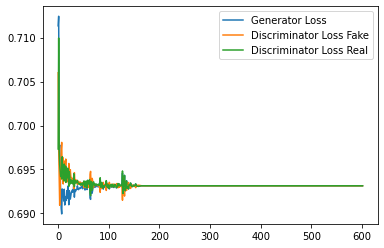

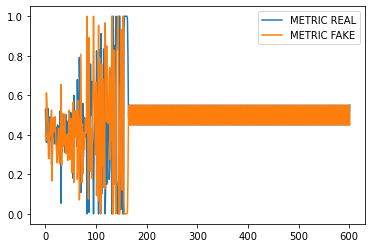

Step 12100: Generator loss: 0.6931472361087799, discriminator loss: 0.693166401386261
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


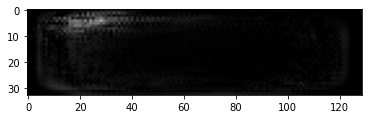

Espectrogramas Reales


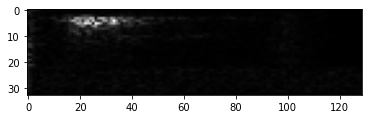

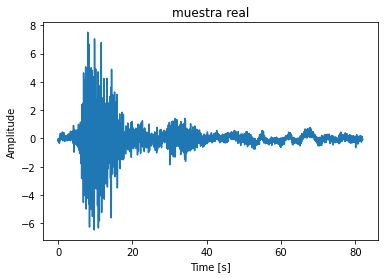

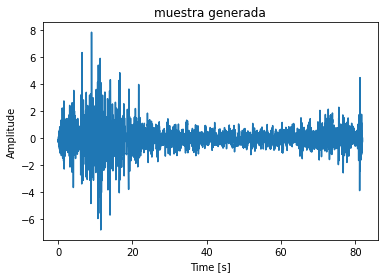

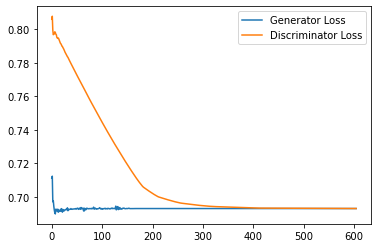

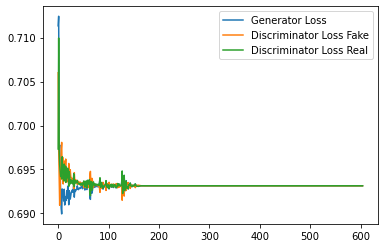

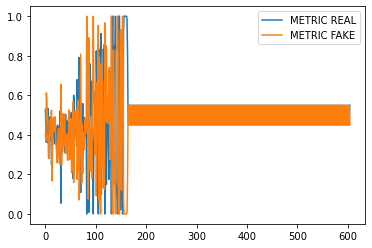

Step 12150: Generator loss: 0.6931474137306214, discriminator loss: 0.6931662714481354
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


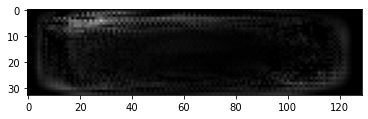

Espectrogramas Reales


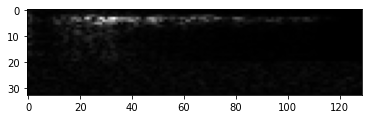

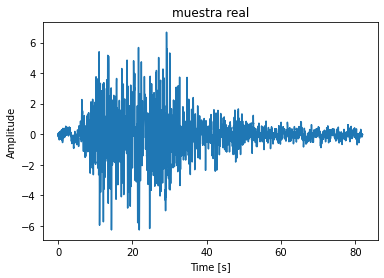

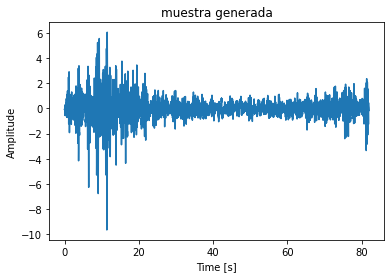

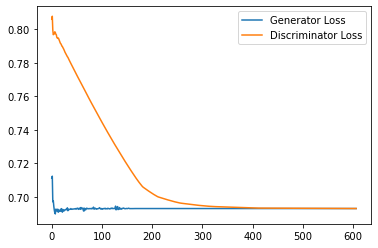

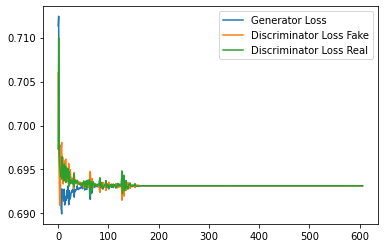

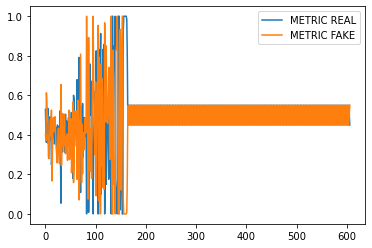

Step 12200: Generator loss: 0.6931469929218292, discriminator loss: 0.6931664848327637
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


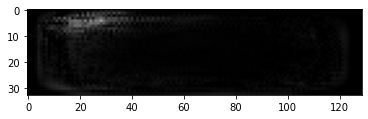

Espectrogramas Reales


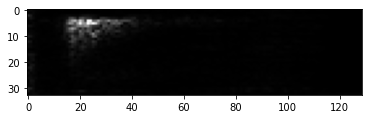

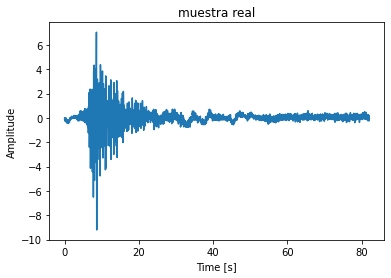

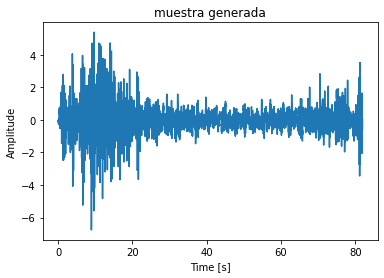

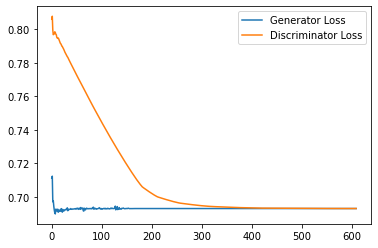

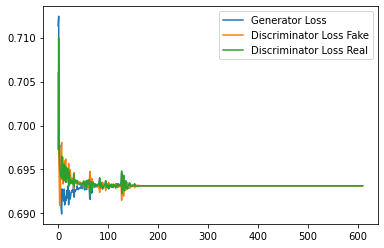

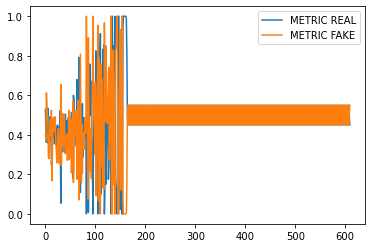

Step 12250: Generator loss: 0.6931472337245941, discriminator loss: 0.6931661128997803
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


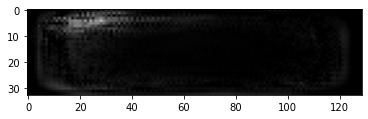

Espectrogramas Reales


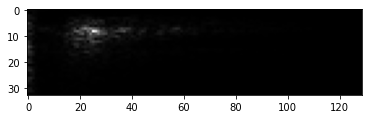

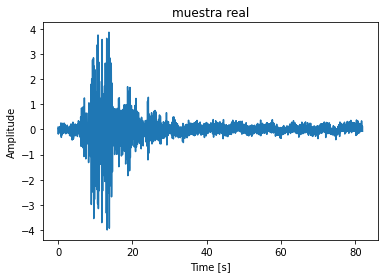

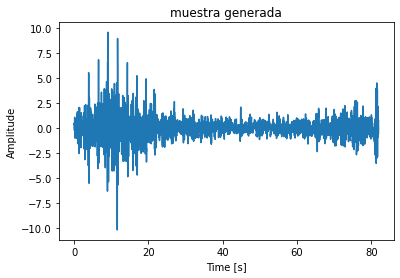

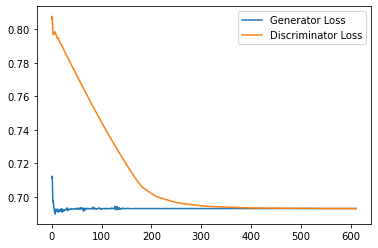

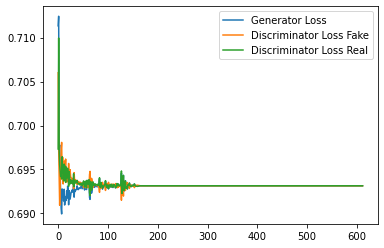

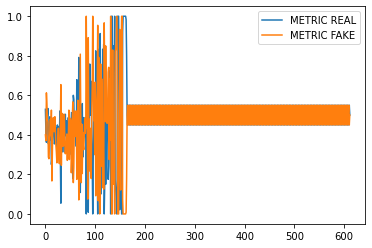

Step 12300: Generator loss: 0.6931474161148071, discriminator loss: 0.6931660580635071
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


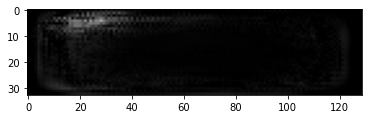

Espectrogramas Reales


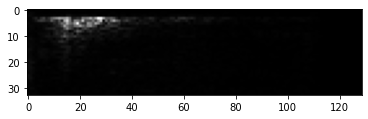

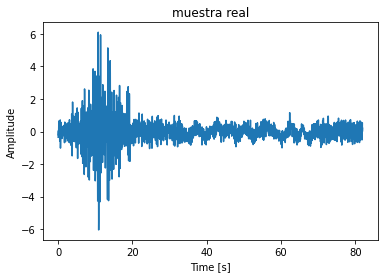

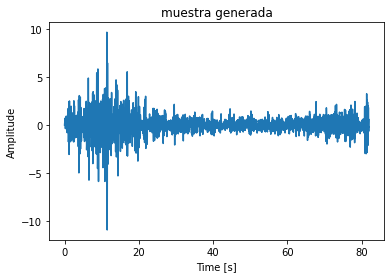

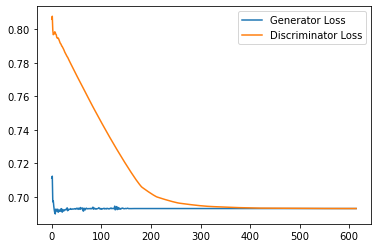

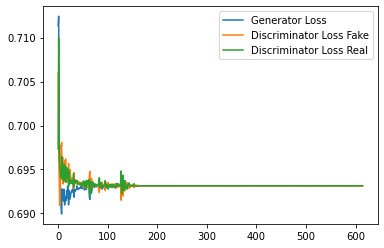

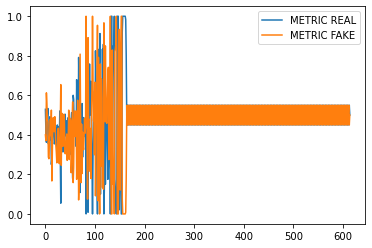

Epoch: 24


  0%|          | 0/513 [00:00<?, ?it/s]

Step 12350: Generator loss: 0.693146995306015, discriminator loss: 0.6931671488285065
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


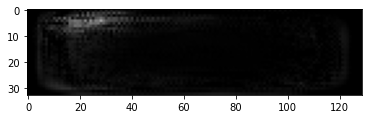

Espectrogramas Reales


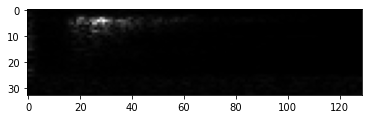

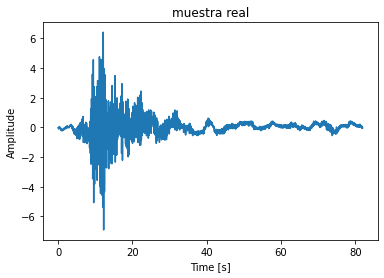

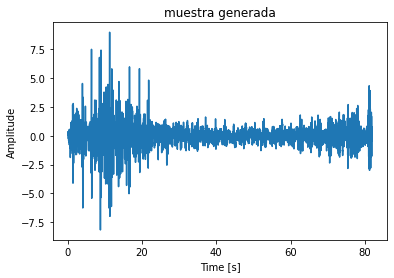

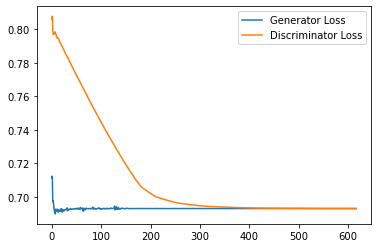

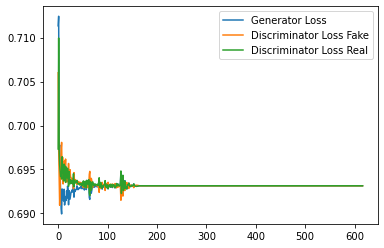

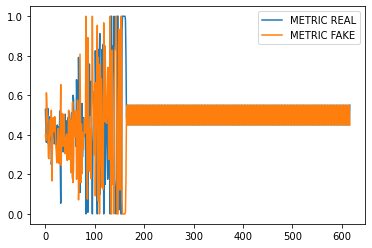

Step 12400: Generator loss: 0.6931472337245941, discriminator loss: 0.6931656408309936
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


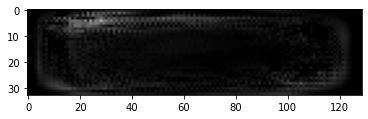

Espectrogramas Reales


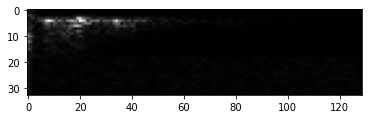

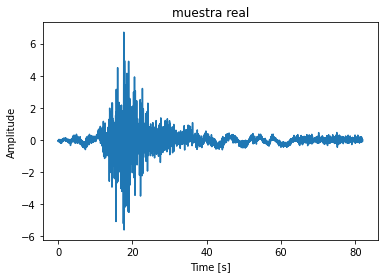

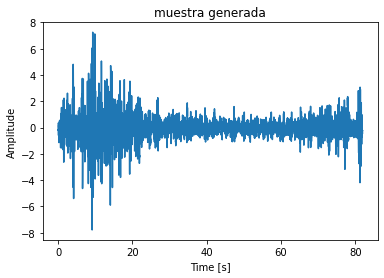

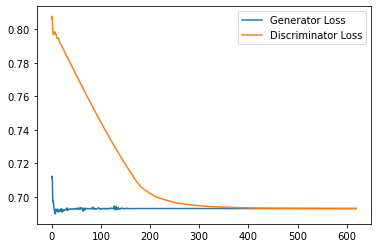

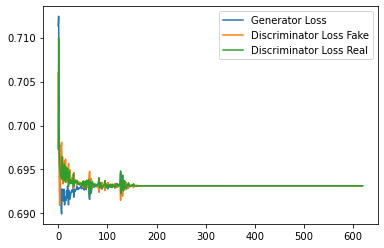

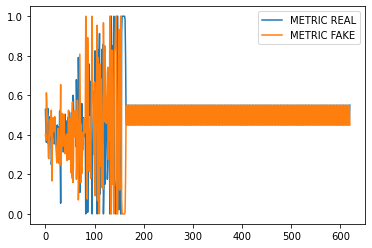

Step 12450: Generator loss: 0.6931474137306214, discriminator loss: 0.6931662821769714
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


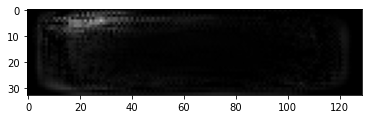

Espectrogramas Reales


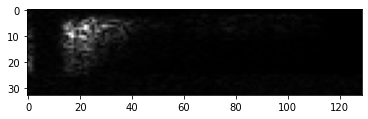

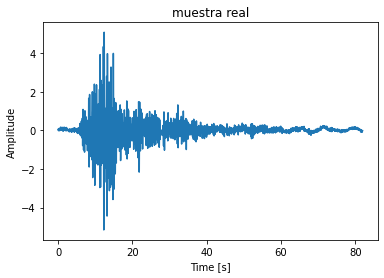

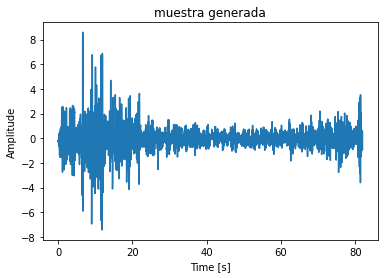

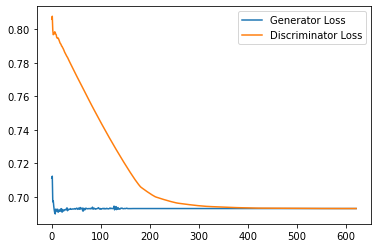

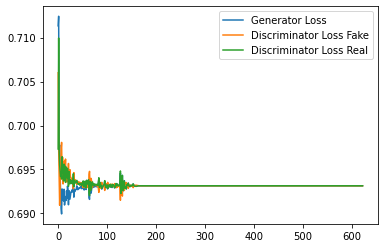

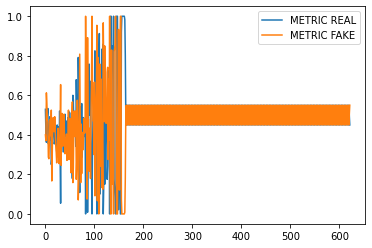

Step 12500: Generator loss: 0.693146995306015, discriminator loss: 0.6931664574146271
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


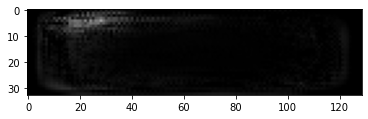

Espectrogramas Reales


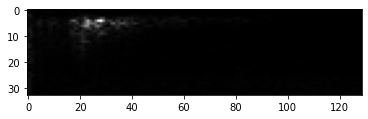

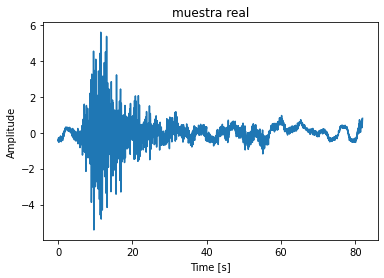

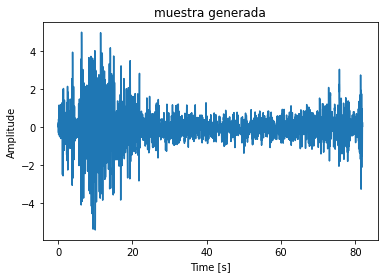

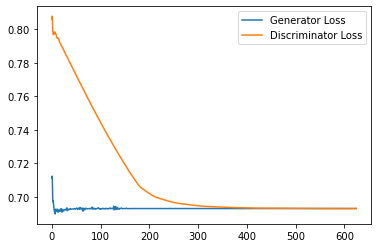

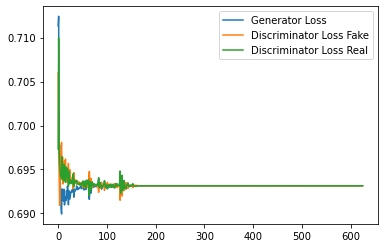

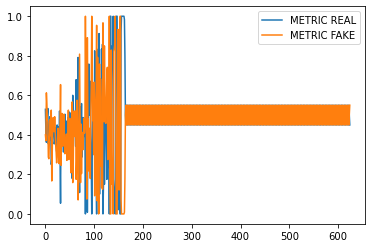

Step 12550: Generator loss: 0.6931472337245941, discriminator loss: 0.6931672585010529
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


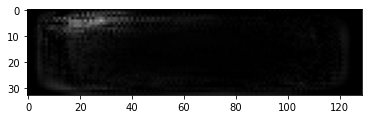

Espectrogramas Reales


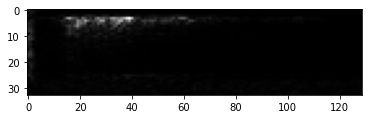

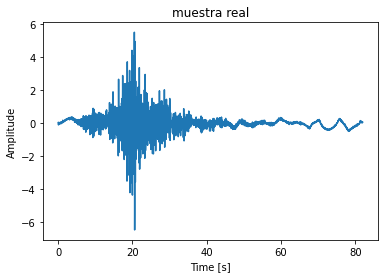

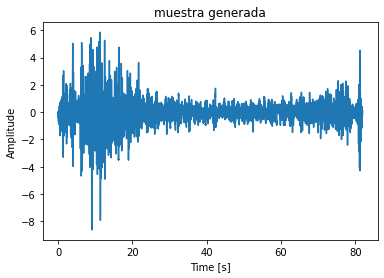

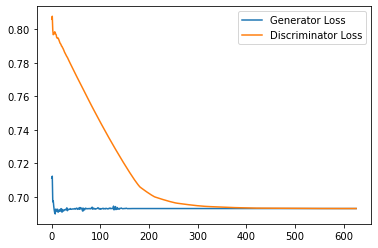

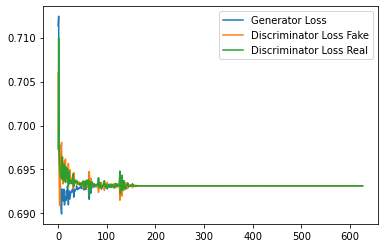

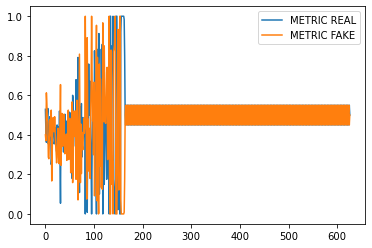

Step 12600: Generator loss: 0.6931474137306214, discriminator loss: 0.6931662905216217
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


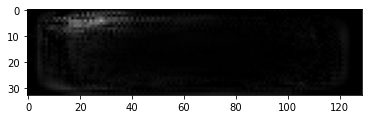

Espectrogramas Reales


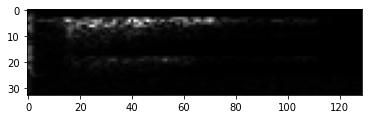

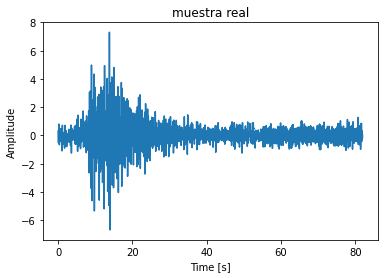

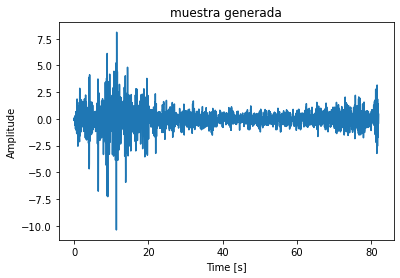

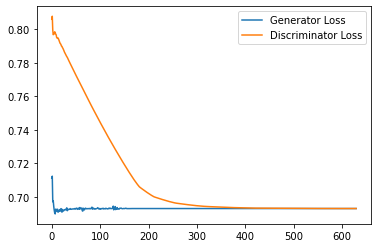

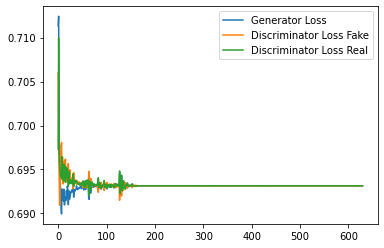

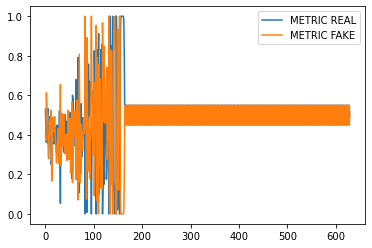

Step 12650: Generator loss: 0.6931469929218292, discriminator loss: 0.6931673491001129
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


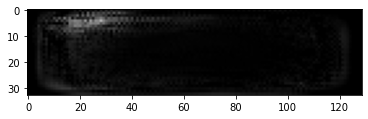

Espectrogramas Reales


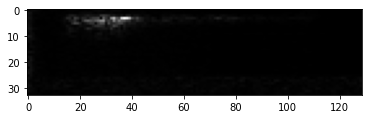

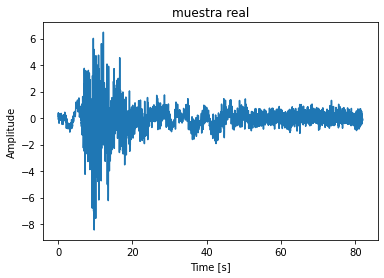

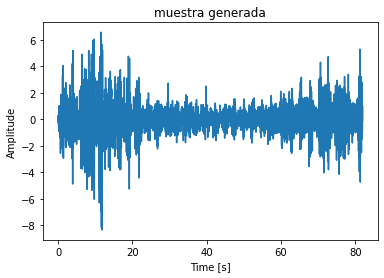

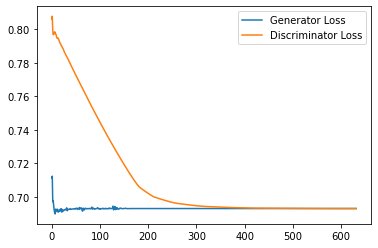

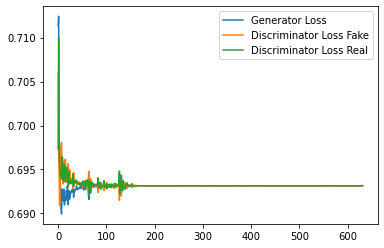

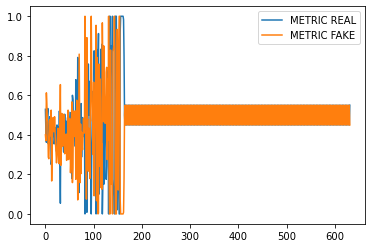

Step 12700: Generator loss: 0.6931472384929657, discriminator loss: 0.6931659352779388
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


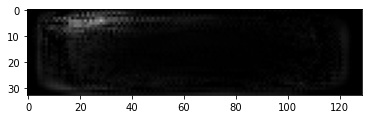

Espectrogramas Reales


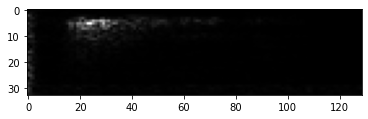

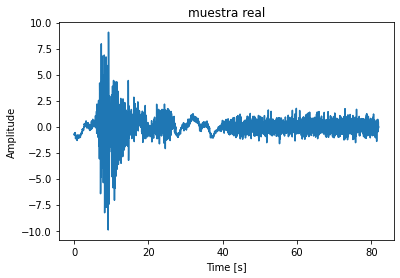

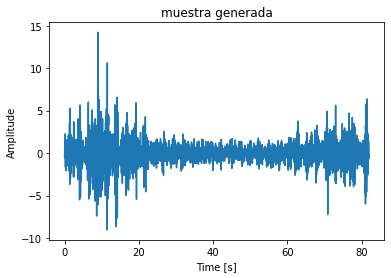

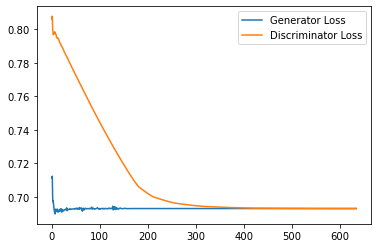

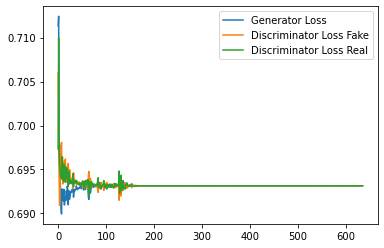

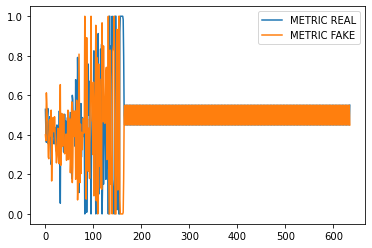

Step 12750: Generator loss: 0.6931474113464355, discriminator loss: 0.6931674933433533
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


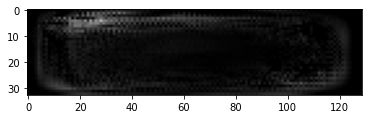

Espectrogramas Reales


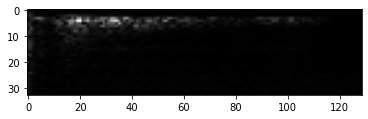

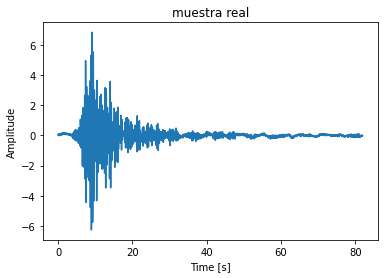

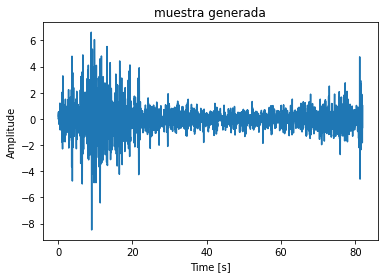

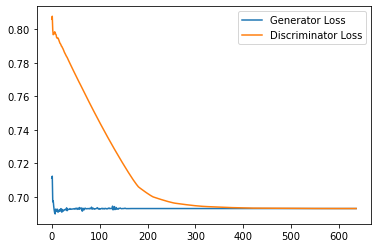

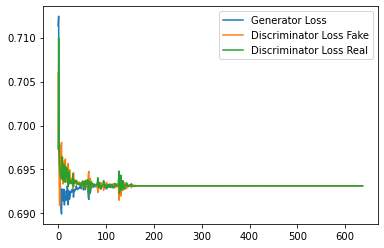

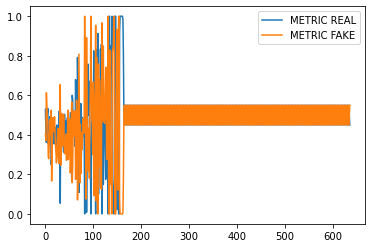

Step 12800: Generator loss: 0.693146995306015, discriminator loss: 0.6931659293174743
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


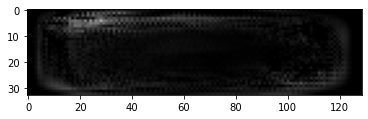

Espectrogramas Reales


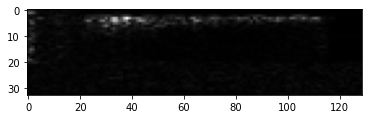

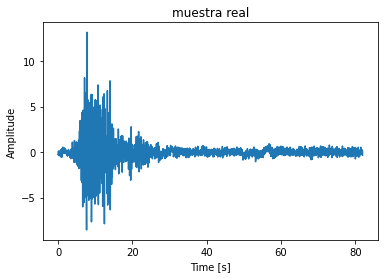

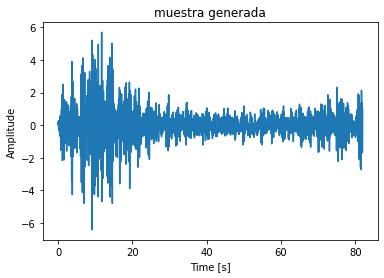

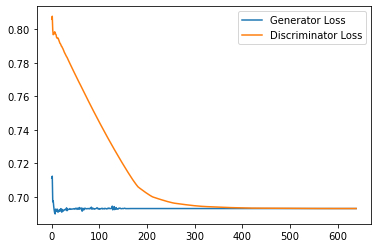

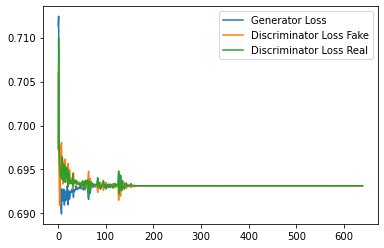

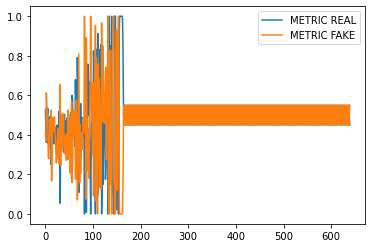

In [ ]:
cur_step = 0
generator_losses = []
discriminator_losses = []
discriminator_losses_real = []
discriminator_losses_fake = []
metric_real = []
metric_fake = [] 

for epoch in range(epoch_temp + 1, n_epochs):
    print('Epoch: ' + str(epoch))
    # Dataloader returns the batches and the labels
    for real, labels in tqdm(dataloader):
        cur_batch_size = len(real)
        # Flatten the batch of real images from the dataset
        real = real.to(device)

        one_hot_labels = auxiliares.get_one_hot_labels(labels.to(device), n_classes)
        image_one_hot_labels = one_hot_labels[:, :, None, None]
        image_one_hot_labels = image_one_hot_labels.repeat(1, 1, mnist_shape[1], mnist_shape[2])

        ### Update discriminator ###
        # Zero out the discriminator gradients
        disc_opt.zero_grad()
        # Get noise corresponding to the current batch_size 
        fake_noise = auxiliares.get_noise(cur_batch_size, z_dim, device=device)
        
        # Now you can get the images from the generator
        # Steps: 1) Combine the noise vectors and the one-hot labels for the generator
        #        2) Generate the conditioned fake images
       
        noise_and_labels = auxiliares.combine_vectors(fake_noise, one_hot_labels)
        #fake = gen(noise_and_labels)
        fake = gen.forward(noise_and_labels) #no usar

        # Now you can get the predictions from the discriminator
        # Steps: 1) Create the input for the discriminator
        #           a) Combine the fake images with image_one_hot_labels, 
        #              remember to detach the generator (.detach()) so you do not backpropagate through it
        #           b) Combine the real images with image_one_hot_labels
        #        2) Get the discriminator's prediction on the fakes as disc_fake_pred
        #        3) Get the discriminator's prediction on the reals as disc_real_pred
        
        fake_image_and_labels = auxiliares.combine_vectors(fake.detach(), image_one_hot_labels)
        real_image_and_labels = auxiliares.combine_vectors(real, image_one_hot_labels)
        disc_fake_pred = disc(fake_image_and_labels)
        disc_real_pred = disc(real_image_and_labels)               
        disc_fake_loss = criterion(disc_fake_pred, torch.zeros_like(disc_fake_pred))
        disc_real_loss = criterion(disc_real_pred, torch.ones_like(disc_real_pred))

        metric_fake += [metric(disc_fake_pred, torch.zeros_like(disc_fake_pred)).item()]
        metric_real += [metric(disc_real_pred, torch.ones_like(disc_real_pred)).item()]
        
        disc_loss = ((disc_fake_loss + disc_real_loss)/2)
        
        if regularizaM:
            l2_reg = None
            for W in disc.parameters():
                if l2_reg is None:
                    l2_reg = W.norm(2)
                else:
                    l2_reg = l2_reg + W.norm(2)
            disc_loss = disc_loss +  l2_reg * reg_lambda 
        
        disc_loss.backward(retain_graph=True)
        disc_opt.step() 

        # Keep track of the average discriminator loss
        discriminator_losses_real += [disc_real_loss.item()]
        discriminator_losses_fake+= [disc_fake_loss.item()]
        discriminator_losses += [disc_loss.item()]

        ### Update generator ###
        # Zero out the generator gradients
        mean_iteration_gen_loss = 0
        for _ in range(repeats_g):
            gen_opt.zero_grad()
            fake_noise_2 = auxiliares.get_noise(cur_batch_size, z_dim, device=device)       
            noise_and_labels_2 = auxiliares.combine_vectors(fake_noise_2, one_hot_labels)
            fake_2 = gen(noise_and_labels_2)   
            fake_image_and_labels = auxiliares.combine_vectors(fake_2, image_one_hot_labels)
            disc_fake_pred = disc(fake_image_and_labels)
            gen_loss = criterion(disc_fake_pred, torch.ones_like(disc_fake_pred))
            mean_iteration_gen_loss += gen_loss.item() / repeats_g    
            gen_loss.backward()
            gen_opt.step()

        # Keep track of the generator losses
        generator_losses += [mean_iteration_gen_loss]
        #

        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            disc_mean = sum(discriminator_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, discriminator loss: {disc_mean}")
            print(f"Espectrogramas Generados")
            visualizacion.show_tensor_images(torch.transpose(fake, 2, 3), size=(1, 129, 33), num_images=1)
            print(f"Espectrogramas Reales")
            visualizacion.show_tensor_images(torch.transpose(real, 2, 3), size=(1, 129, 33), num_images=1)
            
            visualizacion.show_time_domine_images(torch.transpose(real, 2, 3), size=(1, 129, 33), std=std, mean=mean, real = True)
            visualizacion.show_time_domine_images(torch.transpose(fake, 2, 3), size=(1, 129, 33), std=std, mean=mean, real = False)
            step_bins = 20
            x_axis = sorted([i * step_bins for i in range(len(generator_losses) // step_bins)] * step_bins)
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(discriminator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Discriminator Loss"
            )
            plt.legend()
            
            plt.show()
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(discriminator_losses_fake[:num_examples]).view(-1, step_bins).mean(1),
                label="Discriminator Loss Fake"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(discriminator_losses_real[:num_examples]).view(-1, step_bins).mean(1),
                label="Discriminator Loss Real"
            )
            plt.legend()
            
            plt.show()
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(metric_real[:num_examples]).view(-1, step_bins).mean(1),
                label="METRIC REAL"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(metric_fake[:num_examples]).view(-1, step_bins).mean(1),
                label="METRIC FAKE"
            )
            plt.legend()
            plt.show()
        elif cur_step == 0:
            print("Red Funcionando")
        cur_step += 1 
    if((guardar and epoch % save_steep == 0) or epoch == n_epochs - 1):
        Checkpoint.save_weighs(gen, disc, gen_opt, disc_opt, epoch, gen_loss, disc_loss, nombre)
        print('epoch guardada')                

In [ ]:
#gen.state_dict()
print(noise_and_labels)

In [ ]:
from torchvision import models
from torchsummary import summary

summary(gen, (66,1,1))

summary(disc, (3,129,33))

In [ ]:
gen.eval()
disc.eval()

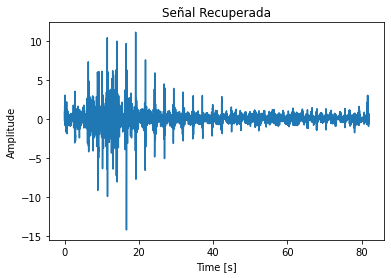

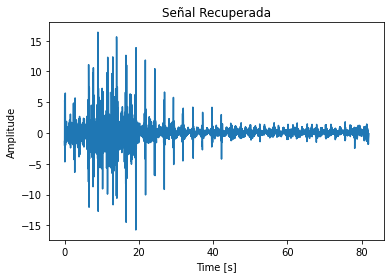

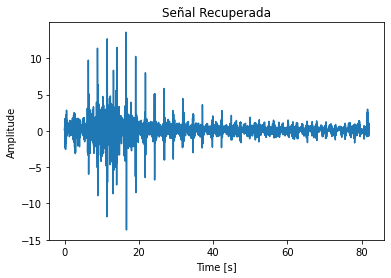

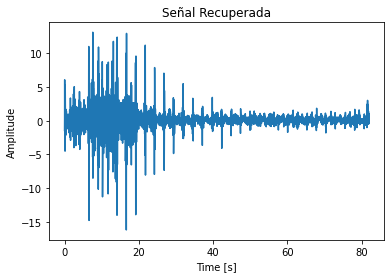

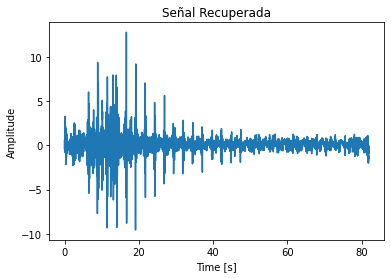

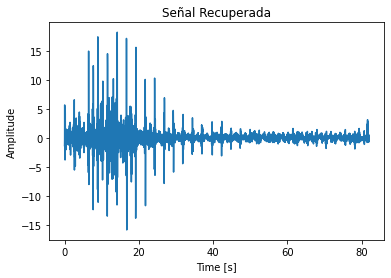

In [157]:
import PrePross.grifflin as grifflin
import numpy as np

examples = 3

for i in range(examples):
    x = torch.tensor([1])
    one_hot_labels = auxiliares.get_one_hot_labels(x.to(device), n_classes)
    fake_noise = auxiliares.get_noise(1, z_dim, device=device)
    noise_and_labels = auxiliares.combine_vectors(fake_noise, one_hot_labels)
    fake = gen(noise_and_labels)
    fake = fake.cpu().detach().numpy()
    
    #fake = real[1].cpu().detach().numpy()
    #fake = np.expand_dims(fake, axis=1)
    
    #real, label = myData.__getitem__(852)
    #fake = real.cpu().detach().numpy()
    #fake = np.expand_dims(fake, axis=1)
    
    fake = fake * std + mean
    samplerate = 50
    timee, muestra_rec=grifflin.reconstruir_señal_generador(fake, 1000, samplerate)
    muestra_rec = np.squeeze(muestra_rec)
    tamaño = len(muestra_rec) / samplerate
    time = np.linspace(0., tamaño, len(muestra_rec))
    plt.plot(time,muestra_rec)
    plt.title("Señal Recuperada")
    plt.xlabel("Time [s]")
    plt.ylabel("Amplitude")
    plt.show()
    x = torch.tensor([0])
    one_hot_labels = auxiliares.get_one_hot_labels(x.to(device), n_classes)
    fake_noise = auxiliares.get_noise(1, z_dim, device=device)
    noise_and_labels = auxiliares.combine_vectors(fake_noise, one_hot_labels)
    fake = gen(noise_and_labels)
    fake = fake.cpu().detach().numpy()
    
    #fake = real[1].cpu().detach().numpy()
    #fake = np.expand_dims(fake, axis=1)
    
    #real, label = myData.__getitem__(852)
    #fake = real.cpu().detach().numpy()
    #fake = np.expand_dims(fake, axis=1)
    
    fake = fake * std + mean
    samplerate = 50
    timee, muestra_rec=grifflin.reconstruir_señal_generador(fake, 1000, samplerate)
    muestra_rec = np.squeeze(muestra_rec)
    tamaño = len(muestra_rec) / samplerate
    time = np.linspace(0., tamaño, len(muestra_rec))
    plt.plot(time,muestra_rec)
    plt.title("Señal Recuperada")
    plt.xlabel("Time [s]")
    plt.ylabel("Amplitude")
    plt.show()
    

In [62]:
print(real)

tensor([[[[3.1656e-02, 4.3753e-02, 1.8896e-01,  ..., 9.2832e-03,
           2.6571e-04, 1.2485e-02],
          [4.9933e-02, 1.6593e-01, 1.5761e-01,  ..., 1.4382e-02,
           3.2262e-02, 1.4388e-02],
          [5.7005e-02, 9.8425e-02, 4.2879e-02,  ..., 9.8551e-03,
           3.9382e-02, 1.7153e-02],
          ...,
          [1.6126e-03, 3.2239e-05, 5.9758e-05,  ..., 1.1004e-02,
           2.6386e-02, 2.1107e-02],
          [1.6445e-03, 4.1495e-05, 5.6820e-05,  ..., 2.4261e-02,
           7.2103e-03, 1.3225e-02],
          [1.6682e-03, 4.5152e-05, 6.4904e-05,  ..., 2.5332e-02,
           7.3283e-03, 9.0343e-04]]],


        [[[1.9313e-02, 5.9089e-02, 2.2770e-01,  ..., 2.4141e-01,
           2.5975e-01, 1.1987e-01],
          [3.5963e-02, 6.8924e-02, 1.8169e-01,  ..., 1.1898e-01,
           1.3194e-01, 9.4929e-02],
          [4.1801e-02, 3.7546e-02, 8.2875e-02,  ..., 1.6747e-02,
           9.7539e-03, 4.3991e-02],
          ...,
          [2.9991e-04, 4.7671e-05, 8.8590e-05,  ..., 1.03